# XPCS&XSVS Pipeline for Single-(Gi)-SAXS Run
"This notebook corresponds to version {{ version }} of the pipeline tool: https://github.com/NSLS-II/pipelines"

This notebook begins with a raw time-series of images and ends with $g_2(t)$ for a range of $q$, fit to an exponential or stretched exponential, and a two-time correlation functoin.

## Overview

* Setup: load packages/setup path
* Load Metadata & Image Data
* Apply Mask
* Clean Data: shutter open/bad frames
* Get Q-Map
* Get 1D curve
* Define Q-ROI (qr, qz)
* Check beam damage
* One-time Correlation
* Fitting
* Two-time Correlation
The important scientific code is imported from the [chxanalys](https://github.com/yugangzhang/chxanalys/tree/master/chxanalys) and [scikit-beam](https://github.com/scikit-beam/scikit-beam) project. Refer to chxanalys and scikit-beam for additional documentation and citation information.

### DEV
* V8: Update visbility error bar calculation using pi = his/N +/- sqrt(his_i)/N
*     Update normlization in g2 calculation uing 2D-savitzky golay (SG ) smooth

## CHX Olog NoteBook
CHX Olog (https://logbook.nsls2.bnl.gov/11-ID/)

## Setup

Import packages for I/O, visualization, and analysis.

In [2]:
from pyCHX.chx_packages import *
%matplotlib notebook
plt.rcParams.update({'figure.max_open_warning': 0})
plt.rcParams.update({ 'image.origin': 'lower'   })
plt.rcParams.update({ 'image.interpolation': 'none'   })
import pickle as cpk
from pyCHX.chx_xpcs_xsvs_jupyter_V1 import *
import itertools
from pyCHX.SAXS import poly_sphere_form_factor_intensity

In [3]:
#%matplotlib notebook
%matplotlib inline

## Control Runs Here

In [4]:
#scat_geometry = 'saxs'  #suport 'saxs', 'gi_saxs', 'ang_saxs' (for anisotropics saxs or flow-xpcs)
#scat_geometry = 'ang_saxs' 
#scat_geometry = 'gi_waxs' 
scat_geometry = 'gi_saxs'


roi_auto =  False #True #False #True #if True, will automatically create a roi based on the roi_type ( iso/aniso etc), currently only works for SAXS
fit_peak = False #True

analysis_type_auto = False #True #if True, will take "analysis type" option from data acquisition func series
qphi_analysis =  False #True #False  #if True, will do q-phi (anisotropic analysis for transmission saxs)

isotropic_Q_mask = 'normal' #'wide' # 'normal' # 'wide'  ## select wich Q-mask to use for rings: 'normal' or 'wide'
phi_Q_mask = 'phi_4x_20deg'   ## select wich Q-mask to use for phi analysis
q_mask_name = ''

force_compress = False #True   #force to compress data 
bin_frame = False   #generally make bin_frame as False
para_compress = True    #parallel compress
run_fit_form = False    #run fit form factor 
run_waterfall =  False #True #False #True   #run waterfall analysis
run_profile_plot = True #False  #run prolfile plot for gi-saxs
run_t_ROI_Inten = True  #run  ROI intensity as a function of time
run_get_mass_center = False  # Analysis for mass center of reflective beam center
run_invariant_analysis = False
run_one_time =  True  #run  one-time
cal_g2_error =  False  #True  #calculate g2 signal to noise
#run_fit_g2 = True       #run  fit one-time, the default function is "stretched exponential"
fit_g2_func = 'stretched'
run_two_time =   False #True    #run  two-time
run_four_time = False #True #True #False   #run  four-time
run_xsvs= False # True #False         #run visibility analysis
att_pdf_report = True    #attach the pdf report to CHX olog
qth_interest = 7 #the intested single qth     

use_sqnorm = True    #if True, use sq to normalize intensity
use_SG = False #True # False        #if True, use the Sawitzky-Golay filter of the avg_img for normalization
use_SG_bin_frames =  True   #if True, use the Sawitzky-Golay filter of the (binned) frame for normalization 

use_imgsum_norm= True  #if True use imgsum to normalize intensity for one-time calculatoin
pdf_version='_%s'%get_today_date()     #for pdf report name
run_dose = False # True # False #True # True #False  #run dose_depend analysis


if scat_geometry == 'gi_saxs':run_xsvs= False;use_sqnorm=False
if scat_geometry == 'gi_waxs':use_sqnorm = False
if scat_geometry != 'saxs':qphi_analysis = False;scat_geometry_ = scat_geometry;roi_auto = False  
else:scat_geometry_ = ['','ang_'][qphi_analysis]+ scat_geometry   
if scat_geometry != 'gi_saxs':run_profile_plot = False

In [5]:
scat_geometry, scat_geometry_, qphi_analysis

('gi_saxs', 'gi_saxs', False)

In [6]:
taus=None;g2=None;tausb=None;g2b=None;g12b=None;taus4=None;g4=None;times_xsv=None;contrast_factorL=None; lag_steps = None 

## Make a directory for saving results

In [7]:
CYCLE= '2019_2'  #change clycle here
path = '/XF11ID/analysis/%s/masks/'%CYCLE

## Load Metadata & Image Data



### Change this line to give a uid

In [8]:
username      =  getpass.getuser()
uid = '887b6b5d'
uid = 'b5e319df' #] (scan num: 19486) (Measurement: test contrast and stabilityPM20190808_Ge_250C )


print(uid)
username = 'pmyint'

roi_auto = False # True #False #True #if True, will automatically create a roi based on the roi_type ( iso/aniso etc), currently only works for SAXS
run_two_time  =   True 
run_dose      =   False 



b5e319df


 # put the uid below 

In [9]:


# Parameters
uid = "e2bc7f37"
username = "pmyint"
run_two_time = True
run_dose = False


In [10]:
print(uid)

e2bc7f37


In [11]:
#db[-1]

In [12]:
#get_last_uids( -2)

In [13]:
data_dir0  = create_user_folder(CYCLE, username)
print( data_dir0 )

Results from this analysis will be stashed in the directory /XF11ID/analysis/2019_2/pmyint/Results/
/XF11ID/analysis/2019_2/pmyint/Results/


In [14]:
uid = uid[:8]
print('The current uid for analysis is: %s...'%uid)

The current uid for analysis is: e2bc7f37...


In [15]:
sud = get_sid_filenames(db[uid])
for pa in sud[2]:
    if 'master.h5' in pa:
        data_fullpath = pa
print ('scan_id, full-uid, data path are:  %s--%s--%s'%(sud[0], sud[1], data_fullpath ))

#start_time, stop_time = '2017-2-24  12:23:00', '2017-2-24  13:42:00' 
#sids, uids, fuids  = find_uids(start_time, stop_time)

filepath : /nsls2/xf11id1/data/2019/08/17/48451e1a-d4dd-4eec-acc7
got images_per_file
scan_id, full-uid, data path are:  19628--e2bc7f37-8f95-4f18-8465-af91a8e58bf4--/nsls2/xf11id1/data/2019/08/17/48451e1a-d4dd-4eec-acc7_6735_master.h5


In [16]:
data_dir = os.path.join(data_dir0, '%s/'%(sud[1]))
os.makedirs(data_dir, exist_ok=True)
print('Results from this analysis will be stashed in the directory %s' % data_dir)
uidstr = 'uid=%s'%uid

Results from this analysis will be stashed in the directory /XF11ID/analysis/2019_2/pmyint/Results/e2bc7f37-8f95-4f18-8465-af91a8e58bf4/


# Don't Change the lines below here

* get metadata

In [17]:
md = get_meta_data( uid )
md_blue = md.copy()
#md_blue

In [18]:
#md_blue['detectors'][0]
#if md_blue['OAV_mode'] != 'none':
#    cx , cy = md_blue[md_blue['detectors'][0]+'_beam_center_x'], md_blue[md_blue['detectors'][0]+'_beam_center_x']
#else: 
#    cx , cy = md_blue['beam_center_x'], md_blue['beam_center_y']
#print(cx,cy)

In [19]:
detectors = sorted(get_detectors(db[uid]))
print('The detectors are:%s'%detectors)
if len(detectors) >1:
    md['detector'] = detectors[1]
    print( md['detector'])


The detectors are:['eiger4m_single_image']


In [20]:
if md['detector'] =='eiger4m_single_image' or md['detector'] == 'image':    
    reverse= True
    rot90= False
elif md['detector'] =='eiger500K_single_image':    
    reverse= True
    rot90=True
elif md['detector'] =='eiger1m_single_image':    
    reverse= True
    rot90=False
print('Image reverse: %s\nImage rotate 90: %s'%(reverse, rot90))    

Image reverse: True
Image rotate 90: False


In [21]:
try:
    cx , cy = md_blue['beam_center_x'], md_blue['beam_center_y']
    print(cx,cy)
except:
    print('Will find cx,cy later.')


Will find cx,cy later.


### Load ROI defined by "XPCS_Setup" Pipeline

#### Define data analysis type

In [22]:
if analysis_type_auto:#if True, will take "analysis type" option from data acquisition func series
    try:
        if scat_geometry != 'gi_saxs':
            qphi_analysis_ = md['analysis'] #if True, will do q-phi (anisotropic analysis for transmission saxs)
            print(md['analysis'])
            if qphi_analysis_ == 'iso':
                qphi_analysis = False
            elif qphi_analysis_ == '':
                qphi_analysis = False
            else:
                qphi_analysis = True
            #for other analysis type, in case of GiSAXS, low_angle/high_anlge for instance    
        else:
            gisaxs_inc_type = md['analysis'] 
        
    except:
        gisaxs_inc_type = None
        print('There is no analysis in metadata.')
        
print('Will %s qphis analysis.'%['NOT DO','DO'][qphi_analysis]) 

if scat_geometry != 'saxs':qphi_analysis = False;scat_geometry_ = scat_geometry  
else:scat_geometry_ = ['','ang_'][qphi_analysis]+ scat_geometry   
if scat_geometry != 'gi_saxs':run_profile_plot = False     
    
print(scat_geometry_)    

Will NOT DO qphis analysis.
gi_saxs


In [23]:
scat_geometry

'gi_saxs'

In [24]:
#%run /home/yuzhang/pyCHX_link/pyCHX/chx_generic_functions.py

* get data

In [25]:
imgs = load_data( uid, md['detector'], reverse= reverse, rot90=rot90  )
md.update( imgs.md );Nimg = len(imgs);
#md['beam_center_x'], md['beam_center_y']  = cx, cy
#if 'number of images'  not in list(md.keys()):
md['number of images']  = Nimg
pixel_mask =  1- np.int_( np.array( imgs.md['pixel_mask'], dtype= bool)  )
print( 'The data are: %s' %imgs )

#md['acquire period' ] = md['cam_acquire_period']
#md['exposure time'] =  md['cam_acquire_time']
mdn = md.copy()


The data are: Pipeline processed through proc_func. Original repr:
    EigerImages processed through proc_func. Original repr:
        <Frames>
        Length: 5160 frames
        Frame Shape: 2167 x 2070
        Pixel Datatype: uint32


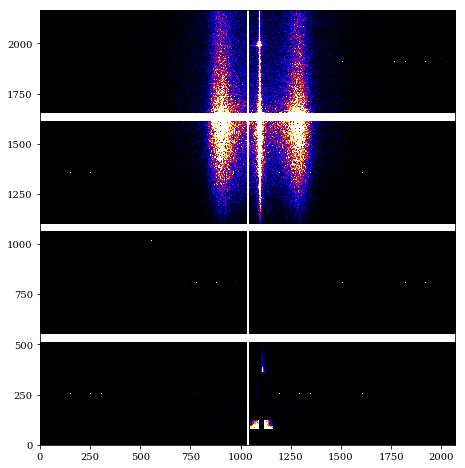

In [26]:
plt.figure(figsize=(8,8))
plt.imshow(imgs[1000],vmin=1e-3,vmax=50,cmap=cmap_vge)

#### Load Chip mask depeding on detector

In [27]:
if md['detector'] =='eiger1m_single_image':
    Chip_Mask=np.load( '/XF11ID/analysis/2017_1/masks/Eiger1M_Chip_Mask.npy')
elif md['detector'] =='eiger4m_single_image' or md['detector'] == 'image':    
    Chip_Mask= np.array(np.load( '/XF11ID/analysis/2017_1/masks/Eiger4M_chip_mask.npy'), dtype=bool)
    BadPix =     np.load('/XF11ID/analysis/2018_1/BadPix_4M.npy'  )  
    Chip_Mask.ravel()[BadPix] = 0
elif md['detector'] =='eiger500K_single_image':
    #print('here')
    Chip_Mask=  np.load( '/XF11ID/analysis/2017_1/masks/Eiger500K_Chip_Mask.npy')  #to be defined the chip mask
    Chip_Mask = np.rot90(Chip_Mask)
    pixel_mask = np.rot90(  1- np.int_( np.array( imgs.md['pixel_mask'], dtype= bool))   )
    
else:
    Chip_Mask = 1
print(Chip_Mask.shape, pixel_mask.shape)

(2167, 2070) (2167, 2070)


In [28]:
use_local_disk = True
import shutil,glob

In [29]:
save_oavs = False
if len(detectors)==2:
    if '_image' in md['detector']:
        pref = md['detector'][:-5]
    else:
        pref=md['detector']
    for k in [ 'beam_center_x', 'beam_center_y','cam_acquire_time','cam_acquire_period','cam_num_images',
             'wavelength', 'det_distance', 'photon_energy']:
        md[k] =  md[ pref + '%s'%k]    
    
    if 'OAV_image' in detectors:
        try:
            save_oavs_tifs(  uid, data_dir )
            save_oavs = True
        except:
            pass
        

In [30]:
print_dict( md,  ['suid', 'number of images', 'uid', 'scan_id', 'start_time', 'stop_time', 'sample', 'Measurement',
                  'acquire period', 'exposure time',  
         'det_distance', 'beam_center_x', 'beam_center_y', ] )

suid--> e2bc7f37
number of images--> 5160
uid--> e2bc7f37-8f95-4f18-8465-af91a8e58bf4
scan_id--> 19628
start_time--> 2019-08-17 18:55:03
stop_time--> 2019-08-17 19:38:05
sample--> PM20190817-2
Measurement--> 0 degree bombardment on fresh sample at 300C temperature ----- more water flow_with beam position feedback on. no shutter sample rotated 45degPM20190817-2
acquire period--> 0.5
exposure time--> 0.5
beam_center_x--> 1100.0
beam_center_y--> 2089.0


## Overwrite Some Metadata if Wrong Input

### Define incident beam center (also define reflection beam center for gisaxs)

In [31]:
if scat_geometry =='gi_saxs':
    
    inc_x0 = md['beam_center_x'] 
    inc_y0 =  imgs[0].shape[0] - md['beam_center_y']    
    
    refl_x0 =    md['beam_center_x'] 
    #inc_ang = 0.39
    #refl_y0 =     1780 #1000     #imgs[0].shape[0] -  1758      
    #refl_x0 =     md['beam_center_x']  
    inc_ang  =   abs(  float(db[uid]['start']['inc_angle'] ))
    #print(inc_ang)
    refl_x0, refl_y0 = inc_x0,  np.tan(2* np.radians(inc_ang))*md['eiger4m_single_det_distance']/0.075*1e3  + inc_y0
    
    #%run -i ~/analysis/Analysis_Pipelines/Develop/pyCHX/pyCHX/XPCS_GiSAXS.py
    #refl_x0, refl_y0 = get_refl_xy(  inc_ang= inc_ang, inc_phi=0, inc_x0= inc_x0, inc_y0= inc_y0, pixelsize=[0.075,0.075], Lsd= md['det_distance']*1000   )
  
   
    print( "inc_x0, inc_y0, ref_x0,ref_y0 are: %s %s %s %s."%(inc_x0, inc_y0, refl_x0, refl_y0) )
else:
    if md['detector'] =='eiger4m_single_image' or md['detector'] == 'image' or md['detector']=='eiger1m_single_image':    
        inc_x0 =  imgs[0].shape[0] - md['beam_center_y']   
        inc_y0=   md['beam_center_x']
    elif md['detector'] =='eiger500K_single_image':    
        inc_y0 =  imgs[0].shape[1] - md['beam_center_y']   
        inc_x0 =   imgs[0].shape[0] - md['beam_center_x']
    
    print(inc_x0, inc_y0)

    ###for this particular uid, manually give x0/y0
    #inc_x0 = 1041
    #inc_y0 = 1085

inc_x0, inc_y0, ref_x0,ref_y0 are: 1100.0 78.0 1100.0 1953.7905556755372.


In [32]:
md

{'suid': 'e2bc7f37',
 'filename': '/nsls2/xf11id1/data/2019/08/17/48451e1a-d4dd-4eec-acc7_6735_master.h5',
 'detector': 'eiger4m_single_image',
 'eiger4m_single_cam_acquire_period': 0.5,
 'eiger4m_single_cam_acquire_time': 0.49999698996543884,
 'eiger4m_single_cam_num_images': 5160,
 'eiger4m_single_beam_center_x': 1100.0,
 'eiger4m_single_beam_center_y': 2089.0,
 'eiger4m_single_wavelength': 1.2848103046417236,
 'eiger4m_single_det_distance': 10.333484865000003,
 'eiger4m_single_threshold_energy': 6400.0,
 'eiger4m_single_photon_energy': 9650.0,
 'eiger4m_single_stats1_configuration_names': ['eiger4m_single_stats1_configuration_names',
  'eiger4m_single_stats1_port_name',
  'eiger4m_single_stats1_asyn_pipeline_config',
  'eiger4m_single_stats1_blocking_callbacks',
  'eiger4m_single_stats1_enable',
  'eiger4m_single_stats1_nd_array_port',
  'eiger4m_single_stats1_plugin_type',
  'eiger4m_single_stats1_bgd_width',
  'eiger4m_single_stats1_centroid_threshold',
  'eiger4m_single_stats1_co

In [33]:
dpix, lambda_, Ldet,  exposuretime, timeperframe, center = check_lost_metadata(
    md, Nimg, inc_x0 = inc_x0, inc_y0=   inc_y0, pixelsize = 7.5*10*(-5) )
if scat_geometry =='gi_saxs':center=center[::-1]
if uid == '4740b6b5-20cb-4ad1-9f7a-b7a2b3a77659':
    Ldet =  16.035*1000
    
#Ldet = 10.36*1e3
    
setup_pargs=dict(uid=uidstr, dpix= dpix, Ldet=Ldet, lambda_= lambda_, exposuretime=exposuretime,
        timeperframe=timeperframe, center=center, path= data_dir)
print_dict( setup_pargs )


Beam_center_x has been changed to 78.0. (no change in raw metadata): 
Beam_center_y has been changed to 1100.0.  (no change in raw metadata): 
uid--> uid=e2bc7f37
dpix--> 0.07500000356230885
Ldet--> 10333.499908447266
lambda_--> 1.2848103
exposuretime--> 0.499997
timeperframe--> 0.5
center--> [78, 1100]
path--> /XF11ID/analysis/2019_2/pmyint/Results/e2bc7f37-8f95-4f18-8465-af91a8e58bf4/


In [34]:
setup_pargs

{'uid': 'uid=e2bc7f37',
 'dpix': 0.07500000356230885,
 'Ldet': 10333.499908447266,
 'lambda_': 1.2848103,
 'exposuretime': 0.499997,
 'timeperframe': 0.5,
 'center': [78, 1100],
 'path': '/XF11ID/analysis/2019_2/pmyint/Results/e2bc7f37-8f95-4f18-8465-af91a8e58bf4/'}

## Apply Mask
* load and plot mask if exist 
* otherwise create a mask using Mask pipeline
* Reverse the mask in y-direction due to the coordination difference between python and Eiger software
* Reverse images in y-direction
* Apply the mask

# Change the lines below to give mask filename

In [35]:
date = 'Aug15'


if scat_geometry == 'gi_saxs':
    mask_path = '/XF11ID/analysis/2019_2/masks/'    
    mask_name =  '%s_2019_4M_GiSAXS.npy'%date
    
elif scat_geometry == 'saxs':
    mask_path = '/XF11ID/analysis/2019_3/masks/'
    if md['detector'] =='eiger4m_single_image' or md['detector'] == 'image':    
        mask_name = '%s_2019_4M_SAXS.npy'%date   
        
    elif md['detector'] =='eiger500K_single_image':    
        mask_name = '%s_2019_500K_SAXS.npy'%date    
        
elif scat_geometry == 'gi_waxs':    
    mask_path = '/XF11ID/analysis/2019_3/masks/'    
    mask_name =  '%s_2019_1M_WAXS.npy'  
    

/opt/conda_envs/analysis-2018-2.1/lib/python3.6/site-packages/matplotlib/figure.py:2267: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


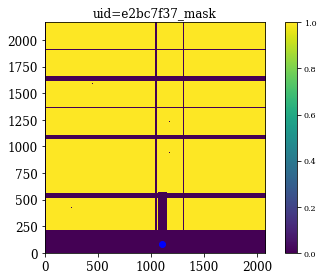

In [36]:
mask = load_mask(mask_path, mask_name, plot_ =  False, image_name = uidstr + '_mask', reverse= reverse, rot90=rot90  ) 
mask =  mask * pixel_mask * Chip_Mask
show_img(mask,image_name = uidstr + '_mask', save=True, path=data_dir, aspect=1, center=center[::-1])
mask_load=mask.copy()
imgsa = apply_mask( imgs, mask )

# Check several frames average  intensity

#### Load ROI mask depending on data analysis type

In [37]:
#%run ~/pyCHX_link/pyCHX/chx_generic_functions.py

In [38]:
print(roi_auto, qphi_analysis, isotropic_Q_mask)

False False normal


In [39]:
##For SAXS 
roi_path = '/XF11ID/analysis/2019_3/masks/'
roi_date = 'Aug10'
#roi_date = 'May30B'


if scat_geometry =='saxs':
    ## For auto load roi mask
    if roi_auto: 
        general_path = '/nsls2/xf11id1/analysis/2017_1/masks/'
        roi_mask_norm = general_path + 'general_roi_mask_norm.npy' 
        roi_mask_wide = general_path + 'general_roi_mask_wide.npy' 
        roi_mask_phi_4x_20deg = general_path + 'general_roi_mask_phi_4x_20deg.npy' 
        roi_mask_12x_30deg = general_path + 'general_roi_mask_12x_30deg.npy' 
        roi_mask_12x_15deg_flow = general_path + 'general_roi_mask_12x_15deg_flow.npy'
        if qphi_analysis ==  False:
            if isotropic_Q_mask == 'normal':
                fp = roi_mask_norm
            elif isotropic_Q_mask == 'wide':
                fp = roi_mask_wide
        elif qphi_analysis:
            if phi_Q_mask == 'phi_4x_20deg':
                fp = roi_mask_phi_4x_20deg
            elif phi_Q_mask == 'phi_12x_30deg': 
                fp = roi_mask_phi_12x_30deg
            elif phi_Q_mask == 'phi_12x_15deg_flow': 
                fp = roi_mask_phi_12x_15deg_flow 
        roi_mask0 = np.load(fp)    
        old_cen=[4000,4000]        
        roi_mask, qval_dict, qwid_dict = get_roi_mask_qval_qwid_by_shift( 
                        new_cen=center, new_mask= mask, old_cen=old_cen,
                                    old_roi_mask=roi_mask0, limit_qnum= None,
                                    setup_pargs= setup_pargs,  geometry = scat_geometry_,
                                    ) 
 
    else: 
        if qphi_analysis ==  False:
            if isotropic_Q_mask == 'normal':
                #print('Here')
                q_mask_name='rings'
                if md['detector'] =='eiger4m_single_image' or md['detector'] == 'image': #for 4M 
                    fp = roi_path + 'roi_mask_%s_4M_norm.pkl'%roi_date                 

                elif md['detector'] =='eiger500K_single_image': #for 500K   
                    fp = roi_path + 'roi_mask_%s_500K_norm.pkl'%roi_date   


            elif isotropic_Q_mask == 'wide':
                q_mask_name='wide_rings'
                if md['detector'] =='eiger4m_single_image' or md['detector'] == 'image': #for 4M   
                    fp = roi_path + 'roi_mask_%s_4M_wide.pkl'%roi_date   
                elif md['detector'] =='eiger500K_single_image': #for 500K   
                    fp = roi_path + 'roi_mask_%s_500K_wide.pkl'%roi_date   


        elif qphi_analysis:
            if phi_Q_mask =='phi_4x_20deg':
                q_mask_name='phi_4x_20deg'
                if md['detector'] =='eiger4m_single_image' or md['detector'] == 'image': #for 4M 
                    fp = roi_path + 'roi_mask_%s_4M_phi_4x_20deg.pkl'%roi_date   
                elif md['detector'] =='eiger500K_single_image': #for 500K 
                    fp = roi_path + 'roi_mask_%s_500K_phi_4x_20deg.pkl'%roi_date   


        #fp = 'XXXXXXX.pkl'            
        roi_mask,qval_dict = cpk.load( open(fp, 'rb' )  )  #for load the saved roi data
        print(fp)

## Gi_SAXS 
elif scat_geometry =='gi_saxs': 
    
    # static mask    
    #ss =  '887b6b5d'
    ss =   '28d8f37c'
    
    
    fp = '/XF11ID/analysis/2019_2/masks/uid=%s_roi_masks.pkl'%ss
    roi_masks,qval_dicts = cpk.load( open(fp, 'rb' )  )  #for load the saved roi data    
    print('The static mask is: %s.'%fp)    

    fp = '/XF11ID/analysis/2019_2/masks/uid=%s_roi_mask.pkl'%(ss)
    roi_mask,qval_dict = cpk.load( open(fp, 'rb' )  )  #for load the saved roi data
    print('The dynamic mask is: %s.'%fp)
    # q-map
    fp = '/XF11ID/analysis/2019_2/masks/uid=%s_qmap.pkl'%(ss)
    #print(fp)
    qr_map, qz_map, ticks, Qrs, Qzs,  Qr, Qz, inc_x0,refl_x0, refl_y0 = cpk.load( open(fp, 'rb' )  )
    print('The qmap is: %s.'%fp)
    
## WAXS 
elif scat_geometry =='gi_waxs': 
    #fp = '/XF11ID/analysis/2019_1/masks/uid=ca2ccb14_roi_mask_5PTO_130C_PTO.pkl'     
    fp =  '/XF11ID/analysis/2019_2/masks/uid=278c0df1_roi_mask.pkl'
    
    roi_mask,qval_dict = cpk.load( open(fp, 'rb' )  )  #for load the saved roi data

print(roi_mask.shape)

The static mask is: /XF11ID/analysis/2019_2/masks/uid=28d8f37c_roi_masks.pkl.
The dynamic mask is: /XF11ID/analysis/2019_2/masks/uid=28d8f37c_roi_mask.pkl.
The qmap is: /XF11ID/analysis/2019_2/masks/uid=28d8f37c_qmap.pkl.
(2167, 2070)


In [40]:
#qval_dict

/opt/conda_envs/analysis-2018-2.1/lib/python3.6/site-packages/matplotlib/figure.py:2267: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


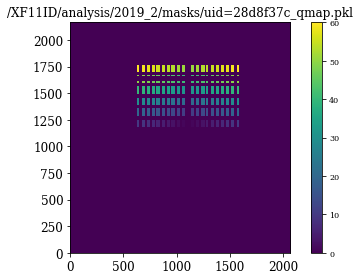

In [41]:
#roi_mask = shift_mask(roi_mask, 10,30)  #if shift mask to get new mask
show_img(roi_mask, aspect=1.0, image_name = fp)#, center=center[::-1])


In [42]:
img_choice_N = 1
img_samp_index = random.sample( range(len(imgs)), img_choice_N) 
avg_img =  get_avg_img( imgsa, img_samp_index, plot_ = False, uid =uidstr)
if avg_img.max() == 0:
    print('There are no photons recorded for this uid: %s'%uid)
    print('The data analysis should be terminated! Please try another uid.')


In [43]:
#show_img( imgsa[1000],  vmin=.1, vmax= 1e1, logs=True, aspect=1,
#         image_name= uidstr + '_img_avg',  save=True, path=data_dir,  cmap = cmap_albula )
print(center[::-1])

[1100, 78]


/opt/conda_envs/analysis-2018-2.1/lib/python3.6/site-packages/matplotlib/figure.py:2267: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


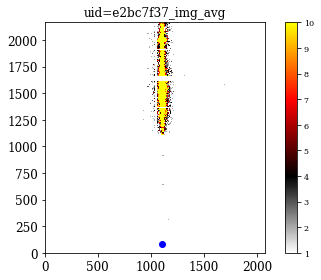

In [44]:
show_img( imgsa[ 5],  vmin = 1, vmax = 10, logs=False, aspect=1, #save_format='tif',
         image_name= uidstr + '_img_avg',  save=True, path=data_dir, cmap=cmap_albula,center=center[::-1])
# select subregion, hard coded center beam location
#show_img( imgsa[180+40*3/0.05][110:110+840*2, 370:370+840*2],  vmin = 0.01, vmax = 20, logs=False, aspect=1, #save_format='tif',
#         image_name= uidstr + '_img_avg',  save=True, path=data_dir, cmap=cmap_albula,center=[845,839])

## Compress Data
* Generate a compressed data with filename
* Replace old mask with a new mask with removed hot pixels
* Do average image
* Do each image sum
* Find badframe_list for where image sum above bad_pixel_threshold
* Check shutter open frame to get good time series


In [45]:
compress=True
photon_occ = len( np.where(avg_img)[0] ) / ( imgsa[0].size)
#compress =  photon_occ < .4  #if the photon ocupation < 0.5, do compress
print ("The non-zeros photon occupation is %s."%( photon_occ))
print("Will " + 'Always ' + ['NOT', 'DO'][compress]  + " apply compress process.")

The non-zeros photon occupation is 0.1585847439301423.
Will Always DO apply compress process.


In [46]:
if  md['detector'] =='eiger4m_single_image' or md['detector'] == 'image':    
    good_start =    5  #make the good_start at least 0
elif md['detector'] =='eiger500K_single_image': 
    good_start = 5#100  #5  #make the good_start at least 0
    
elif  md['detector'] =='eiger1m_single_image' or md['detector'] == 'image':    
    good_start =    5    

In [47]:
bin_frame =  False # True  #generally make bin_frame as False
if bin_frame:
    bin_frame_number=4
    acquisition_period = md['acquire period']
    timeperframe = acquisition_period * bin_frame_number
else:
    bin_frame_number =1

In [48]:
force_compress = False
#force_compress = True

Using already created compressed file with filename as :/nsls2/xf11id1/analysis/Compressed_Data/uid_e2bc7f37-8f95-4f18-8465-af91a8e58bf4.cmp.
The good_start frame number is: 5 
uid=e2bc7f37_fra_5_5160
Total time: 0.937 sec


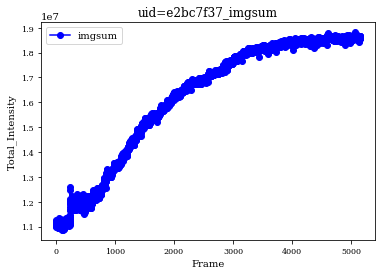

In [49]:
import time
t0= time.time()

if not use_local_disk:
    cmp_path = '/nsls2/xf11id1/analysis/Compressed_Data'
else:
    cmp_path = '/tmp_data/compressed'
    
    
cmp_path = '/nsls2/xf11id1/analysis/Compressed_Data'    
if bin_frame_number==1:   
    cmp_file = '/uid_%s.cmp'%md['uid']
else:
    cmp_file = '/uid_%s_bined--%s.cmp'%(md['uid'],bin_frame_number)
    
filename = cmp_path + cmp_file  
mask2, avg_img, imgsum, bad_frame_list = compress_eigerdata(imgs, mask, md, filename, 
         force_compress= force_compress,  para_compress= para_compress,  bad_pixel_threshold = 1e14,
                                    reverse=reverse, rot90=rot90,
                        bins=bin_frame_number, num_sub= 100, num_max_para_process= 500, with_pickle=True,
                        direct_load_data =use_local_disk, data_path = data_fullpath, )                                  
                                                         
min_inten = 10    
good_start = max(good_start, np.where( np.array(imgsum) > min_inten )[0][0] )    
print ('The good_start frame number is: %s '%good_start)

FD = Multifile(filename, good_start, len(imgs)//bin_frame_number )
#FD = MultifileBNLCustom(filename, good_start, len(imgs)//bin_frame_number )

###For test purpose to use the first 1000 frames
####################################################################
#FD = MultifileBNLCustom(filename, good_start, 500 )
#FD = Multifile(filename, good_start, 500)
############################################################


uid_ = uidstr + '_fra_%s_%s'%(FD.beg, FD.end)
print( uid_ )
plot1D( y = imgsum[ np.array( [i for i in np.arange(good_start, len(imgsum)) if i not in bad_frame_list])],
       title =uidstr + '_imgsum', xlabel='Frame', ylabel='Total_Intensity', legend='imgsum'   )
Nimg = Nimg/bin_frame_number
run_time(t0)

mask2 =  mask * pixel_mask * Chip_Mask
mask_copy = mask.copy()
mask_copy2 = mask.copy()

avg_img *= mask

In [50]:
#%run ~/pyCHX_link/pyCHX/chx_generic_functions.py

In [51]:
try:
    if md['experiment']=='printing':
        #p = md['printing'] #if have this printing key, will do error function fitting to find t_print0
        find_tp0 = True
        t_print0 = ps(  y = imgsum[:400] ) * timeperframe
        print( 'The start time of print: %s.' %(t_print0  ) )
    else:
        find_tp0 = False
        print('md[experiment] is not "printing" -> not going to look for t_0')
        t_print0 = None
except:
    find_tp0 = False
    print('md[experiment] is not "printing" -> not going to look for t_0')
    t_print0 = None


md[experiment] is not "printing" -> not going to look for t_0


/opt/conda_envs/analysis-2018-2.1/lib/python3.6/site-packages/matplotlib/figure.py:2267: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


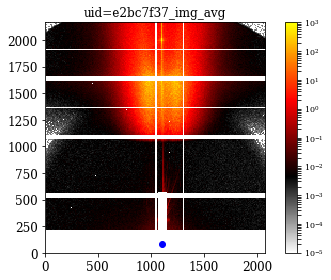

In [52]:
show_img( avg_img*mask,  vmin=1e-5, vmax= 1e3, logs=True, aspect=1, #save_format='tif',
         image_name= uidstr + '_img_avg',  save=True, 
         path=data_dir, center=center[::-1], cmap = cmap_albula )  #plt.cm.jet )#

## Get bad frame list by a polynominal fit

In [53]:
good_end= None # 2000  
if good_end is not None:
    FD = Multifile(filename, good_start, min( len(imgs)//bin_frame_number, good_end) )
    uid_ = uidstr + '_fra_%s_%s'%(FD.beg, FD.end)
    print( uid_ )
    

In [54]:
re_define_good_start =False
if re_define_good_start:
    good_start = 180
    #good_end = 19700
    good_end = len(imgs)
    FD = Multifile(filename, good_start, good_end) 
    uid_ = uidstr + '_fra_%s_%s'%(FD.beg, FD.end)
    print( FD.beg, FD.end)

/nsls2/xf11id1/analysis/Analysis_Pipelines/Develop/pyCHX/pyCHX/chx_generic_functions.py:2564: RankWarning: Polyfit may be poorly conditioned
  pol = np.polyfit(x, y, order)


The bad frame list length is: 51


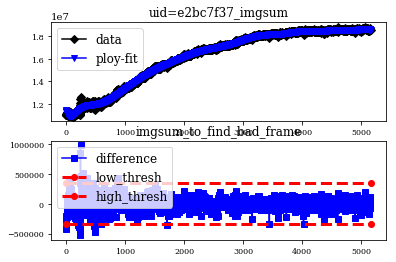

In [55]:
bad_frame_list =  get_bad_frame_list( imgsum, fit='both',  plot=True,polyfit_order = 30,                                      
                        scale= 3.5,  good_start = good_start, good_end=good_end, uid= uidstr, path=data_dir)

print( 'The bad frame list length is: %s'%len(bad_frame_list) )

### Creat new mask by masking the bad pixels and get new avg_img

In [56]:
imgsum_y = imgsum[ np.array( [i for i in np.arange( len(imgsum)) if i not in bad_frame_list])]
imgsum_x = np.arange( len( imgsum_y))
save_lists(  [imgsum_x, imgsum_y], label=['Frame', 'Total_Intensity'],
           filename=uidstr + '_img_sum_t', path= data_dir  )


### Plot time~ total intensity of each frame

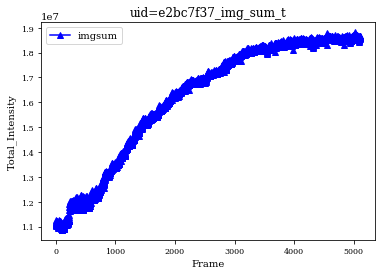

In [57]:
plot1D( y = imgsum_y, title = uidstr + '_img_sum_t', xlabel='Frame', c='b',
       ylabel='Total_Intensity', legend='imgsum', save=True, path=data_dir)

## Get Dynamic Mask (currently designed for 500K)

In [58]:
if  md['detector'] =='eiger4m_single_image' or md['detector'] == 'image':    
    pass
elif md['detector'] =='eiger500K_single_image':  
    #if md['cam_acquire_period'] <= 0.00015:  #will check this logic
    if imgs[0].dtype == 'uint16':
        print('Create dynamic mask for 500K due to 9K data acquistion!!!')
        bdp = find_bad_pixels_FD( bad_frame_list, FD, img_shape = avg_img.shape, threshold=20 )    
        mask = mask_copy2.copy()
        mask *=bdp 
        mask_copy = mask.copy()
        show_img(  mask, image_name='New Mask_uid=%s'%uid )

# Static Analysis

## SAXS Scattering Geometry

In [59]:
setup_pargs 

{'uid': 'uid=e2bc7f37',
 'dpix': 0.07500000356230885,
 'Ldet': 10333.499908447266,
 'lambda_': 1.2848103,
 'exposuretime': 0.499997,
 'timeperframe': 0.5,
 'center': [78, 1100],
 'path': '/XF11ID/analysis/2019_2/pmyint/Results/e2bc7f37-8f95-4f18-8465-af91a8e58bf4/'}

In [60]:
if scat_geometry =='saxs':
    ## Get circular average| * Do plot and save q~iq
    mask = mask_copy.copy()
    hmask = create_hot_pixel_mask( avg_img, threshold = 1e8, center=center, center_radius= 10)
    
    qp_saxs, iq_saxs, q_saxs = get_circular_average( avg_img * Chip_Mask , mask * hmask, save=True,
                                                    pargs=setup_pargs  )
    plot_circular_average( qp_saxs, iq_saxs, q_saxs,  pargs=setup_pargs,  show_pixel=True,
                      xlim=[qp_saxs.min(), qp_saxs.max()*1.0], ylim = [iq_saxs.min(), iq_saxs.max()*2] )
    mask =np.array( mask * hmask, dtype=bool) 

## SAXS to fit the form factor

In [61]:
#%run -i ~/pyCHX_link/pyCHX/SAXS.py

In [62]:
if scat_geometry =='saxs':    
    if run_fit_form:  
        qp, pq =  q_saxs, iq_saxs
        fitp, fitpe,   q_, fitq, result    = get_form_factor_fit_lmfit( qp, pq, 
            guess_values={'radius': 1180, 'sigma':0.05,'delta_rho':1e-9, 'background':5e-5,  
                          'qpower_scale':5e-10, 'qpower': -4.0 }, 
            guess_limit = { 'radius': [1000, 1500],   'sigma':[1e-3, .5], 'delta_rho': [1e-16, 1e-4], 
                           'background':  [1e-6, 1e-3], 'qpower_scale': [1e-16, 1], 'qpower': [ -5,-3]},                                                
            fit_range=[0.005, 0.03], 
            fit_variables={'radius': True,  'sigma':True,  'delta_rho':True,  'background': True,
                            'qpower_scale':True,  'qpower':False},
            fit_func='G',    qpower_bg= True  )
        
        r,sig=fitp[ 'radius'], fitp['sigma']
        radius, sigma, delta_rho, background, qpower_scale, qpower =  (fitp[ 'radius'], fitp['sigma'],
                                                 fitp['delta_rho'],fitp['background'],
                                                 fitp[ 'qpower_scale'], fitp['qpower']    ) 
        bk= qpower_scale*qp**( qpower ) + background
        ff= poly_sphere_form_factor_intensity( qp, radius=radius, sigma=sigma, delta_rho=delta_rho, 
                                              background=0,  num_points= 20,
                                              spread=5,fit_func= 'G'  ) + bk
        #report_fit( result)

In [63]:
if scat_geometry =='saxs':    
    if run_fit_form:  
        fig = plt.figure( )#figsize=[8,6]) 
        ax = fig.add_subplot( 1,1,1 )   
        plot1D(x=qp,y=pq,ax=ax,m='o', ls='',c='k', legend='data', logy=True) 
        #plot1D(x=q_,y=fitq,ax=ax,m='', ls='-',c='r', legend='fitG_bg', logy=True)#, logx=True ) 
        plot1D(x=qp,y=ff,ax=ax,m='', ls='-',c='b', legend='fitG_bgA', logy=True)#, logx=True ) 
        #plot1D(x=q, y = bk, ls='--',c='g',ax=ax, lw=1, markersize=2,)
        #qpower_scale, qpower
        plot1D(x=qp, y= qp**( qpower ) * np.exp( qpower_scale ) /1e8, ax=ax, m='', ls='-', c='k', legend= r'$q^{%.1f}$'% qpower) 

        txts = r'radius' + r' = %.2f +/- %.2f '%( radius/10, fitpe['radius'] ) +   r'$ nm$' 
        ax.text(x =0.02, y=.2, s=txts, fontsize=14, transform=ax.transAxes)
        txts = r'sigma' + r' = %.4f +/- %.4f'%( sigma, fitpe['sigma'])  
        #txts = r'$\beta$' + r'$ = %.3f$'%(beta[i]) +  r'$ s^{-1}$'
        ax.text(x =0.02, y=.1, s=txts, fontsize=14, transform=ax.transAxes)  

        ax.set_xscale('log')    
        #ax.set_ylim( [1.00, 1.15 ] )
        ax.set_xlabel(r'$q$ ('r'$\AA^{-1}$)', fontsize=18)        
        ax.set_ylabel(r'$I(q)$', fontsize=18)   
        #ax.set_title(  'uid=%s'%uid, fontsize=18)  
        plt.tight_layout()
        

In [64]:
#qval_dict

In [65]:
if scat_geometry =='saxs':  
    qr = np.array( [qval_dict[k][0] for k in sorted( qval_dict.keys())] )
    if qphi_analysis ==  False:
        try:
            qr_cal, qr_wid = get_QrQw_From_RoiMask( roi_mask, setup_pargs  ) 
            print(len(qr))         
            if (qr_cal - qr).sum() >=1e-3:
                print( 'The loaded ROI mask might not be applicable to this UID: %s.'%uid)
                print('Please check the loaded roi mask file.')
        except:
            print('Something is wrong with the roi-mask. Please check the loaded roi mask file.')            
            
    
    show_ROI_on_image( avg_img*roi_mask, roi_mask, center, label_on = False, rwidth = 840, alpha=.9,  
                 save=True, path=data_dir, uid=uidstr, vmin= 1e-3,
                 vmax= 1e-1, #np.max(avg_img),
                 aspect=1,
                 show_roi_edge=True,     
                 show_ang_cor = True) 
    plot_qIq_with_ROI( q_saxs, iq_saxs, np.unique(qr), logs=True, uid=uidstr, 
                      xlim=[q_saxs.min(), q_saxs.max()*1.02],#[0.0001,0.08],
                  ylim = [iq_saxs.min(), iq_saxs.max()*1.02],  save=True, path=data_dir)
    
    roi_mask = roi_mask * mask

# Time Depedent I(q) Analysis

In [66]:
if scat_geometry =='saxs':
    Nimg = FD.end - FD.beg 
    time_edge = create_time_slice( Nimg, slice_num= 3, slice_width= 2, edges = None )
    time_edge =  np.array( time_edge ) + good_start
    #print( time_edge )    
    qpt, iqst, qt = get_t_iqc( FD, time_edge, mask*Chip_Mask, pargs=setup_pargs, nx=1500, show_progress= False )
    plot_t_iqc( qt, iqst, time_edge, pargs=setup_pargs, xlim=[qt.min(), qt.max()],
           ylim = [iqst.min(), iqst.max()], save=True )

In [67]:
#fit_peak = True
#from pyCHX.chx_generic_functions import fit_one_peak_curve
#%run -i ~/pyCHX_link/pyCHX/chx_generic_functions.py 

## For fit one peak

In [68]:
if scat_geometry =='saxs':
    if fit_peak:   
        q1 =  0.162
        x = q_saxs
        y= iq_saxs
        aind = [ find_index(  q_saxs, q1 ) ]
        w = 50
        xrange = [  aind[0] -w, aind[0] + w]        
        cen, cen_std, wid, wid_std, xf, out =  fit_one_peak_curve( x, y, xrange ) 
        fp = data_dir + uidstr + '_qIq_fit.png'         
        ax = plot_xy_with_fit(  x, y, xf, out, cen, cen_std,wid, wid_std,
                              xlim=[0.01,0.3],xlabel= 'q ('r'$\AA^{-1}$)',
                    ylabel='I(q)', filename=fp)
        

        
    

In [69]:
if run_invariant_analysis:
    if scat_geometry =='saxs':
        invariant = get_iq_invariant( qt, iqst )
        time_stamp = time_edge[:,0] * timeperframe

    if scat_geometry =='saxs':
        plot_q2_iq( qt, iqst, time_stamp,pargs=setup_pargs,ylim=[ -0.001, 0.01] , 
                   xlim=[0.007,0.2],legend_size= 6  )

    if scat_geometry =='saxs':
        plot_time_iq_invariant( time_stamp, invariant, pargs=setup_pargs,  )

    if False:
        iq_int = np.zeros( len(iqst) )
        fig, ax = plt.subplots()
        q = qt
        for i in range(iqst.shape[0]):
            yi = iqst[i] * q**2
            iq_int[i] = yi.sum()
            time_labeli = 'time_%s s'%( round(  time_edge[i][0] * timeperframe, 3) )
            plot1D( x = q, y = yi, legend= time_labeli, xlabel='Q (A-1)', ylabel='I(q)*Q^2', title='I(q)*Q^2 ~ time',
                   m=markers[i], c = colors[i], ax=ax, ylim=[ -0.001, 0.01] , xlim=[0.007,0.2],
                  legend_size=4)

        #print( iq_int )

# GiSAXS Scattering Geometry

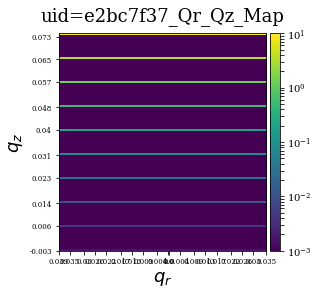

In [70]:
if scat_geometry =='gi_saxs':    
    plot_qzr_map(  qr_map, qz_map, inc_x0, ticks = ticks, data= avg_img, uid= uidstr, path = data_dir   )

## Static Analysis for gisaxs

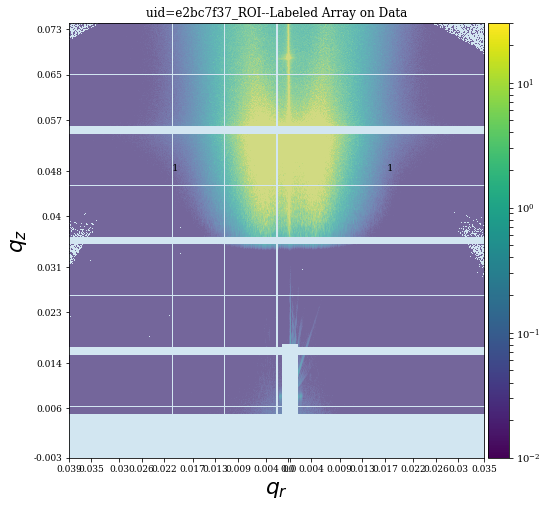

In [71]:
if scat_geometry =='gi_saxs':    
    #roi_masks, qval_dicts = get_gisaxs_roi( Qrs, Qzs, qr_map, qz_map, mask= mask )
    show_qzr_roi( avg_img, roi_masks, inc_x0, ticks[:4], alpha=0.5, save=True, path=data_dir, uid=uidstr )

In [72]:
md['incident angle']= md['inc_angle']

In [73]:
%run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/crosscor.py'
%run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Static_analysis_modified_for_CHX.py'
%run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Amplification_factors.py'

%run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/autocor.py'
%run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/partitions.py'
%run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py'


<Figure size 432x288 with 0 Axes>

# Analysis below with Peco's code

## Put in the critical angel of your substrate for computing $q_z^`$ correctly

In [76]:
alpha_c = 0.25*(np.pi/180) #germanium .

# Plot any frame 

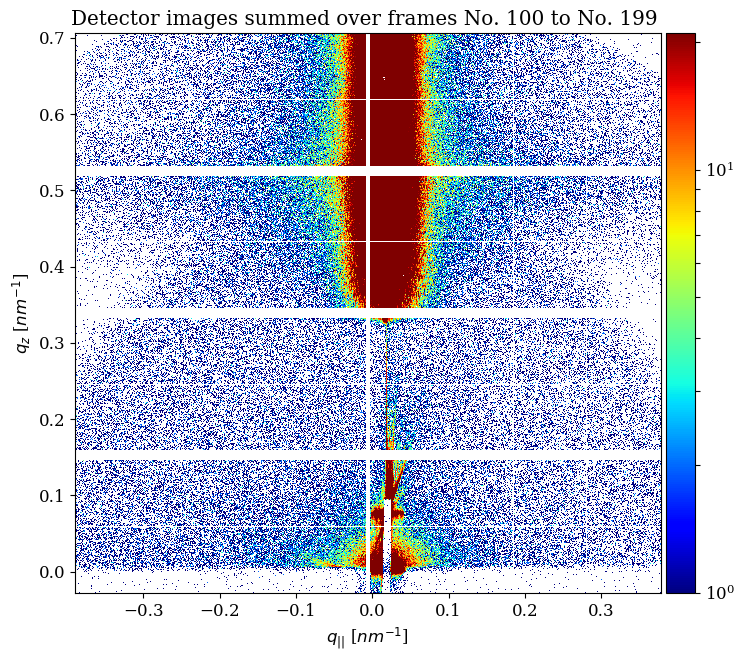

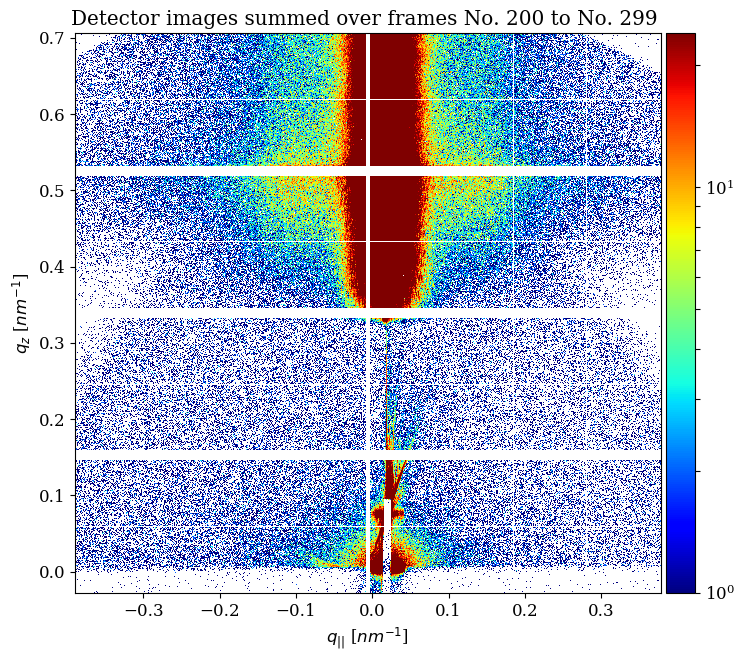

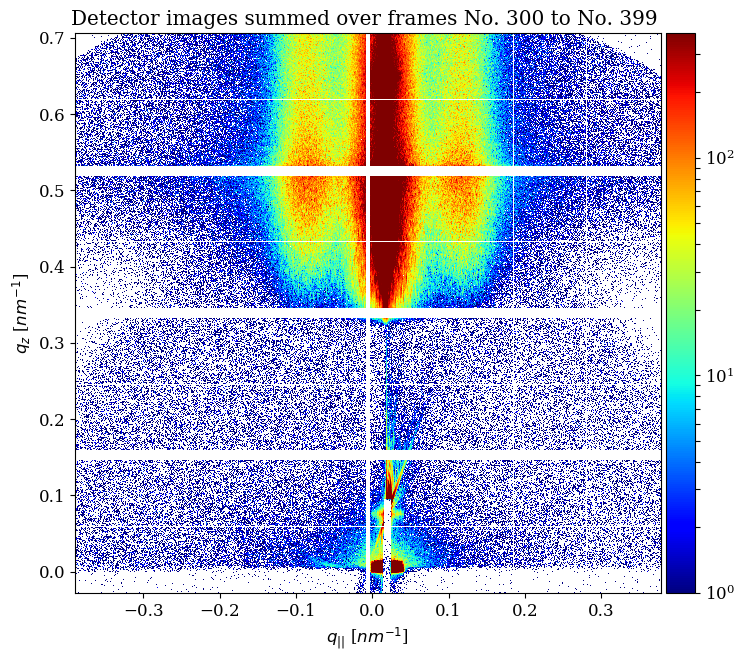

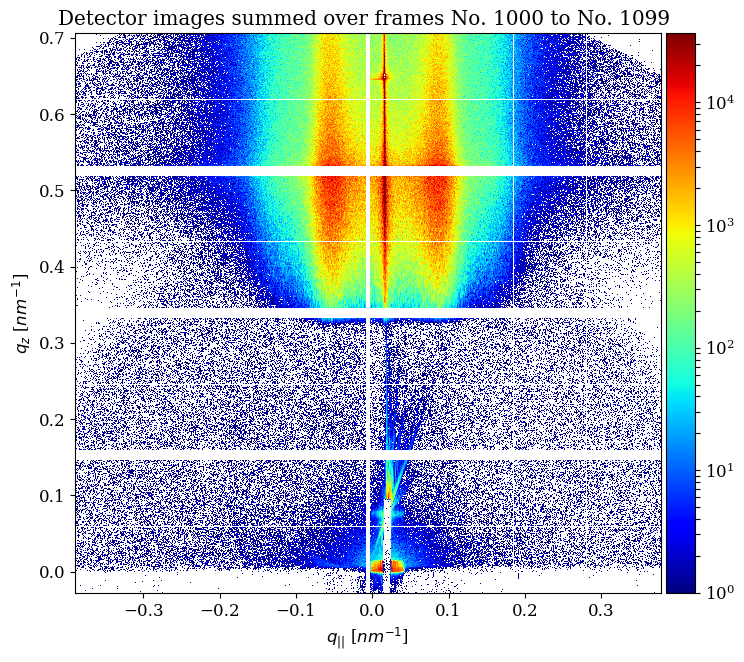

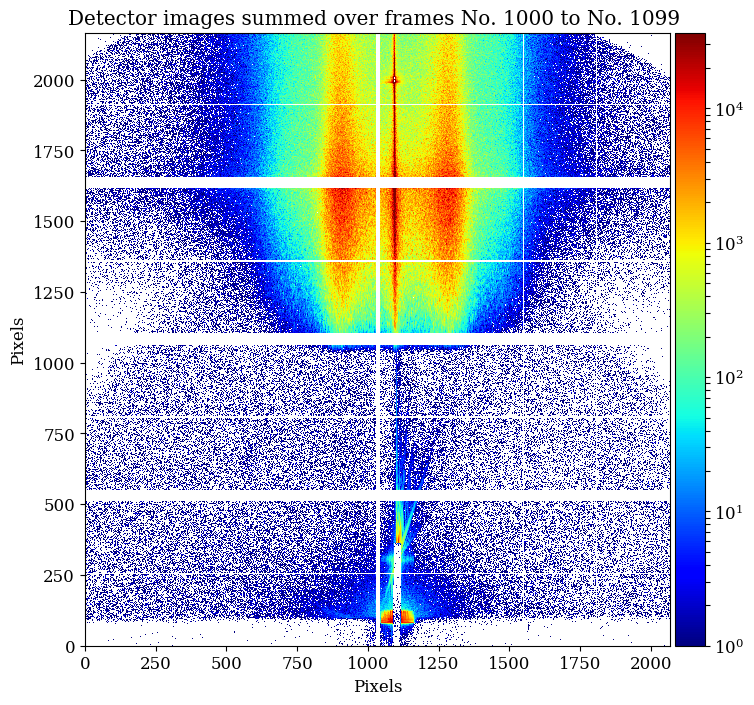

In [149]:
plot_a_detector_image(np.arange(100,200), color_min=1, color_max=0, crop = (None,None,None,None), color_map=plt.cm.jet, save = 0) #cmap=cmap_albula, plt.cm.jet

plot_a_detector_image(np.arange(200,300), color_min=1, color_max=0, crop = (None,None,None,None), color_map=plt.cm.jet, save = 0) #cmap=cmap_albula, plt.cm.jet
plot_a_detector_image(np.arange(300,400), color_min=1, color_max=0, crop = (None,None,None,None), color_map=plt.cm.jet, save = 0) #cmap=cmap_albula, plt.cm.jet

plot_a_detector_image(np.arange(1000,1100), color_min=1, color_max=0, crop = (None,None,None,None), color_map=plt.cm.jet, save = 0) #cmap=cmap_albula, plt.cm.jet

plot_a_detector_image(np.arange(1000,1100), color_min=1, color_max=0, crop = (None,None,None,None), show_q = False, color_map=plt.cm.jet, save = 0) #cmap=cmap_albula, plt.cm.jet


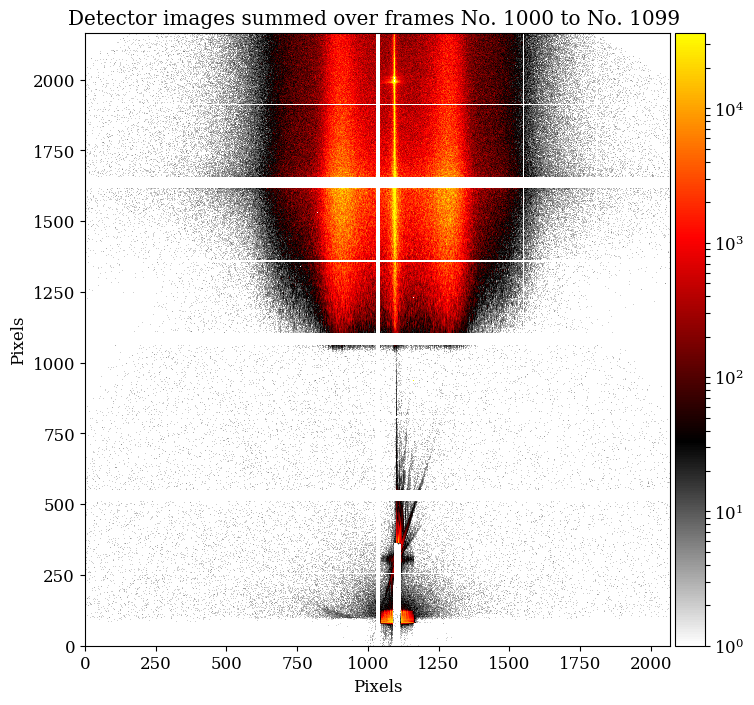

In [150]:
plot_a_detector_image(np.arange(1000,1100), color_min=1, color_max=0, crop = (None,None,None,None), show_q = False, color_map=cmap_albula, save = 0) #cmap=cmap_albula, plt.cm.jet


# Tracking correlation peaks on the left

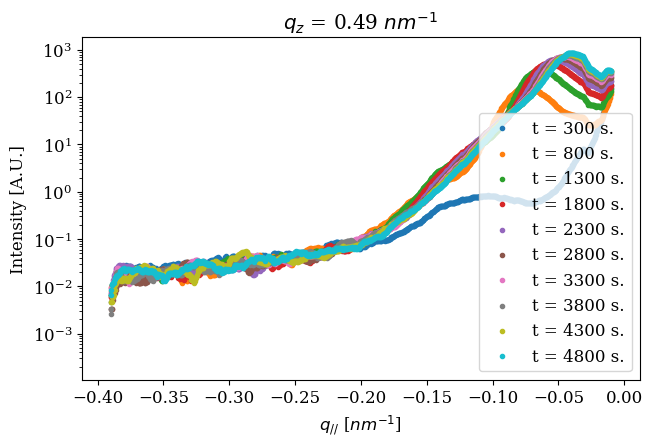

In [282]:
read_and_get_sq_q_at_different_t(select_frames = [], startframe = 300 , endframe = 5000, frame_seperation = 500, bin_num = 4, xslice = [5,1070],  yslice = 1450, SG = True, box_size  = 39, polynomial_order = 1, logscale = True)    


<Figure size 720x445 with 0 Axes>

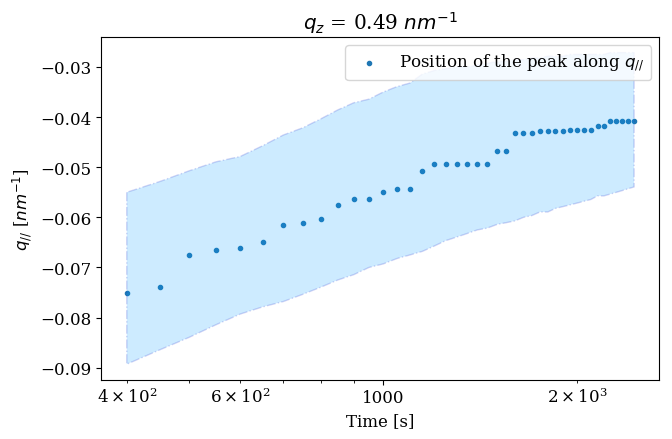

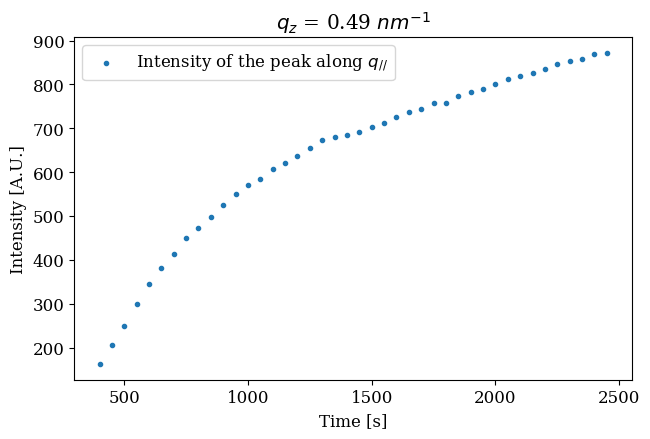

In [161]:
%run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Static_analysis_modified_for_CHX.py'

times,qs,lowbounds,highbounds, Imaxs = read_and_get_sq_peak_q_at_different_t(select_frames = [], startframe = 800 , endframe = 5000, frame_seperation = 100, bin_num = 4, xslice = [5,1070],  yslice = 1450, SG = True, box_size  = 39, polynomial_order = 1, logscale = True)    


# Tracking correlation peaks on the left

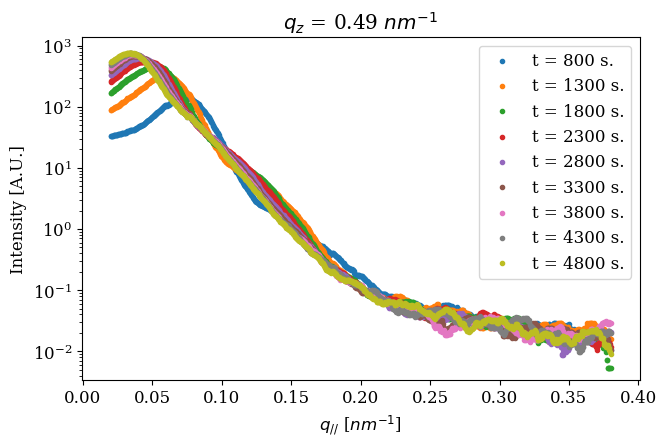

In [283]:
read_and_get_sq_q_at_different_t(select_frames = [], startframe = 800 , endframe = 5000, frame_seperation = 500, bin_num = 4, xslice = [1170,2160],  yslice = 1450, SG = True, box_size  = 39, polynomial_order = 1, logscale = True)    


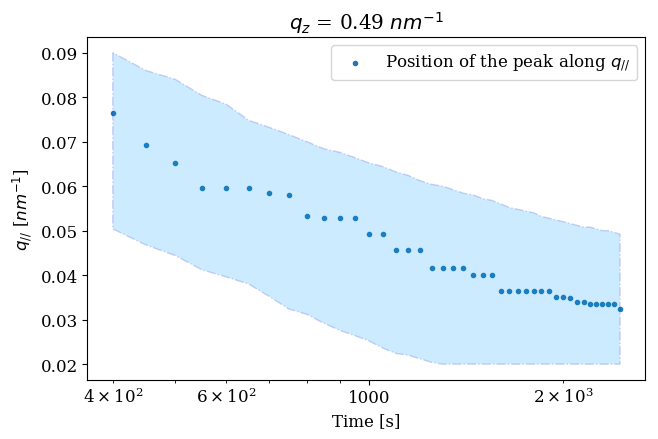

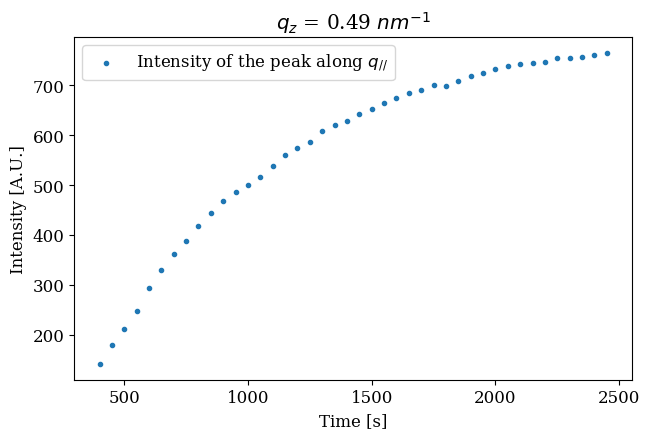

In [280]:
times,qs,lowbounds,highbounds, Imaxs = read_and_get_sq_peak_q_at_different_t(select_frames = [], startframe = 800 , endframe = 5000, frame_seperation = 100, bin_num = 4, xslice = [1170,2160],  yslice = 1450, SG = True, box_size  = 39, polynomial_order = 1, logscale = True)    


# Plotting log scale 

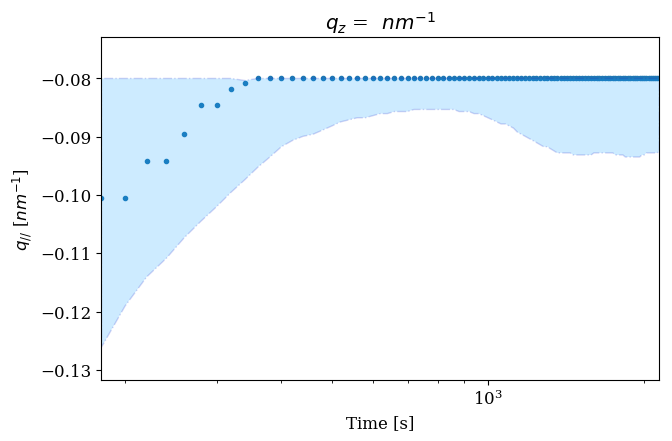

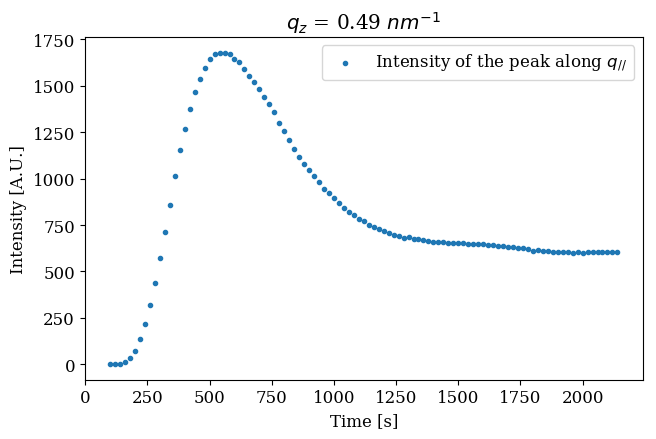

In [157]:

from matplotlib.ticker import ScalarFormatter
import matplotlib.ticker as ticker
fig, ax = plt.subplots()
ax.scatter(times, qs, marker = '.', label=r'Position of the peak along $q_{//}$') 
ax.fill_between(np.asarray(times[4:]), np.asarray(lowbounds[4:]), np.asarray(highbounds[4:]), alpha=0.2, edgecolor='#1B2ACC', facecolor='#089FFF',linewidth=1, linestyle='dashdot', antialiased=True) 
plt.title(r'$q_z$ = '+ r' $nm^{-1}$')
ax.set_ylabel(r'$q_{//}$ [$nm^{-1}$]')
ax.set_xlabel(r'Time [s]')
# ax.legend(loc='best')
ax.set_xlim(times[4],times[-1])
ax.set_xscale('log')
# ax.xaxis.set_major_formatter(ScalarFormatter())
# ax.ticklabel_format(useOffset=True, style='plain')
# ax.set_xticks(np.arange(times[0],times[-1],(times[-1]-times[0])//5).tolist())
# tickspositions = np.arange(times[0],times[-1],(times[-1]-times[0])//5).tolist()
# ax.xaxis.set_major_formatter(ticker.FixedFormatter((tickspositions)))

plt.show()

plt.figure()
plt.scatter(times, Imaxs, marker = '.', label=r'Intensity of the peak along $q_{//}$') 
plt.title(r'$q_z$ = ' + np.str_(np.round(convert_pixel_to_q(0,1450)[2],decimals=2)) + r' $nm^{-1}$')
plt.ylabel('Intensity [A.U.]')
plt.xlabel(r'Time [s]')
plt.legend(loc='best')
#     plt.gca().set_ylim(1, 40000.0)
#     plt.yscale('log')
plt.show()

In [94]:
from datetime import datetime
a  = datetime.now()

AttributeError: type object 'datetime.datetime' has no attribute 'seconds'

In [93]:
b = datetime.now()
print(b-a)

0:00:52.482497


# Linear theory analysis

In [77]:
md

{'suid': 'e2bc7f37',
 'filename': '/nsls2/xf11id1/data/2019/08/17/48451e1a-d4dd-4eec-acc7_6735_master.h5',
 'detector': 'eiger4m_single_image',
 'eiger4m_single_cam_acquire_period': 0.5,
 'eiger4m_single_cam_acquire_time': 0.49999698996543884,
 'eiger4m_single_cam_num_images': 5160,
 'eiger4m_single_beam_center_x': 1100.0,
 'eiger4m_single_beam_center_y': 2089.0,
 'eiger4m_single_wavelength': 1.2848103046417236,
 'eiger4m_single_det_distance': 10.333484865000003,
 'eiger4m_single_threshold_energy': 6400.0,
 'eiger4m_single_photon_energy': 9650.0,
 'eiger4m_single_stats1_configuration_names': ['eiger4m_single_stats1_configuration_names',
  'eiger4m_single_stats1_port_name',
  'eiger4m_single_stats1_asyn_pipeline_config',
  'eiger4m_single_stats1_blocking_callbacks',
  'eiger4m_single_stats1_enable',
  'eiger4m_single_stats1_nd_array_port',
  'eiger4m_single_stats1_plugin_type',
  'eiger4m_single_stats1_bgd_width',
  'eiger4m_single_stats1_centroid_threshold',
  'eiger4m_single_stats1_co

In [75]:
md['beam voltage'] = '1keV'

In [79]:
uid

'e2bc7f37'

/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Static_analysis_modified_for_CHX.py:290: RuntimeWarning: overflow encountered in multiply
  return a * np.exp(2*b*x) + c
/opt/conda_envs/analysis-2018-2.1/lib/python3.6/site-packages/scipy/optimize/minpack.py:785: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)
/opt/conda_envs/analysis-2018-2.1/lib/python3.6/site-packages/scipy/optimize/minpack.py:719: RuntimeWarning: divide by zero encountered in true_divide
  transform = 1.0 / sigma



uid was defined. Saving in respective folder


<Figure size 720x445 with 0 Axes>

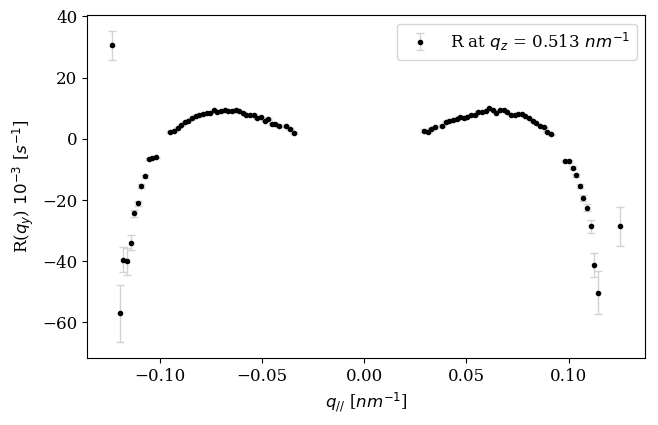

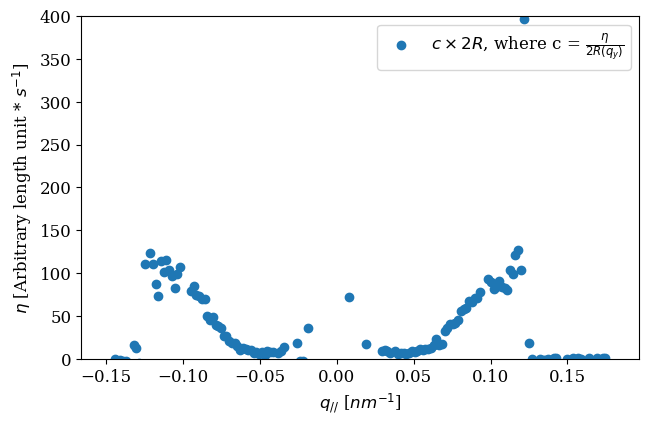

uid was defined. Saving in respective folder


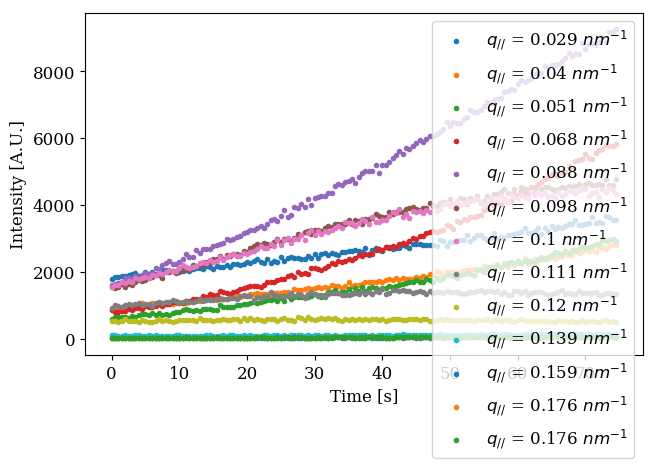

uid was defined. Saving in respective folder


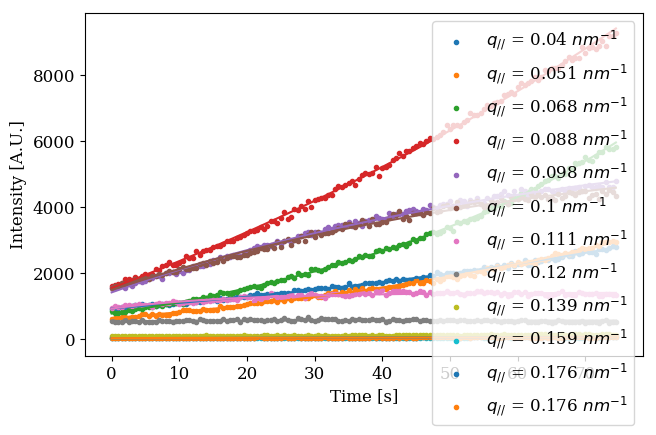

In [116]:
import tqdm as tqdm
%run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Static_analysis_modified_for_CHX.py'
Rs_normal1, Is_normal1, qs_normal1 ,params1, params_co1, chi1 = read_and_get_R_along_q_parallel(yslicestart=1450,ysliceend=1600,xslicestart=690,xsliceend=1600,delx=5,startframe=400,endframe=550, p0_values = [1.3,0.01,100.1], Structure_factor_correction = 1)
pt = [0,-1]
# plt.figure()
# plt.scatter(qs_normal1[pt[0]:pt[1],0],params1[pt[0]:pt[1],1]*1E3)
# plt.ylabel(r'R($q_{y}$) $10^{-3}$ [$s^{-1}$]')
# plt.xlabel(r'$q_{//}$ [$nm^{-1}$]')
# # plt.ylim(-0.04*1E3,0.01*1E3)
# plt.show()


plotRs(Rs_normal1)

plt.figure()
plt.scatter(qs_normal1[pt[0]:pt[1],0],-1*params1[pt[0]:pt[1],2]*(2*params1[pt[0]:pt[1],1]), label = r'$c\times2R$, where c = $\frac{\eta}{2R(q_{y})}$')
# plt.ylim(-1000,2)
plt.ylim(0,400)

plt.ylabel(r'$\eta$ [Arbitrary length unit * $s^{-1}$]')
plt.xlabel(r'$q_{//}$ [$nm^{-1}$]')
plt.legend(loc='best')
plt.show()
plot_intensity_for_all_pixel_box(Rs_normal1, Is_normal1, qs_normal1,select = True, select_q = [0.03,0.04,0.05,0.068,0.088,0.0988,0.1, 0.11, 0.12,0.14,0.16,0.18,0.2])
fit_intensity_for_all_pixel_box(Rs_normal1, Is_normal1, qs_normal1 ,params1 ,select = True, select_q = [0.04,0.05,0.068,0.088,0.0988,0.1, 0.11, 0.12,0.14,0.16,0.18,0.2])

uid was defined. Saving in respective folder


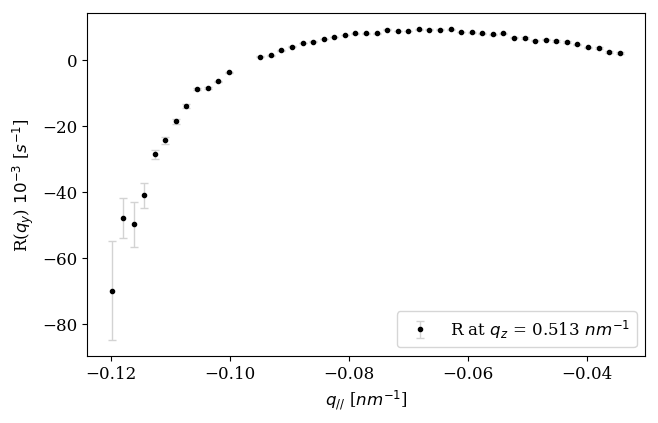

uid was defined. Saving in respective folder


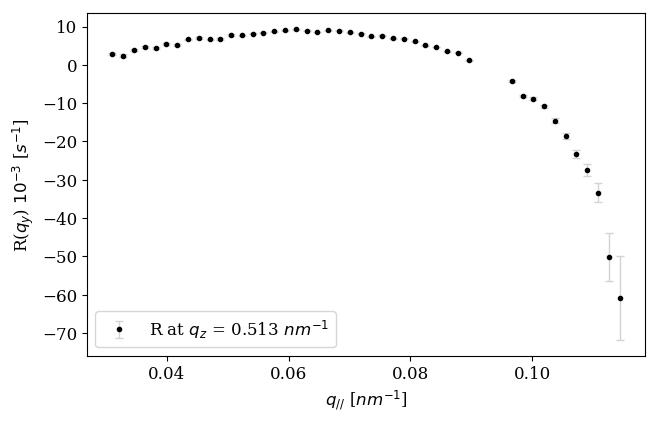

Plotting the left hand side 
uid was defined. Saving in respective folder


<Figure size 720x445 with 0 Axes>

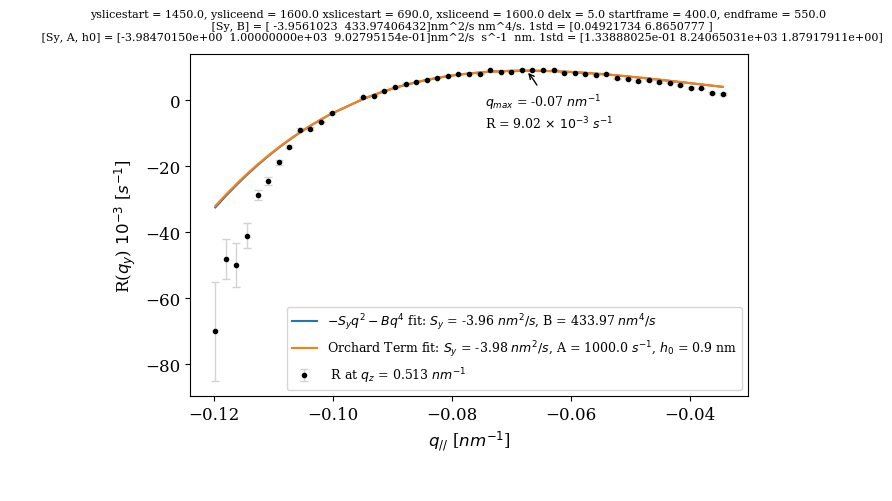

Plotting the left hand side without error bars
uid was defined. Saving in respective folder


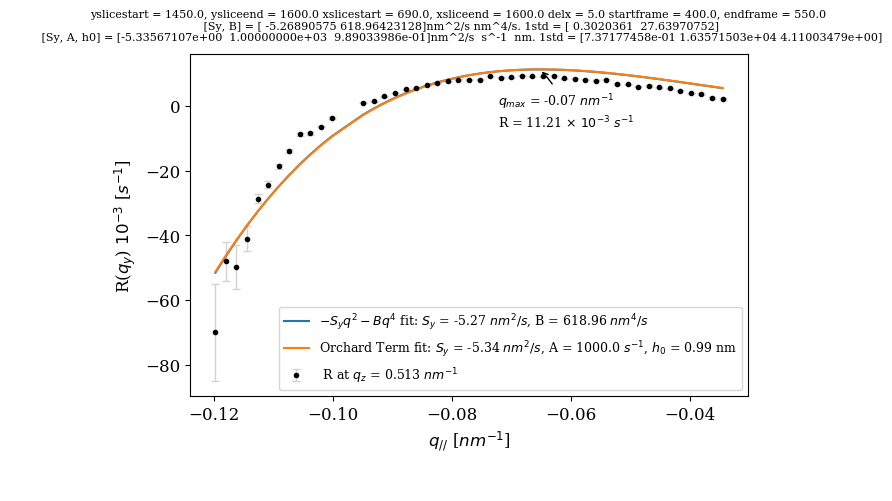

Plotting the right hand side 
uid was defined. Saving in respective folder


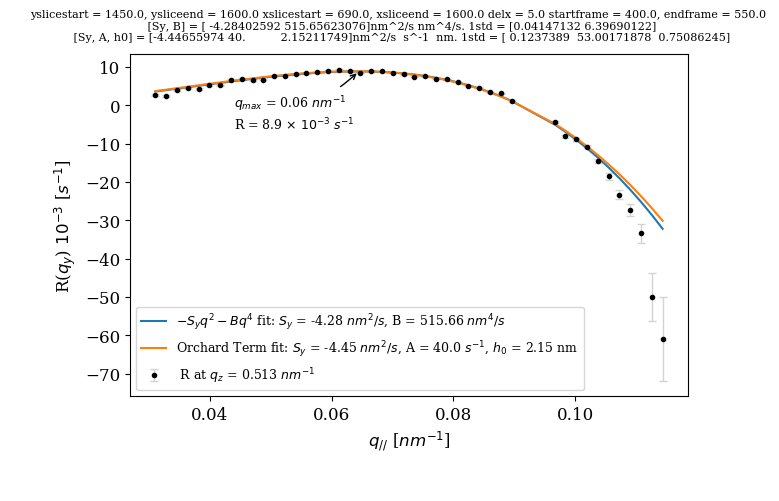

In [118]:
plotRs(Rs_normal_copy[8:67])
plotRs(Rs_normal_copy[71:-20])
%run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Amplification_factors.py'
Rs_copy = Rs_normal_copy[8:67]
Rs_copy[:15,3] = Rs_normal1[:15,3] # keep the metadata

Rs_copy1 = Rs_normal_copy[71:-20]
Rs_copy1[:15,3] = Rs_normal1[:15,3] # keep the metadata
print('Plotting the left hand side ')
plotandfit_R([Rs_copy],long_wave_restrict=False,long_wave_sy = 10.2, orchard=True,orchard_restrict=False,orchard_sy= -.44, orchard_po = [105.23,1],orchard_bounds=([-100.0,0.0,0.7],[100.0,1000.0,1.0]))
print('Plotting the left hand side without error bars')
plotandfit_R([Rs_copy],long_wave_restrict=False,long_wave_sy = 10.2, orchard=True,orchard_restrict=False,orchard_sy= -.44, use_errors = False, orchard_po = [105.23,1],orchard_bounds=([-100.0,0.0,0.7],[100.0,1000.0,1.0]))
print('Plotting the right hand side ')
plotandfit_R([Rs_copy1],long_wave_restrict=False,long_wave_sy = 10.2, orchard=True,orchard_restrict=False,orchard_sy= -.44, orchard_po = [105.23,1],orchard_bounds=([-100.0,0.0,0],[100.0,40.0,10.0]))


uid was defined. Saving in respective folder


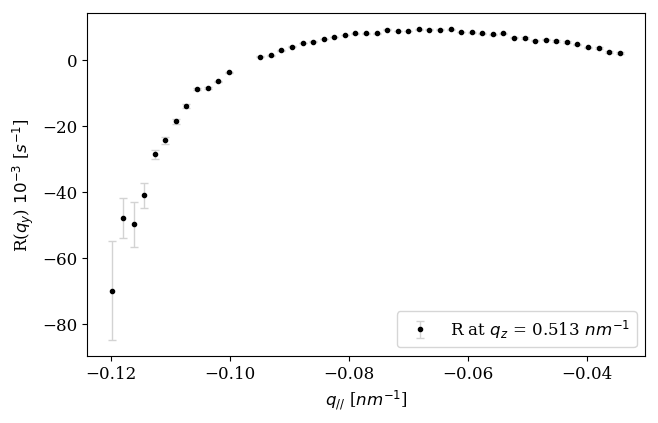

uid was defined. Saving in respective folder


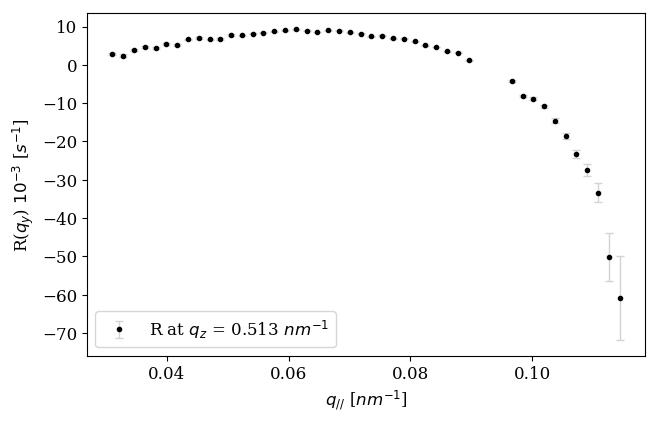

Plotting the left hand side 
uid was defined. Saving in respective folder


<Figure size 720x445 with 0 Axes>

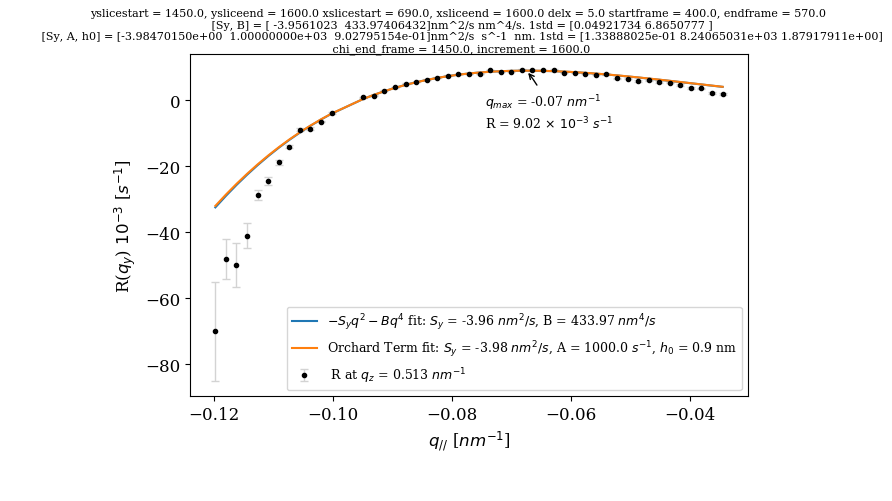

Plotting the left hand side without error bars
uid was defined. Saving in respective folder


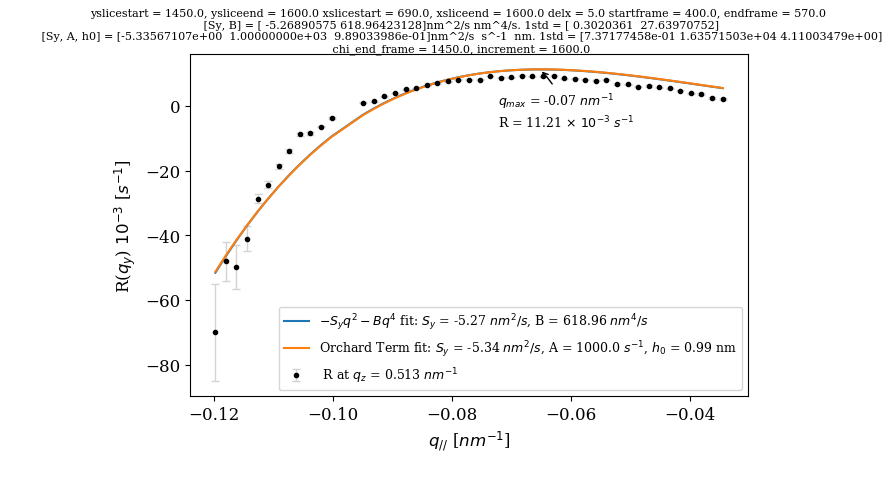

Plotting the right hand side 
uid was defined. Saving in respective folder


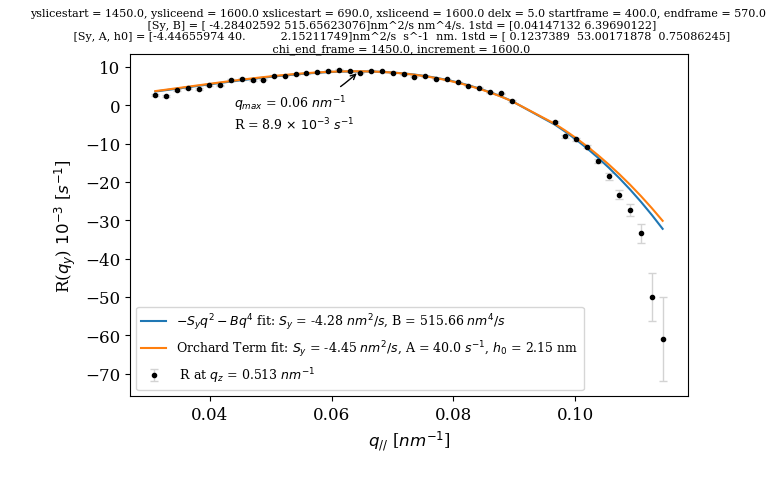

In [114]:
# plotRs(Rs_normal_copy[8:67])
# plotRs(Rs_normal_copy[71:-20])
# %run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Amplification_factors.py'
# Rs_copy = Rs_normal_copy[8:67]
# Rs_copy[:15,3] = Rs_normal1[:15,3] # keep the metadata

# Rs_copy1 = Rs_normal_copy[71:-20]
# Rs_copy1[:15,3] = Rs_normal1[:15,3] # keep the metadata
# print('Plotting the left hand side ')
# plotandfit_R([Rs_copy],long_wave_restrict=False,long_wave_sy = 10.2, orchard=True,orchard_restrict=False,orchard_sy= -.44, orchard_po = [105.23,1],orchard_bounds=([-100.0,0.0,0.7],[100.0,1000.0,1.0]))
# print('Plotting the left hand side without error bars')
# plotandfit_R([Rs_copy],long_wave_restrict=False,long_wave_sy = 10.2, orchard=True,orchard_restrict=False,orchard_sy= -.44, use_errors = False, orchard_po = [105.23,1],orchard_bounds=([-100.0,0.0,0.7],[100.0,1000.0,1.0]))
# print('Plotting the right hand side ')
# plotandfit_R([Rs_copy1],long_wave_restrict=False,long_wave_sy = 10.2, orchard=True,orchard_restrict=False,orchard_sy= -.44, orchard_po = [105.23,1],orchard_bounds=([-100.0,0.0,0],[100.0,40.0,10.0]))


# Spline fitting. Already incorporated into TTCF calculation 

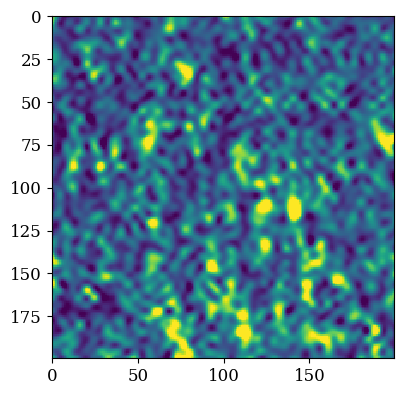

0:00:01.249917 0:00:01.054851 0:00:00.195066


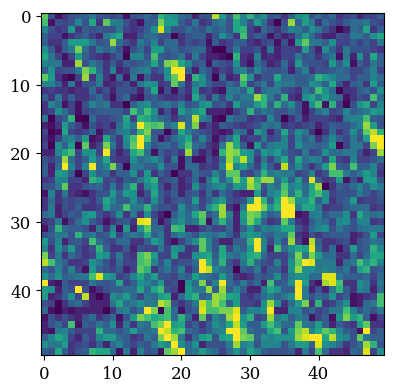

In [112]:
# from scipy import interpolate
# from datetime import datetime

# b0  = datetime.now()

# img_shape = md['img_shape']
# x = np.arange(0, img_shape[1], 1)
# y = np.arange(0, img_shape[0], 1)
# xx, yy = np.meshgrid(x, y)
# z = a[yy,xx] #np.sin(xx**2+yy**2)
# f = interpolate.interp2d(x, y, z, kind='quintic')

# b1  = datetime.now()

# # xnew = np.arange(0, img_shape[1], 0.25)
# # ynew = np.arange(0, img_shape[0], 0.25)
# # znew = f(xnew, ynew)
# # plt.plot()
# # plt.imshow(znew,vmin=0,vmax=10)
# # plt.show()

# xnew = np.arange(820, 870, 0.25)
# ynew = np.arange(1450, 1500, 0.25)
# znew = f(xnew, ynew)
# plt.plot()
# plt.imshow(znew,vmin=0,vmax=20)
# plt.show()

# b  = datetime.now()
# print(b-b0,b1-b0,b-b1)

# plt.plot()
# plt.imshow(a[1450:1500,820:870],vmin=0,vmax=20)
# plt.show()

# Make sure all the speckles are moving in unison and only along $q_z$ direction


[-0.142 -0.134 -0.127 -0.119 -0.111 -0.104 -0.096 -0.088 -0.081 -0.073
 -0.066 -0.058 -0.05  -0.043 -0.035]


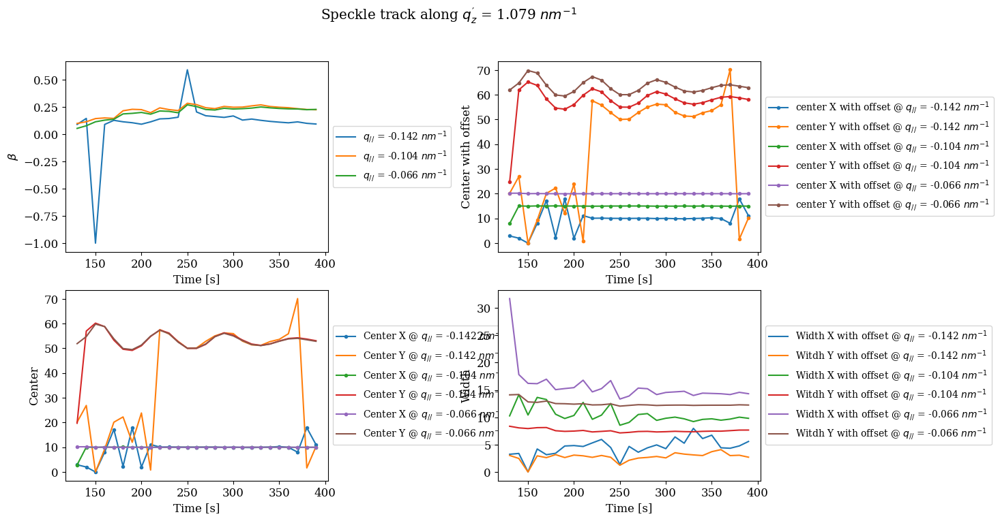


[-0.142 -0.134 -0.127 -0.119 -0.111 -0.104 -0.096 -0.088 -0.081 -0.073
 -0.066 -0.058 -0.05  -0.043 -0.035]


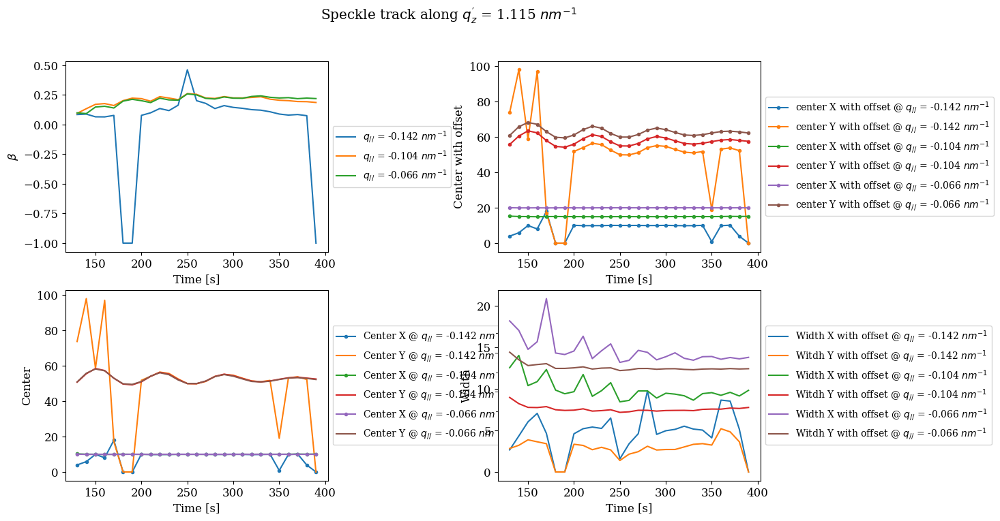


[-0.142 -0.138 -0.134 -0.131 -0.127 -0.123 -0.12  -0.116 -0.112 -0.109
 -0.105 -0.101 -0.098 -0.094 -0.09  -0.087 -0.083 -0.079 -0.076 -0.072
 -0.068 -0.065 -0.061 -0.057 -0.054 -0.05  -0.046 -0.042 -0.039 -0.035]


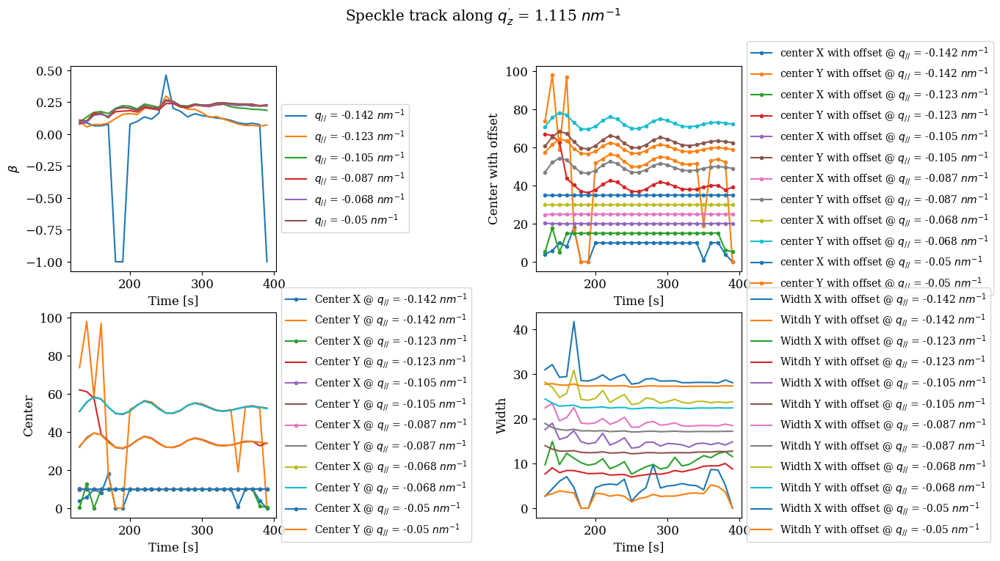

In [87]:
res0=track_speckle(startY = 1350,endY = 1451,delY = 100,startX = 700,endX = 1001,delX= 20,startframe=260,endframe=800, refframe=500,skip_ROI_every___frame=5,Xlogscale= False, normalize = 1, bin_frame = 20, SG_frame = 5, SG_order = 1, SG_box_size = 23, interpolater_on = False)
res1=track_speckle(startY = 1450,endY = 1551,delY = 100,startX = 700,endX = 1001,delX= 20,startframe=260,endframe=800, refframe=500,skip_ROI_every___frame=5,Xlogscale= False, normalize = 1, bin_frame = 20, SG_frame = 5, SG_order = 1, SG_box_size = 23, interpolater_on = False)
res2=track_speckle(startY = 1450,endY = 1651,delY = 100,startX = 700,endX = 1001,delX= 20,startframe=260,endframe=800, refframe=500,skip_ROI_every___frame=5,Xlogscale= False, normalize = 1, bin_frame = 20, SG_frame = 5, SG_order = 1, SG_box_size = 23, interpolater_on = False)



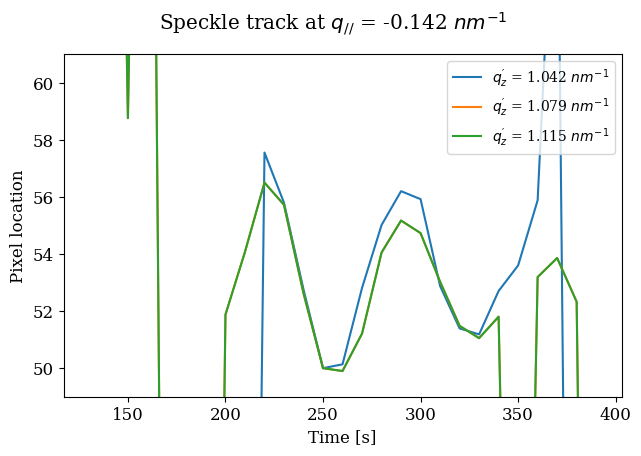

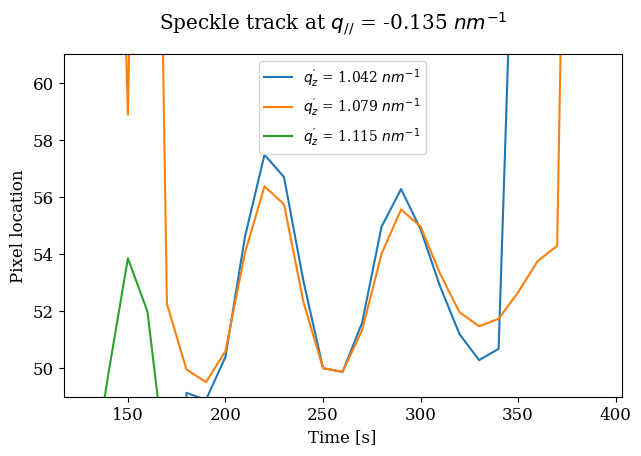

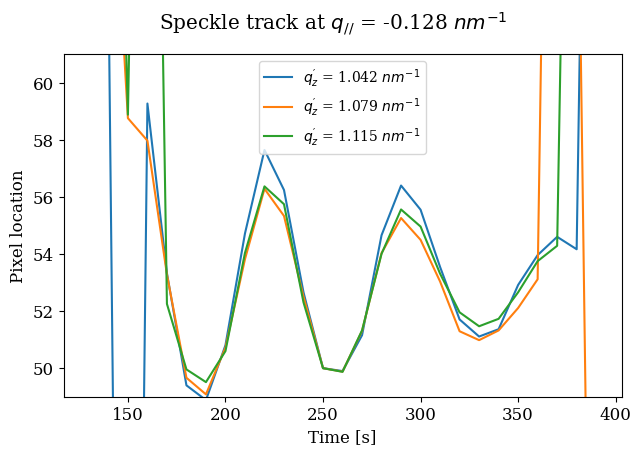

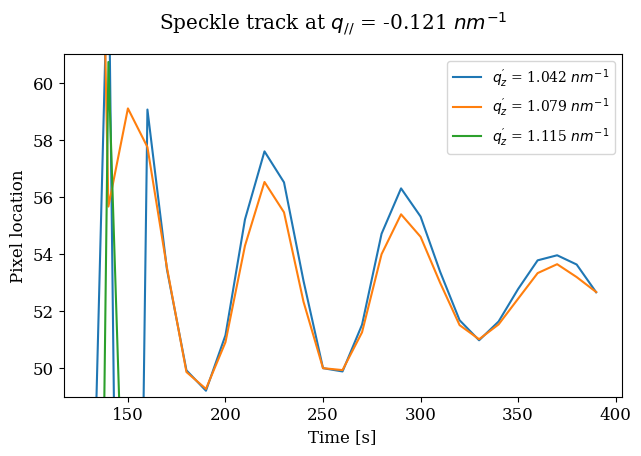

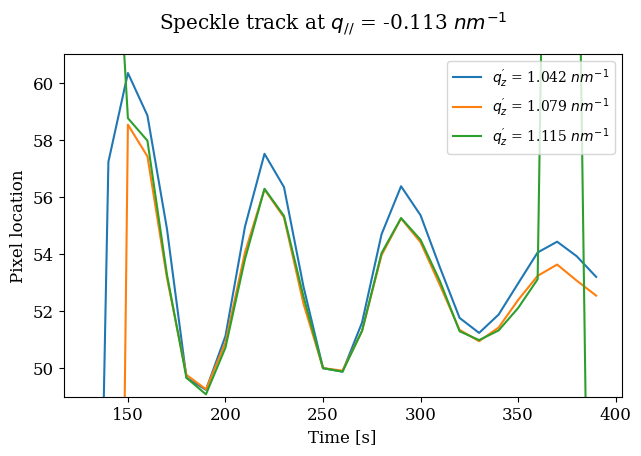

...

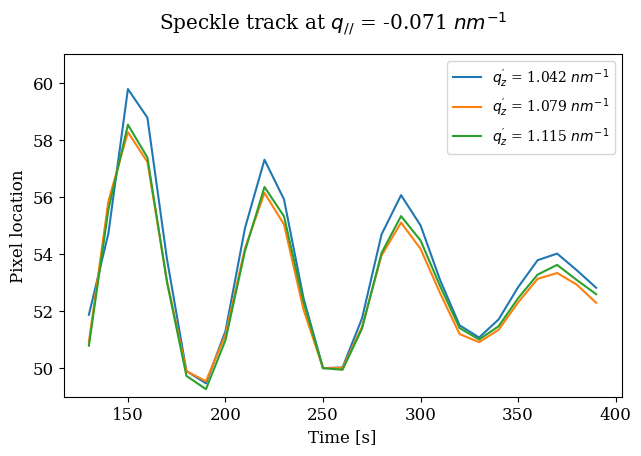

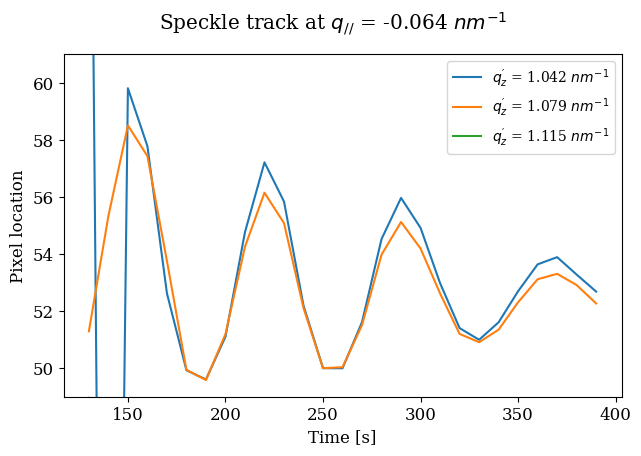

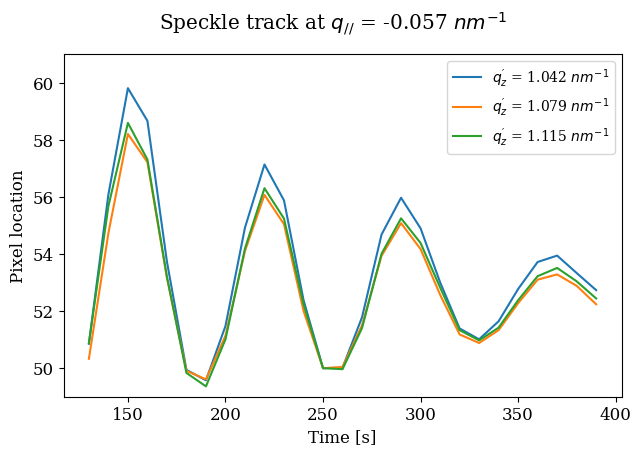

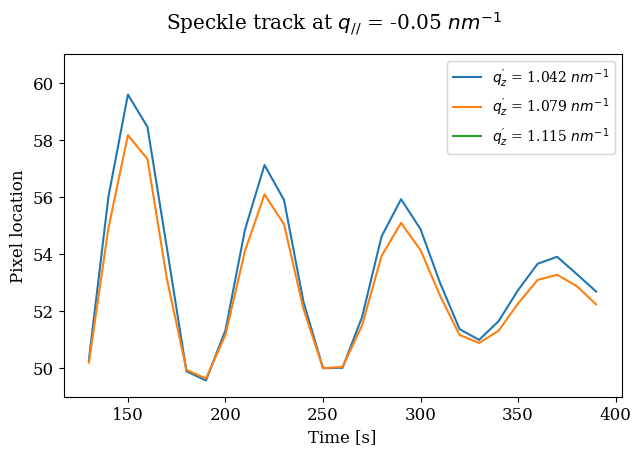

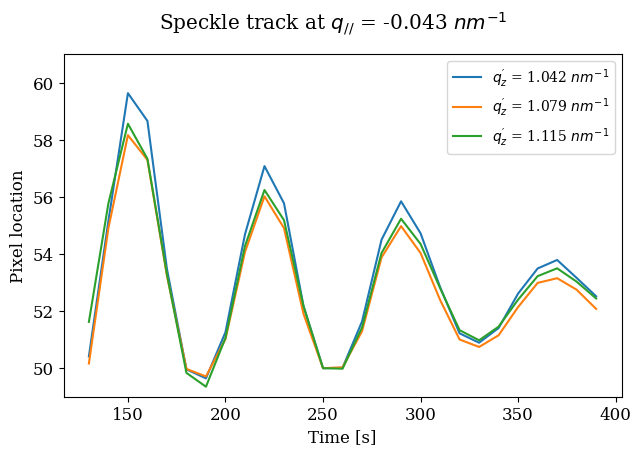

In [103]:
for i in range(15):
    plt.figure()
    plt.plot(res0[0],res0[1][i,:,1],label=r'$q_{z}^′$ = %s'%np.round(convert_pixel_to_q(630,1300)[7],decimals=3)+ r' $nm^{-1}$')
    plt.plot(res0[0],res1[1][i,:,1],label=r'$q_{z}^′$ = %s'%np.round(convert_pixel_to_q(630,1400)[7],decimals=3)+ r' $nm^{-1}$')
    plt.plot(res0[0],res2[1][i,:,1],label=r'$q_{z}^′$ = %s'%np.round(convert_pixel_to_q(630,1500)[7],decimals=3)+ r' $nm^{-1}$')
    # plt.plot(res4[1][0,:,1][9:-2],label='5')
    plt.legend(loc='best')
    plt.xlabel('Time [s]')
    plt.ylabel('Pixel location')
    plt.ylim(49,61)
    plt.suptitle(r"Speckle track at $q_{//}$ = %s"%np.round(convert_pixel_to_q(700+i*20,1500)[1],decimals=3)+ r' $nm^{-1}$')
    plt.show()

# Determine speckle movement and then compute TTCF with dynamic ROI

100%|██████████| 5120/5120 [03:26<00:00, 24.83it/s]


[-0.071]


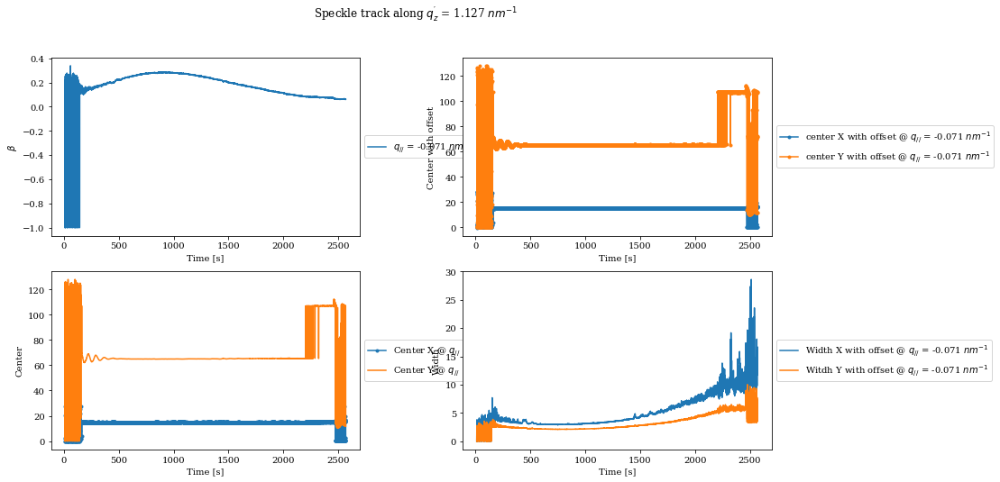

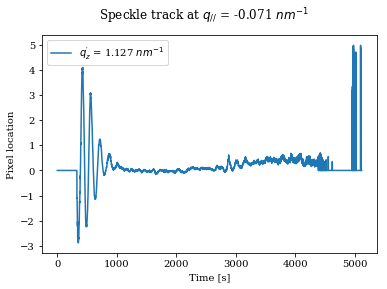

5120
5120


  7%|▋         | 302/4061 [00:49<10:12,  6.14it/s]


 15%|█▍        | 604/4061 [01:37<09:19,  6.18it/s]


 22%|██▏       | 906/4061 [02:26<08:29,  6.19it/s]


 30%|██▉       | 1204/4061 [03:14<07:41,  6.19it/s]


 37%|███▋      | 1500/4061 [04:01<06:52,  6.21it/s]


 44%|████▍     | 1796/4061 [04:51<06:07,  6.17it/s]


 52%|█████▏    | 2092/4061 [05:40<05:20,  6.15it/s]


 59%|█████▉    | 2388/4061 [06:29<04:32,  6.13it/s]


 66%|██████▌   | 2684/4061 [07:18<03:45,  6.12it/s]


 73%|███████▎  | 2980/4061 [08:07<02:56,  6.11it/s]


 81%|████████  | 3276/4061 [08:57<02:08,  6.09it/s]


 88%|████████▊ | 3572/4061 [09:46<01:20,  6.09it/s]


 95%|█████████▌| 3868/4061 [10:35<00:31,  6.09it/s]


100%|██████████| 1/1 [11:11<00:00, 671.50s/it]


<Figure size 720x445 with 0 Axes>

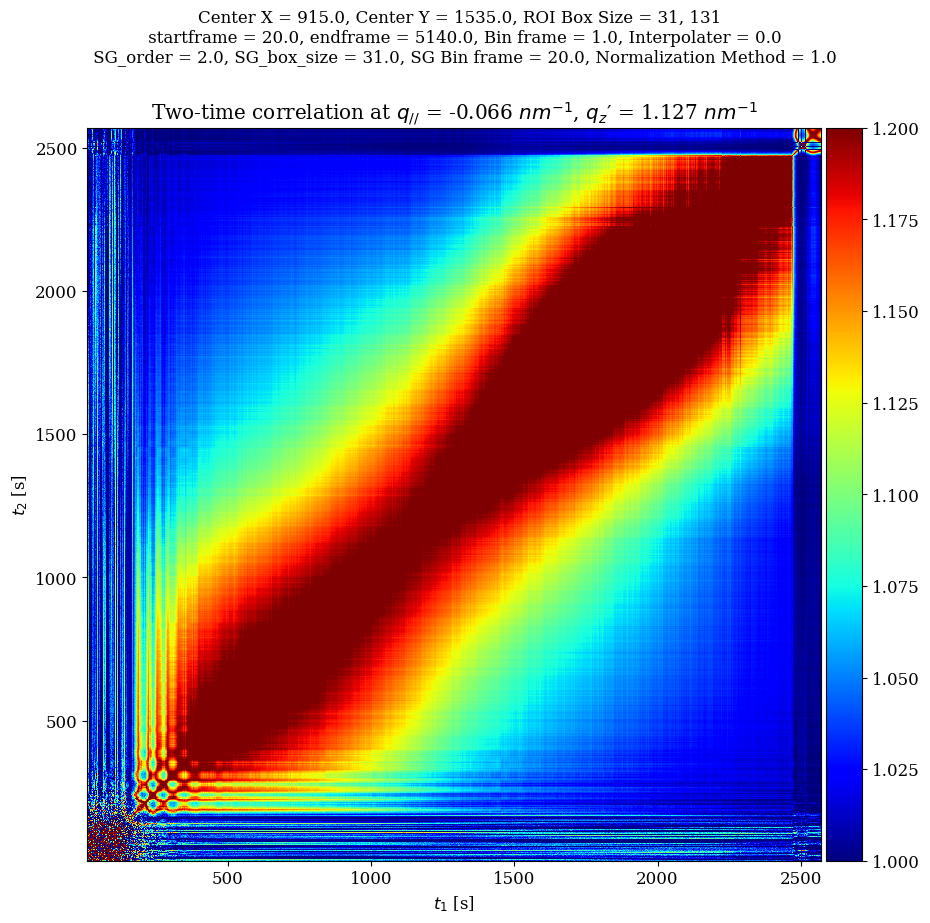

In [115]:
from tqdm import tqdm
from tqdm import tqdm
a_startY = 1470
a_endY = 1601
a_delY = 130
a_startX = 900
a_endX = 931
a_delX= 30
a_startframe=20
a_endframe=5140
a_refframe=1500

res1=track_speckle(startY = a_startY,endY = a_endY,delY = a_delY,startX = a_startX,endX = a_endX,delX= a_delX,startframe=a_startframe,endframe=a_endframe, refframe=a_refframe,skip_ROI_every___frame=5,Xlogscale= False, normalize = 1, bin_frame = 1, SG_frame = 5, SG_order = 1, SG_box_size = 23, interpolater_on = False)
%matplotlib inline
positions = res1[1][0,:,1]
position_temps = np.zeros((a_endframe-a_startframe)//1)
position_temps[330:] = positions[330:]-a_delY//2

a = np.where(position_temps>5)[0]
position_temps[a] = 0
a = np.where(position_temps<-5)[0]
position_temps[a] = 0

plt.figure()
# plt.plot(res0[0],res0[1][i,:,1],label=r'$q_{z}^′$ = %s'%np.round(convert_pixel_to_q(630,1300)[7],decimals=3)+ r' $nm^{-1}$')
plt.plot(position_temps,label=r'$q_{z}^′$ = %s'%np.round(convert_pixel_to_q(a_startX,(a_startY+a_endY)//2)[7],decimals=3)+ r' $nm^{-1}$')
# plt.plot(res0[0],res2[1][i,:,1],label=r'$q_{z}^′$ = %s'%np.round(convert_pixel_to_q(630,1500)[7],decimals=3)+ r' $nm^{-1}$')
# plt.plot(res4[1][0,:,1][9:-2],label='5')
plt.legend(loc='best')
plt.xlabel('Time [s]')
plt.ylabel('Pixel location')
# plt.ylim(40,60)
plt.suptitle(r"Speckle track at $q_{//}$ = %s"%np.round(convert_pixel_to_q(a_startX,(a_startY+a_endY)//2)[1],decimals=3)+ r' $nm^{-1}$')
plt.show()

%run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py'
position_temps = position_temps*(-1)
position_temps = position_temps.tolist()
print(len(position_temps))
# position_temps = position_temps[5:]+position_temps[:5]
print(len(position_temps))
position_temps = np.asarray(position_temps)

from tqdm import tqdm
CenterXs,Inor_all,TTCF2, TTCFs = None, None, None, None
del CenterXs,Inor_all,TTCF2, TTCFs 

CenterXs,Inor_all, contrasts, Windows = collect_normalize(startframe = a_startframe ,endframe = a_endframe , centerx_start = a_startX+a_delX//2, centerx_end = a_endX+a_delX//2, centery = (a_startY+a_endY)//2,peak_in_X = 940, boxsize = (a_delX+1,a_delY+1), bin_frame = 1, normalize = 1, SG_window = 31, SG_order = 2,  SG_bin_frame = 20, interpolate = 0,dynamical_ROI_relative_positions=position_temps, discrete_rel_pos = False, moving_ref_frame = False)
TTCF2, TTCFs = TTCF(CenterXs,Inor_all)
for i in range(len(TTCFs)):
    plotTTCF(TTCFs[i], color_min = 1 , color_max = 1.20, save = 0)

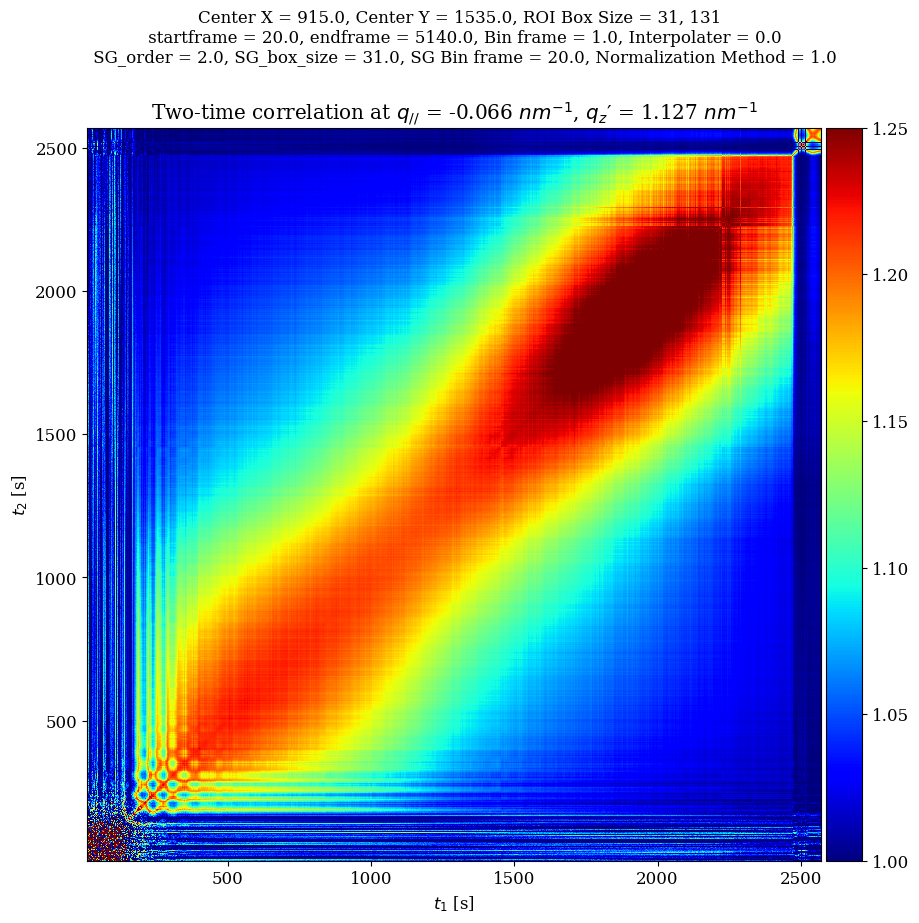

In [124]:
# %matplotlib notebook
%matplotlib inline
%run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py'


for i in range(len(TTCFs)):
    plotTTCF(TTCFs[i], color_min = 1 , color_max = 1.25, save = 0)

### slices for the above TTCF

In [ ]:
import glob
import os

#finding the latest TTCF 

dirs = '/home/pmyint/'+uid+'_'

def all_subdirs_of(b='.'):
  result = []
  for d in os.listdir(b):
    bd = os.path.join(b, d)
    if os.path.isdir(bd): result.append(bd)
  return result
latest_subdir = max(all_subdirs_of(b=dirs), key=os.path.getmtime) 
print(latest_subdir)

list_of_files = glob.glob(latest_subdir +'/*') # * means all if need specific format then *.csv
latest_file = max(list_of_files, key=os.path.getctime)
print(latest_file)

# then slicing through the latest TTCF to do the analysis
%run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py'
file_path = latest_file
TTCF = np.load(file_path)
TTCF = plotTTCF(TTCF,manual_name = '', color_min = 1 , color_max = 1.25, color_map=plt.cm.jet, save = 0)
values = slicethrough_TTC_and_extract_parameters(file_path, skip_frame = 1, allowance_width=600, plot_fits = 0)
plot_exponents_vs_T(values, manual_name = '', beta = 1, tau = 1, n = 1, baseline = 1, save = 0)

# relative speckle movement positions could also be used to correct vibration issue

In [ ]:
# %run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py'
# res1=track_speckle(startY = 1450,endY = 1551,delY = 100,startX = 700,endX = 1001,delX= 20,startframe=20,endframe=2000, refframe=0,skip_ROI_every___frame=5,Xlogscale= False, normalize = 1, bin_frame = 1, SG_frame = 5, SG_order = 1, SG_box_size = 23, interpolater_on = False)
# plt.figure()
# # plt.plot(res0[0],res0[1][i,:,1],label=r'$q_{z}^′$ = %s'%np.round(convert_pixel_to_q(630,1300)[7],decimals=3)+ r' $nm^{-1}$')
# plt.plot(res1[1][10,:,1],label=r'$q_{z}^′$ = %s'%np.round(convert_pixel_to_q(630,1400)[7],decimals=3)+ r' $nm^{-1}$')
# # plt.plot(res0[0],res2[1][i,:,1],label=r'$q_{z}^′$ = %s'%np.round(convert_pixel_to_q(630,1500)[7],decimals=3)+ r' $nm^{-1}$')
# # plt.plot(res4[1][0,:,1][9:-2],label='5')
# plt.legend(loc='best')
# plt.xlabel('Time [s]')
# plt.ylabel('Pixel location')
# plt.ylim(40,60)
# plt.suptitle(r"Speckle track at $q_{//}$ = %s"%np.round(convert_pixel_to_q(700+20,1500)[1],decimals=3)+ r' $nm^{-1}$')
# plt.show()

In [ ]:
# positions = res1[1][10,:,1]
# plt.figure()
# # plt.plot(res0[0],res0[1][i,:,1],label=r'$q_{z}^′$ = %s'%np.round(convert_pixel_to_q(630,1300)[7],decimals=3)+ r' $nm^{-1}$')
# plt.plot(positions[320:]-50,label=r'$q_{z}^′$ = %s'%np.round(convert_pixel_to_q(630,1400)[7],decimals=3)+ r' $nm^{-1}$')
# # plt.plot(res0[0],res2[1][i,:,1],label=r'$q_{z}^′$ = %s'%np.round(convert_pixel_to_q(630,1500)[7],decimals=3)+ r' $nm^{-1}$')
# # plt.plot(res4[1][0,:,1][9:-2],label='5')
# plt.legend(loc='best')
# plt.xlabel('Time [s]')
# plt.ylabel('Pixel location')
# # plt.ylim(40,60)
# plt.suptitle(r"Speckle track at $q_{//}$ = %s"%np.round(convert_pixel_to_q(700*20,1500)[1],decimals=3)+ r' $nm^{-1}$')
# plt.show()

# position_temps = np.zeros((2000-20)//1)
# position_temps[375:] = positions[375:]-50

# plt.figure()
# # plt.plot(res0[0],res0[1][i,:,1],label=r'$q_{z}^′$ = %s'%np.round(convert_pixel_to_q(630,1300)[7],decimals=3)+ r' $nm^{-1}$')
# plt.plot(position_temps,label=r'$q_{z}^′$ = %s'%np.round(convert_pixel_to_q(630,1400)[7],decimals=3)+ r' $nm^{-1}$')
# # plt.plot(res0[0],res2[1][i,:,1],label=r'$q_{z}^′$ = %s'%np.round(convert_pixel_to_q(630,1500)[7],decimals=3)+ r' $nm^{-1}$')
# # plt.plot(res4[1][0,:,1][9:-2],label='5')
# plt.legend(loc='best')
# plt.xlabel('Time [s]')
# plt.ylabel('Pixel location')
# # plt.ylim(40,60)
# plt.suptitle(r"Speckle track at $q_{//}$ = %s"%np.round(convert_pixel_to_q(700*20,1500)[1],decimals=3)+ r' $nm^{-1}$')
# plt.show()

In [ ]:
from tqdm import tqdm
from tqdm import tqdm
a_startY = 1470
a_endY = 1601
a_delY = 130
a_startX = 900
a_endX = 931
a_delX= 30
a_startframe=20
a_endframe=5140
a_refframe=0

res1=track_speckle(startY = a_startY,endY = a_endY,delY = a_delY,startX = a_startX,endX = a_endX,delX= a_delX,startframe=a_startframe,endframe=a_endframe, refframe=a_refframe,skip_ROI_every___frame=5,Xlogscale= False, normalize = 1, bin_frame = 1, SG_frame = 5, SG_order = 1, SG_box_size = 23, interpolater_on = False)
%matplotlib inline
positions = res1[1][0,:,1]
position_temps = np.zeros((a_endframe-a_startframe)//1)
position_temps[:] = positions[:]-a_delY//2

a = np.where(position_temps>5)[0]
position_temps[a] = 0
a = np.where(position_temps<-5)[0]
position_temps[a] = 0

plt.figure()
# plt.plot(res0[0],res0[1][i,:,1],label=r'$q_{z}^′$ = %s'%np.round(convert_pixel_to_q(630,1300)[7],decimals=3)+ r' $nm^{-1}$')
plt.plot(position_temps,label=r'$q_{z}^′$ = %s'%np.round(convert_pixel_to_q(a_startX,(a_startY+a_endY)//2)[7],decimals=3)+ r' $nm^{-1}$')
# plt.plot(res0[0],res2[1][i,:,1],label=r'$q_{z}^′$ = %s'%np.round(convert_pixel_to_q(630,1500)[7],decimals=3)+ r' $nm^{-1}$')
# plt.plot(res4[1][0,:,1][9:-2],label='5')
plt.legend(loc='best')
plt.xlabel('Time [s]')
plt.ylabel('Pixel location')
# plt.ylim(40,60)
plt.suptitle(r"Speckle track at $q_{//}$ = %s"%np.round(convert_pixel_to_q(a_startX,(a_startY+a_endY)//2)[1],decimals=3)+ r' $nm^{-1}$')
plt.show()

%run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py'
position_temps = position_temps*(-1)
position_temps = position_temps.tolist()
print(len(position_temps))
# position_temps = position_temps[5:]+position_temps[:5]
print(len(position_temps))
position_temps = np.asarray(position_temps)

from tqdm import tqdm
CenterXs,Inor_all,TTCF2, TTCFs = None, None, None, None
del CenterXs,Inor_all,TTCF2, TTCFs 

CenterXs,Inor_all, contrasts, Windows = collect_normalize(startframe = a_startframe ,endframe = a_endframe , centerx_start = a_startX+a_delX//2, centerx_end = a_endX+a_delX//2, centery = (a_startY+a_endY)//2,peak_in_X = 940, boxsize = (a_delX+1,a_delY+1), bin_frame = 1, normalize = 1, SG_window = 31, SG_order = 2,  SG_bin_frame = 20, interpolate = 0,dynamical_ROI_relative_positions=position_temps, discrete_rel_pos = False, moving_ref_frame = True)
TTCF2, TTCFs = TTCF(CenterXs,Inor_all)
for i in range(len(TTCFs)):
    plotTTCF(TTCFs[i], color_min = 1 , color_max = 1.20, save = 0)

### slices for the TTCF above

In [ ]:
import glob
import os

#finding the latest TTCF 

dirs = '/home/pmyint/'+uid+'_'

def all_subdirs_of(b='.'):
  result = []
  for d in os.listdir(b):
    bd = os.path.join(b, d)
    if os.path.isdir(bd): result.append(bd)
  return result
latest_subdir = max(all_subdirs_of(b=dirs), key=os.path.getmtime) 
print(latest_subdir)

list_of_files = glob.glob(latest_subdir +'/*') # * means all if need specific format then *.csv
latest_file = max(list_of_files, key=os.path.getctime)
print(latest_file)

# then slicing through the latest TTCF to do the analysis
%run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py'
file_path = latest_file
TTCF = np.load(file_path)
TTCF = plotTTCF(TTCF,manual_name = '', color_min = 1 , color_max = 1.25, color_map=plt.cm.jet, save = 0)
values = slicethrough_TTC_and_extract_parameters(file_path, skip_frame = 1, allowance_width=600, plot_fits = 0)
plot_exponents_vs_T(values, manual_name = '', beta = 1, tau = 1, n = 1, baseline = 1, save = 0)

# Orignal TTCF

  7%|▋         | 302/4061 [00:50<10:30,  5.96it/s]


 15%|█▍        | 604/4061 [01:39<09:31,  6.05it/s]


 22%|██▏       | 906/4061 [02:29<08:41,  6.05it/s]


 30%|██▉       | 1204/4061 [03:18<07:51,  6.06it/s]


 37%|███▋      | 1500/4061 [04:07<07:02,  6.07it/s]


 44%|████▍     | 1796/4061 [05:42<07:11,  5.24it/s]


 52%|█████▏    | 2092/4061 [07:20<06:54,  4.75it/s]


 59%|█████▉    | 2388/4061 [08:41<06:05,  4.58it/s]


 66%|██████▌   | 2684/4061 [09:32<04:53,  4.69it/s]


 73%|███████▎  | 2980/4061 [10:24<03:46,  4.77it/s]


 81%|████████  | 3276/4061 [11:29<02:45,  4.75it/s]


 88%|████████▊ | 3572/4061 [12:26<01:42,  4.78it/s]


 95%|█████████▌| 3868/4061 [13:39<00:40,  4.72it/s]


100%|██████████| 1/1 [14:32<00:00, 872.75s/it]


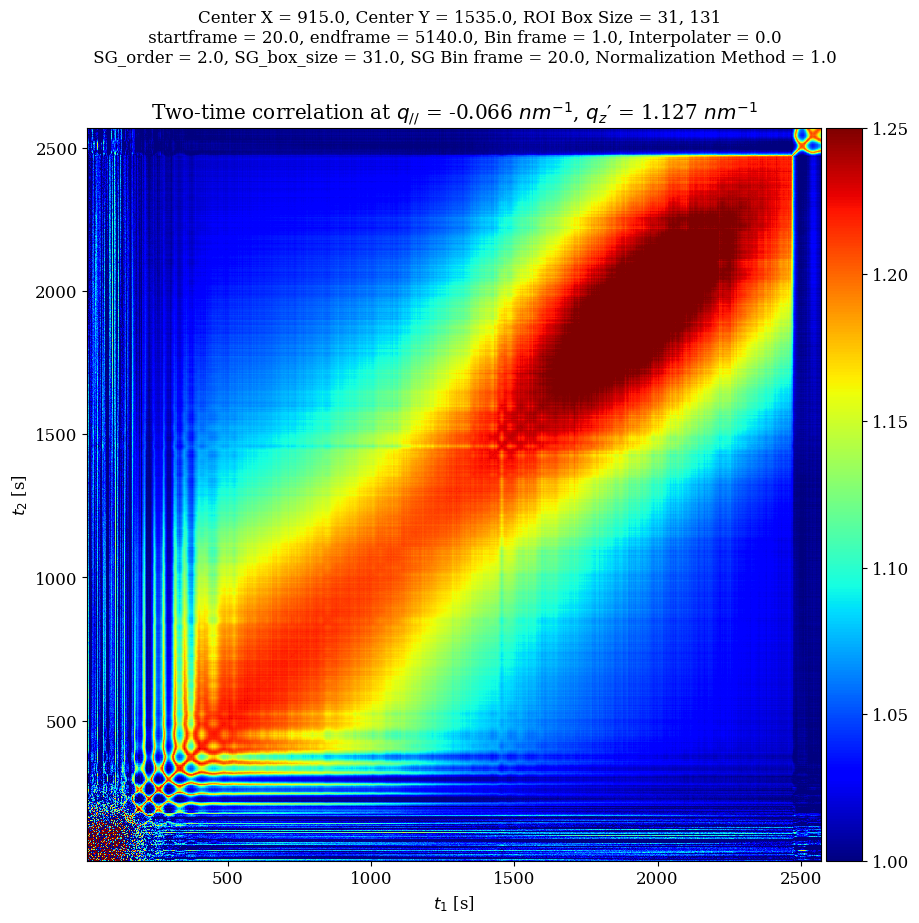

In [125]:
from tqdm import tqdm
CenterXs,Inor_all,TTCF2, TTCFs = None, None, None, None
del CenterXs,Inor_all,TTCF2, TTCFs 

CenterXs,Inor_all, contrasts, Windows = collect_normalize(startframe = a_startframe ,endframe = a_endframe , centerx_start = a_startX+a_delX//2, centerx_end = a_endX+a_delX//2, centery = (a_startY+a_endY)//2,peak_in_X = 940, boxsize = (a_delX+1,a_delY+1), bin_frame = 1, normalize = 1, SG_window = 31, SG_order = 2,  SG_bin_frame = 20, interpolate = 0)#,dynamical_ROI_relative_positions=position_temps, discrete_rel_pos = False, moving_ref_frame = False)
TTCF2, TTCFs = TTCF(CenterXs,Inor_all)
for i in range(len(TTCFs)):
    plotTTCF(TTCFs[i], color_min = 1 , color_max = 1.25, save = 0)

### slices for the TTCF above

In [ ]:
import glob
import os

#finding the latest TTCF 

dirs = '/home/pmyint/'+uid+'_'

def all_subdirs_of(b='.'):
  result = []
  for d in os.listdir(b):
    bd = os.path.join(b, d)
    if os.path.isdir(bd): result.append(bd)
  return result
latest_subdir = max(all_subdirs_of(b=dirs), key=os.path.getmtime) 
print(latest_subdir)

list_of_files = glob.glob(latest_subdir +'/*') # * means all if need specific format then *.csv
latest_file = max(list_of_files, key=os.path.getctime)
print(latest_file)

# then slicing through the latest TTCF to do the analysis
%run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py'
file_path = latest_file
TTCF = np.load(file_path)
TTCF = plotTTCF(TTCF,manual_name = '', color_min = 1 , color_max = 1.25, color_map=plt.cm.jet, save = 0)
values = slicethrough_TTC_and_extract_parameters(file_path, skip_frame = 1, allowance_width=600, plot_fits = 0)
plot_exponents_vs_T(values, manual_name = '', beta = 1, tau = 1, n = 1, baseline = 1, save = 0)

# Do slices through TTCF

/home/pmyint/e2bc7f37_/1.127
/home/pmyint/e2bc7f37_/1.127/TTCF_-0.066_1.127_20200116084151.npy


In [ ]:

# plot everthing in a folder 
# %run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py'

# dirs = '/home/pmyint/8d8c8646_/0.297/'
# TT_plots_list = []
# os.chdir(dirs)
# for file in glob.glob("*.npy"):
#     if np.str_(file)[:10] == 'TTCF_-0.15':
#         TT_plots_list.append(np.str_(file))
# TT_plots_list.sort()


# # TT_plots_list = TT_plots_list[1:]
# %run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py'

# for i in range(len(TT_plots_list)):
#     file_path = dirs + TT_plots_list[i]
#     print( TT_plots_list[i])
#     exponents = slicethrough_TTC_and_extract_parameters(file_path, skip_frame = 1, allowance_width=0, plot_fits = 0)
#     plot_exponents_vs_T(exponents, beta = 1, baseline = 1, n =1, save=0)

# Another alternative way is to move the ROI in a discrete pixel poisition. Not a very good solution. The above method is best 

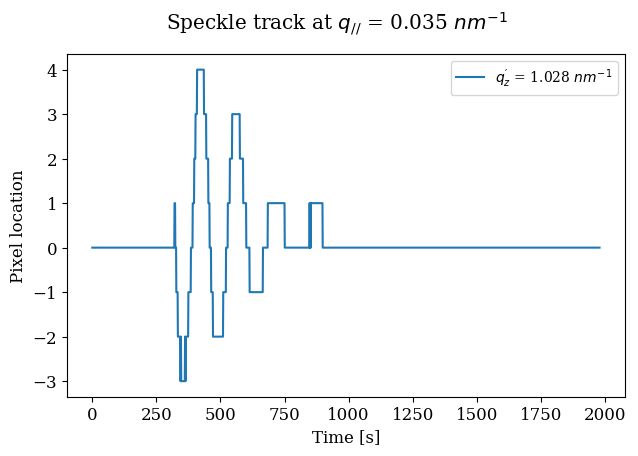

In [159]:
plt.figure()
# plt.plot(res0[0],res0[1][i,:,1],label=r'$q_{z}^′$ = %s'%np.round(convert_pixel_to_q(630,1300)[7],decimals=3)+ r' $nm^{-1}$')
plt.plot(np.round(position_temps,decimals=0),label=r'$q_{z}^′$ = %s'%np.round(convert_pixel_to_q(630,1400)[7],decimals=3)+ r' $nm^{-1}$')
# plt.plot(res0[0],res2[1][i,:,1],label=r'$q_{z}^′$ = %s'%np.round(convert_pixel_to_q(630,1500)[7],decimals=3)+ r' $nm^{-1}$')
# plt.plot(res4[1][0,:,1][9:-2],label='5')
plt.legend(loc='best')
plt.xlabel('Time [s]')
plt.ylabel('Pixel location')
# plt.ylim(40,60)
plt.suptitle(r"Speckle track at $q_{//}$ = %s"%np.round(convert_pixel_to_q(700+i*20,1500)[1],decimals=3)+ r' $nm^{-1}$')
plt.show()

1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1499
1498
1497
1497
1498
1499
1500
1502
1504
1504
1504
1503
1502
1500
1499
1498
1498
1498
1498
1499
1501
1502
1503
1503
1503
1502
1501
1501
1500
1499
1499
1499
1499
1499
1500
1500
1501
1501
1501
1501
1501
1501
1501
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1501
1501
1501
1501
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500
1500



<Figure size 720x445 with 0 Axes>

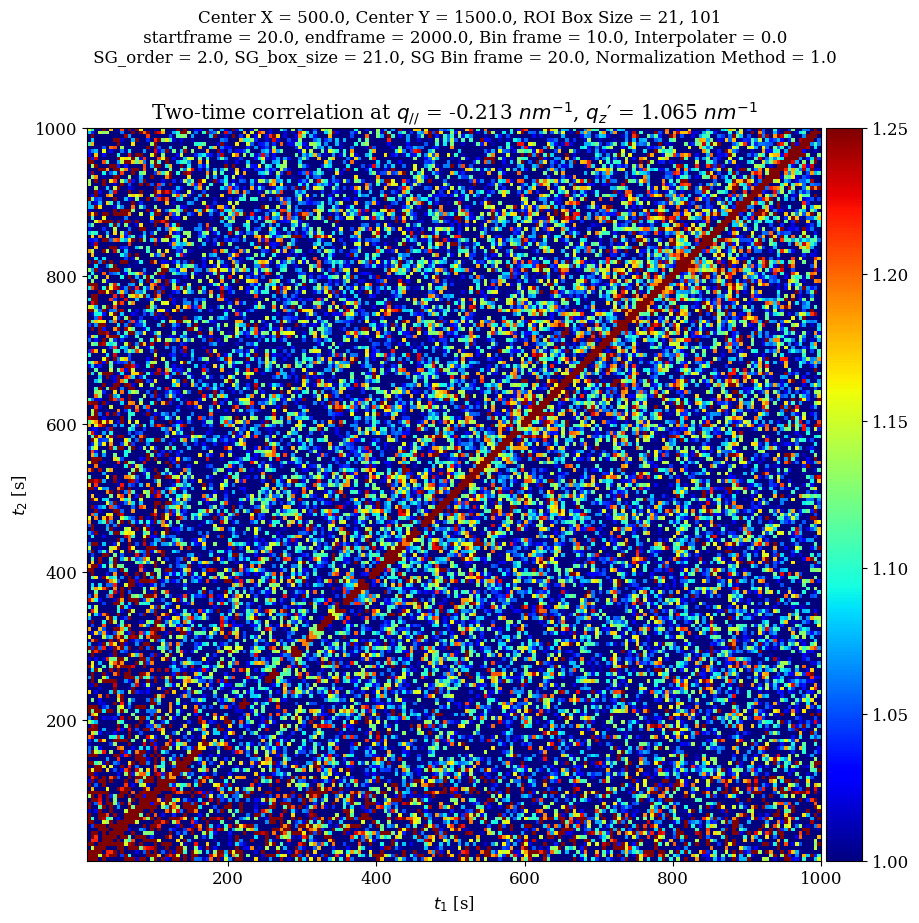

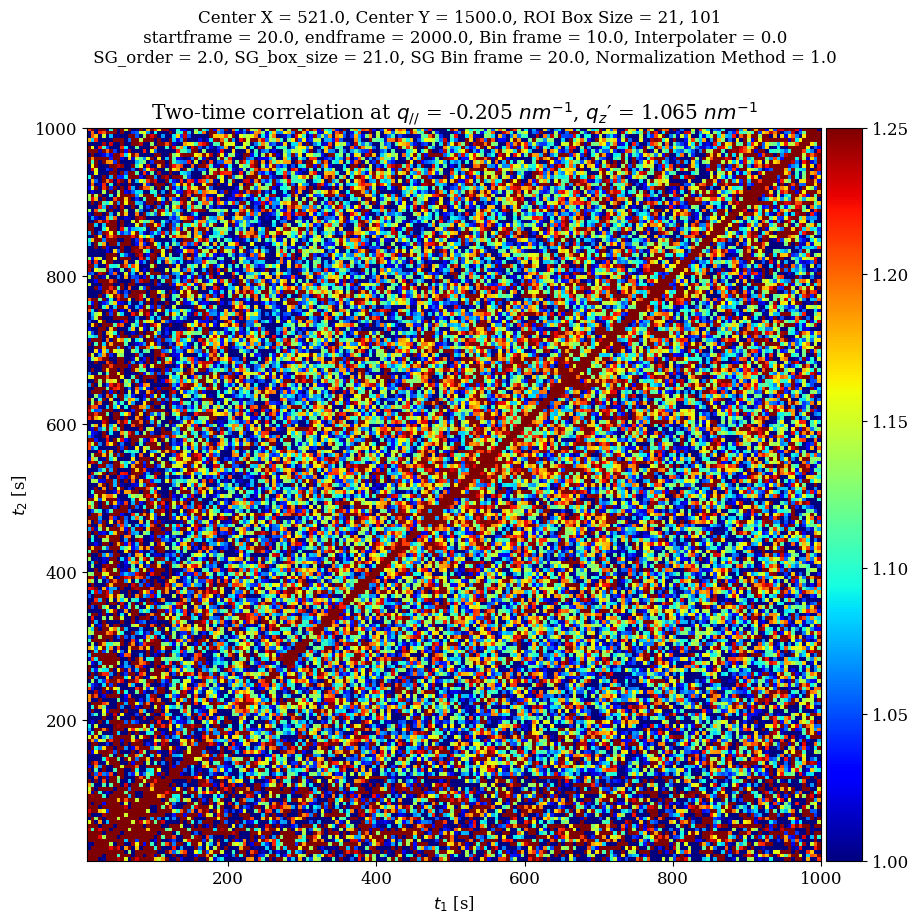

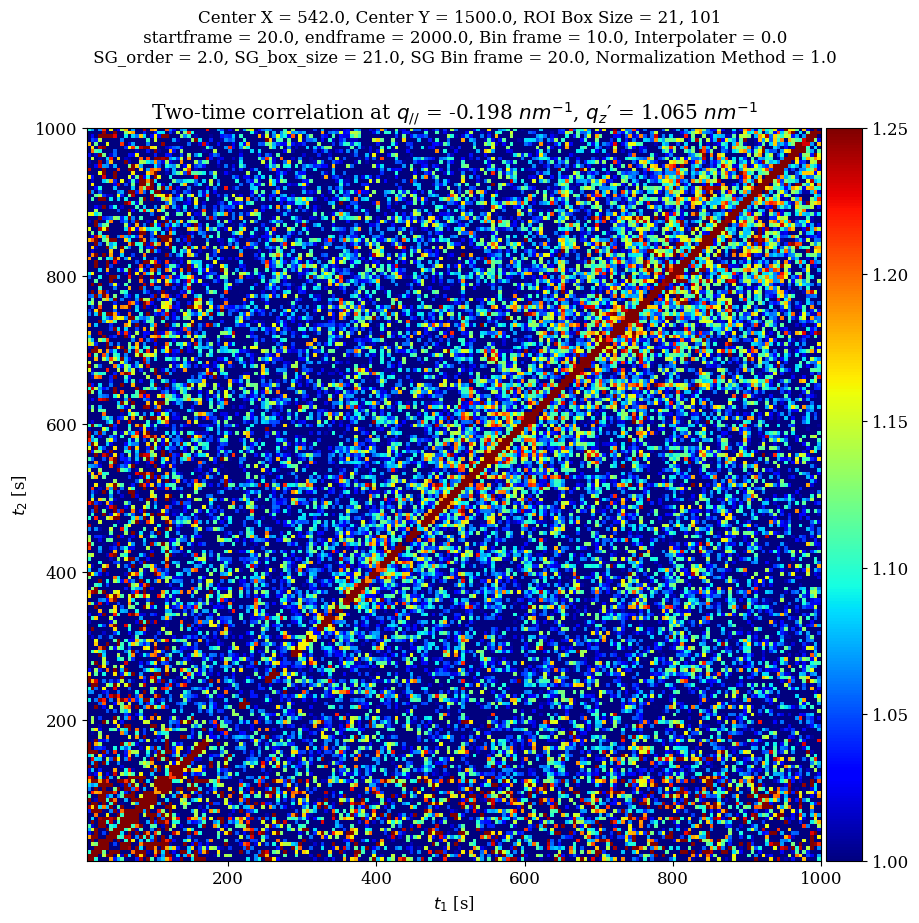

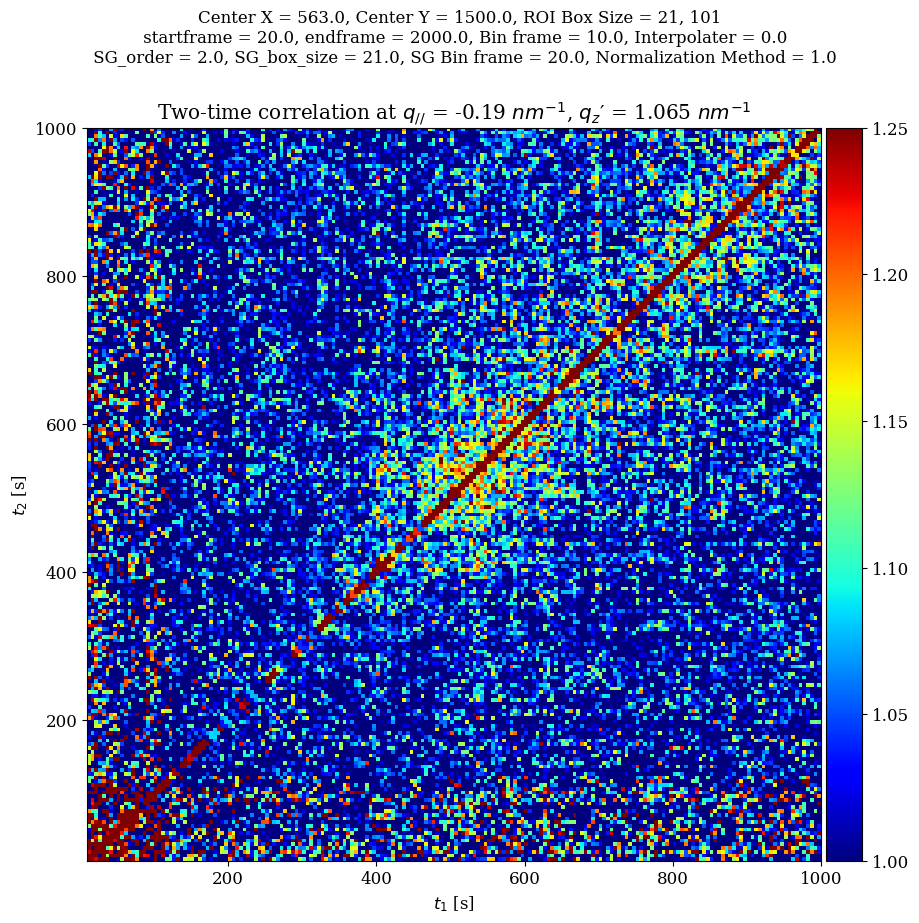

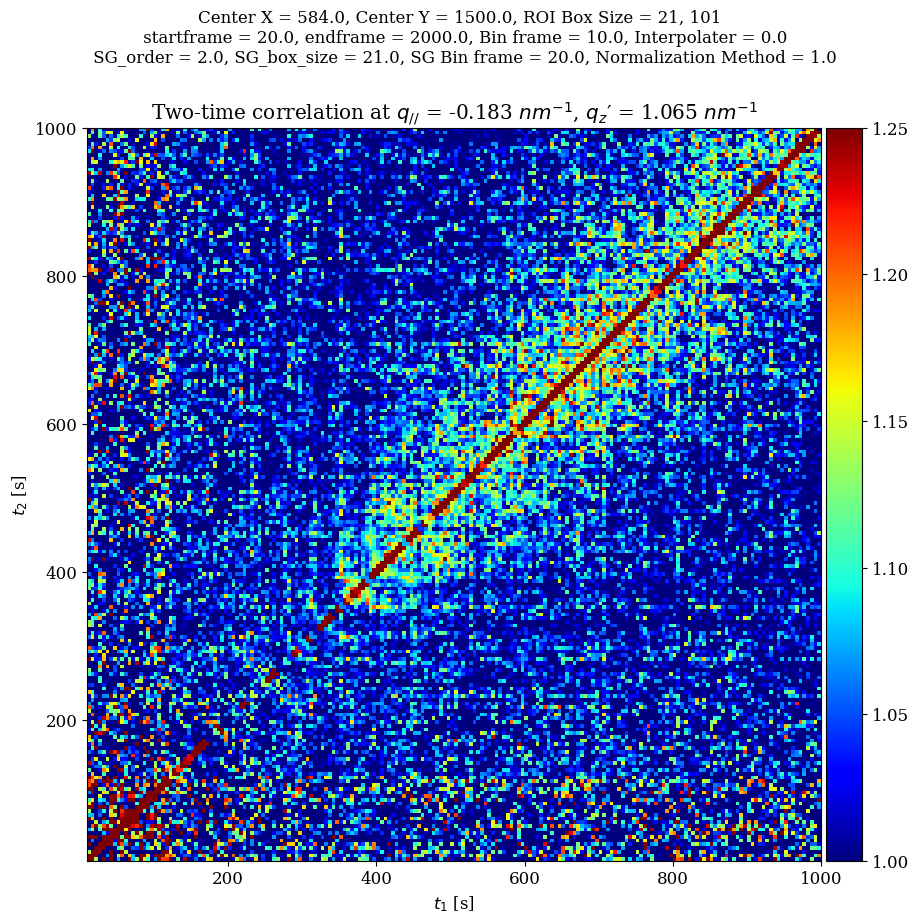

...

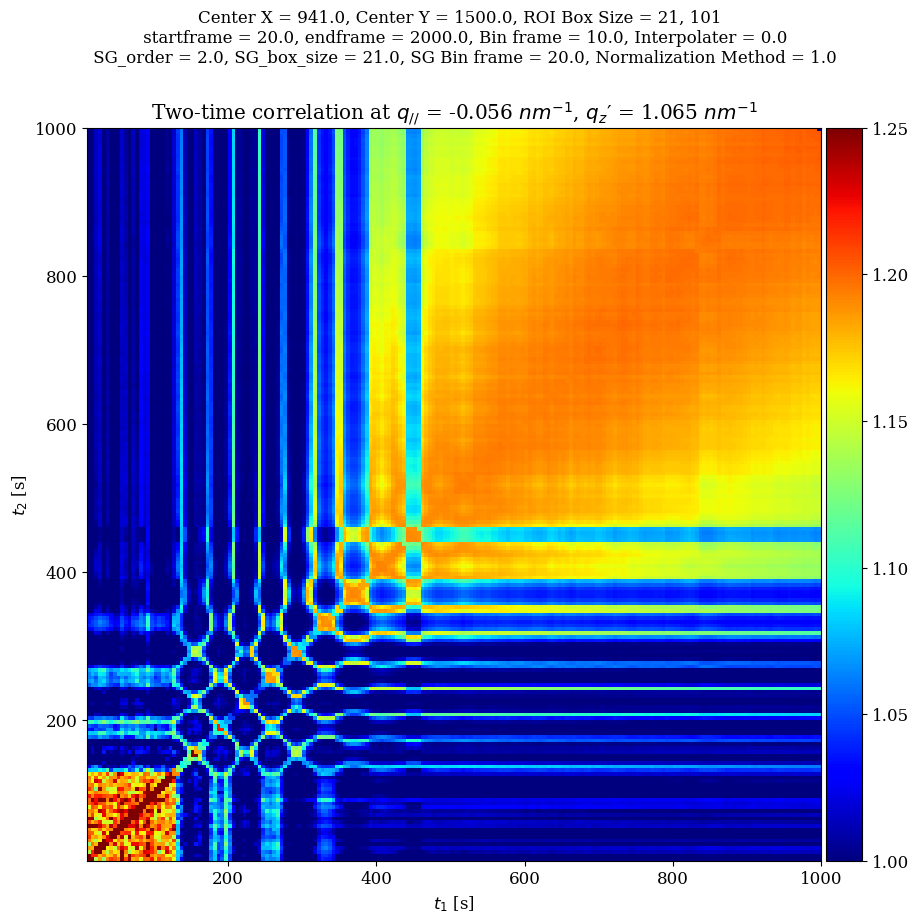

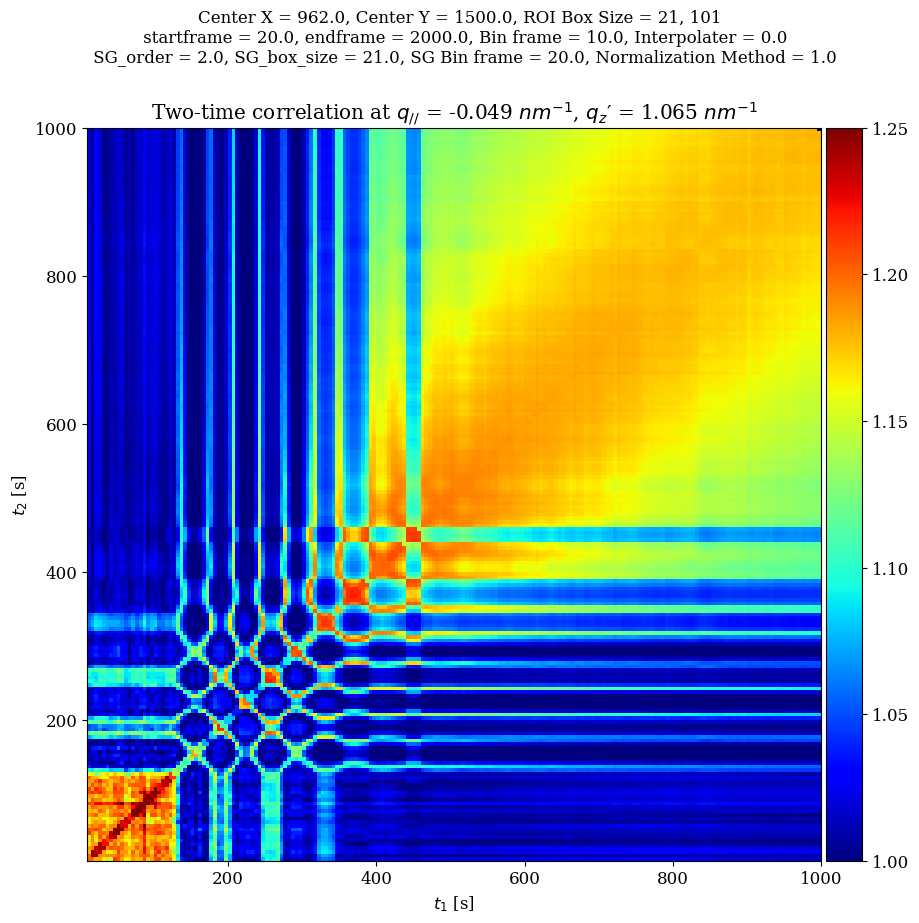

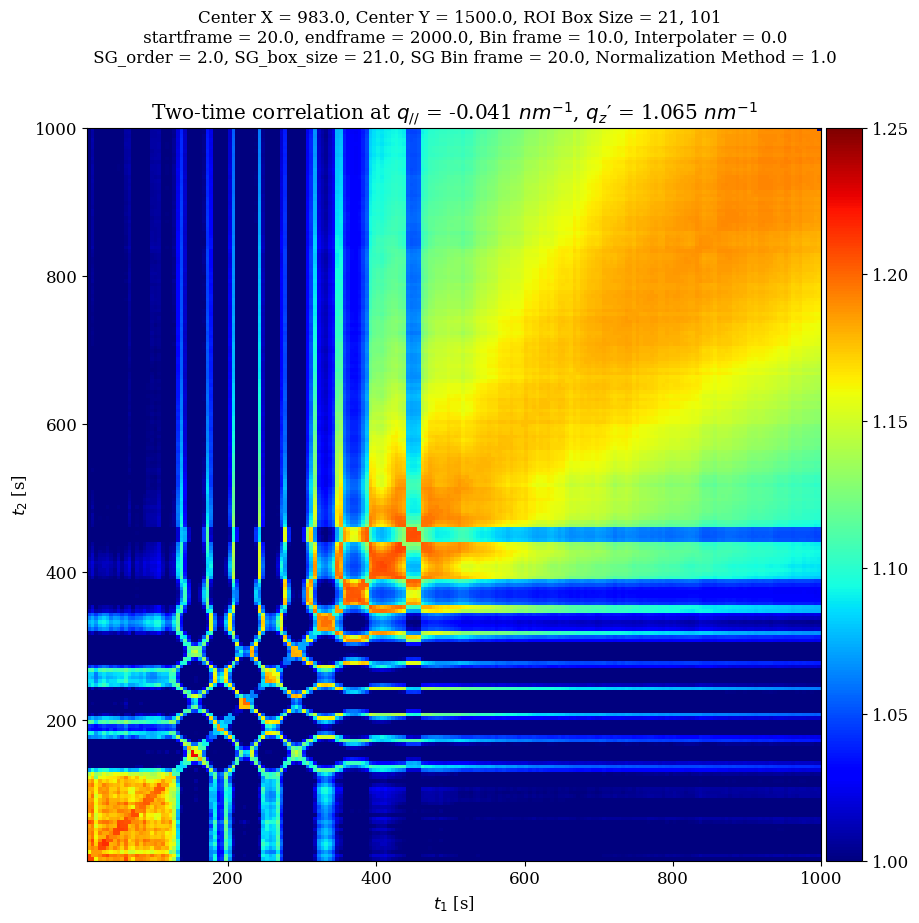

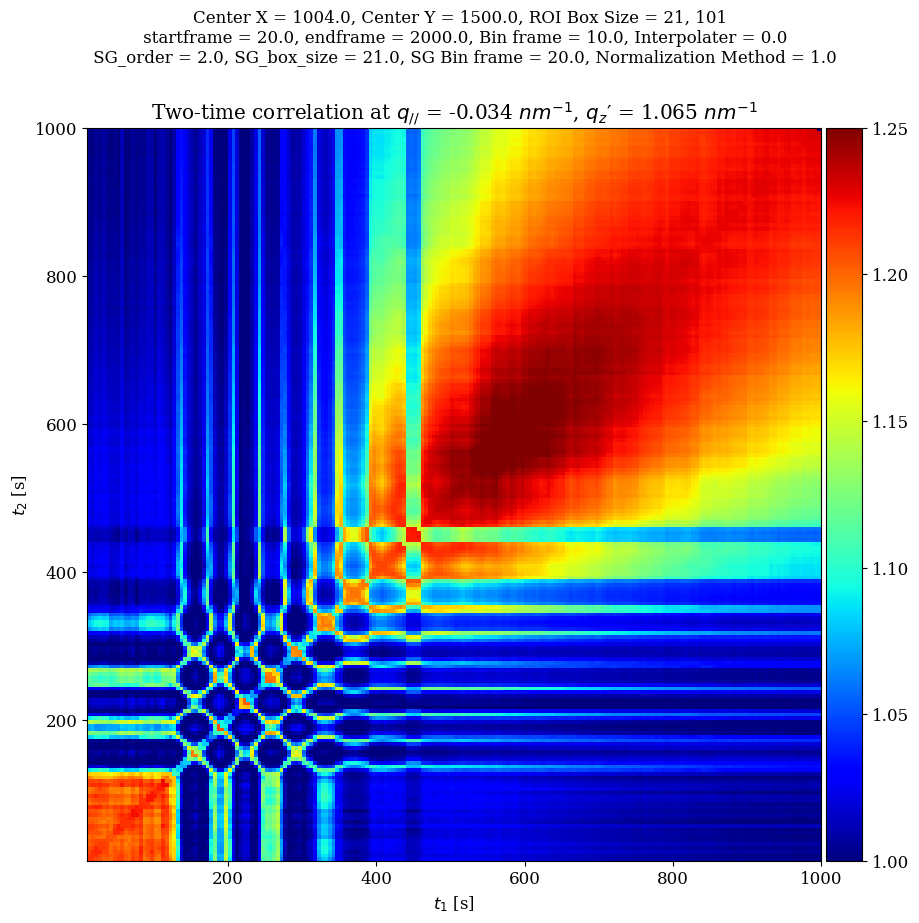

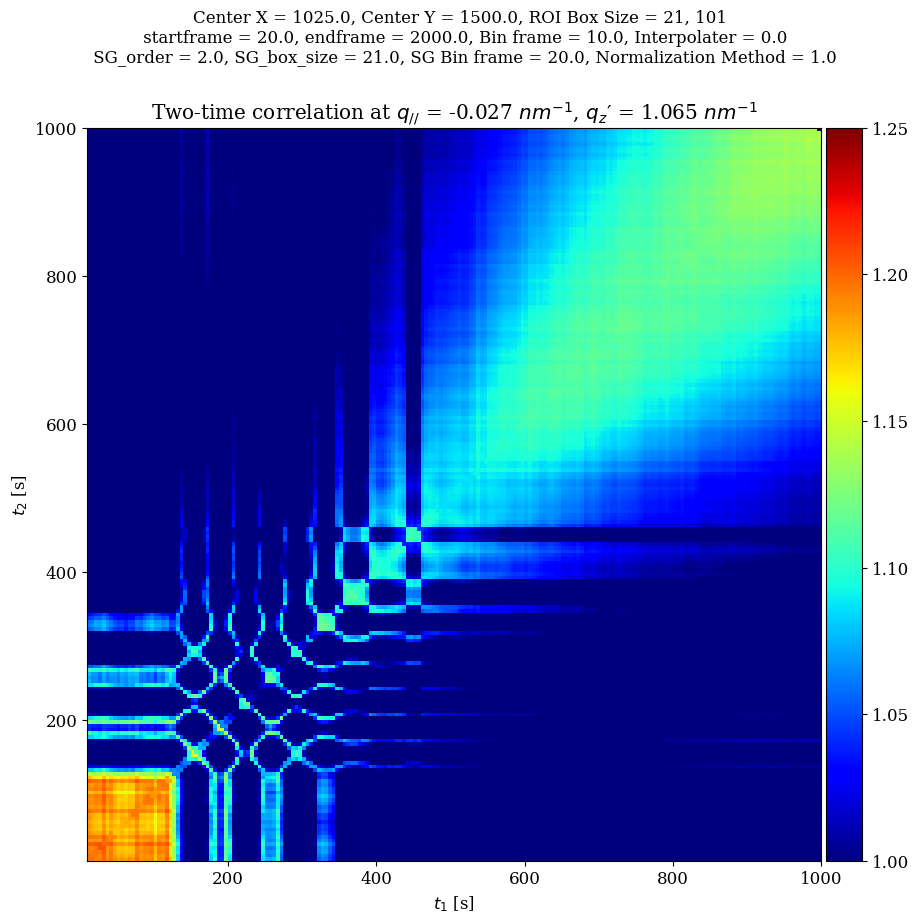

In [181]:

# %run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py'
# from tqdm import tqdm
# from tqdm import tqdm_notebook as tqdm #for progress bar

# # CenterXs,Inor_all,TTCF2, TTCFs = None, None, None, None
# # del CenterXs,Inor_all,TTCF2, TTCFs 

# CenterXs,Inor_all, contrasts, Windows = collect_normalize(startframe = 20 ,endframe = 2000 , centerx_start = 500, centerx_end = 1040, centery = 1500,peak_in_X = 800, boxsize = (21,101), bin_frame = 10, normalize = 1, SG_window = 21, SG_order = 2,  SG_bin_frame = 20, interpolate = 0,dynamical_ROI_relative_positions=newpos)
# TTCF2, TTCFs = TTCF(CenterXs,Inor_all)
# for i in range(len(TTCFs)):
#     plotTTCF(TTCFs[i], color_min = 1 , color_max = 1.25, save = 0)

/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py:621: DeprecationWarning: elementwise != comparison failed; this will raise an error in the future.
  if dynamical_ROI_relative_positions!= np.zeros(10):
  0%|          | 0/298 [00:00<?, ?it/s]/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py:883: DeprecationWarning: elementwise != comparison failed; this will raise an error in the future.
  if dynamical_ROI_relative_positions!= np.zeros(10): #if you add reasonable relative positions for dynamic ROI, put them here.
100%|██████████| 26/26 [00:18<00:00,  1.43it/s]5it/s]


<Figure size 720x445 with 0 Axes>

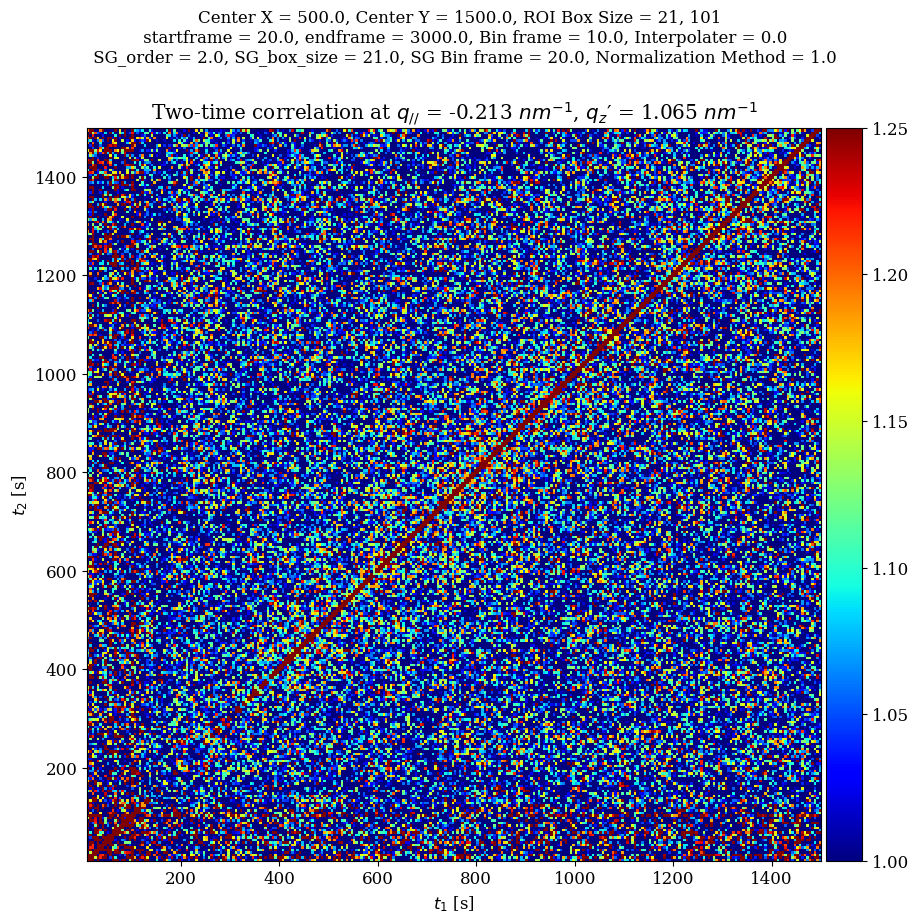

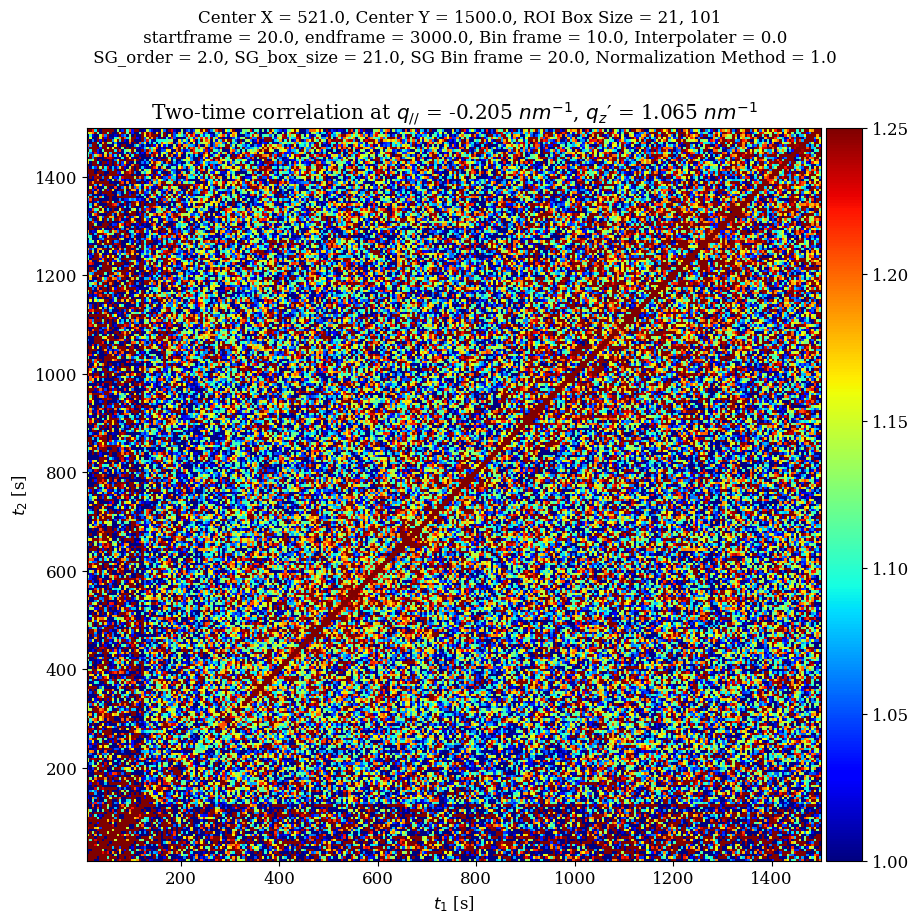

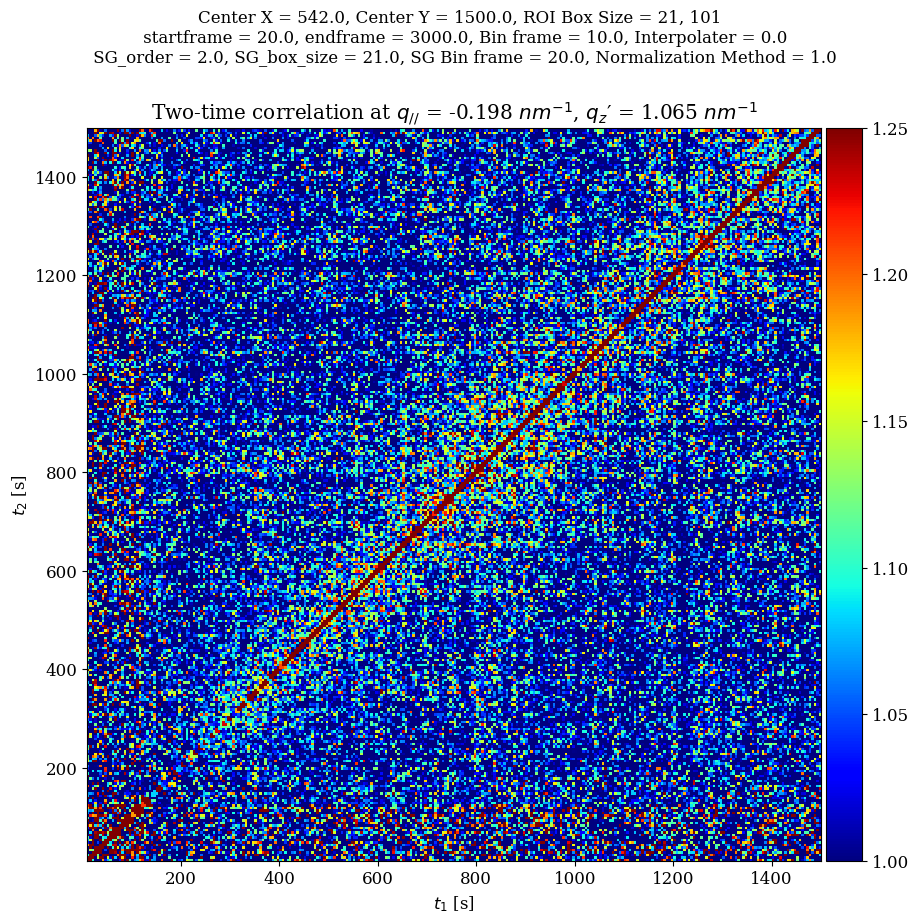

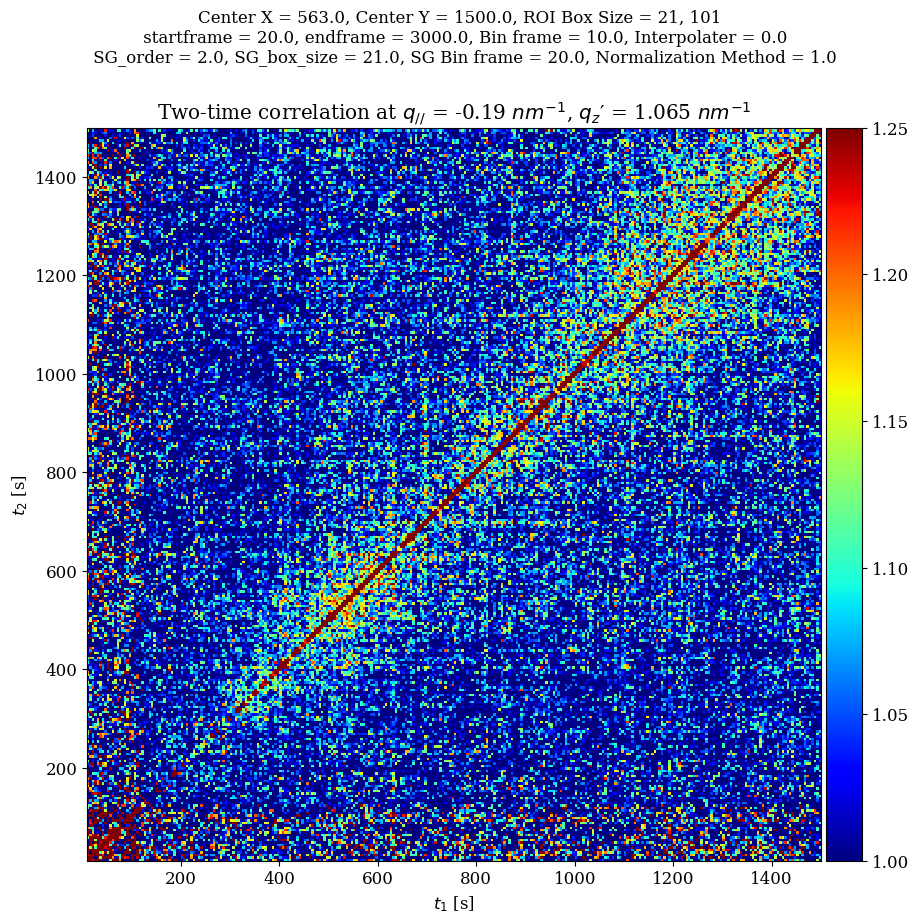

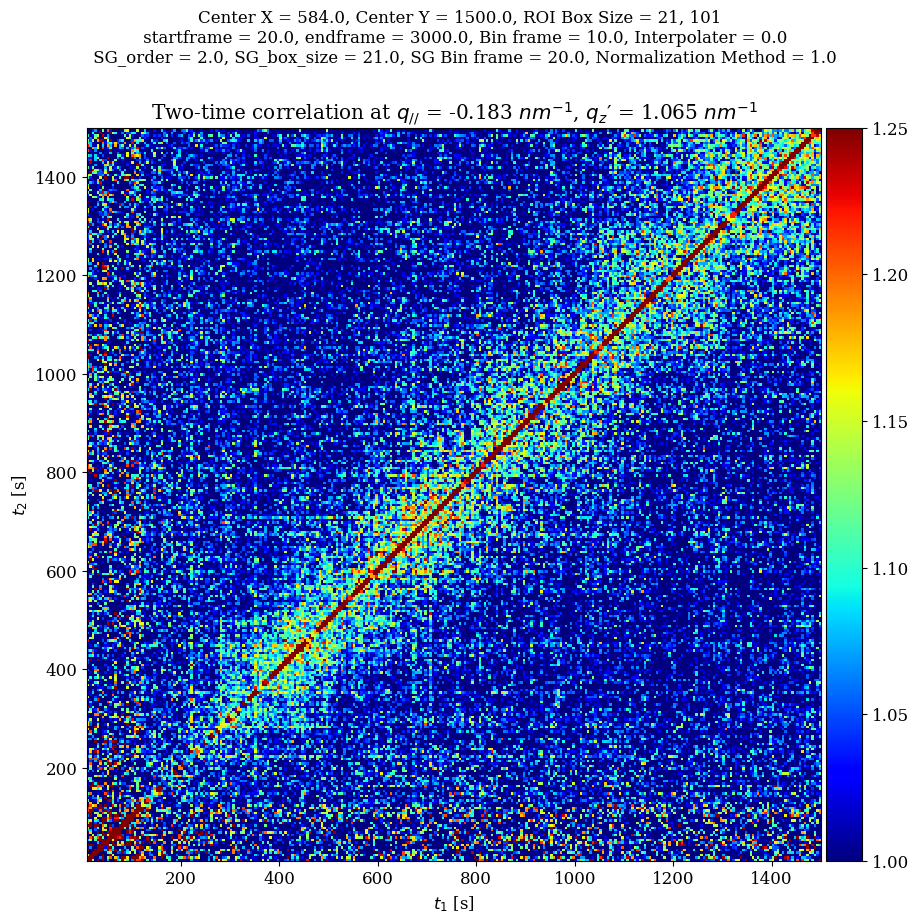

...

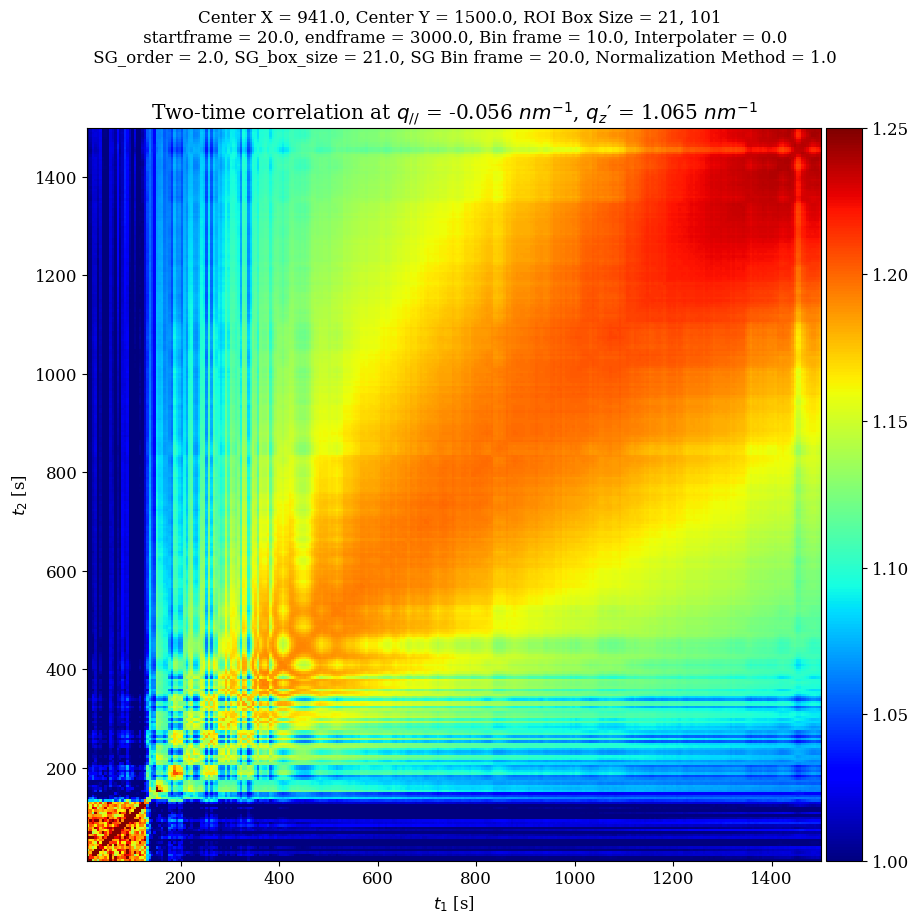

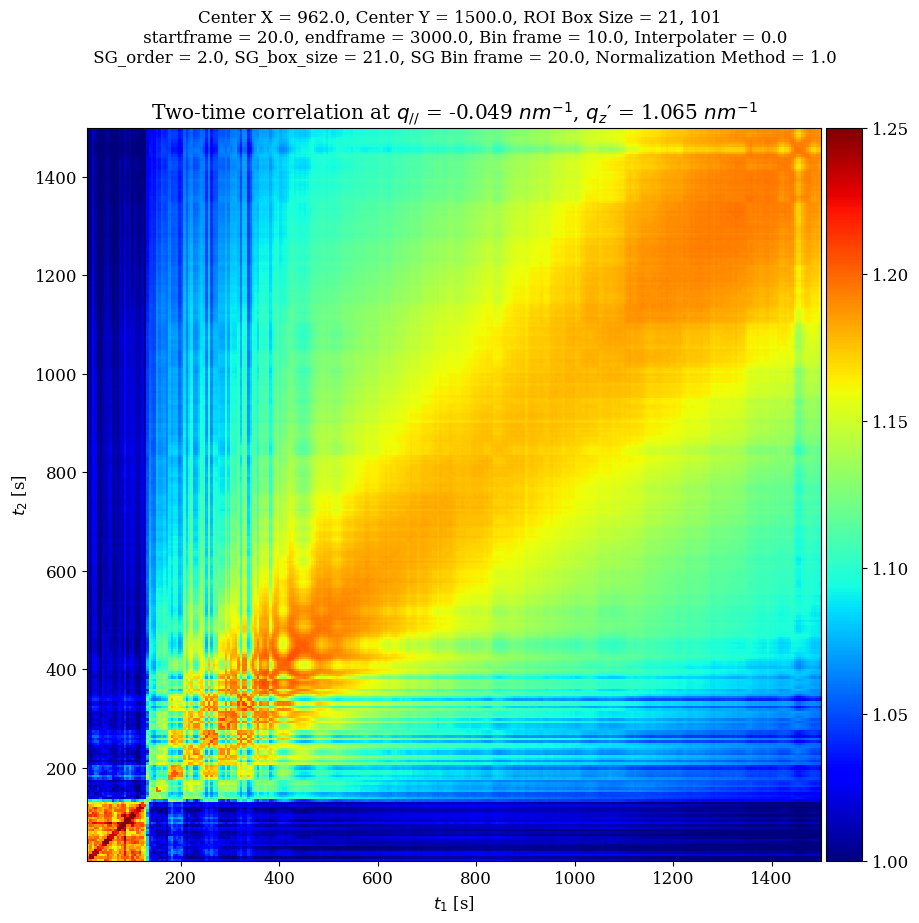

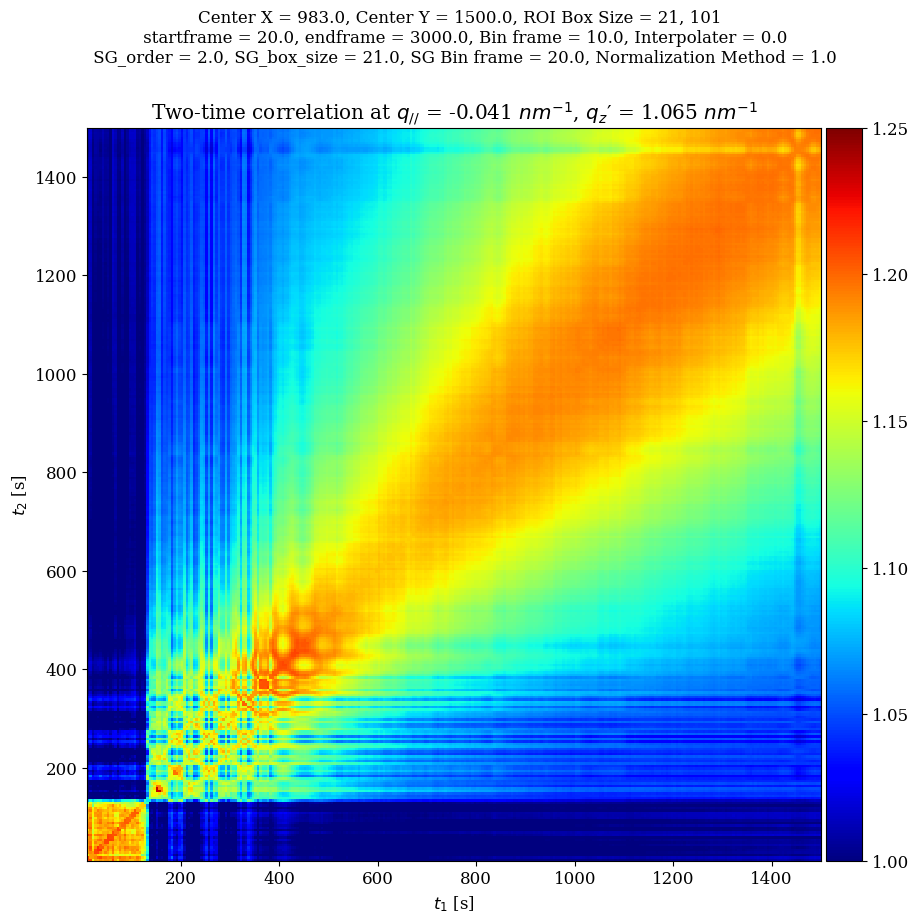

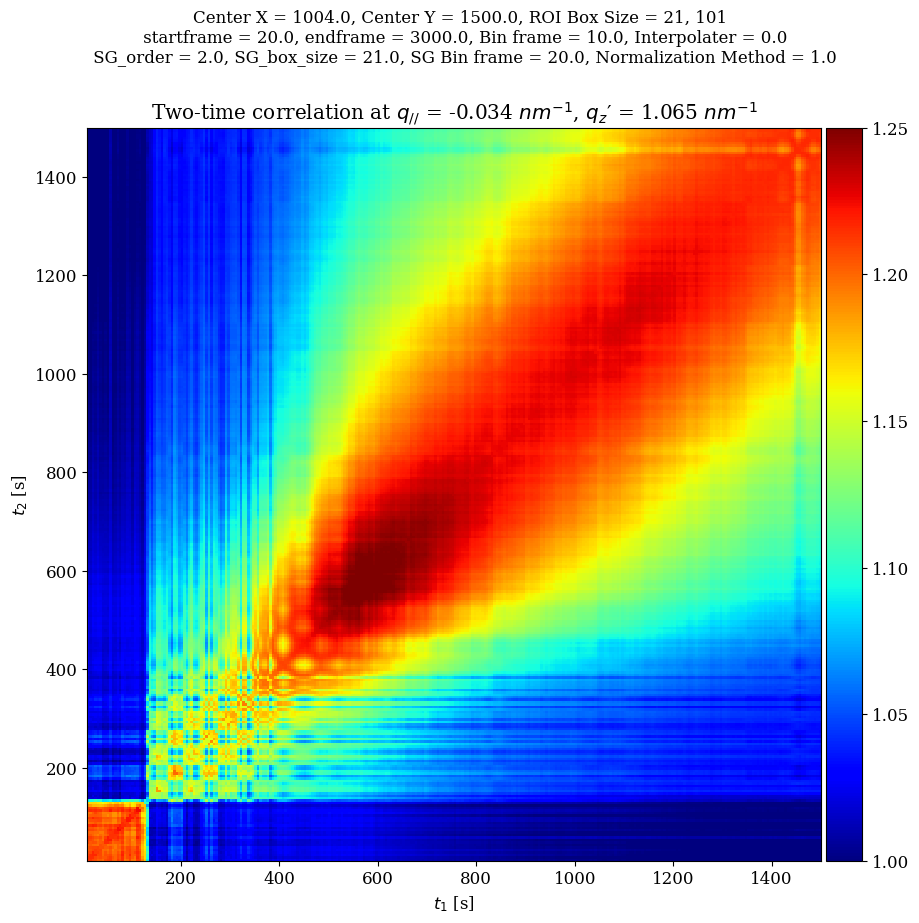

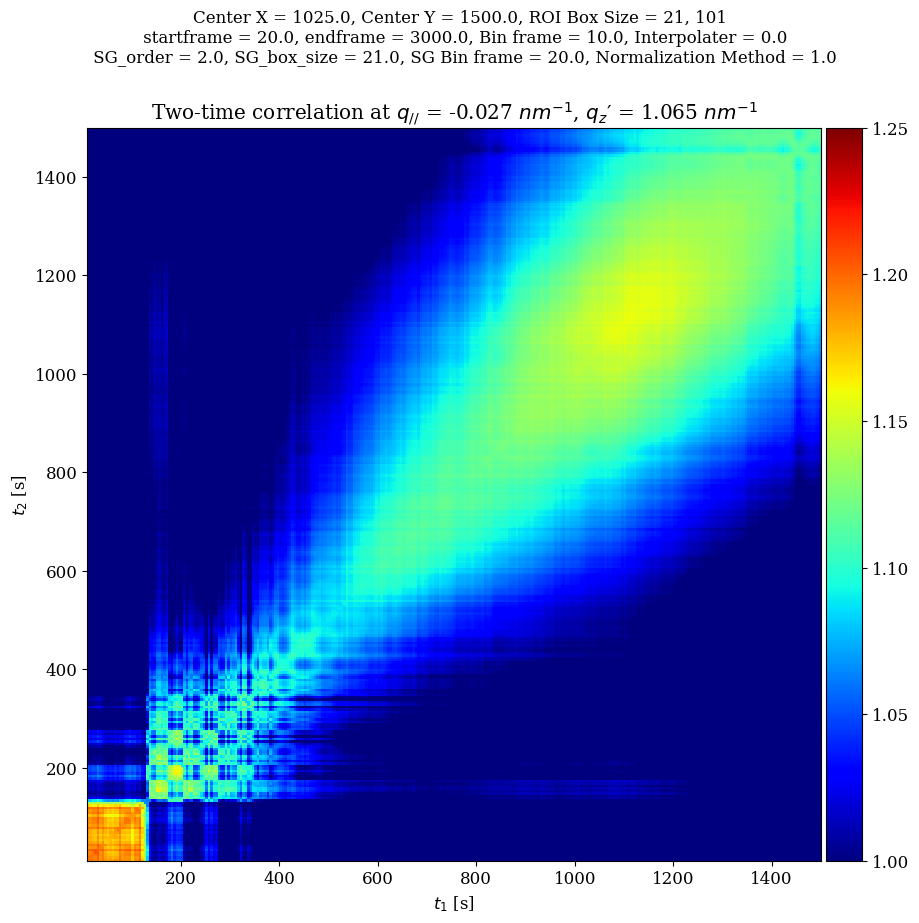

In [123]:

# %run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py'
# from tqdm import tqdm
# # CenterXs,Inor_all,TTCF2, TTCFs = None, None, None, None
# # del CenterXs,Inor_all,TTCF2, TTCFs 

# CenterXs,Inor_all, contrasts, Windows = collect_normalize(startframe = 20 ,endframe = 2000 , centerx_start = 500, centerx_end = 1040, centery = 1500,peak_in_X = 800, boxsize = (21,101), bin_frame = 1, normalize = 1, SG_window = 21, SG_order = 2,  SG_bin_frame = 20, interpolate = 0,dynamical_ROI_relative_positions=position_temps*(-1))
# TTCF2, TTCFs = TTCF(CenterXs,Inor_all)
# for i in range(len(TTCFs)):
#     plotTTCF(TTCFs[i], color_min = 1 , color_max = 1.25, save = 0)

# $g_2$ Analysis

calculating g2


/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py:64: RuntimeWarning: divide by zero encountered in true_divide
  
/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py:64: RuntimeWarning: invalid value encountered in true_divide
  
/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py:96: RuntimeWarning: invalid value encountered in multiply
  ', center Y = {0}'.format(centery) +


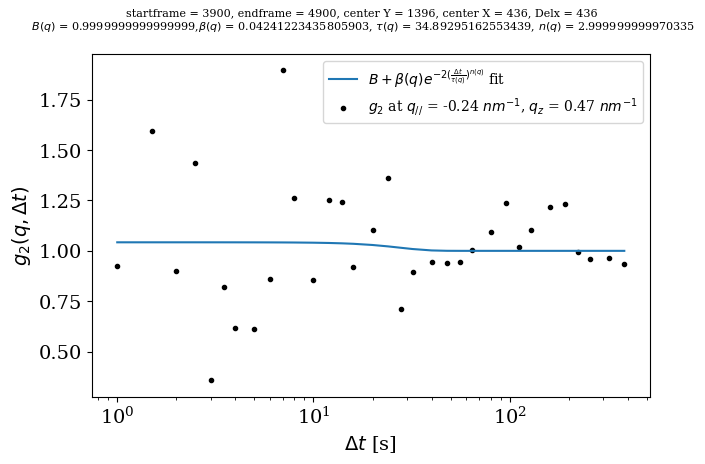

0.09118822790664023 0.9999999999987949


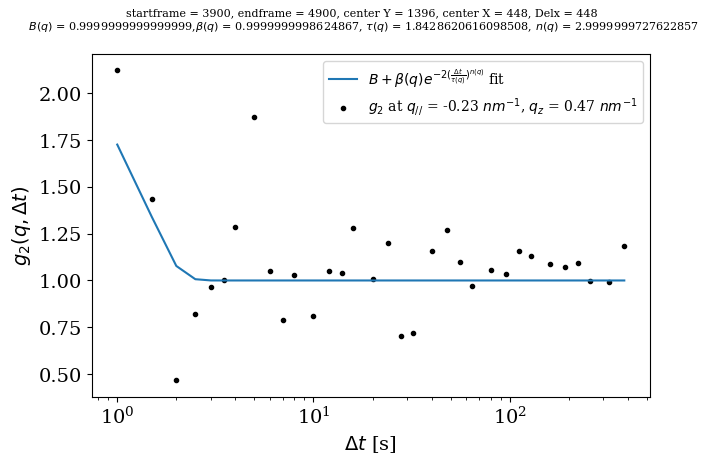

0.06576832135960334 0.9999999999999909


/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py:67: RuntimeWarning: invalid value encountered in power
  return B+beta*np.exp(-2*((deltaT)/tau)**n)


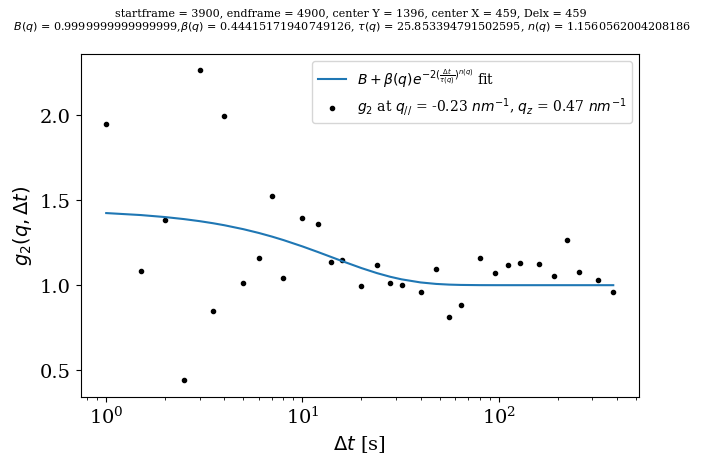

0.08421082654322078 0.9999999999996293


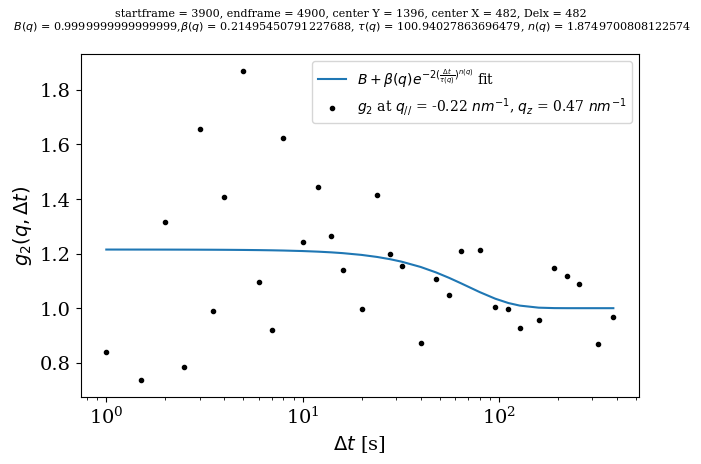

0.05469759108708143 0.9999999999999994


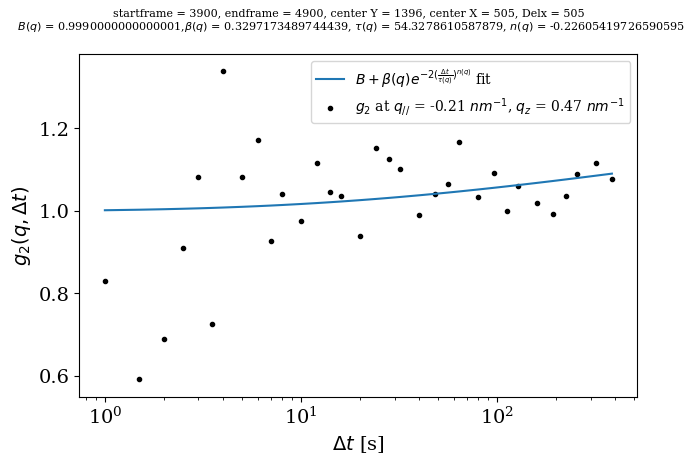

0.021236483443325703 1.0


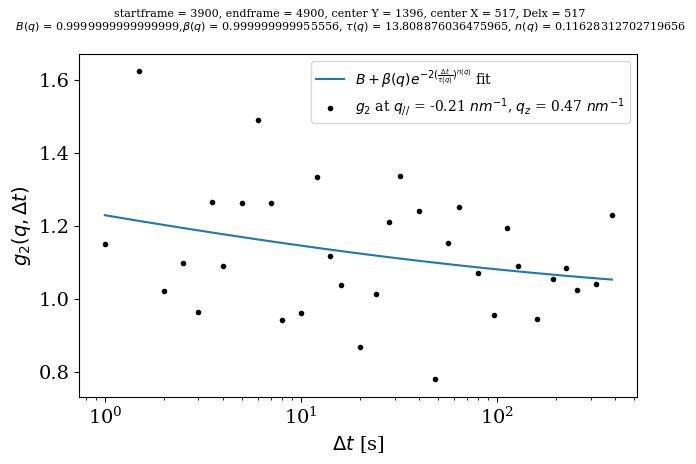

0.02715040047269209 1.0


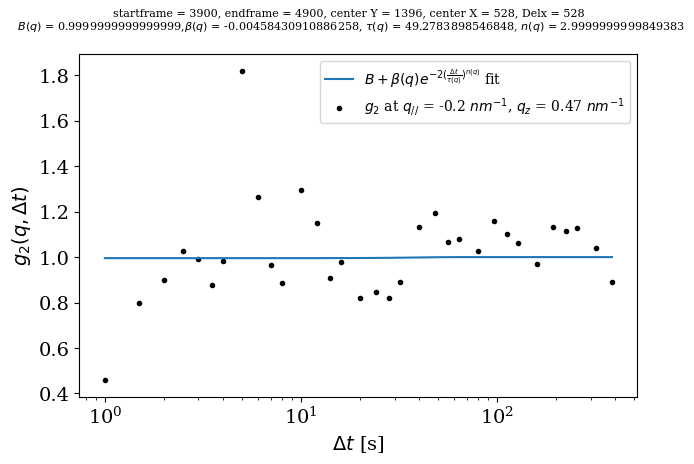

0.051909535939887265 0.9999999999999998


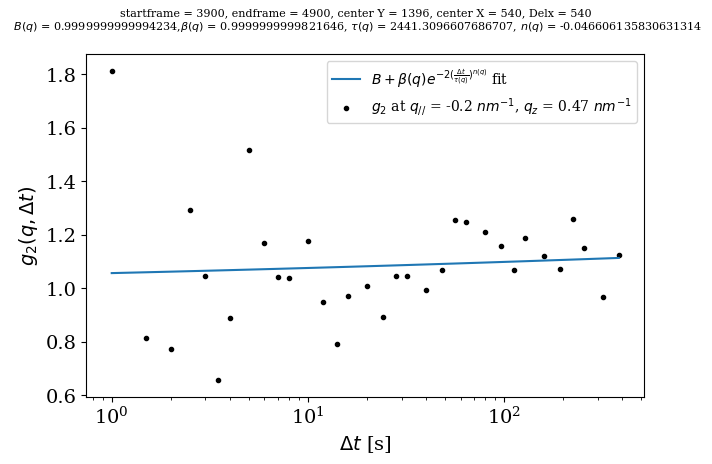

0.04784768595569846 0.9999999999999999


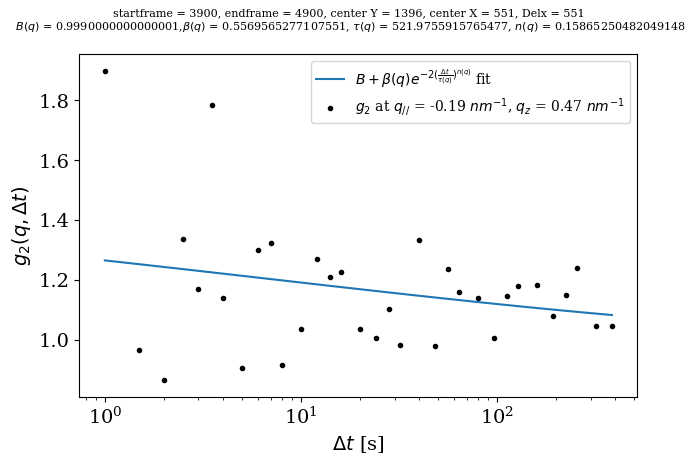

0.0392821690695338 1.0


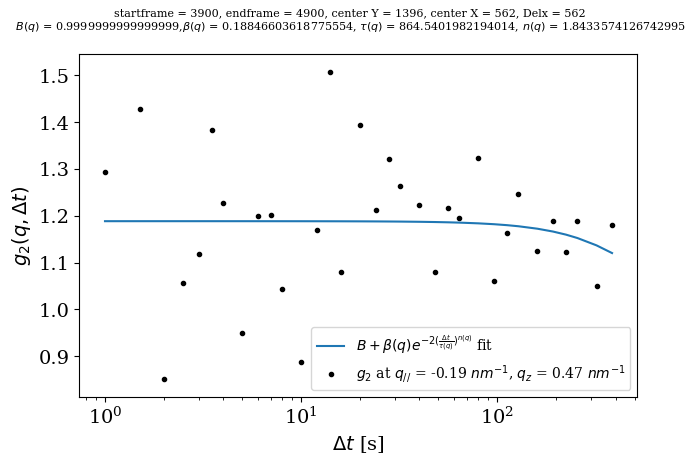

0.019206464908886826 1.0


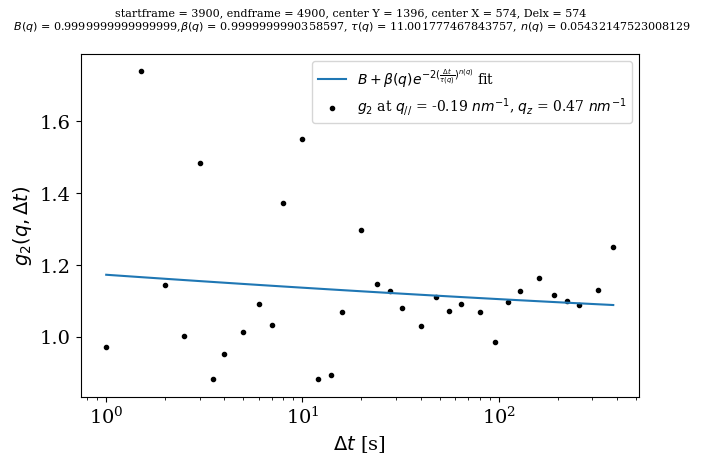

0.03273189403416731 1.0


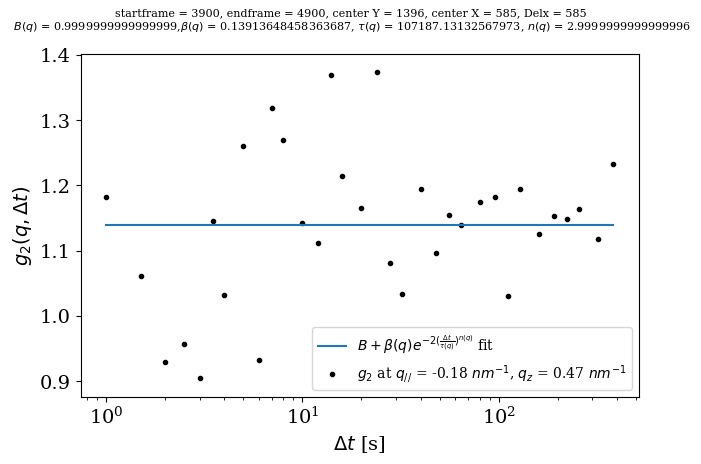

0.012735206388141072 1.0


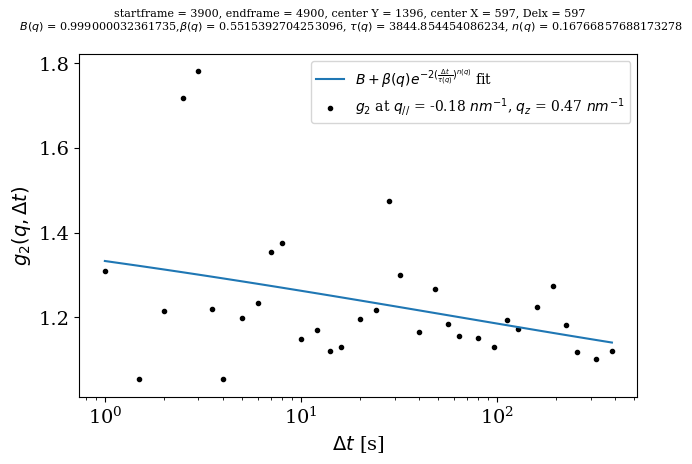

0.01937162567151516 1.0


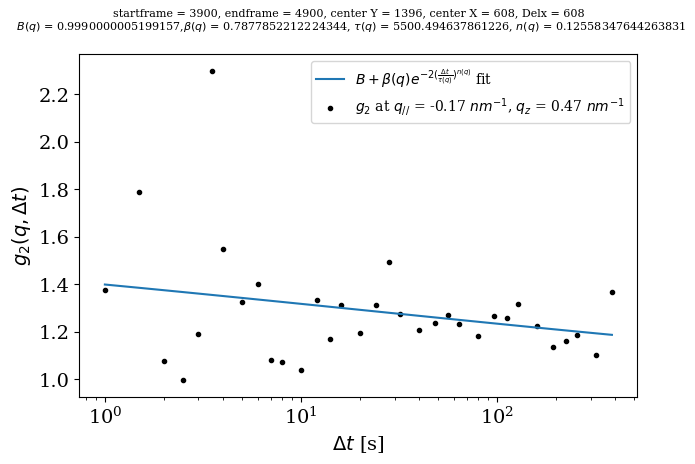

0.04343259288294534 1.0


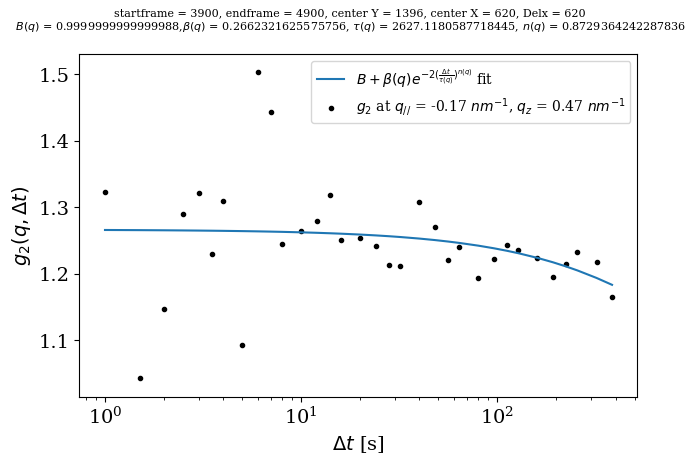

0.005728822049719081 1.0


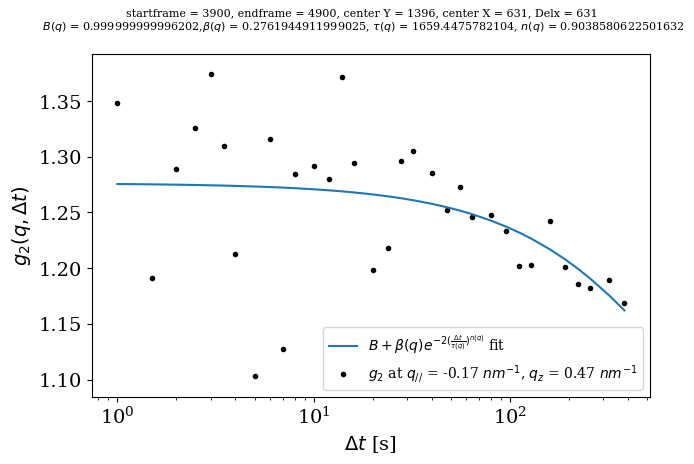

0.002913807671579046 1.0


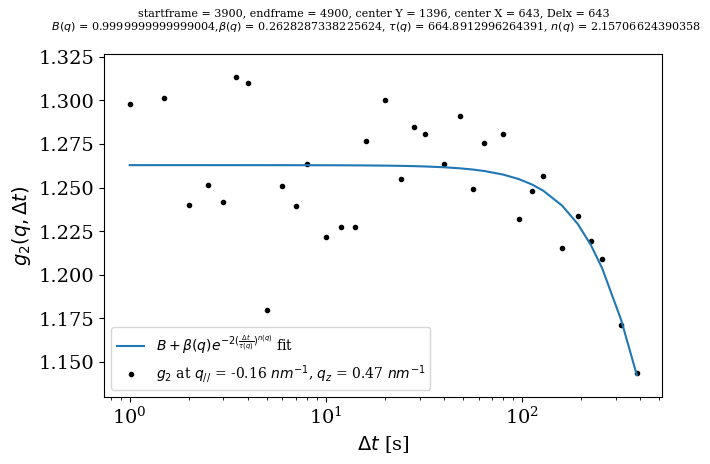

0.000710232938303755 1.0


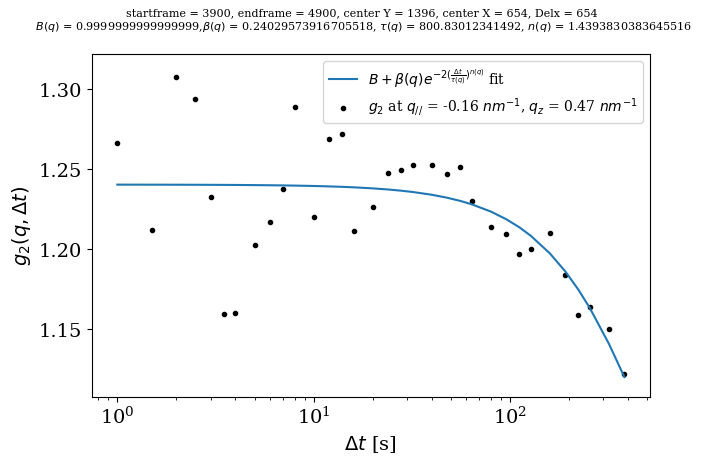

0.0008945466402297854 1.0


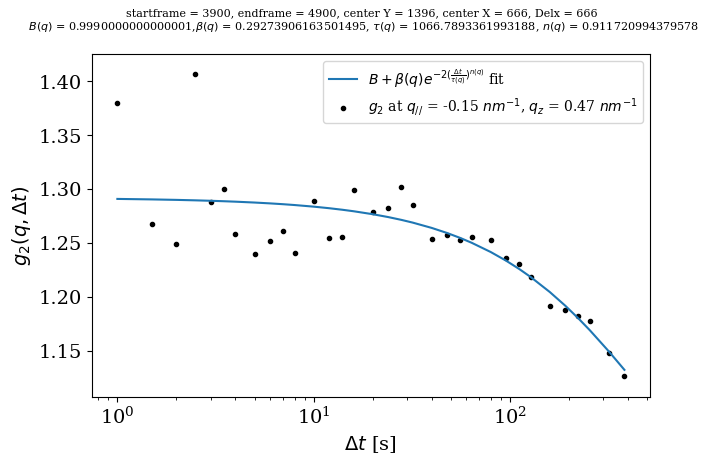

0.0009313602114520831 1.0


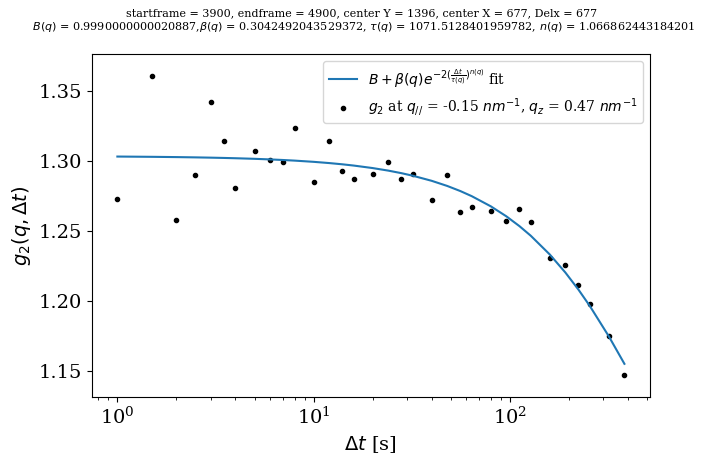

0.00028649209732674997 1.0


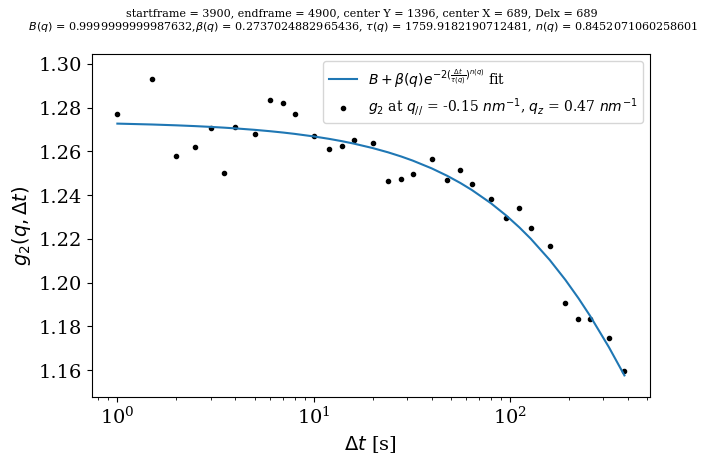

6.64467495998636e-05 1.0


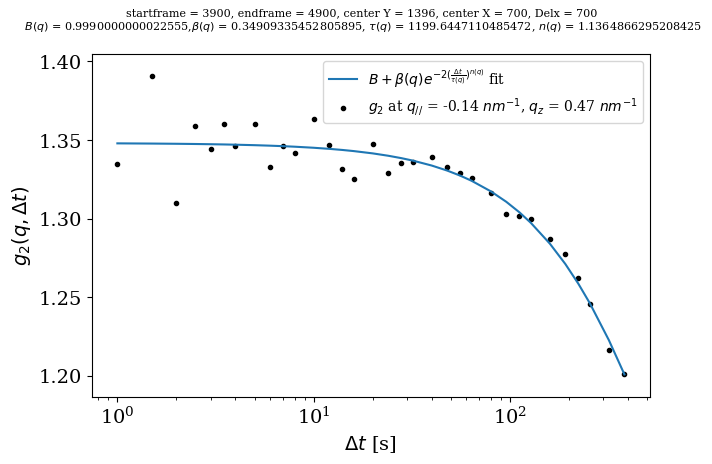

0.00013566853980930742 1.0


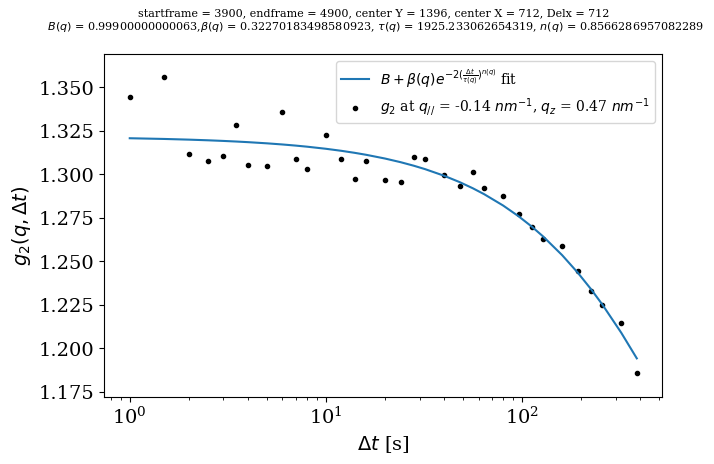

0.00010728310780642359 1.0


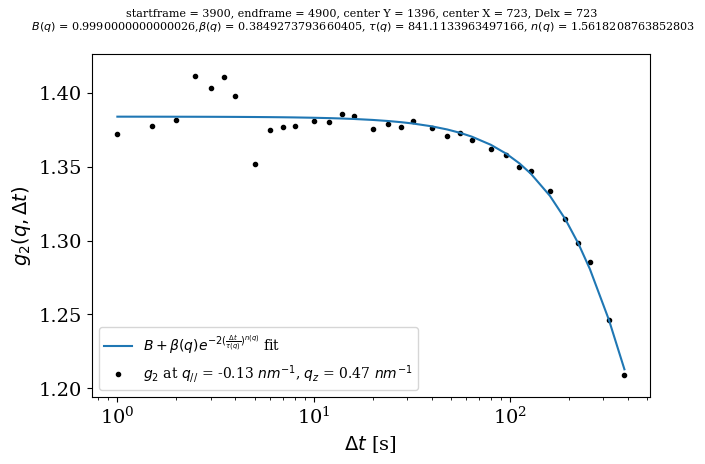

8.97059734939766e-05 1.0


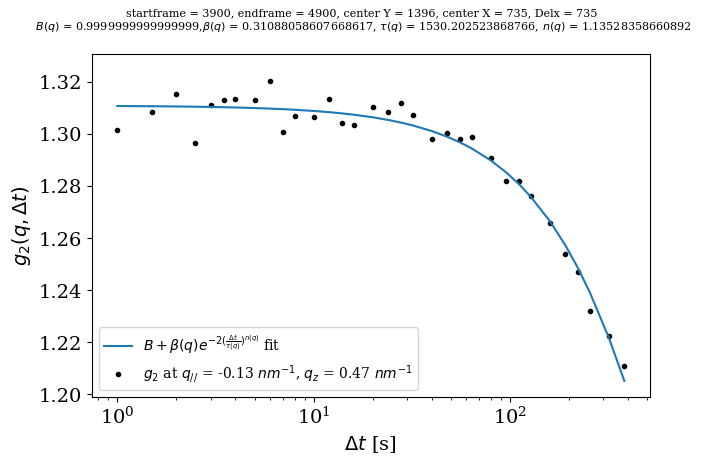

2.213966881661473e-05 1.0


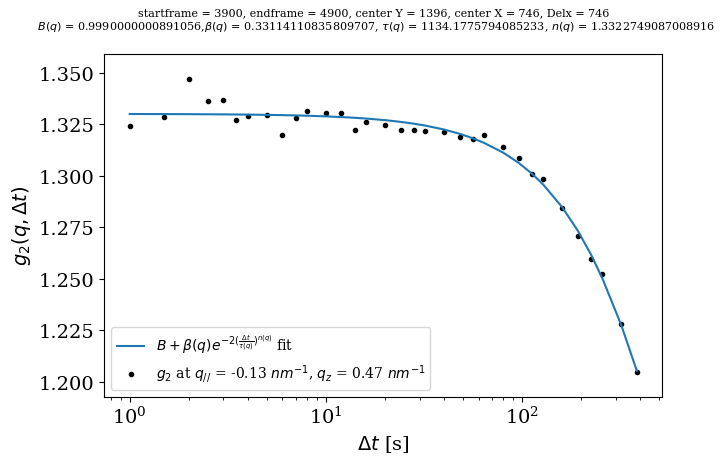

1.738185840585799e-05 1.0


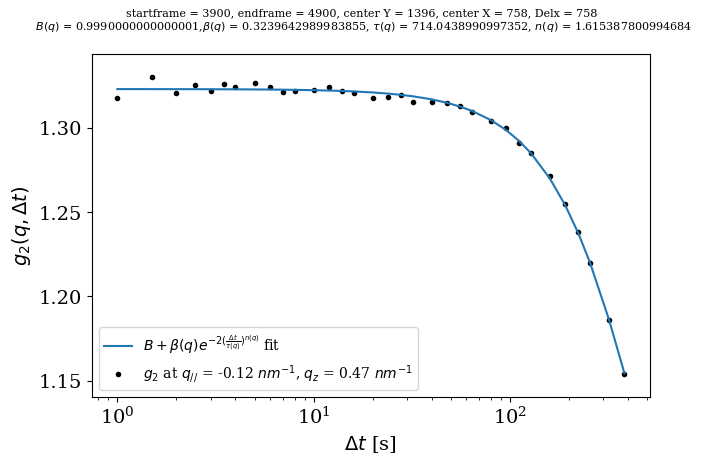

4.262979139043707e-06 1.0


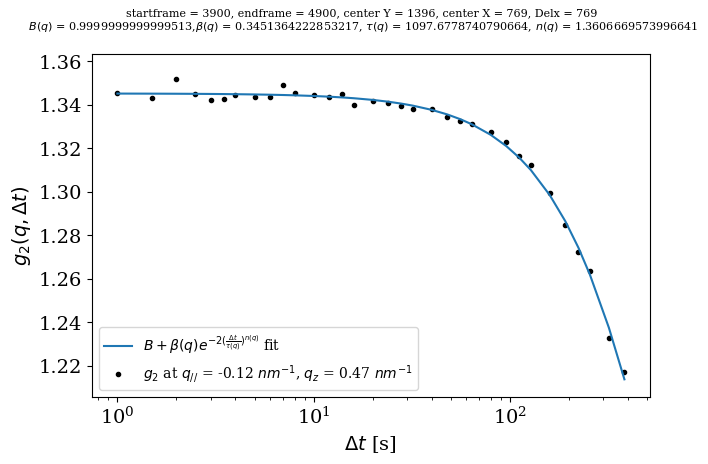

4.300941907871763e-06 1.0


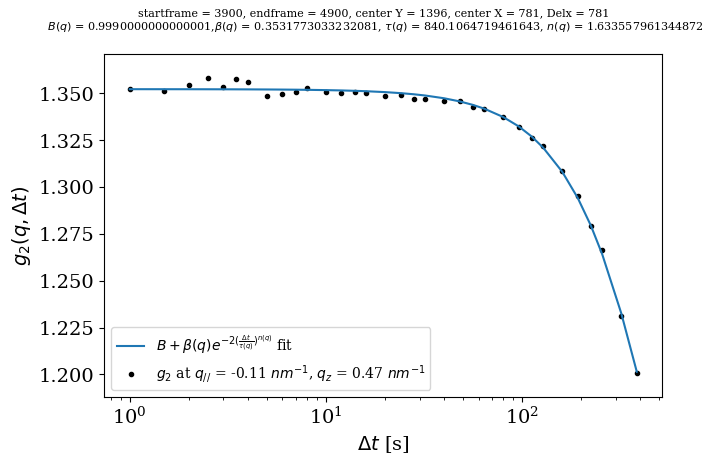

3.6996343281207222e-06 1.0


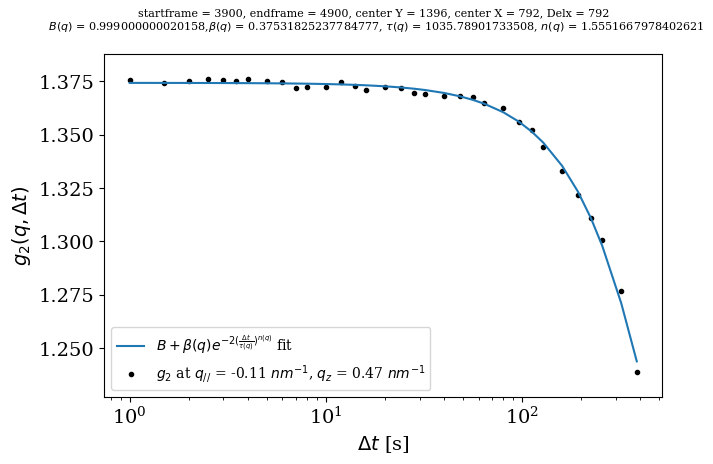

3.216766630226147e-06 1.0


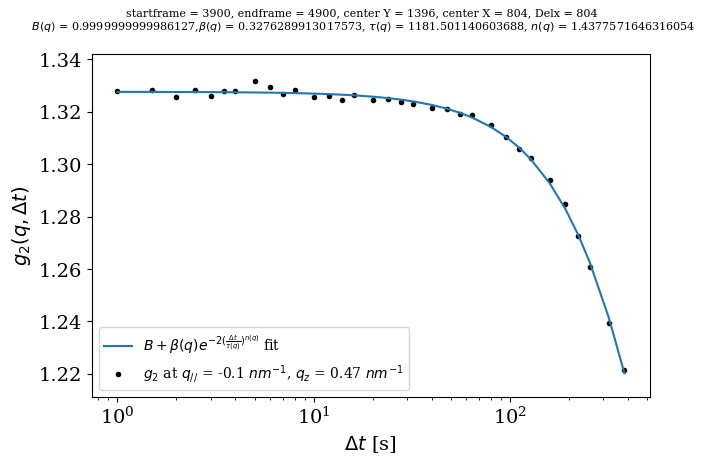

1.6009543329253157e-06 1.0


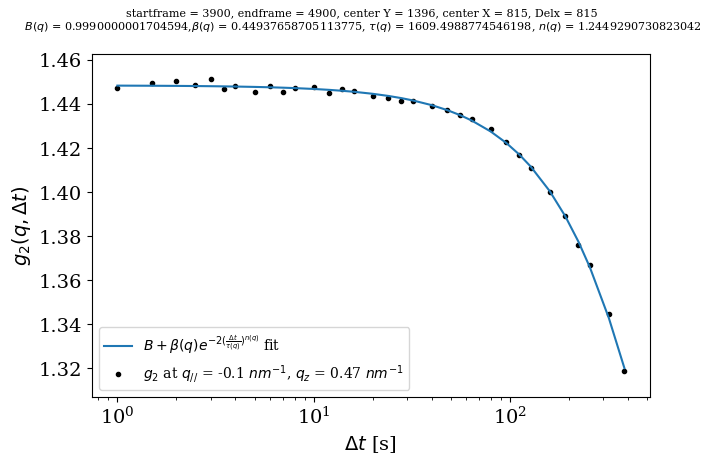

1.1495558358916017e-06 1.0


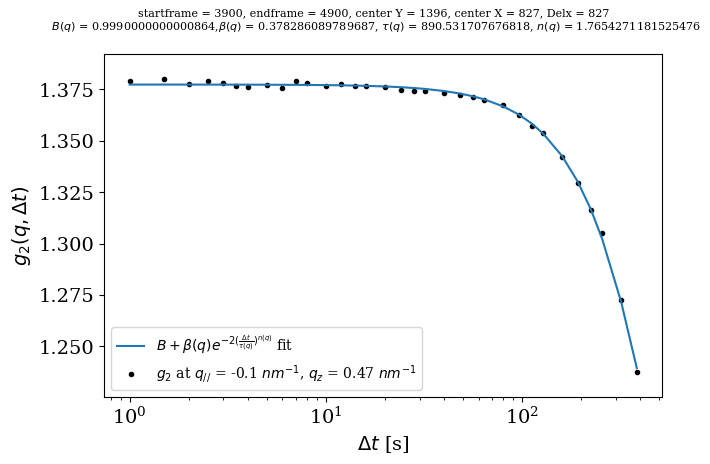

1.1943297481014871e-06 1.0


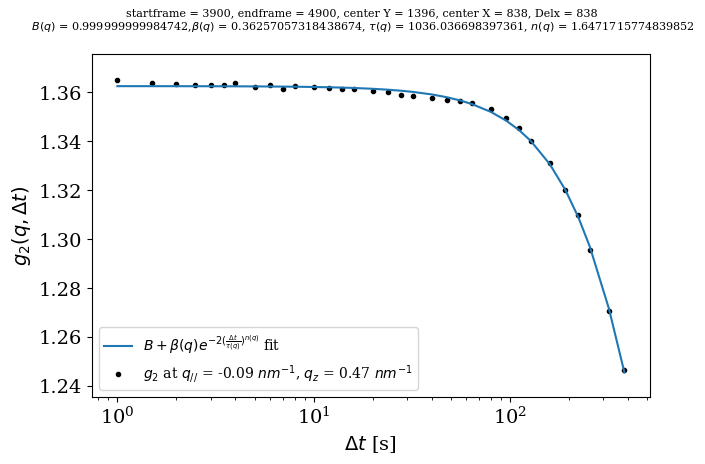

8.671877415087887e-07 1.0


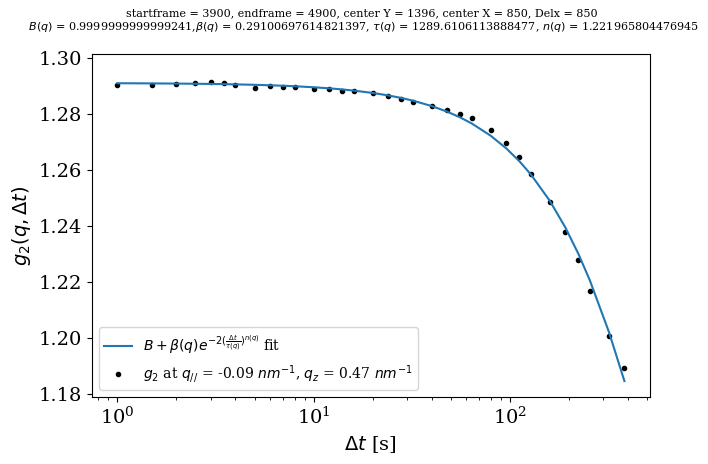

1.8098261044632693e-06 1.0


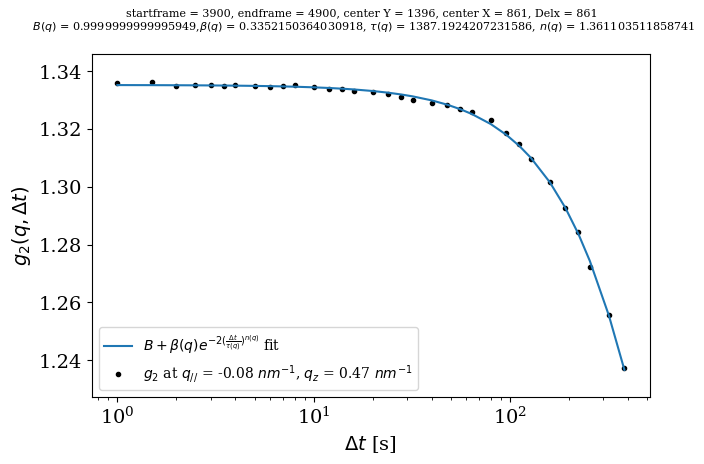

3.674383218725458e-07 1.0


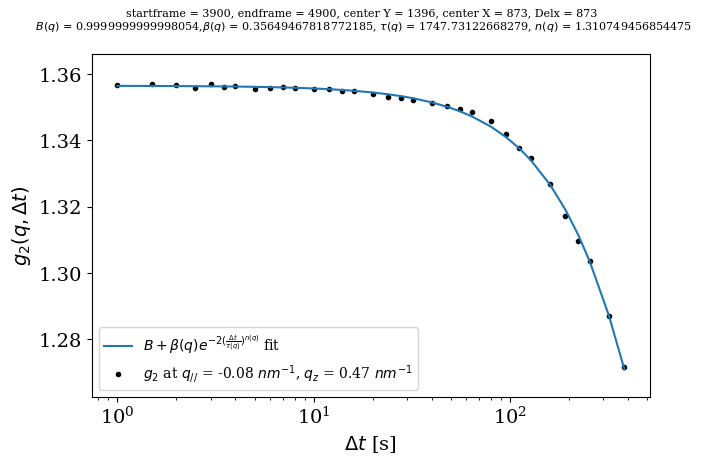

4.343139378968994e-07 1.0


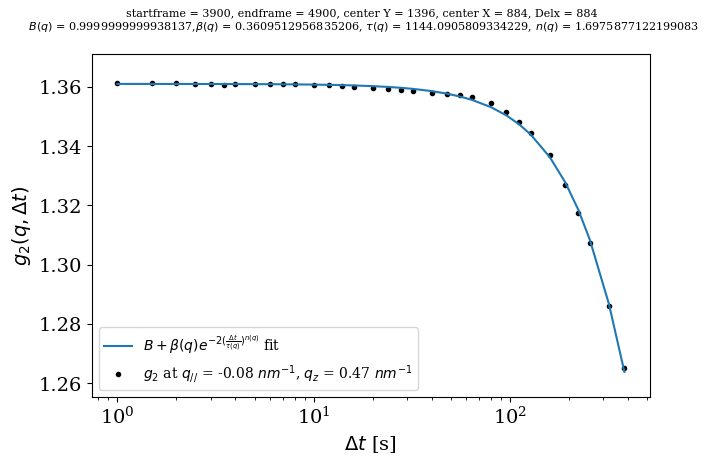

3.7543569403565863e-07 1.0


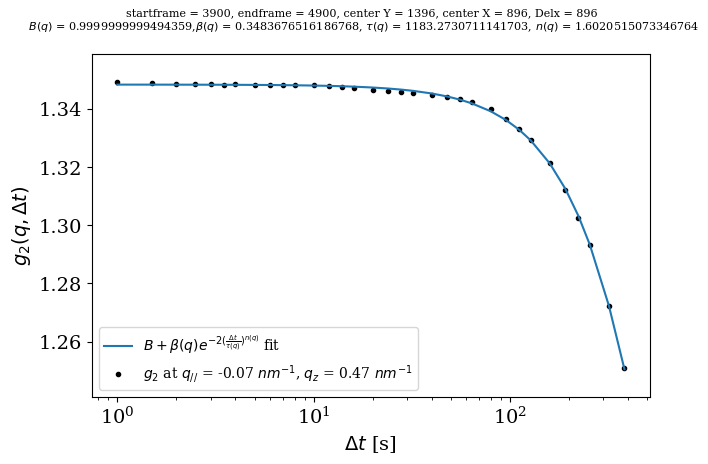

1.7585886042505586e-07 1.0


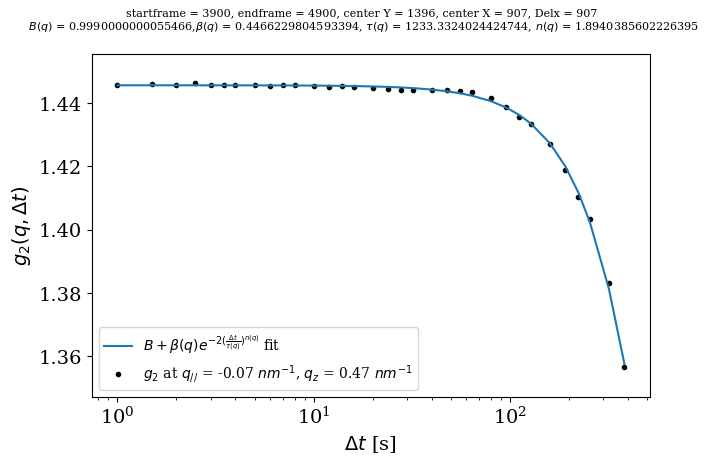

3.7320417287843556e-07 1.0


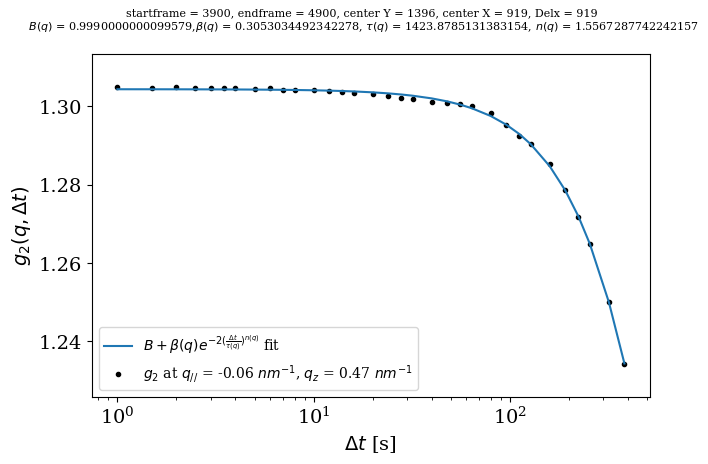

1.6540436139363898e-07 1.0


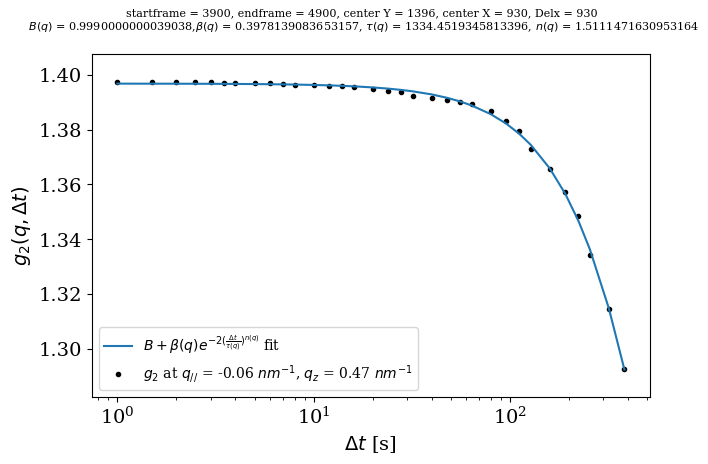

5.949602752119769e-07 1.0


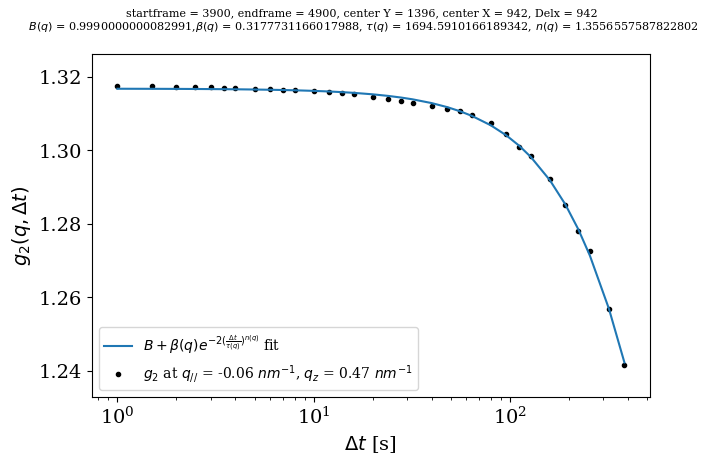

2.930939402255683e-07 1.0


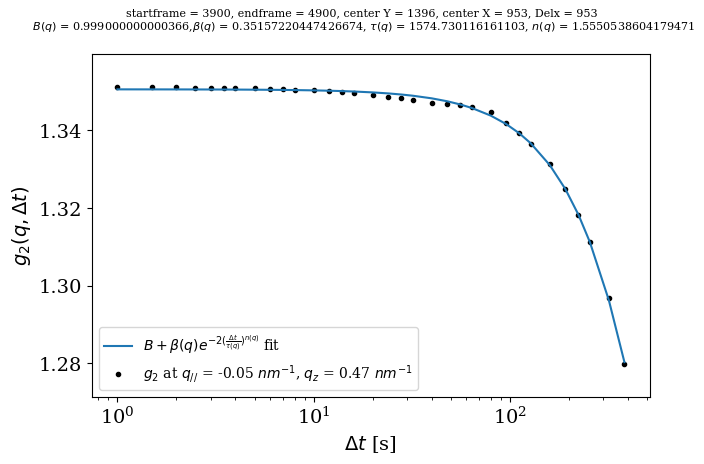

2.2927471215099395e-07 1.0


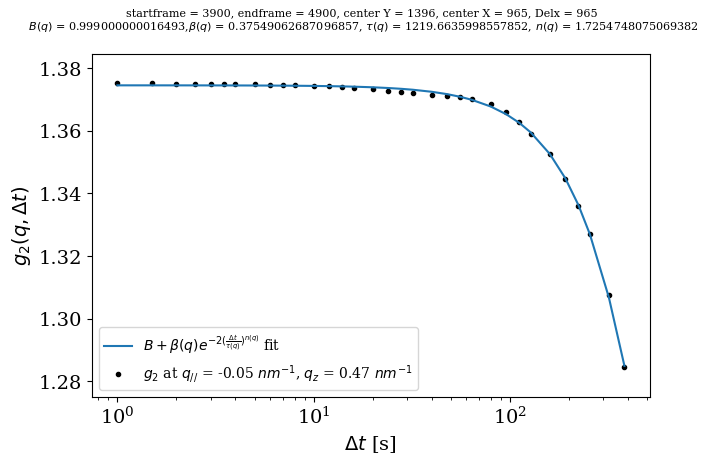

2.1738548328267474e-07 1.0


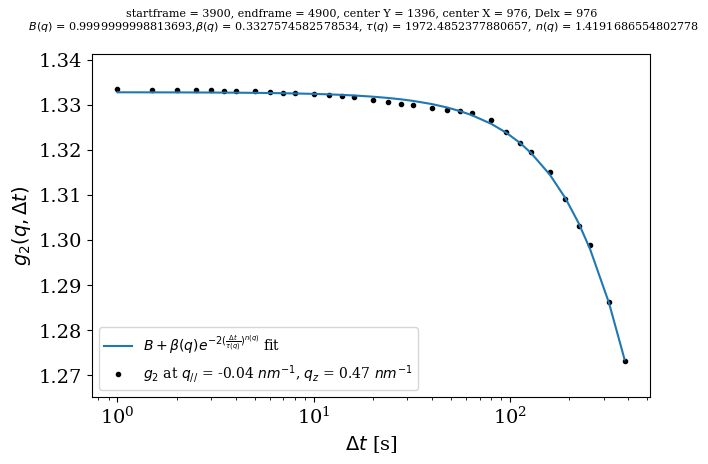

2.5044915342862765e-07 1.0


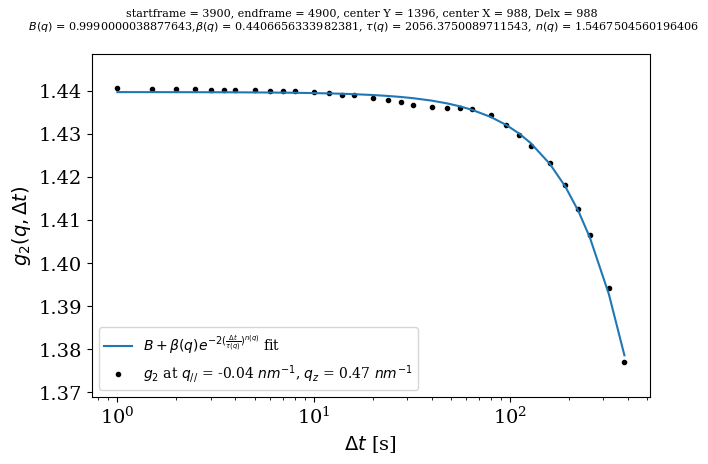

4.5268551674590214e-07 1.0


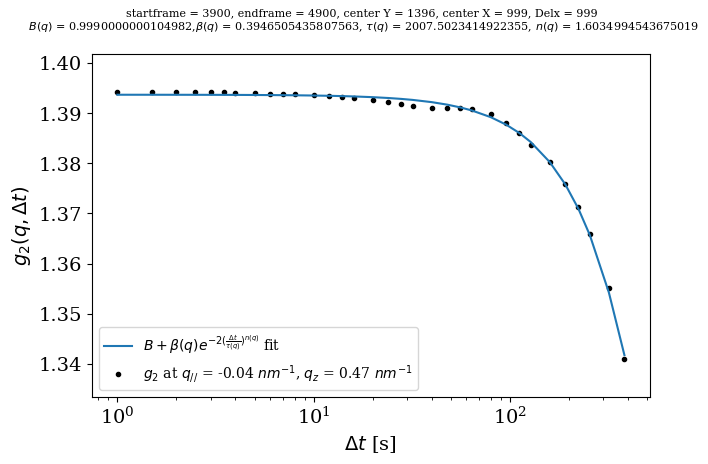

2.590658497704705e-07 1.0


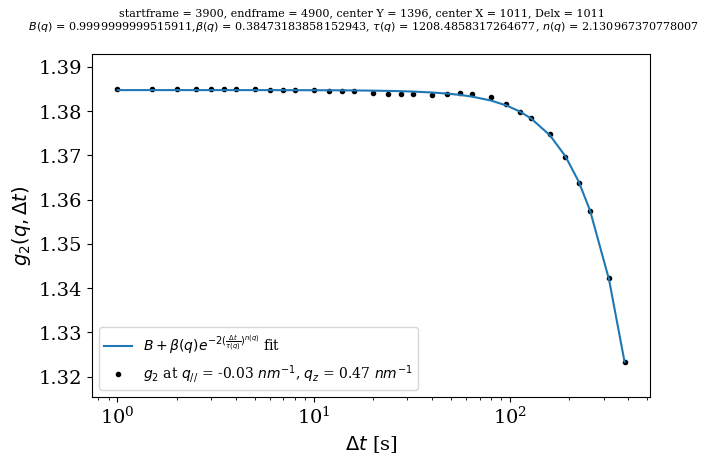

9.968559850584337e-08 1.0


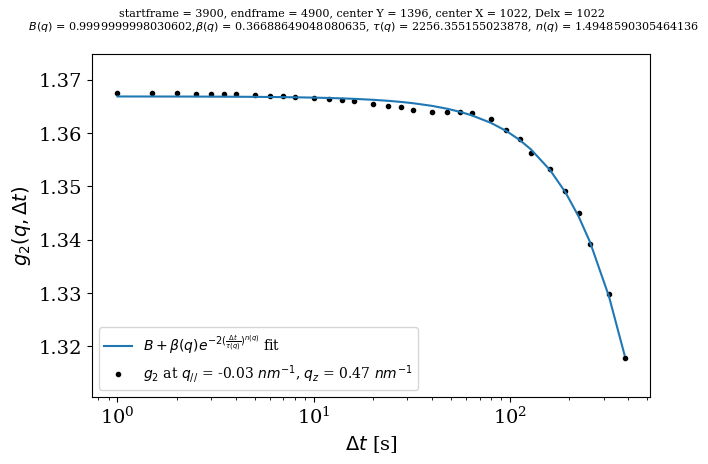

2.766412983358357e-07 1.0


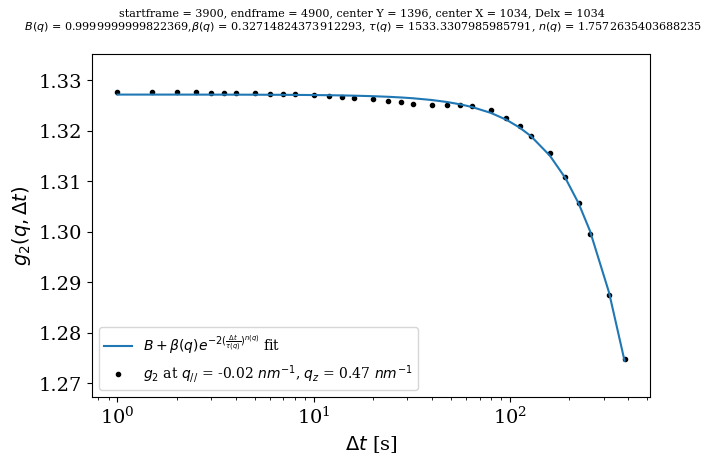

2.0520584781504043e-07 1.0


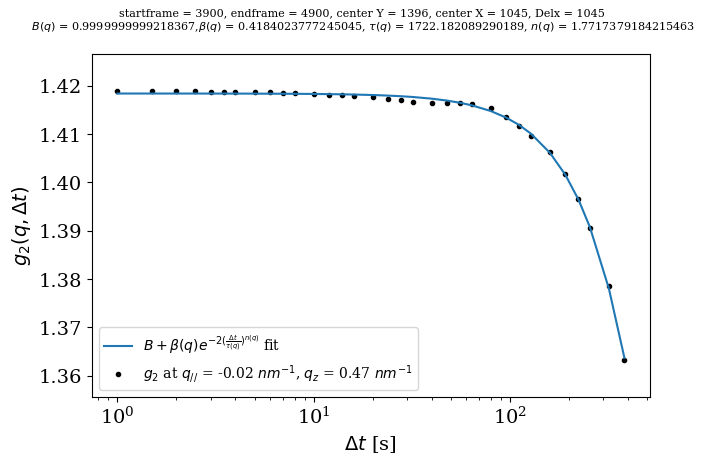

1.7809167383094317e-07 1.0


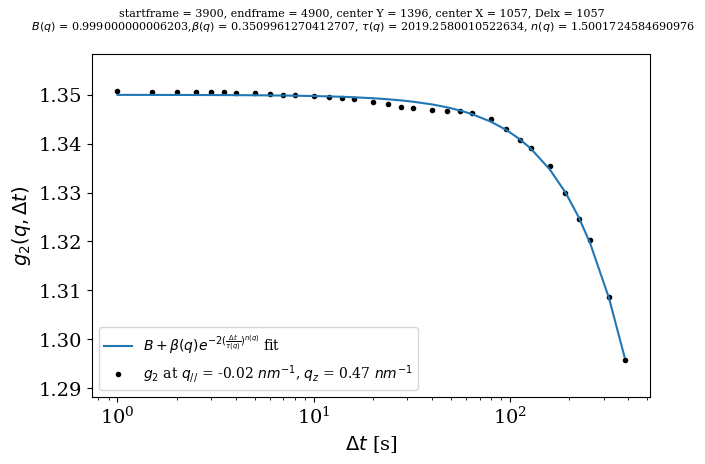

3.1610935751351445e-07 1.0


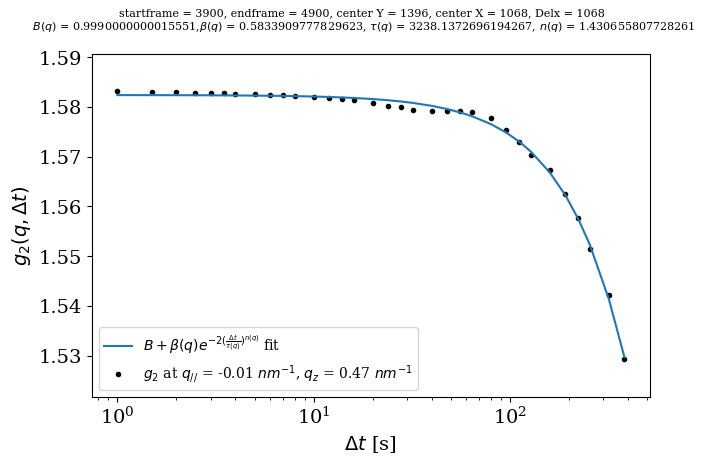

3.0105777731195134e-07 1.0


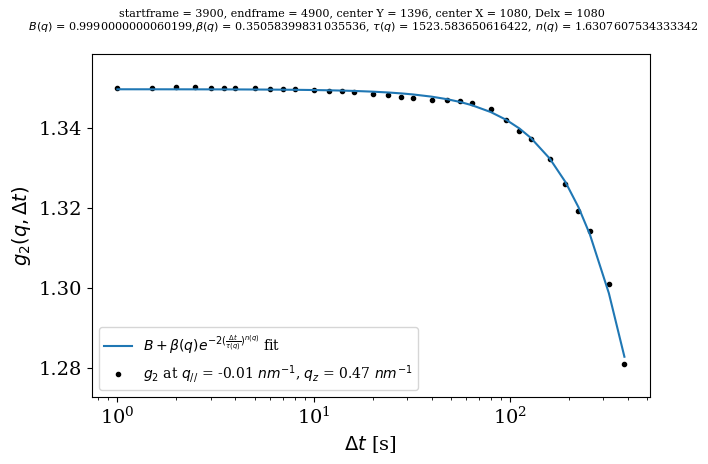

4.2635042561714594e-07 1.0


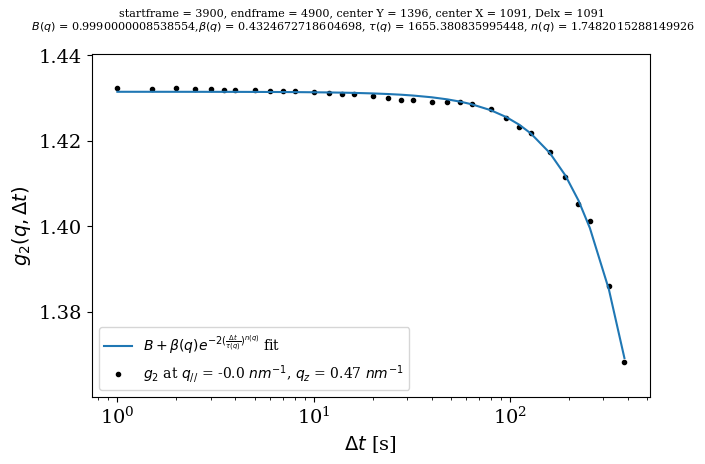

3.6470206846799657e-07 1.0


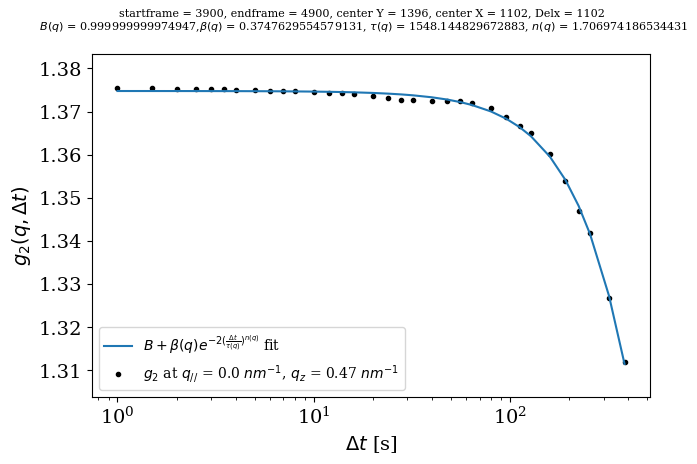

3.0151446760304723e-07 1.0


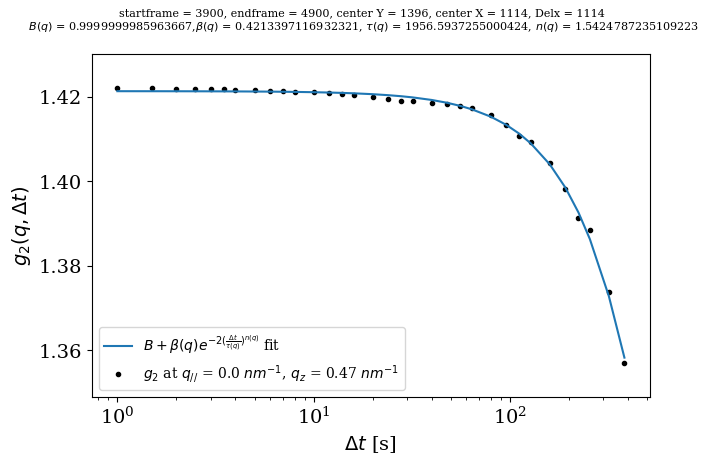

4.169793136606953e-07 1.0


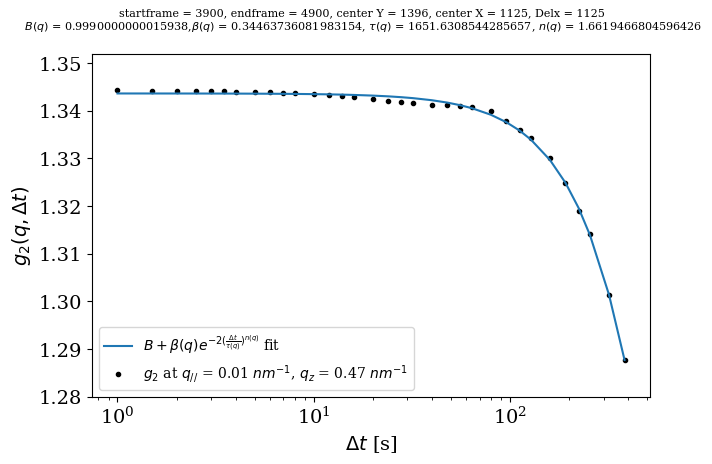

2.255466670068193e-07 1.0


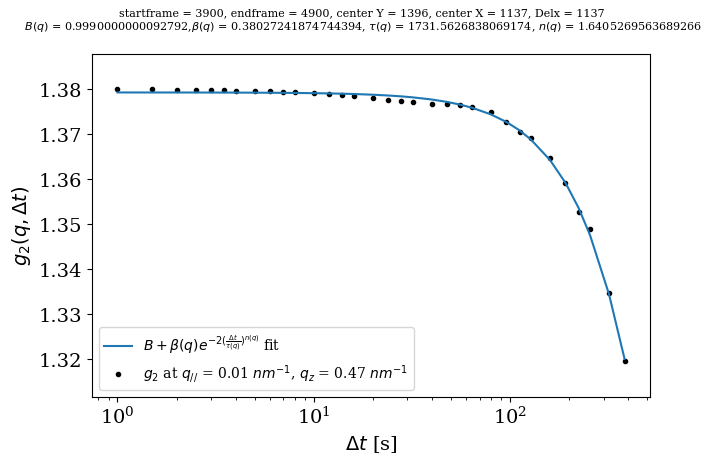

2.8115365257446877e-07 1.0


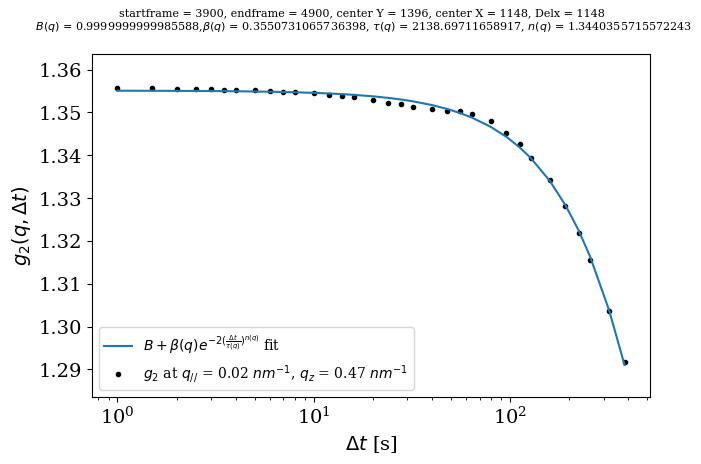

3.657235289203074e-07 1.0


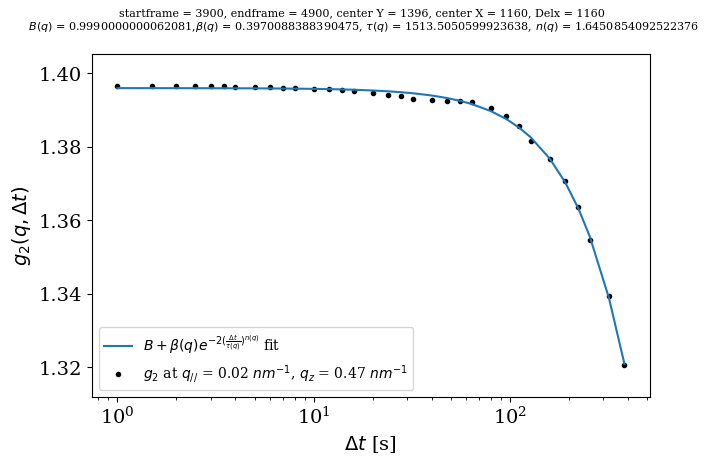

3.3731805493499635e-07 1.0


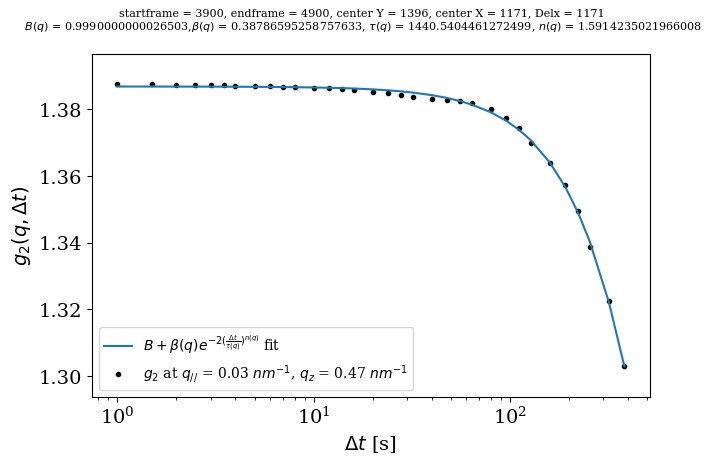

3.684462416762696e-07 1.0


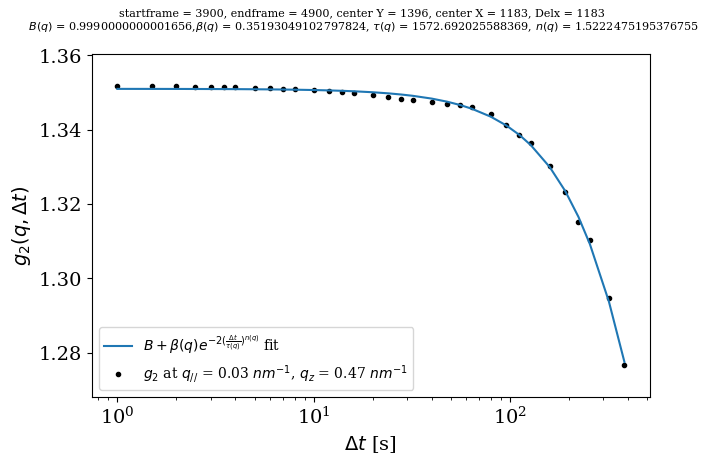

3.7569615677674773e-07 1.0


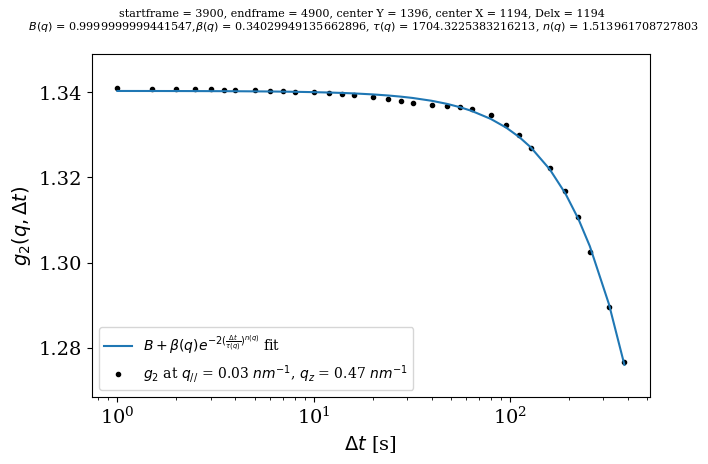

2.972133361338539e-07 1.0


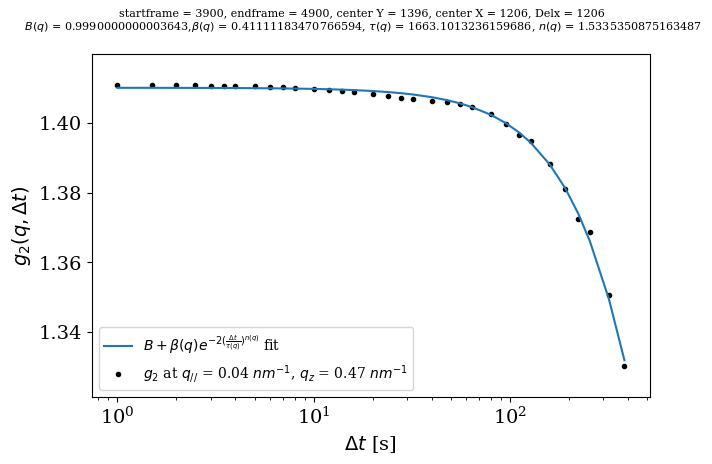

6.38078544508975e-07 1.0


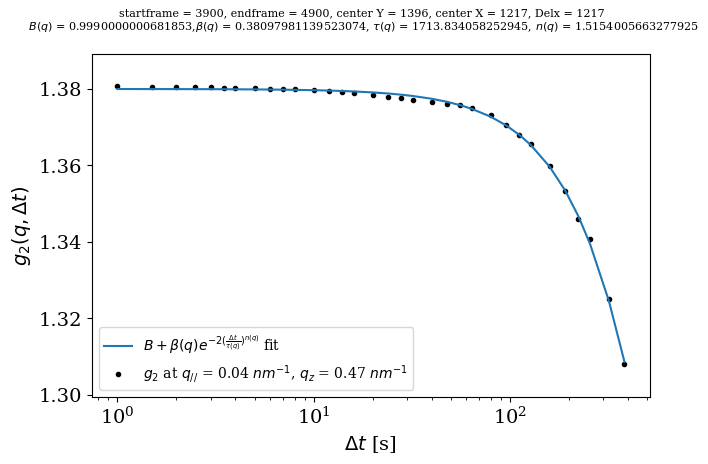

2.497384573277124e-07 1.0


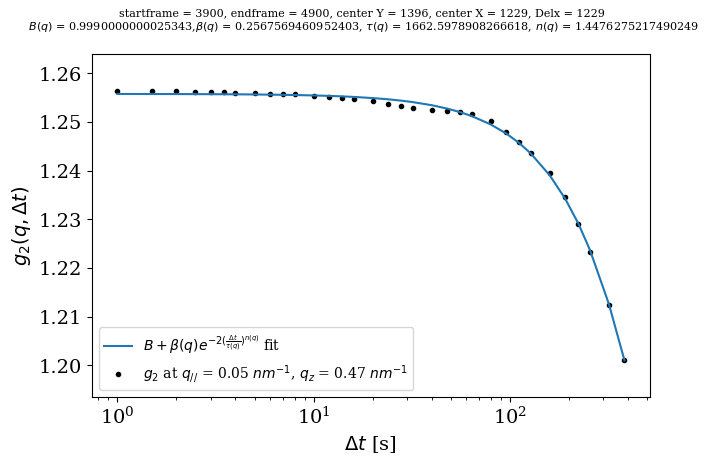

2.4383662834614503e-07 1.0


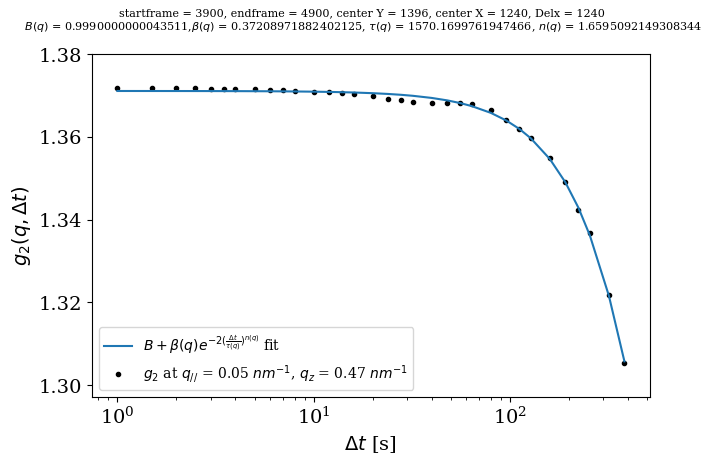

3.306729304532231e-07 1.0


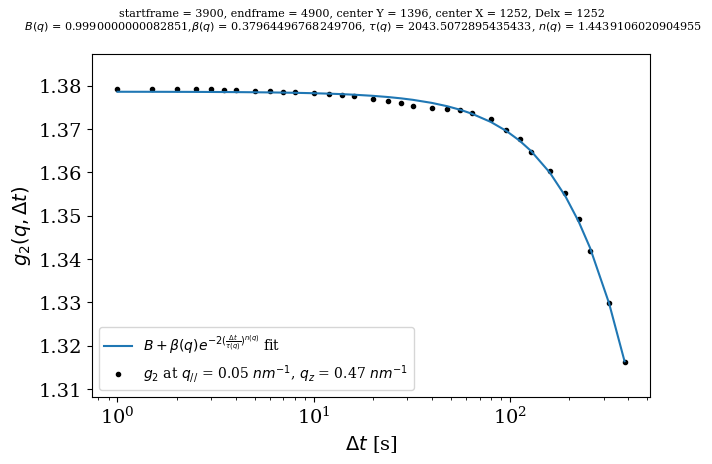

3.0553648617628914e-07 1.0


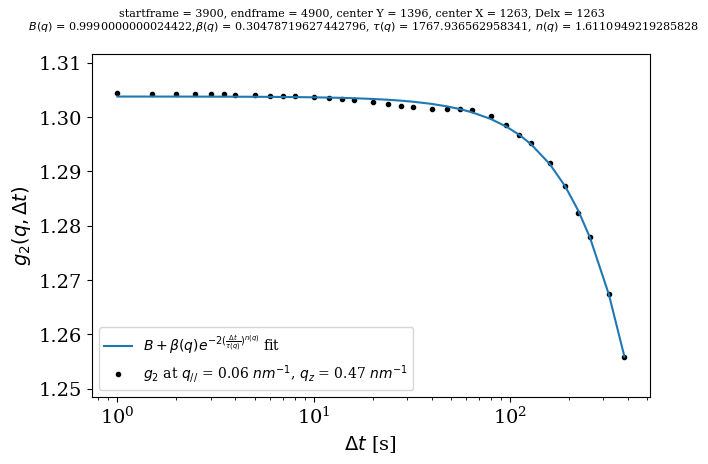

1.8722222559302037e-07 1.0


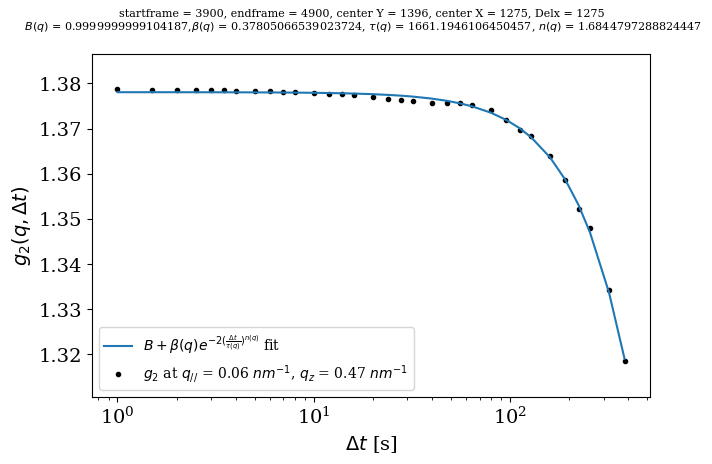

2.5439845206058726e-07 1.0


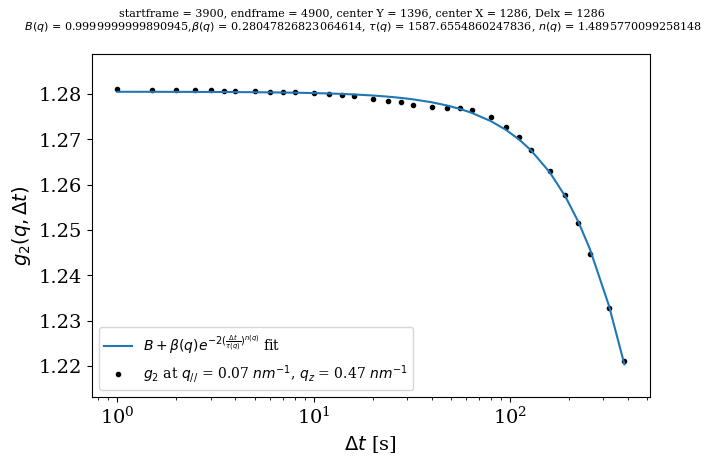

3.001882244546874e-07 1.0


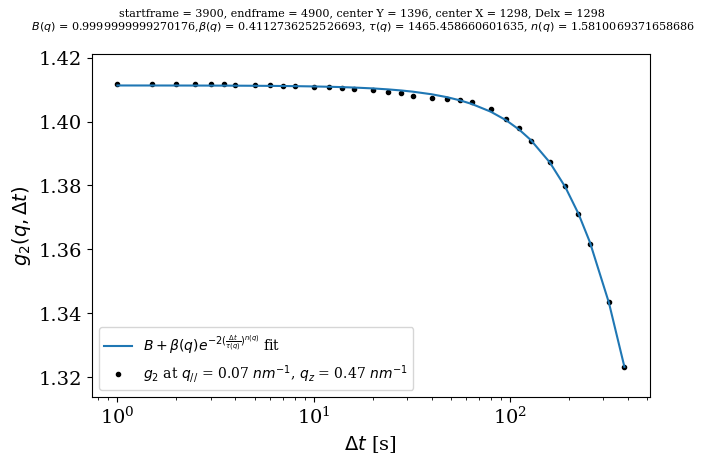

2.3181266190293238e-07 1.0


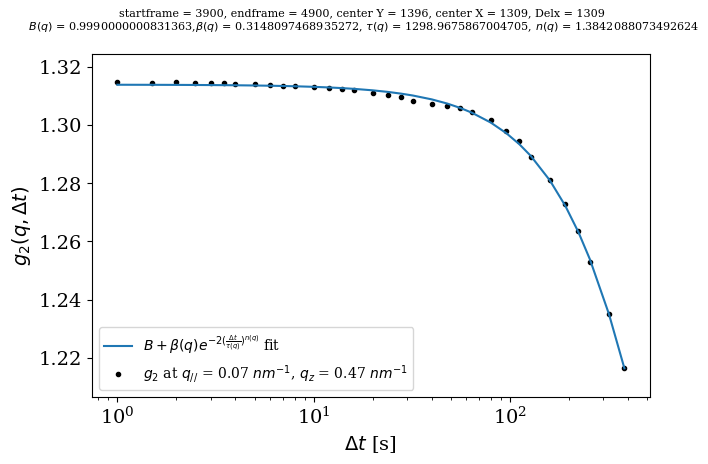

4.914448041872817e-07 1.0


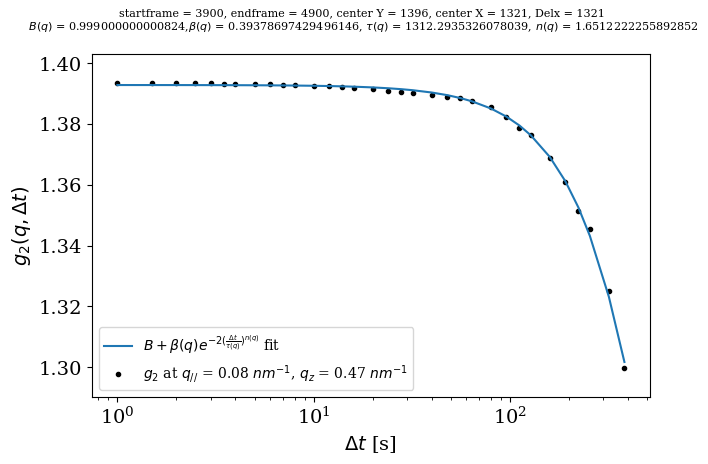

5.5142768623273e-07 1.0


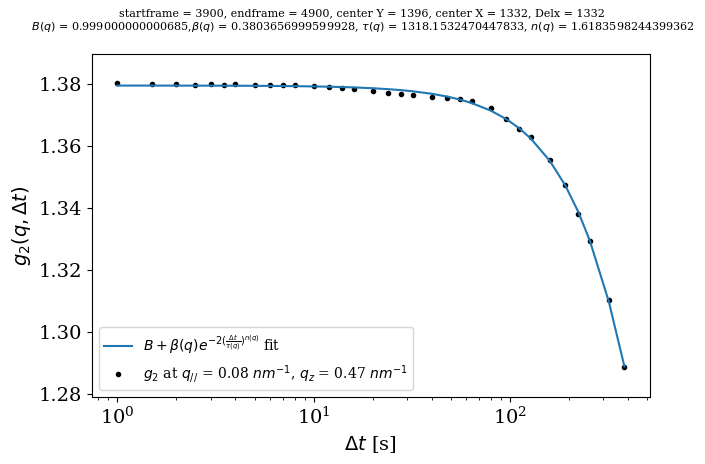

2.8238711621684684e-07 1.0


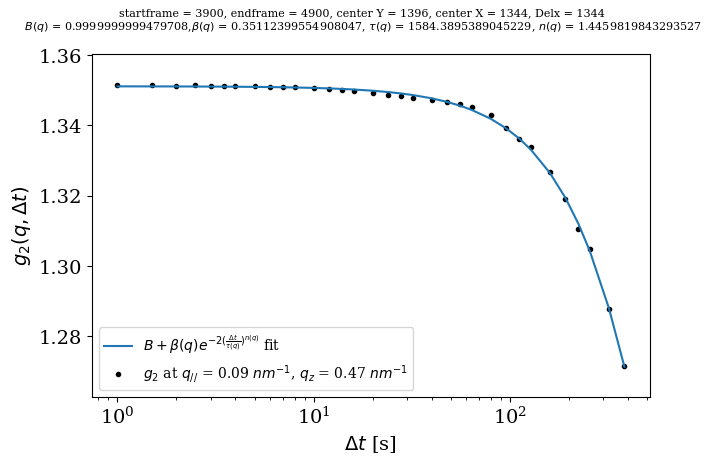

2.3853090222851217e-07 1.0


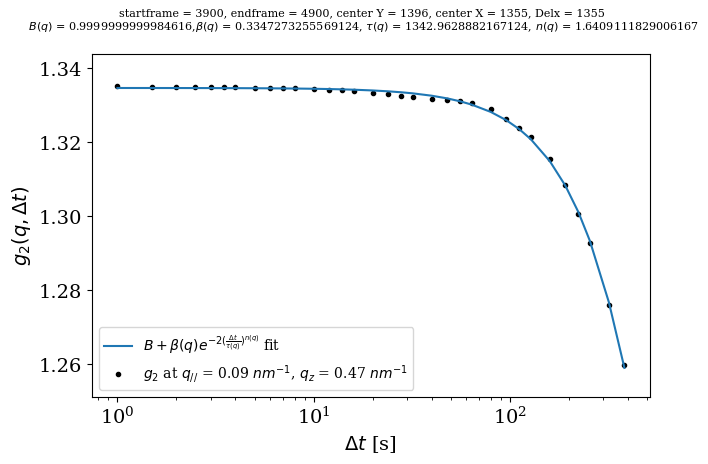

2.379672304007635e-07 1.0


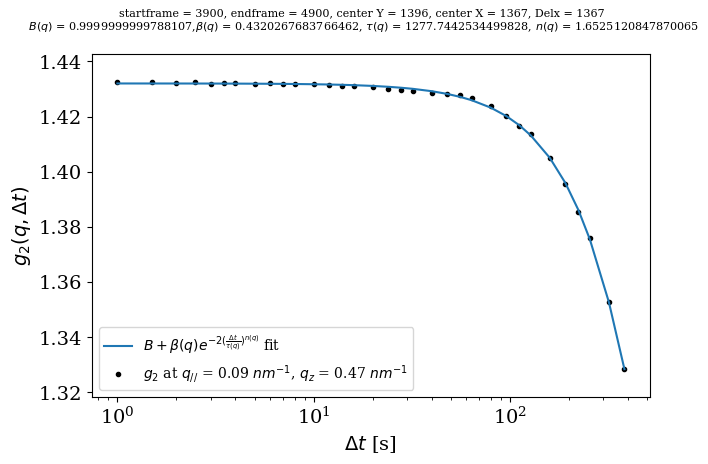

1.7533119014083002e-07 1.0


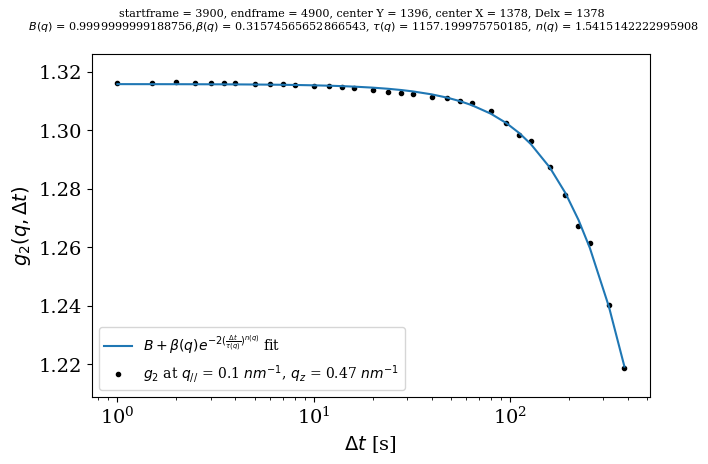

4.749658921434818e-07 1.0


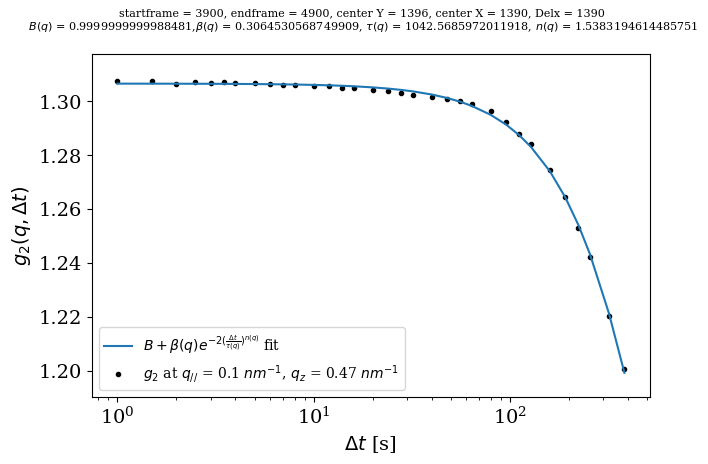

5.277466418793137e-07 1.0


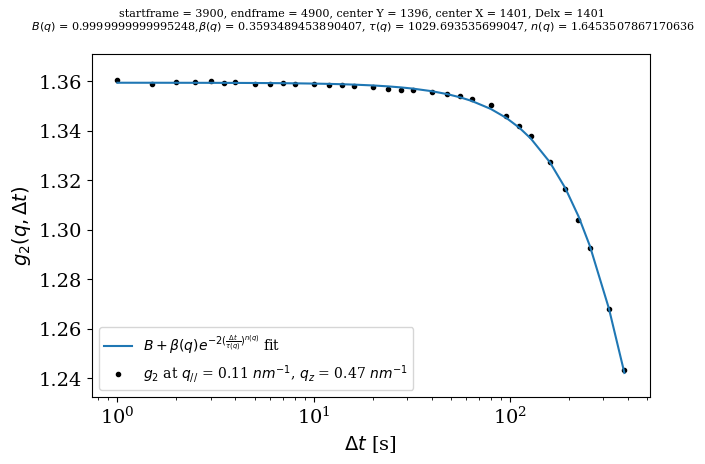

4.1645657520456796e-07 1.0


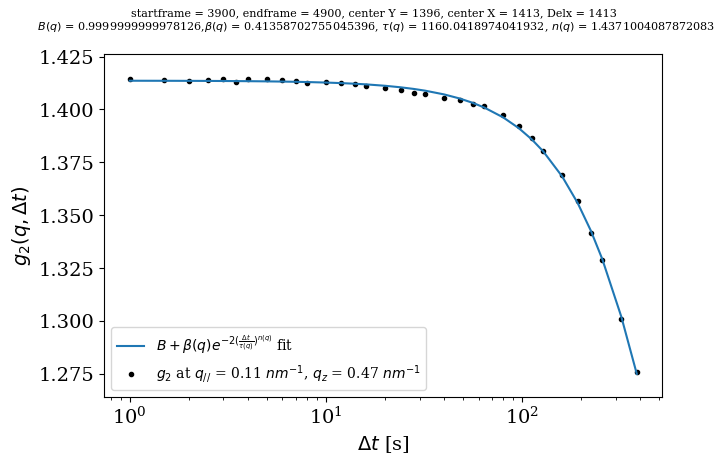

6.352554847775731e-07 1.0


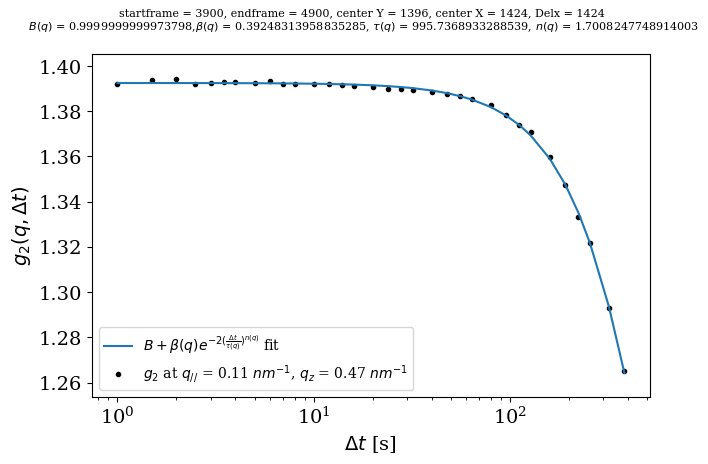

4.929458529880941e-07 1.0


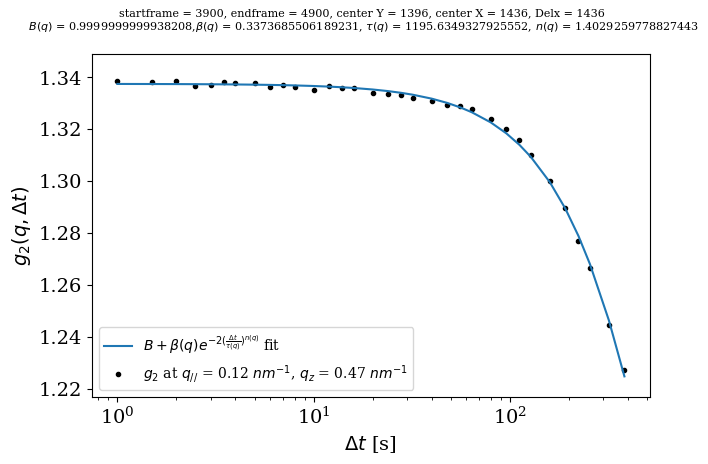

1.1117201793760146e-06 1.0


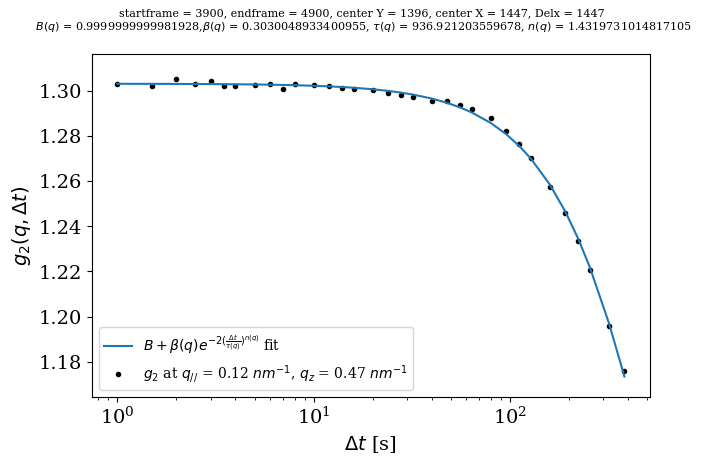

1.051854736394786e-06 1.0


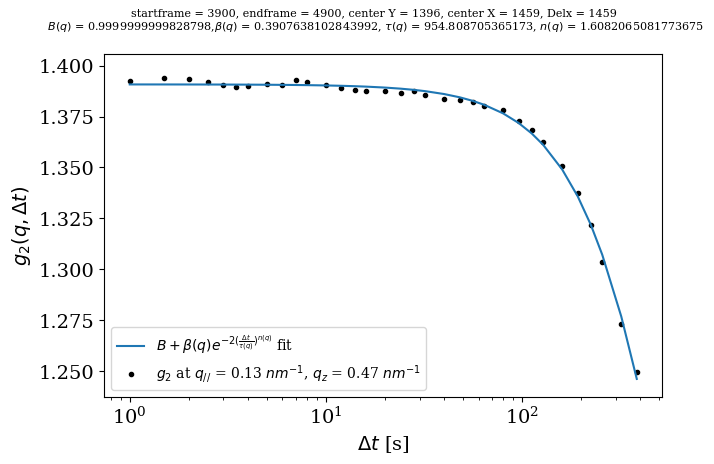

2.7559969850836787e-06 1.0


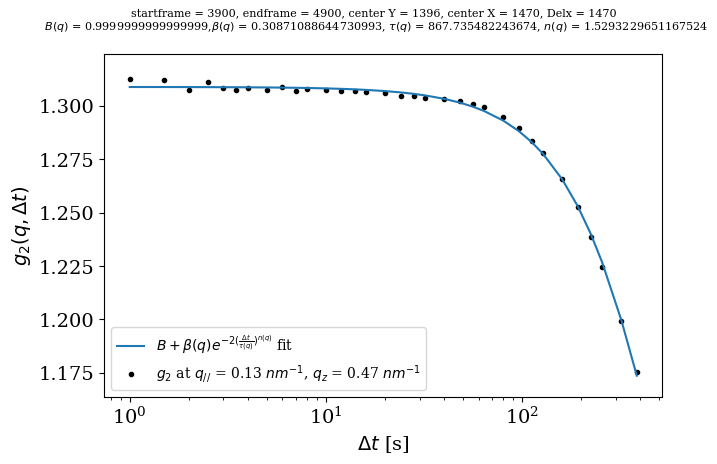

1.8529821097030847e-06 1.0


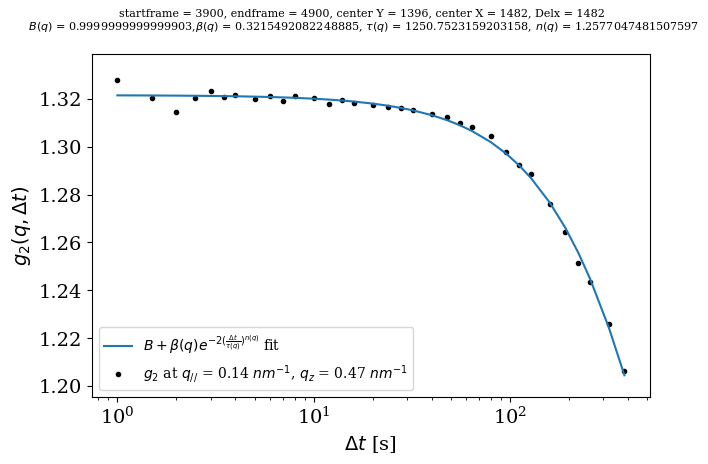

3.904056004728152e-06 1.0


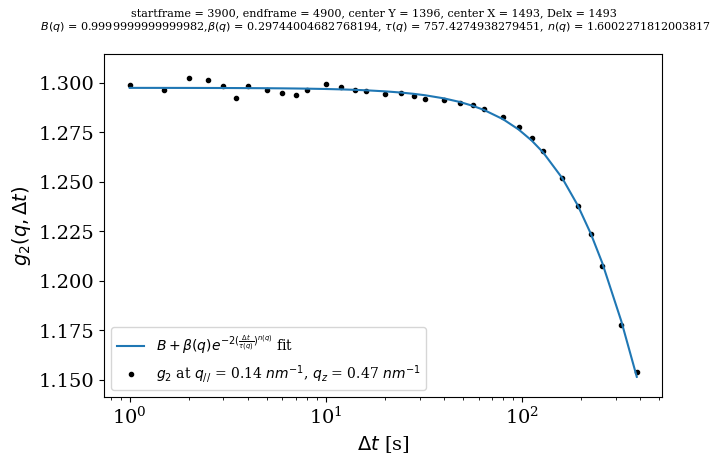

3.287911445950075e-06 1.0


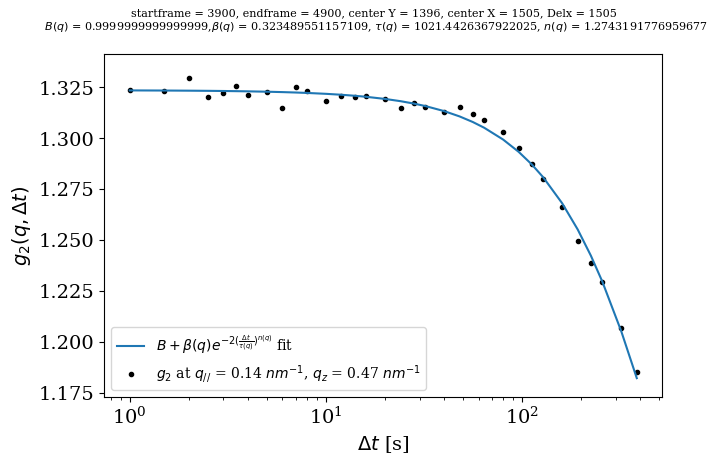

7.390741841650777e-06 1.0


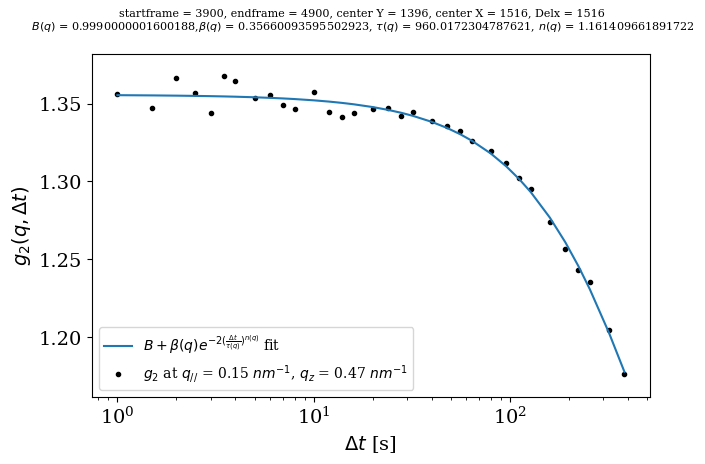

2.3472221935201145e-05 1.0


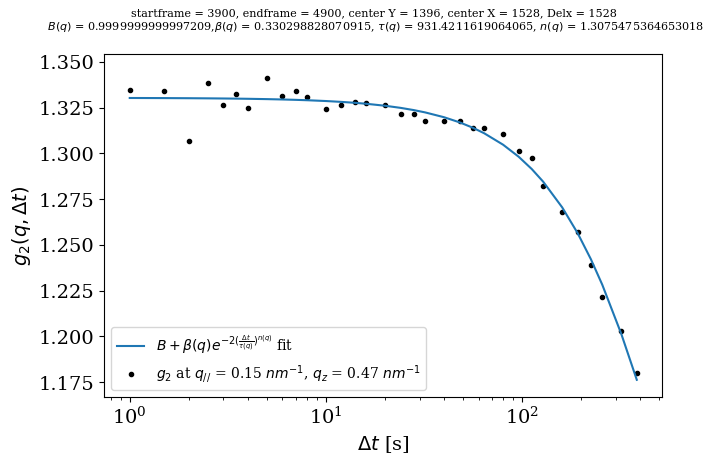

2.8521151081353615e-05 1.0


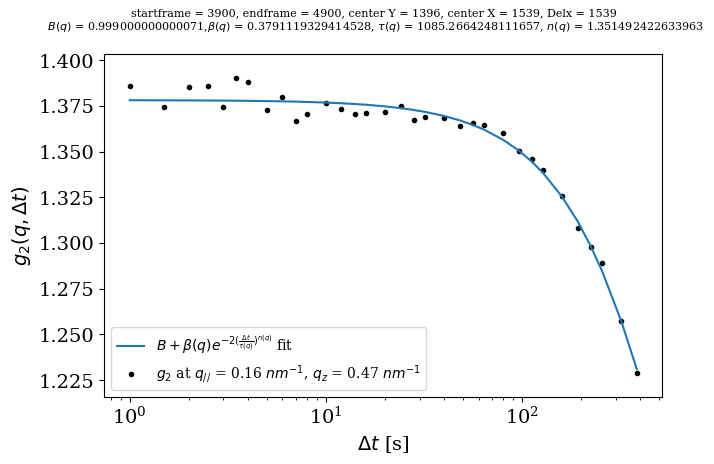

2.1352619961209795e-05 1.0


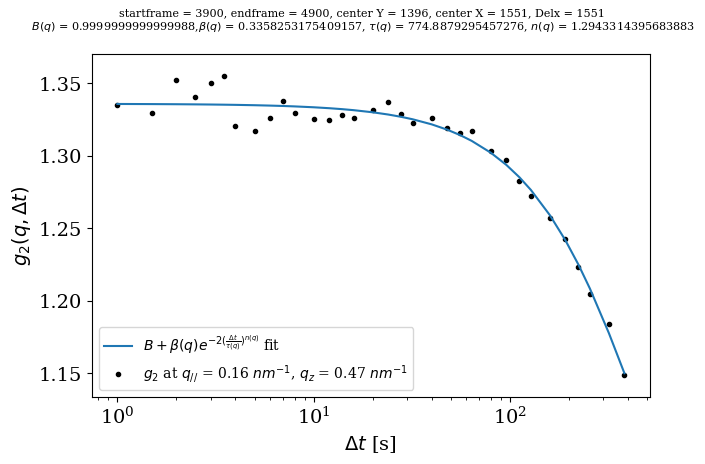

5.3155724633275004e-05 1.0


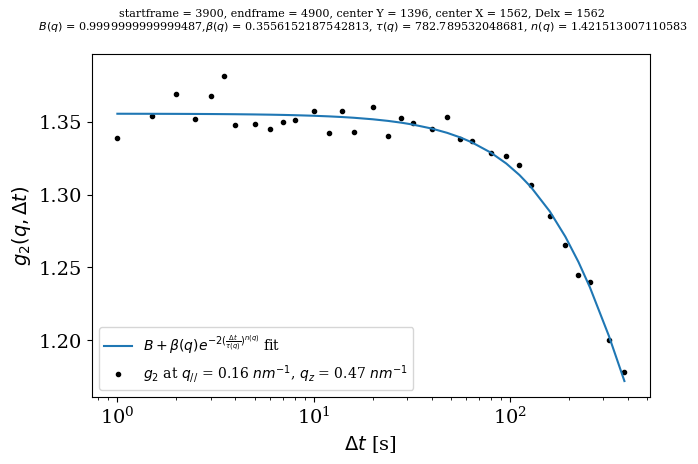

6.069672829029365e-05 1.0


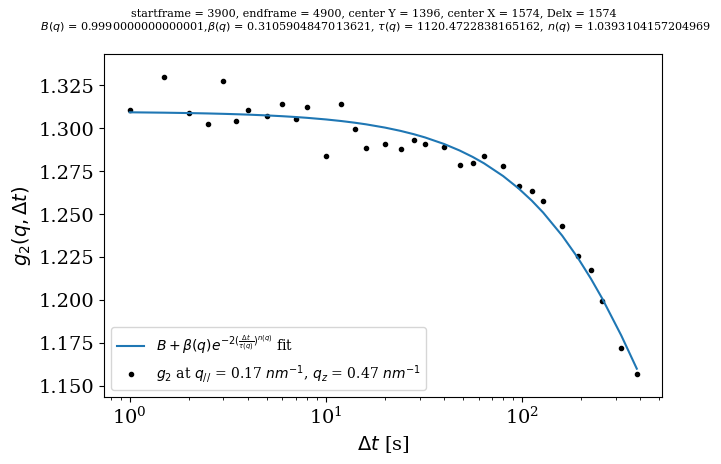

6.031986175725724e-05 1.0


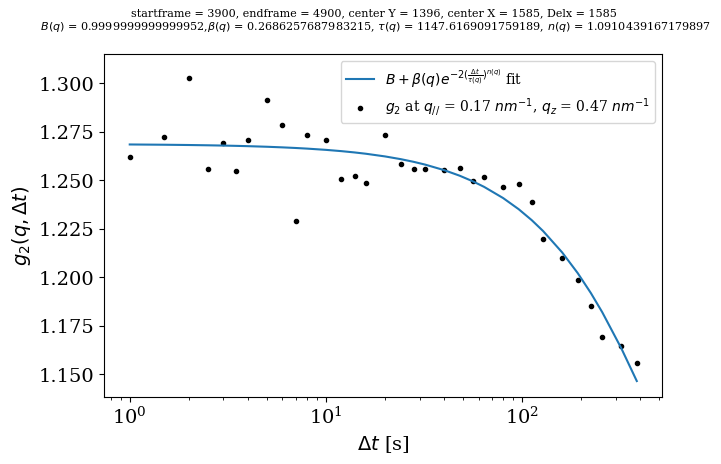

0.0001416851339183283 1.0


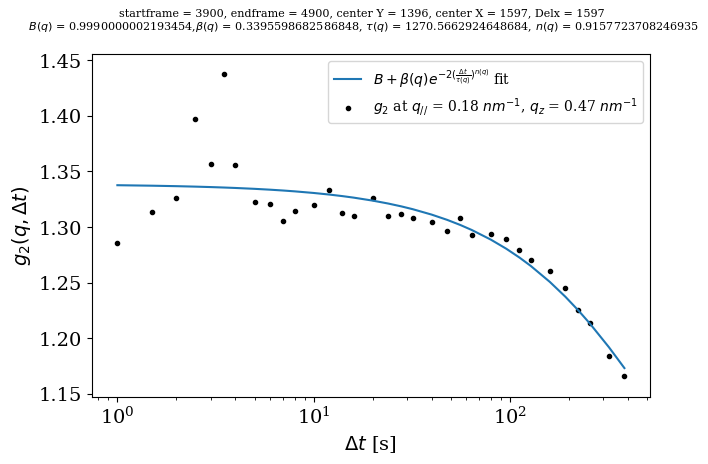

0.0005477504065893187 1.0


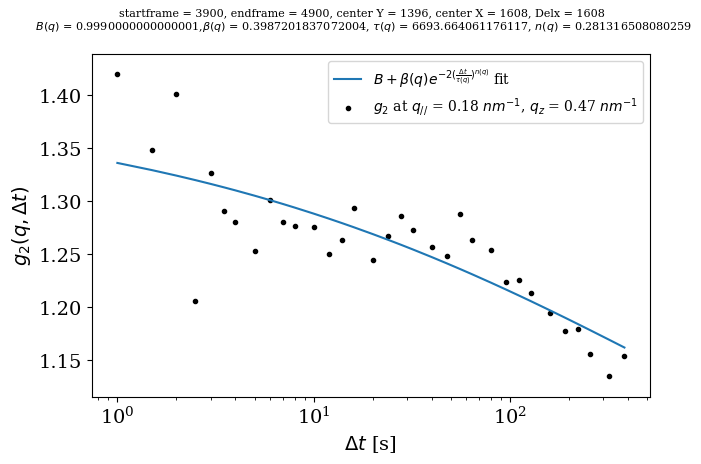

0.0011152240815732373 1.0


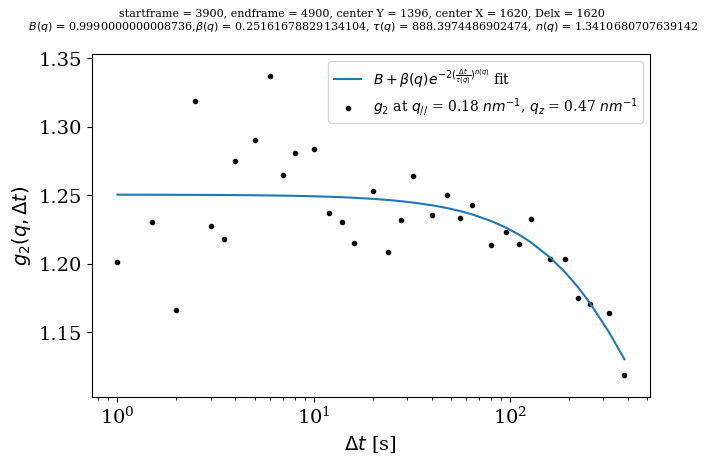

0.0009220298165693449 1.0


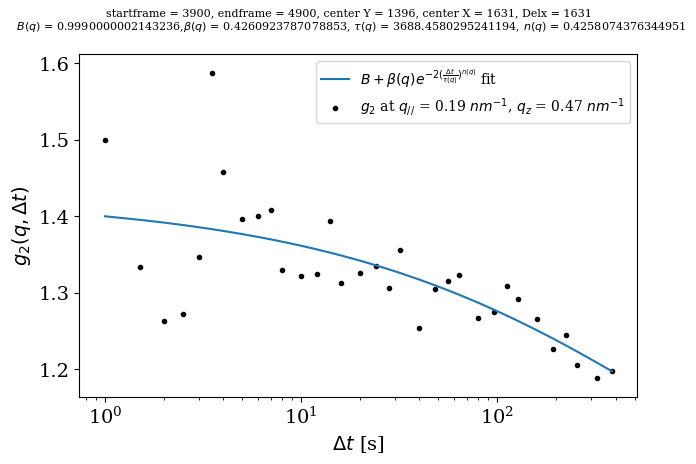

0.0028279763767791698 1.0


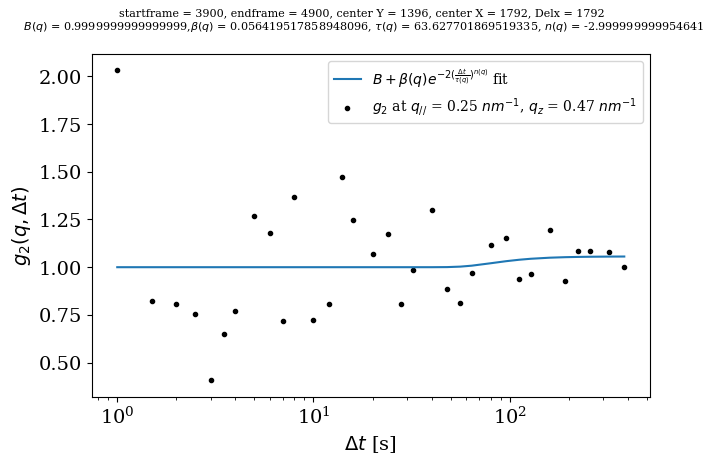

0.09427319428997184 0.9999999999980319



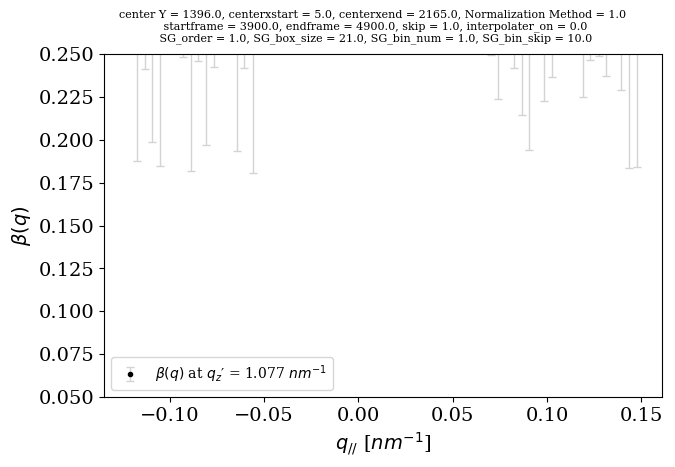

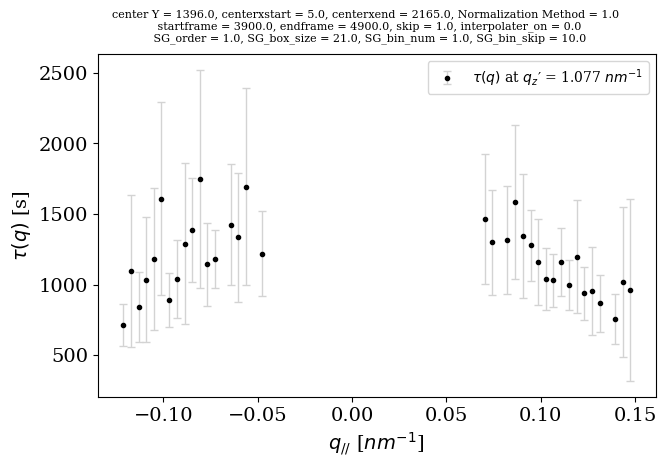

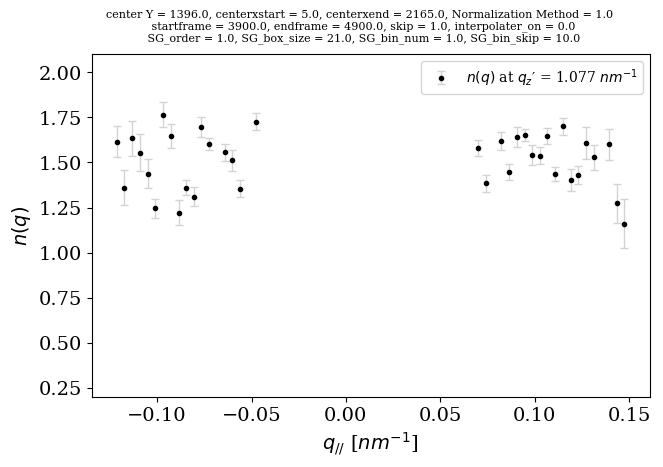

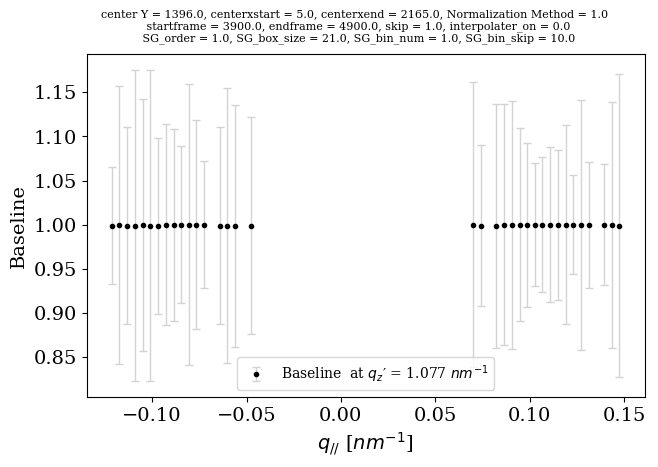

In [127]:
exponents = read_and_get_exponents_along_q_parallel_Mark(startY=1350,endY=1450,delY=91,startX=0,endX=2160,delX=11,startframe=3900,endframe=4900,Xlogscale = False, Xlog_num = 100, p0=[0.15,50,1.2,1.0],normalize = 1, bin_num = 1,  bin_skip = 10,nobuf=8,nolev=8,skip=1, interpolater_on = False, SG_order = 1, SG_box_size = 21)
plot_exponents(exponents)

calculating g2


/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py:64: RuntimeWarning: divide by zero encountered in true_divide
  
/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py:64: RuntimeWarning: invalid value encountered in true_divide
  
/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py:96: RuntimeWarning: invalid value encountered in multiply
  ', center Y = {0}'.format(centery) +


/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py:67: RuntimeWarning: invalid value encountered in power
  return B+beta*np.exp(-2*((deltaT)/tau)**n)


<Figure size 720x445 with 0 Axes>

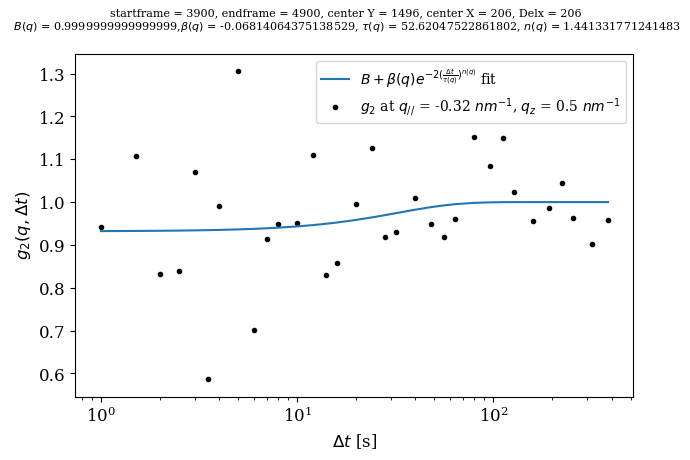

0.01996137368390982 1.0


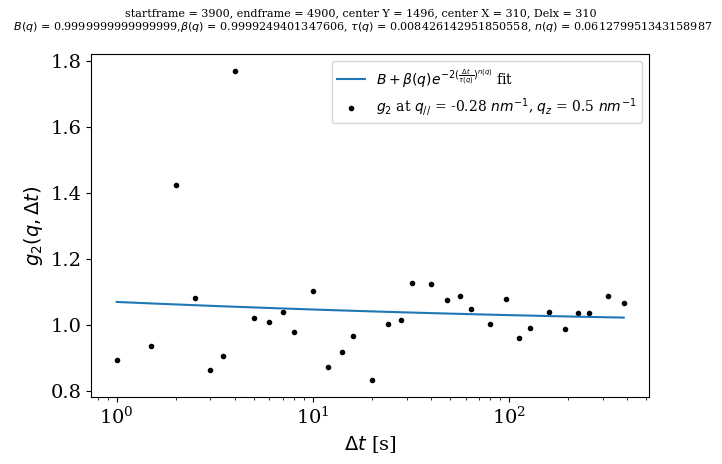

0.02937710515321354 1.0


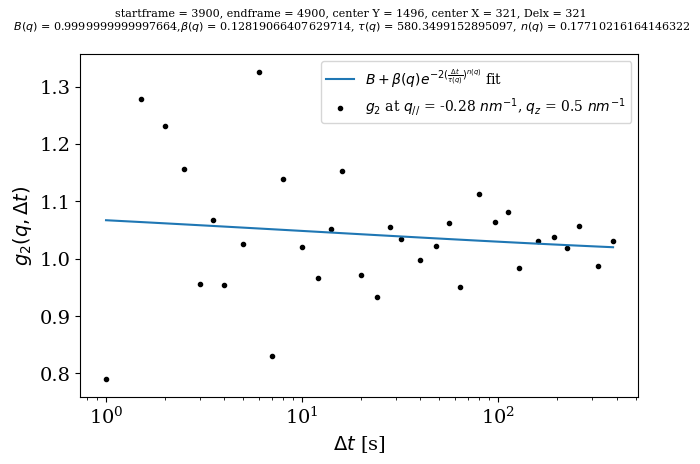

0.01221489299611606 1.0


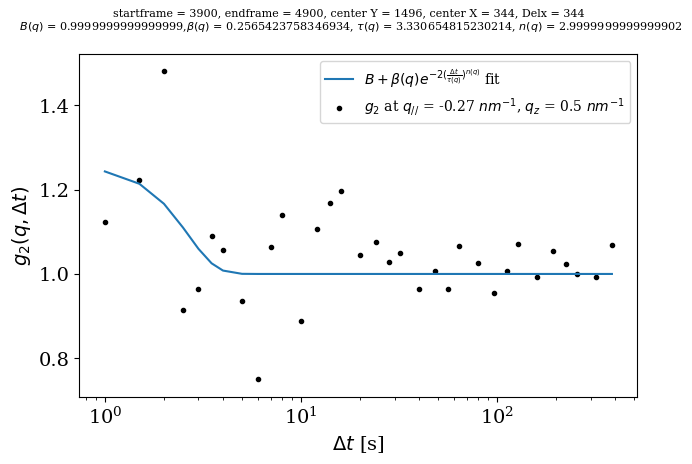

0.012458992472489468 1.0


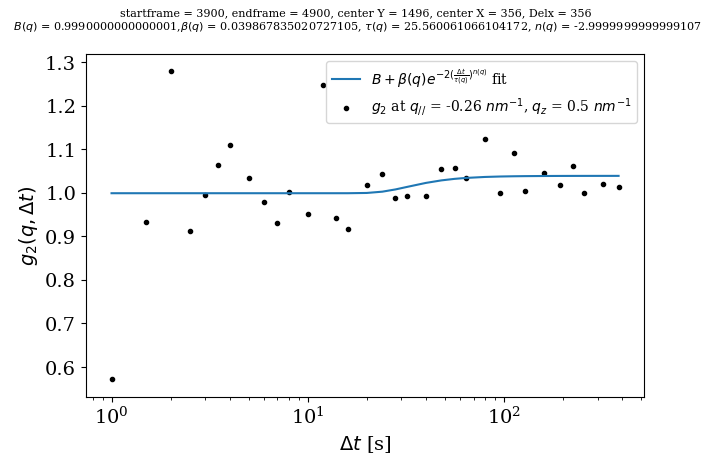

0.013456499447552379 1.0


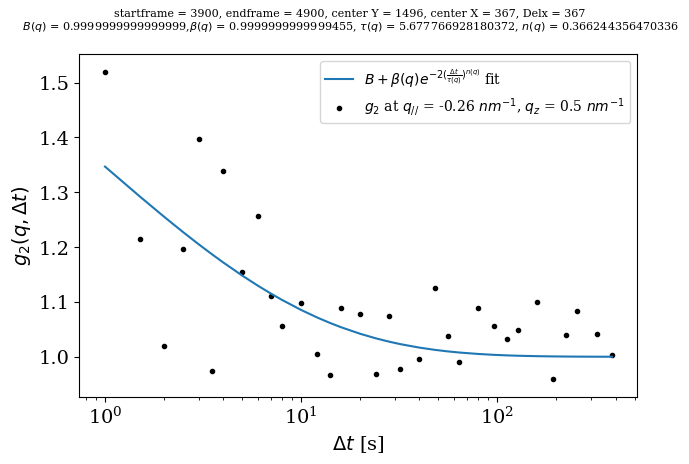

0.00868961089328344 1.0


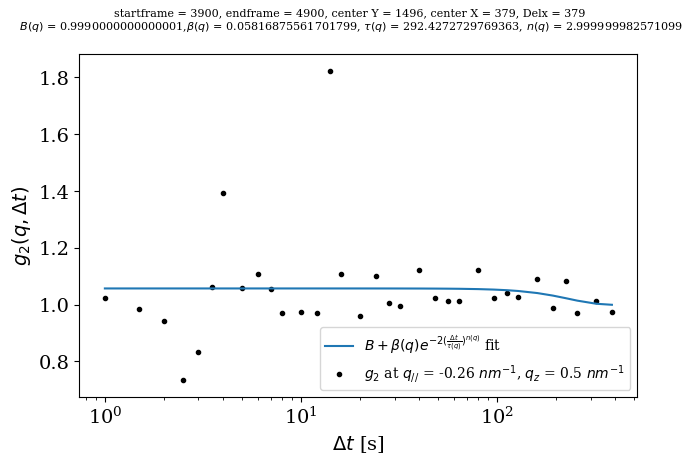

0.030778172248908914 1.0


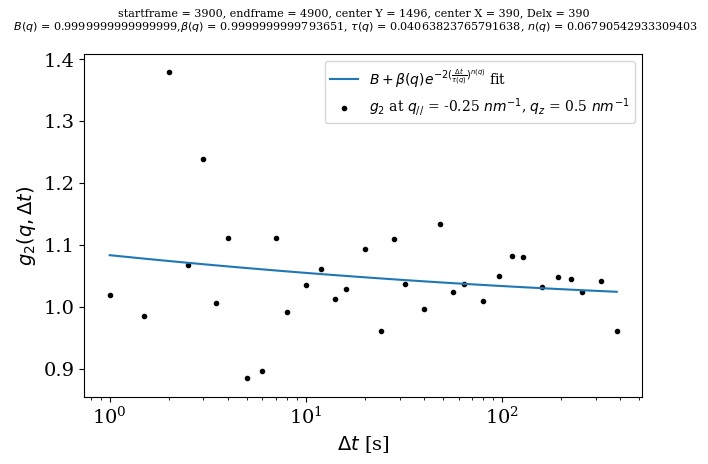

0.007889473266757936 1.0


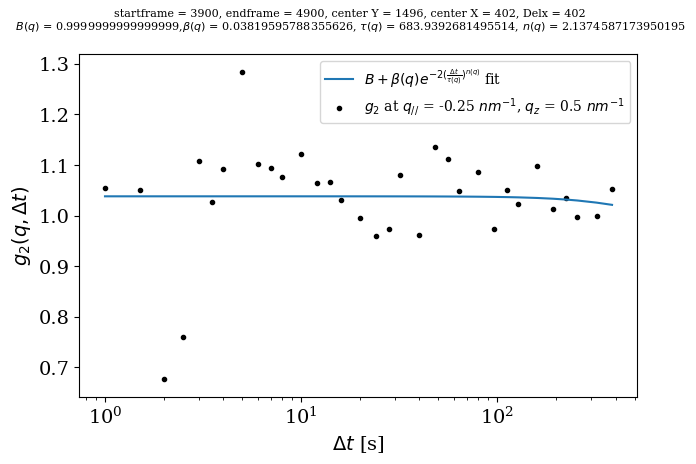

0.011378567928222266 1.0


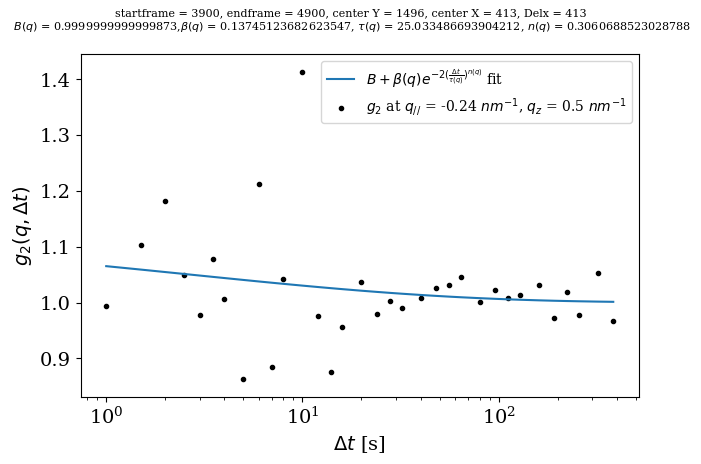

0.010077729240818026 1.0


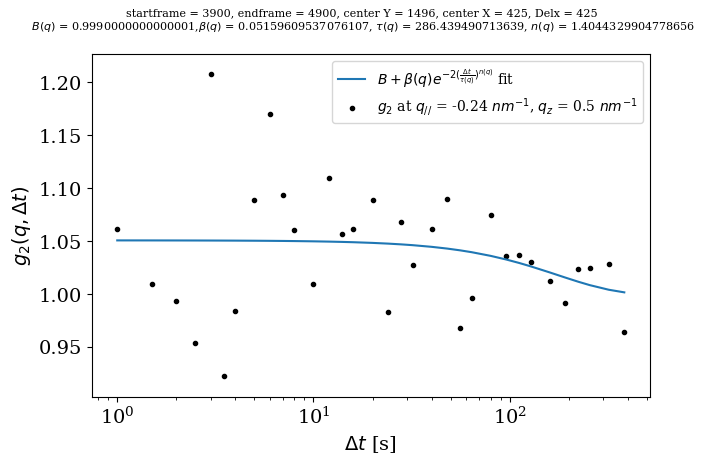

0.003420516448664445 1.0


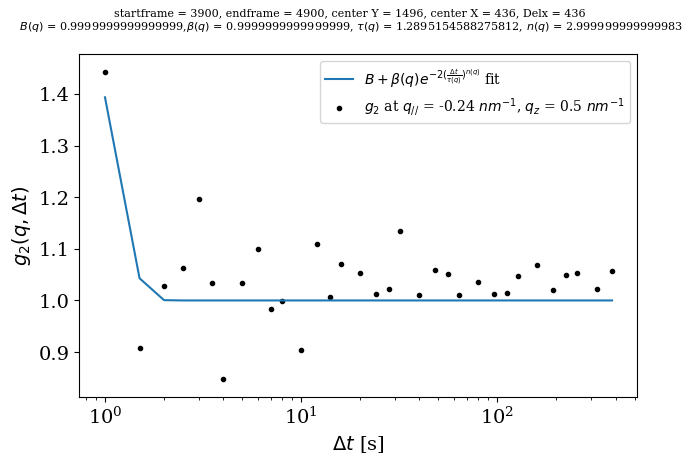

0.00587039410304713 1.0


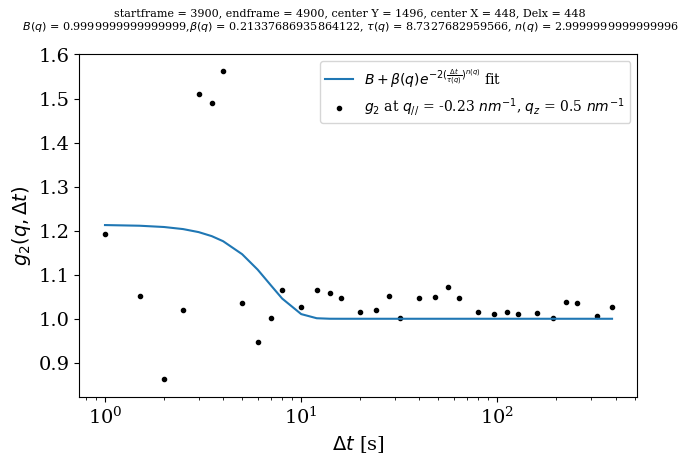

0.01734042782983315 1.0


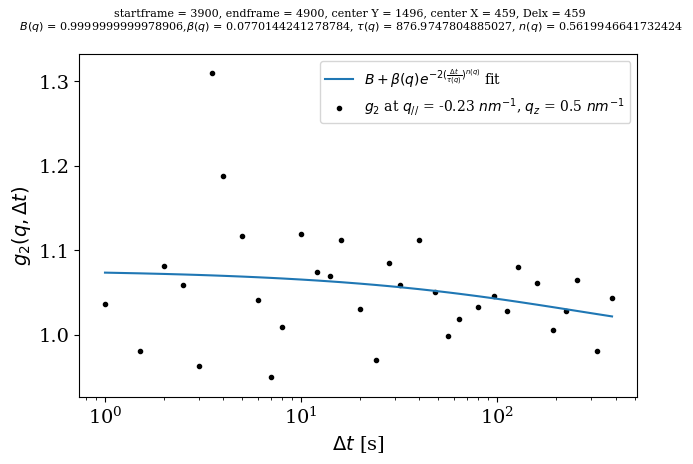

0.004594496130995829 1.0


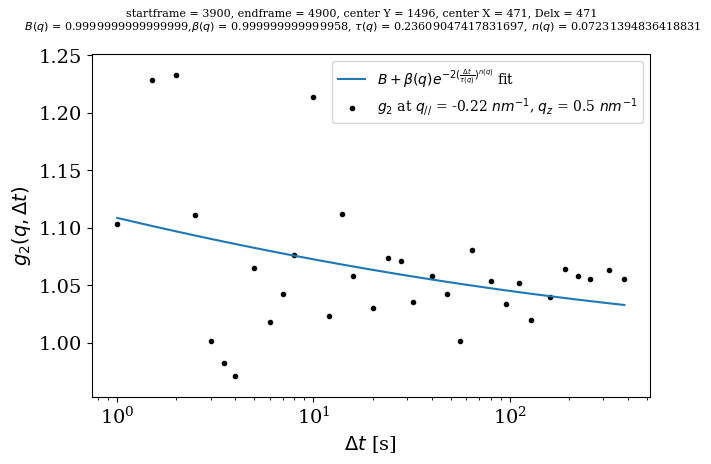

0.0033643993491651683 1.0


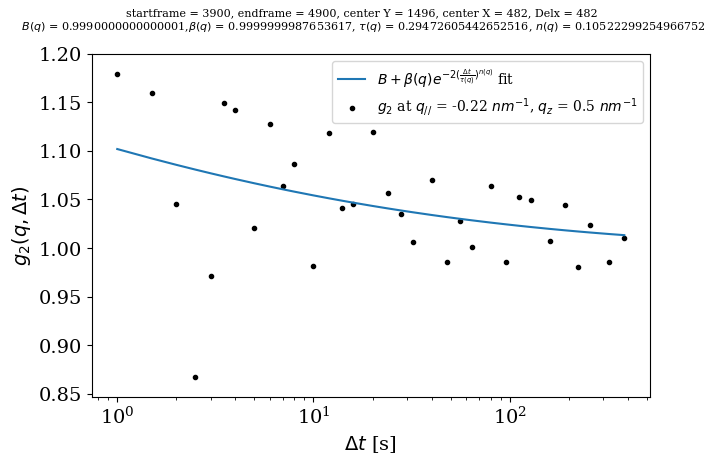

0.003722551272775665 1.0


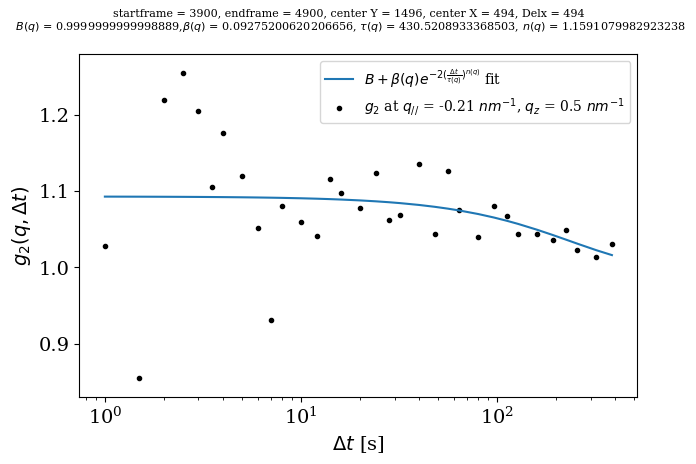

0.005227249882682901 1.0


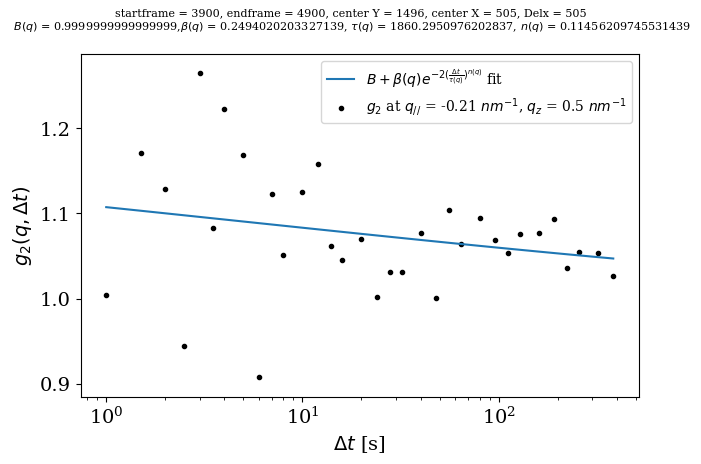

0.0048736432778847365 1.0


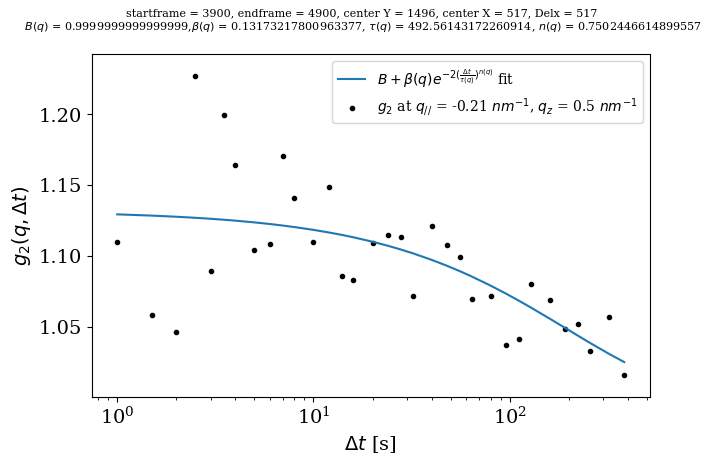

0.0012964249523195485 1.0


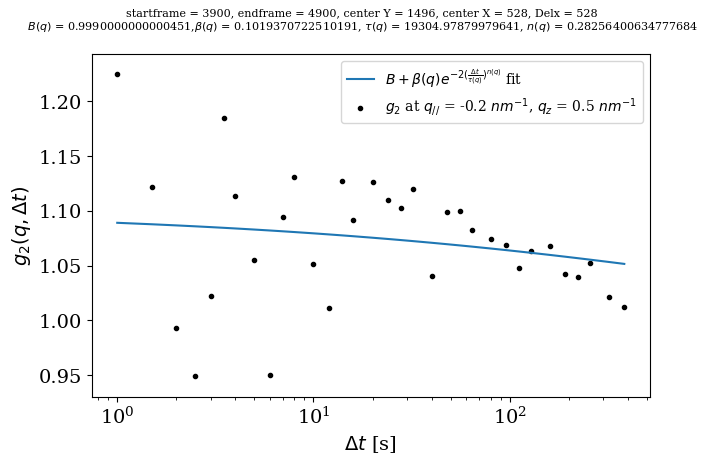

0.0033189404291215233 1.0


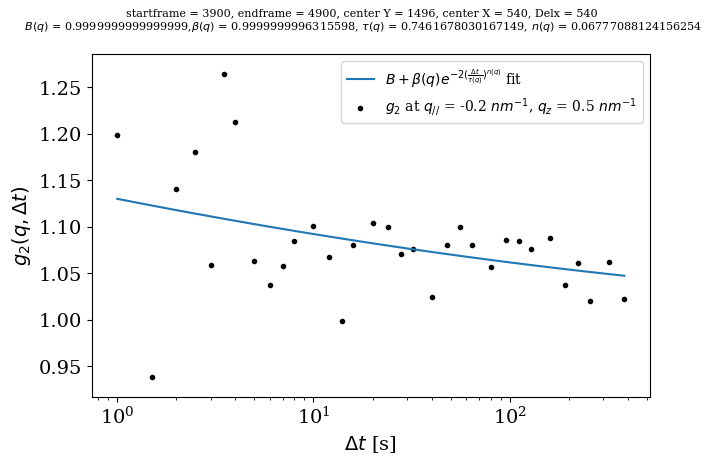

0.003339990244561523 1.0


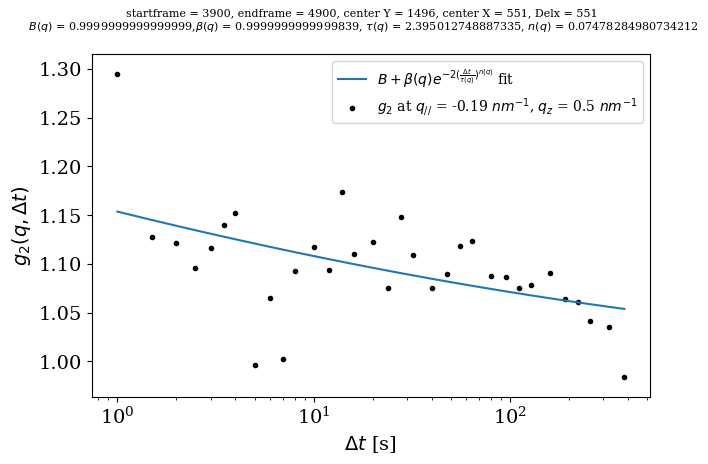

0.0023232538006491723 1.0


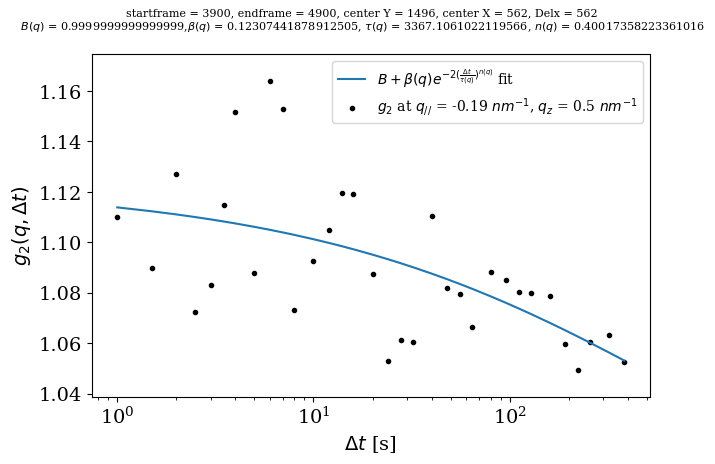

0.0005625915316034961 1.0


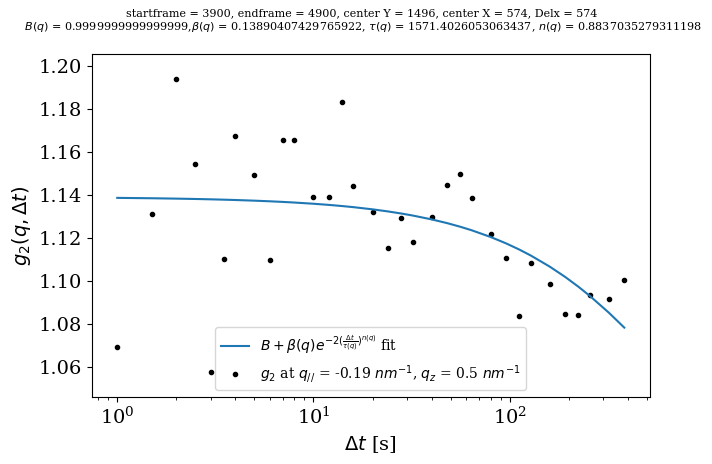

0.0007608656248999908 1.0


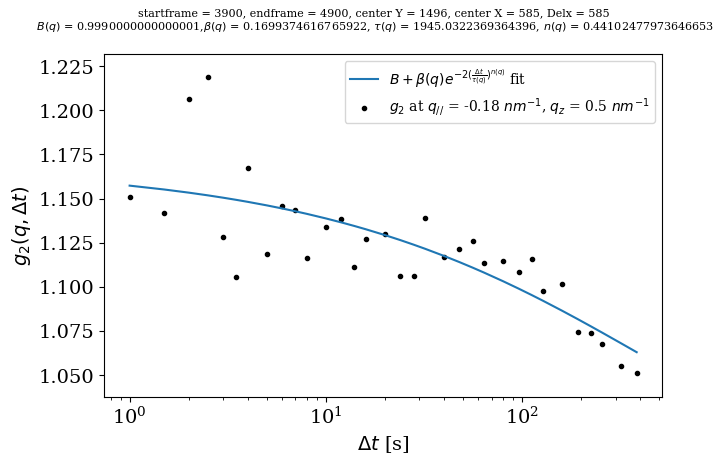

0.0004492022177327195 1.0


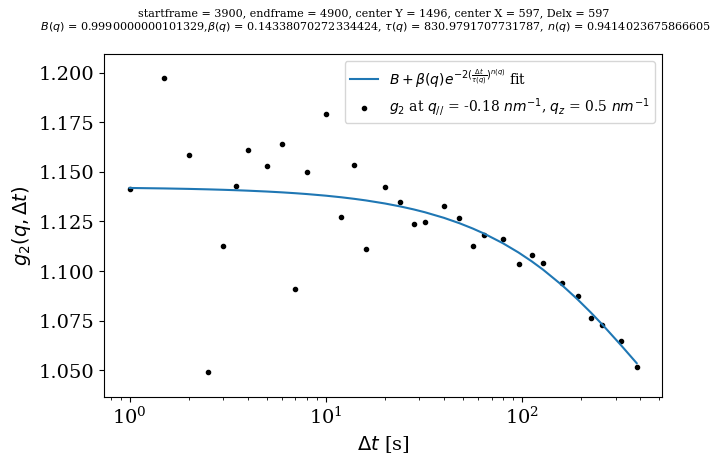

0.0005863568308973193 1.0


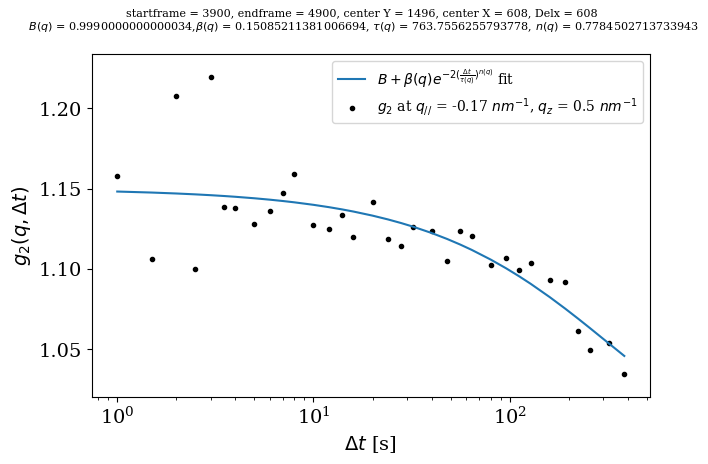

0.0004923262872151927 1.0


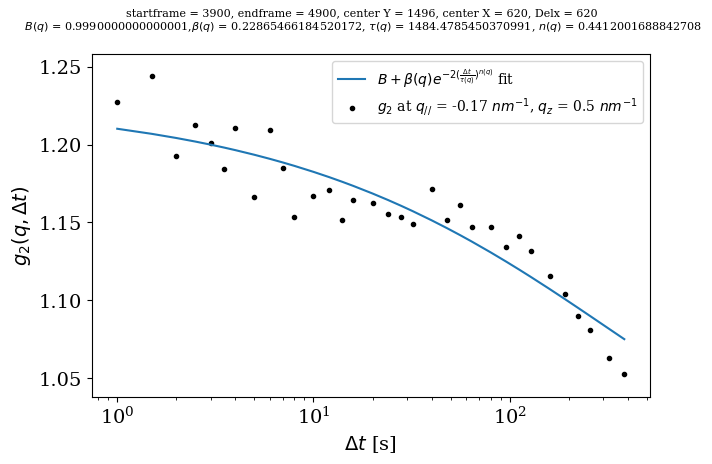

0.0002578854391959085 1.0


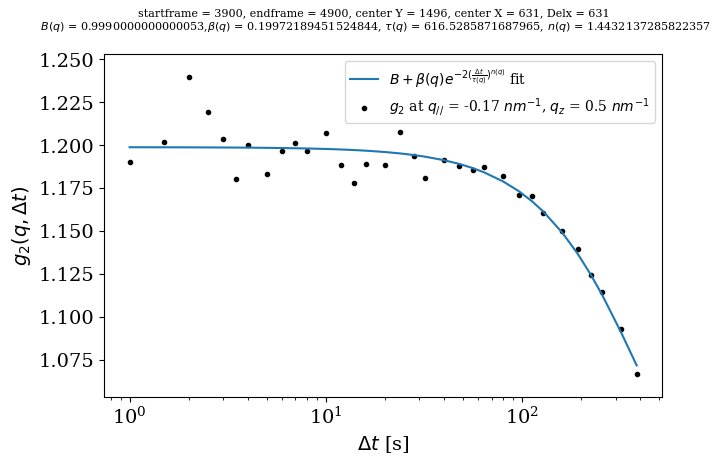

0.00011019314976141252 1.0


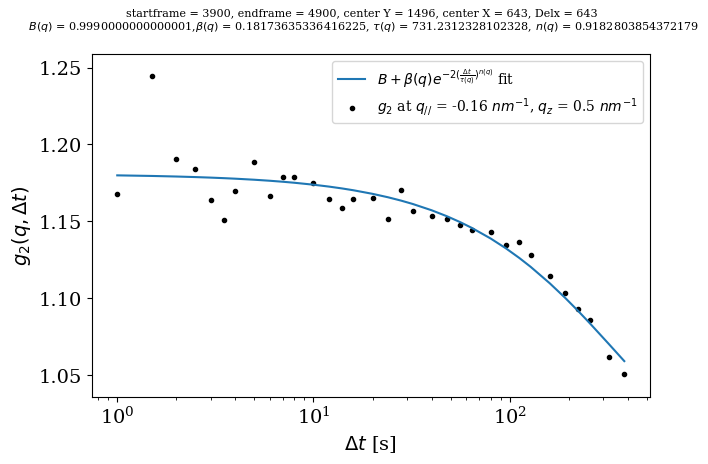

0.0001979576525727725 1.0


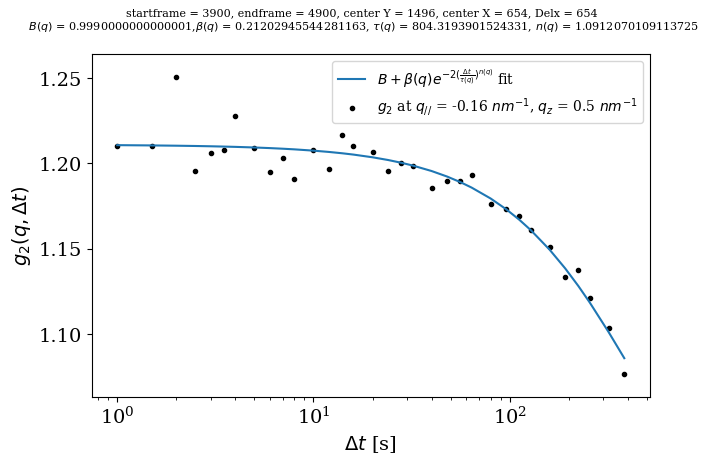

9.699401932521744e-05 1.0


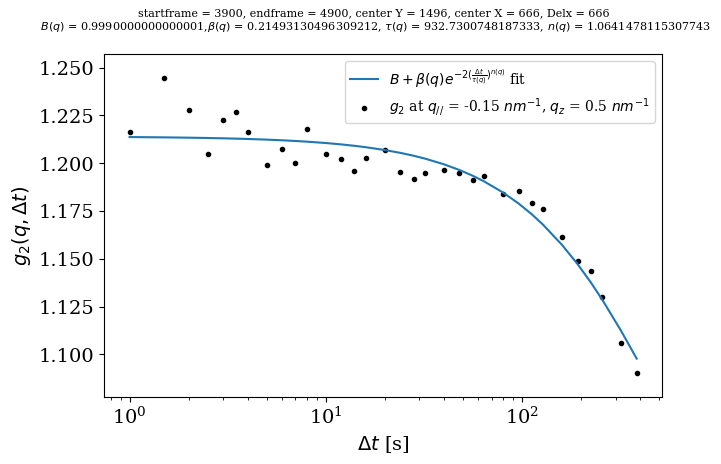

8.185910020823112e-05 1.0


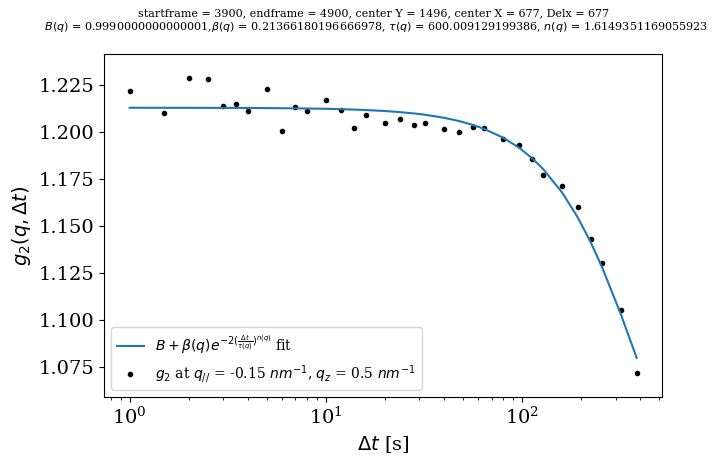

3.67972797061488e-05 1.0


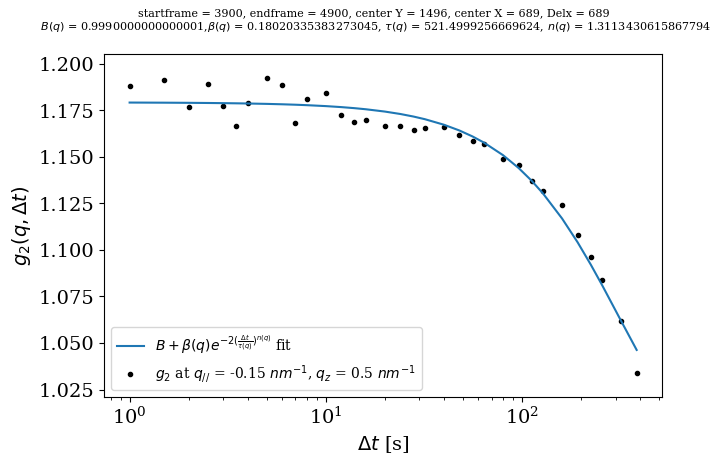

4.4679781775489705e-05 1.0


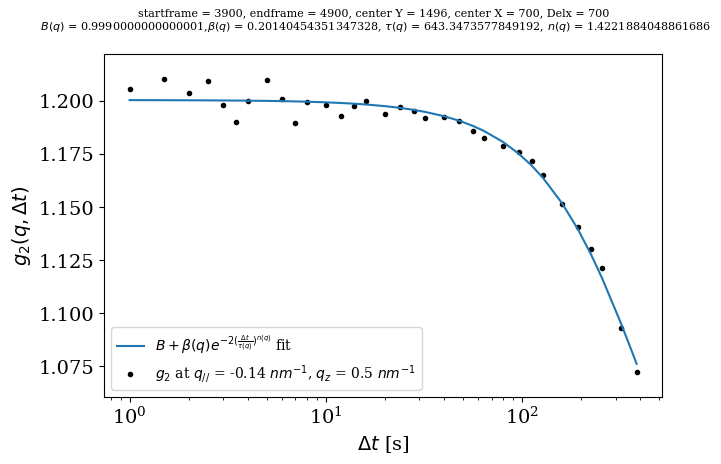

1.9785537512007693e-05 1.0


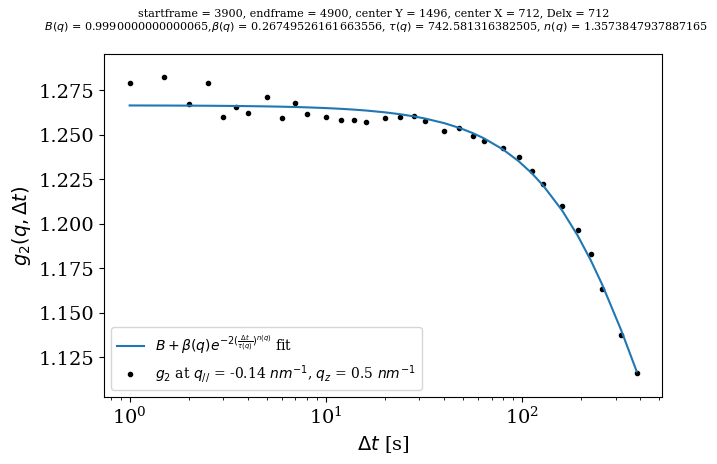

2.6019206457057497e-05 1.0


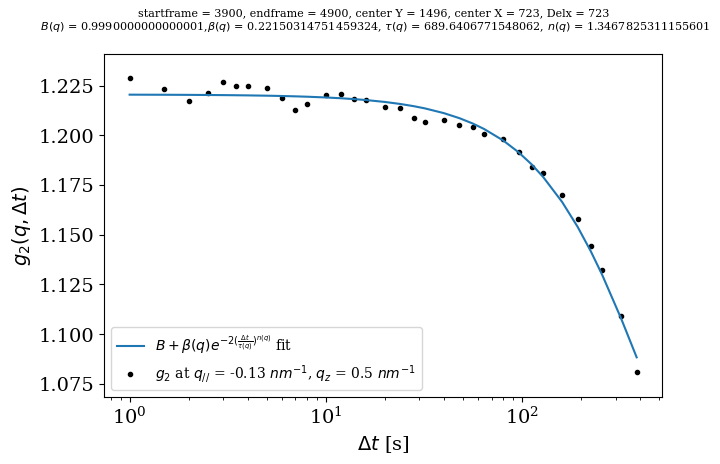

1.3945256795888474e-05 1.0


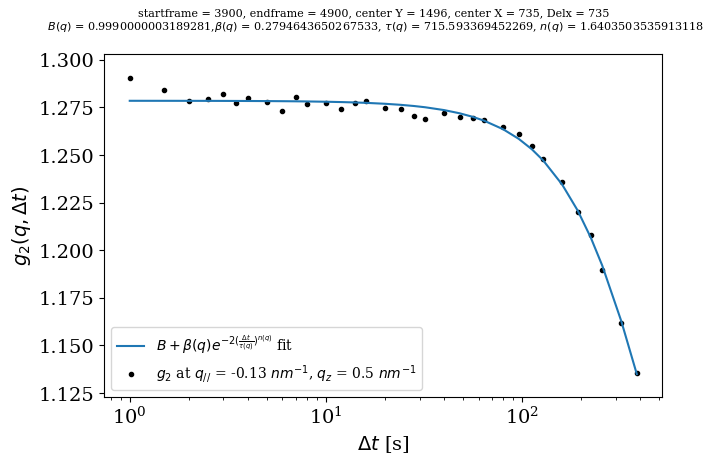

9.511576310263864e-06 1.0


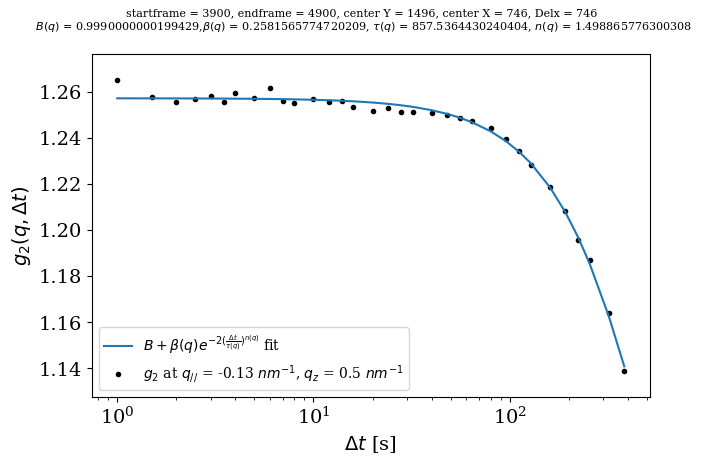

4.357571168051944e-06 1.0


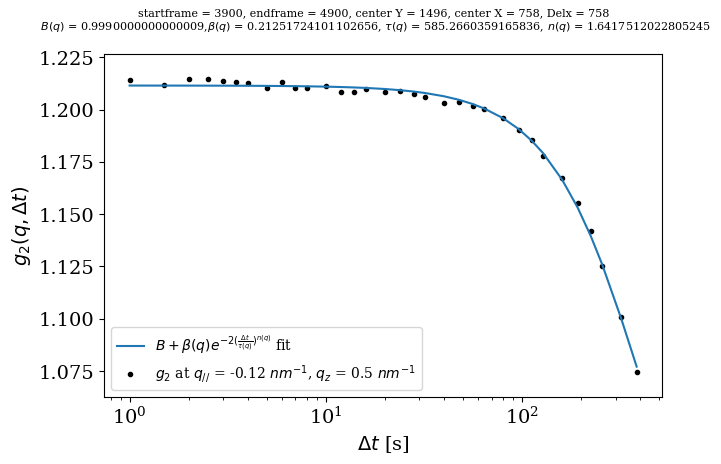

2.7373778935575023e-06 1.0


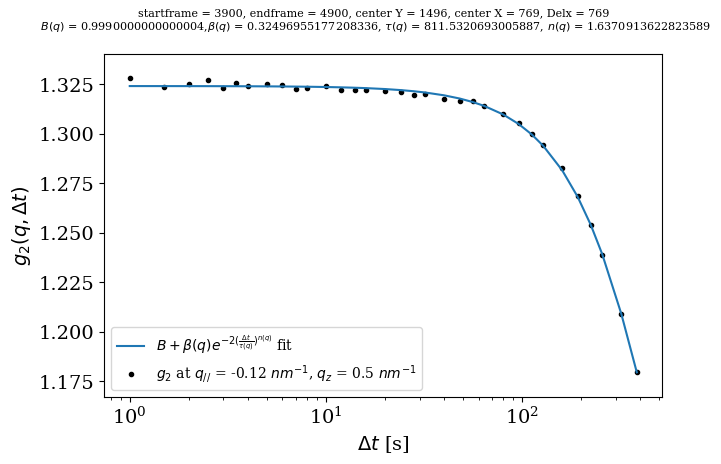

1.319658616449393e-06 1.0


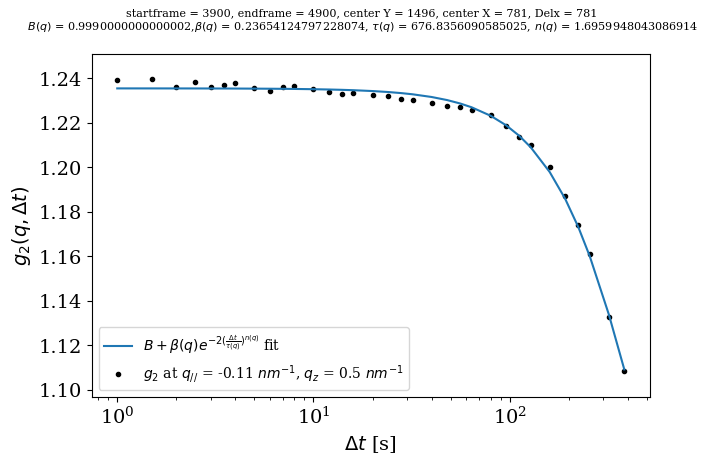

2.987901364930473e-06 1.0


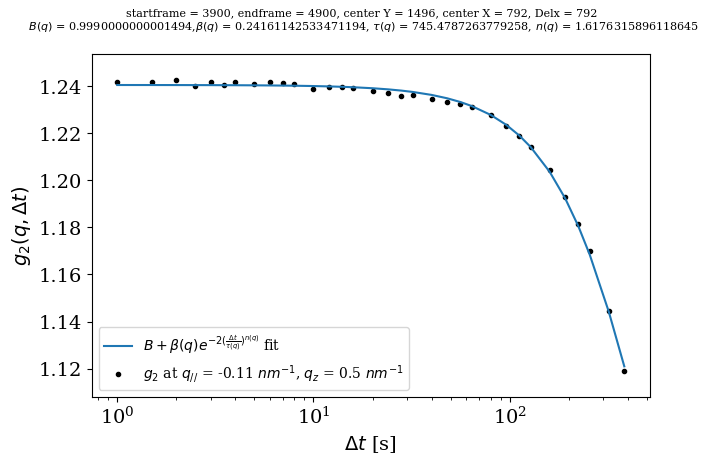

1.2013101222295473e-06 1.0


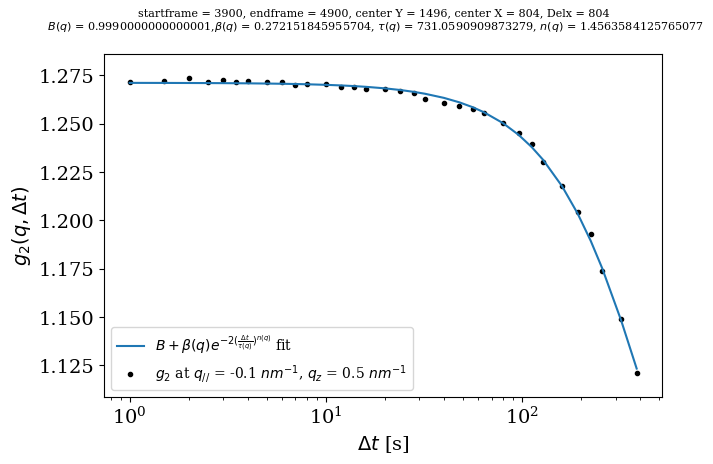

1.7085636706879398e-06 1.0


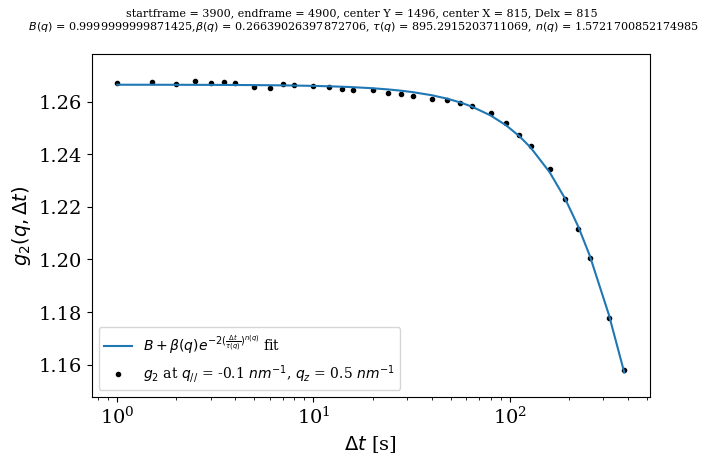

6.872131168564599e-07 1.0


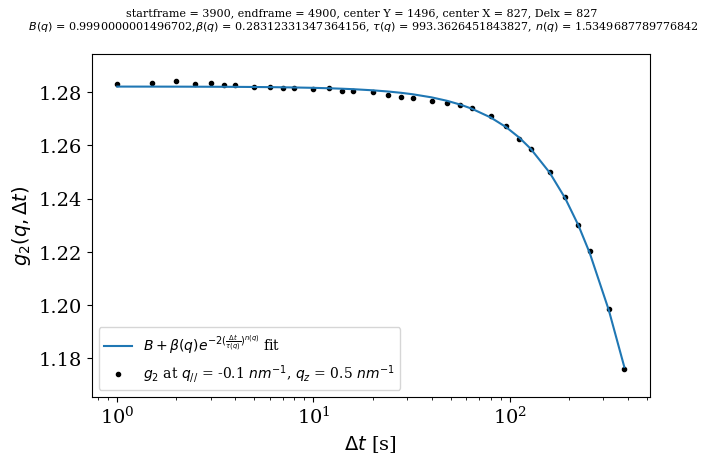

6.616325712456741e-07 1.0


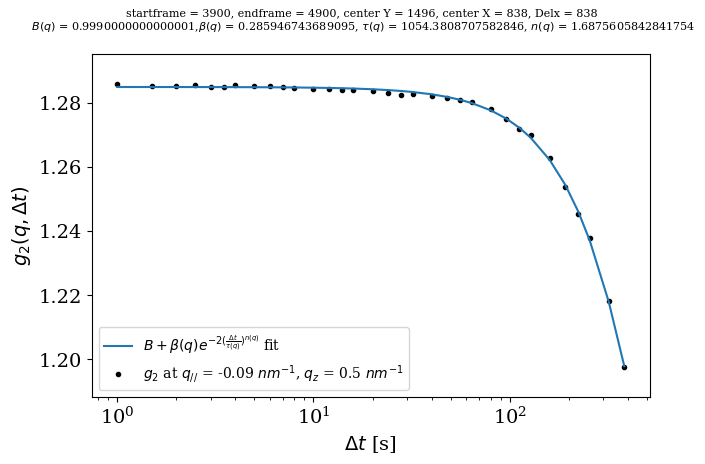

2.551629201010135e-07 1.0


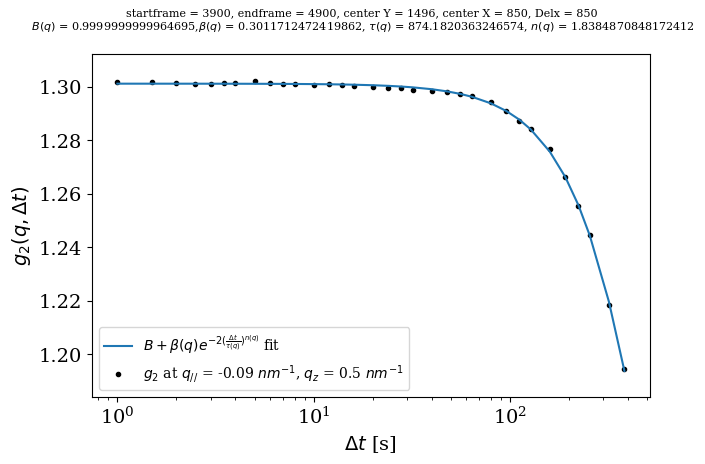

2.4964763265352075e-07 1.0


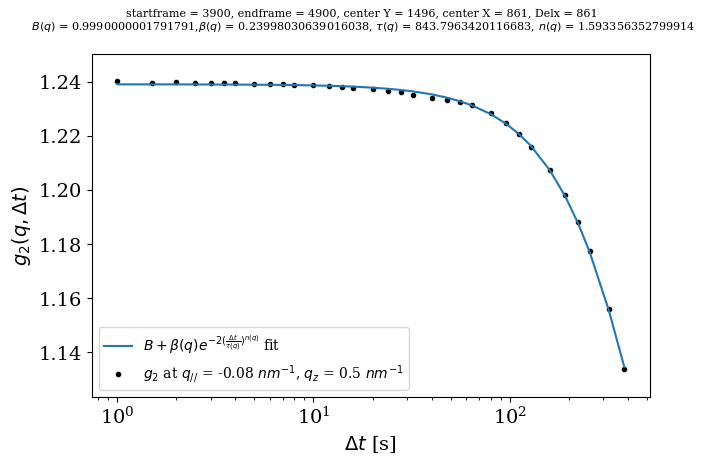

3.2665644276951397e-07 1.0


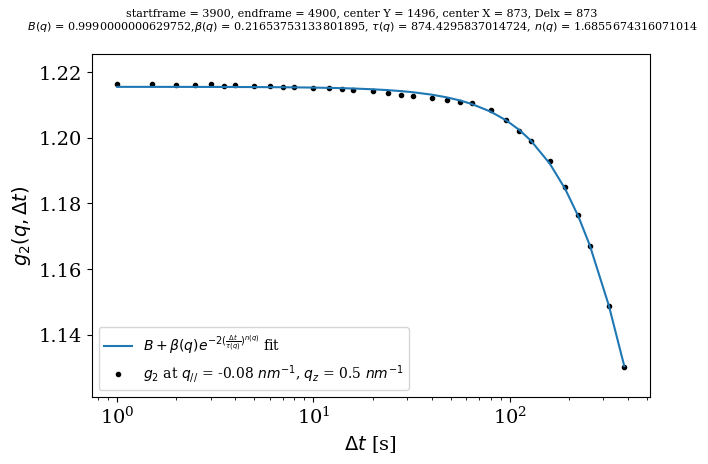

3.188297274020316e-07 1.0


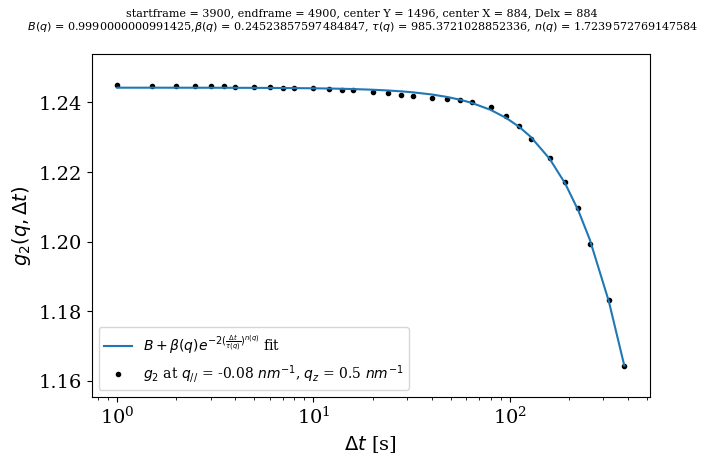

3.1681984859288064e-07 1.0


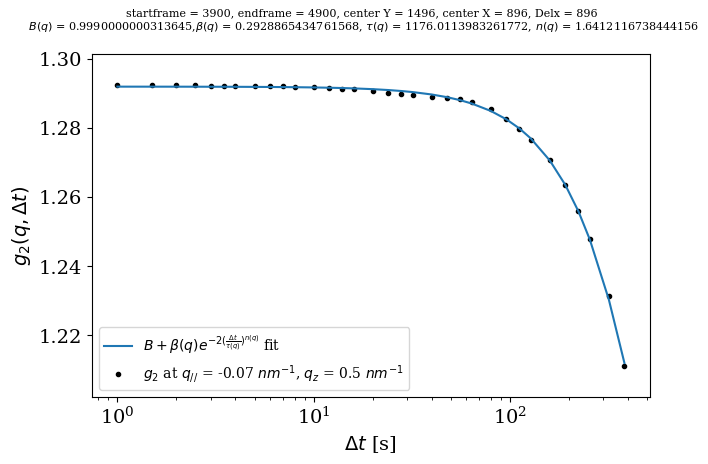

2.0660392924287227e-07 1.0


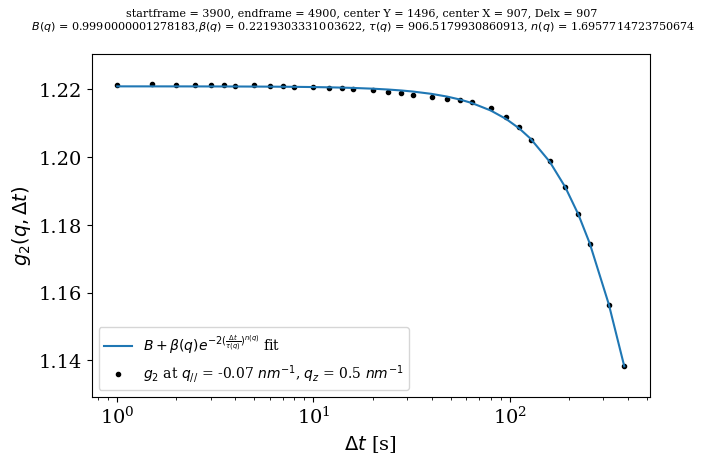

1.9655226723839122e-07 1.0


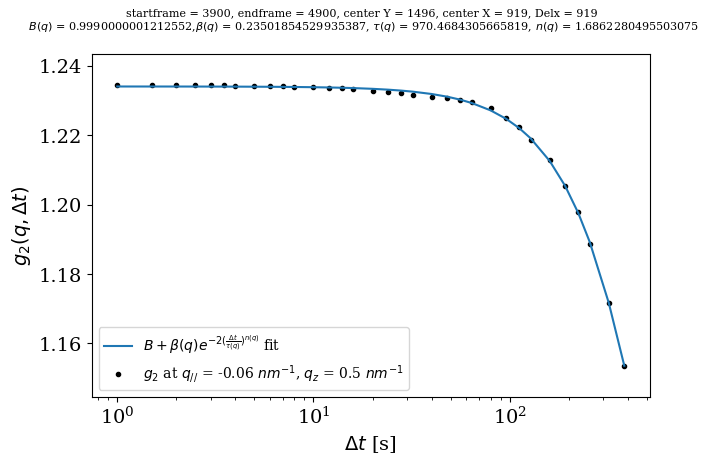

1.8288641907317157e-07 1.0


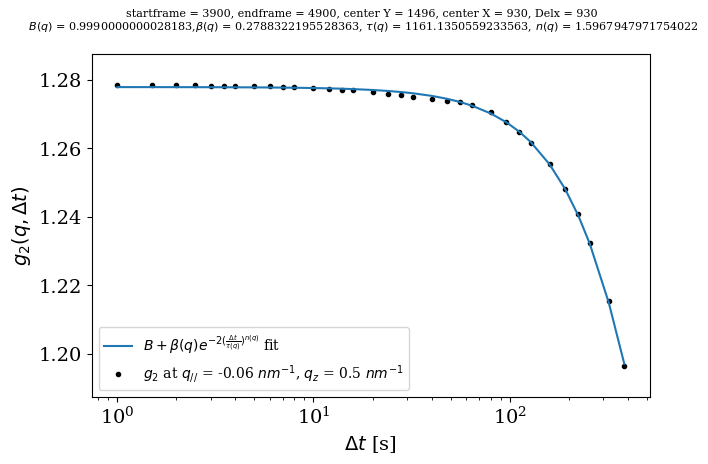

2.324013063609105e-07 1.0


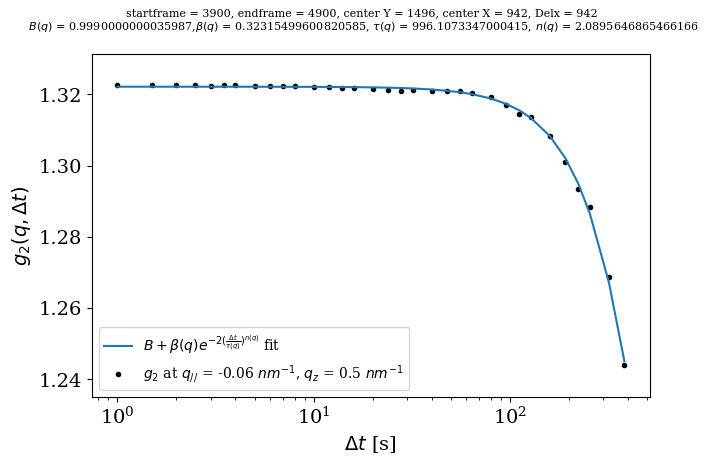

3.808898218871902e-07 1.0


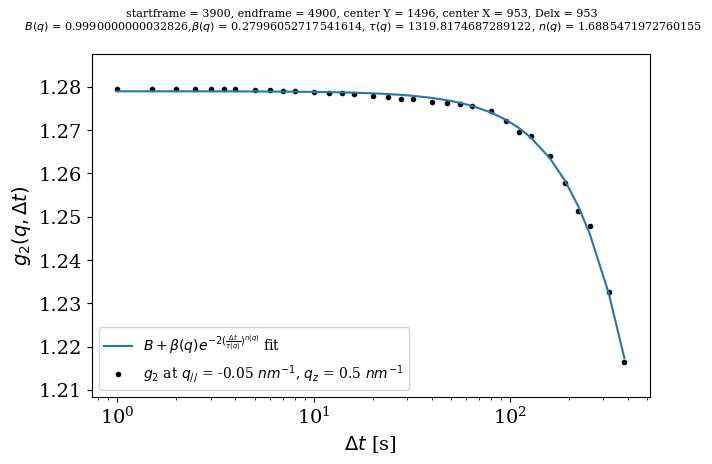

3.5639023494590894e-07 1.0


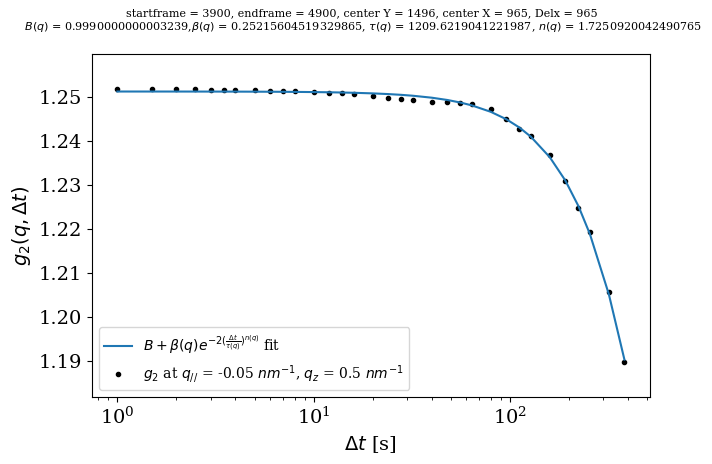

2.206384428004282e-07 1.0


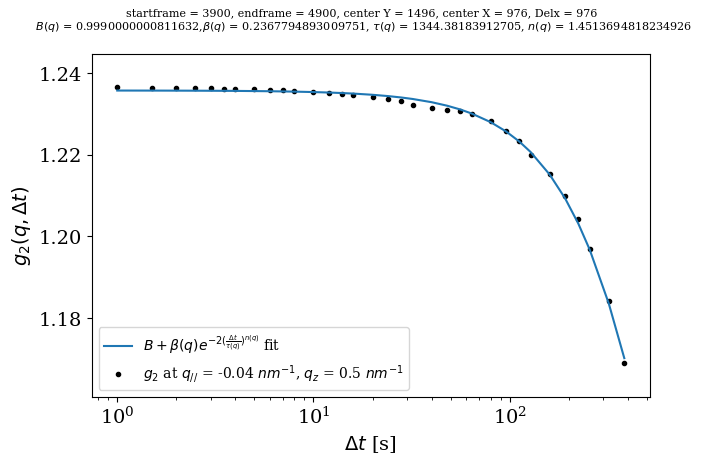

4.2113646696843227e-07 1.0


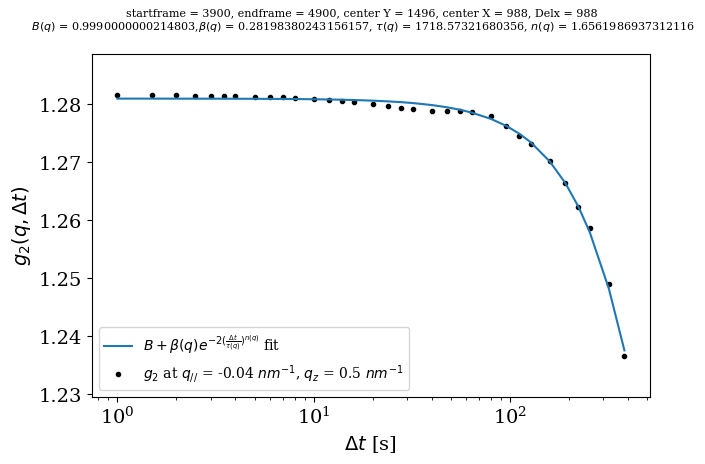

2.5713676470695117e-07 1.0


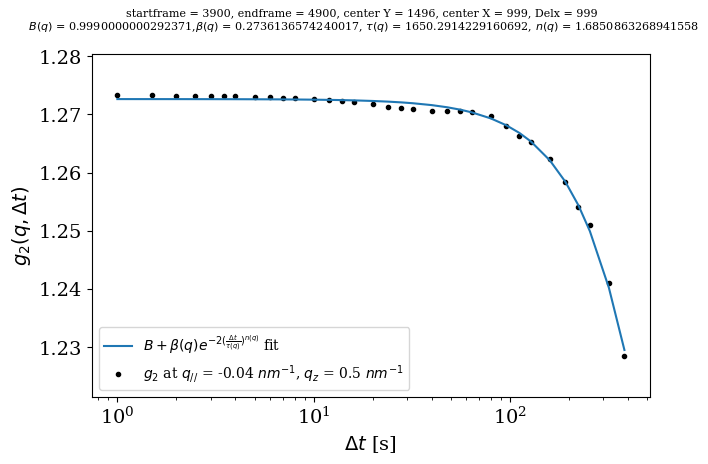

2.8947523869960724e-07 1.0


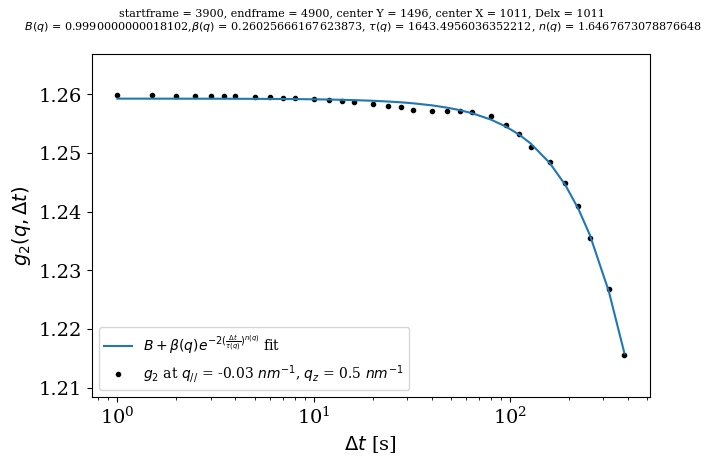

2.2235016574199588e-07 1.0


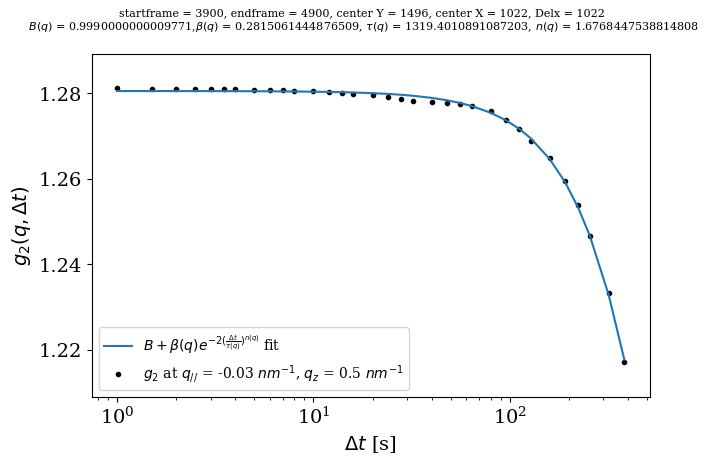

2.43853606614121e-07 1.0


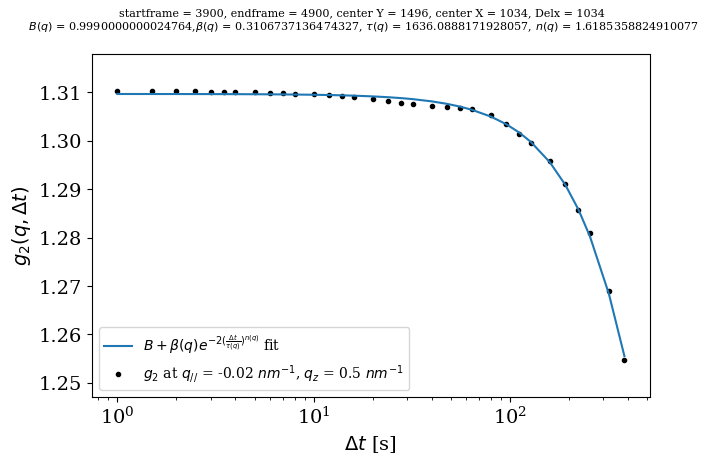

2.279450593367691e-07 1.0


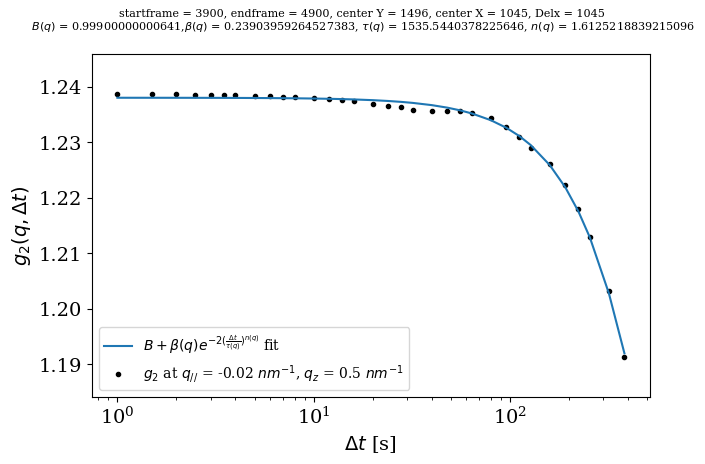

2.756629931313076e-07 1.0


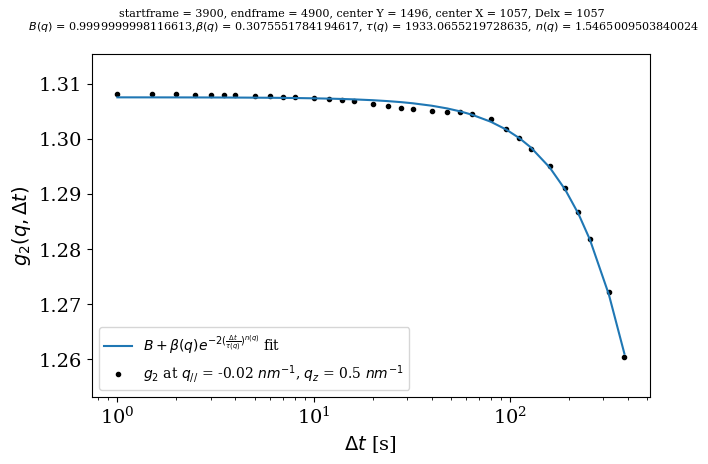

2.249870598833405e-07 1.0


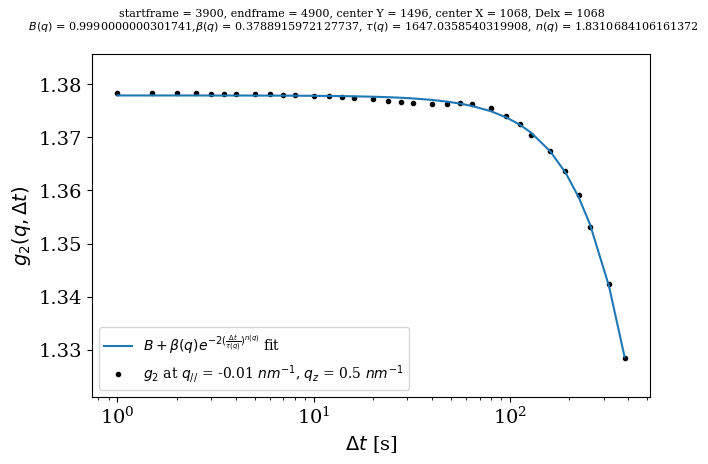

1.4035601449841416e-07 1.0


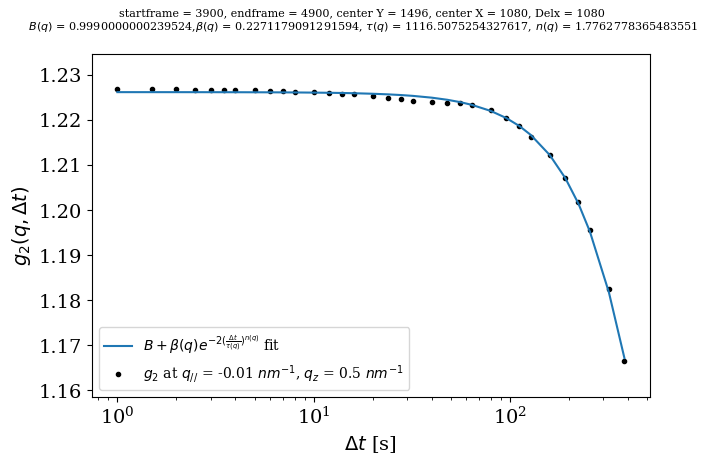

2.3573172702837624e-07 1.0


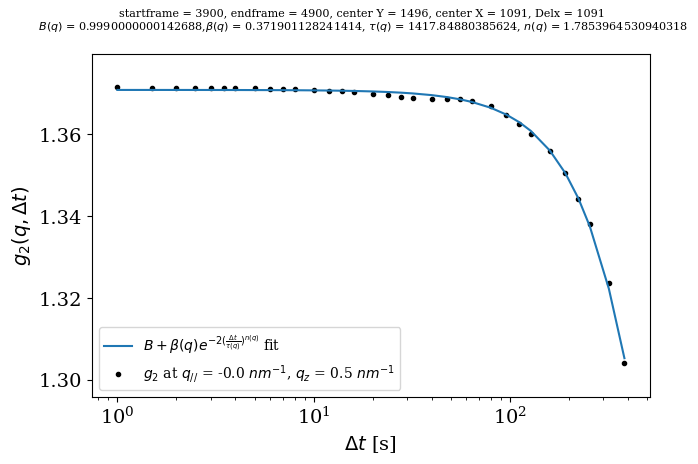

2.972294892573494e-07 1.0


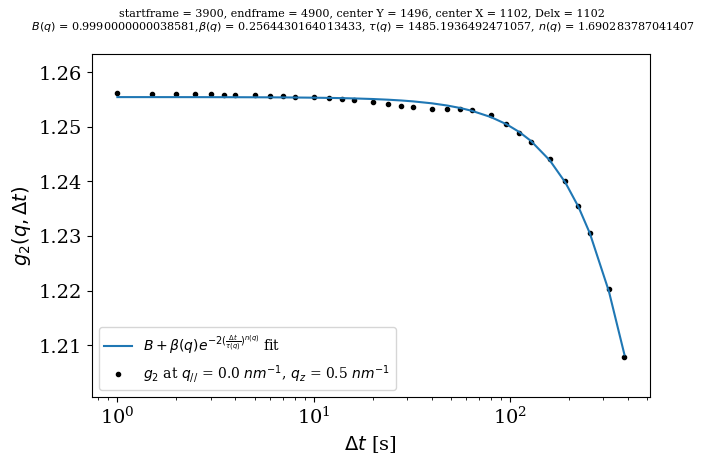

2.267966814724484e-07 1.0


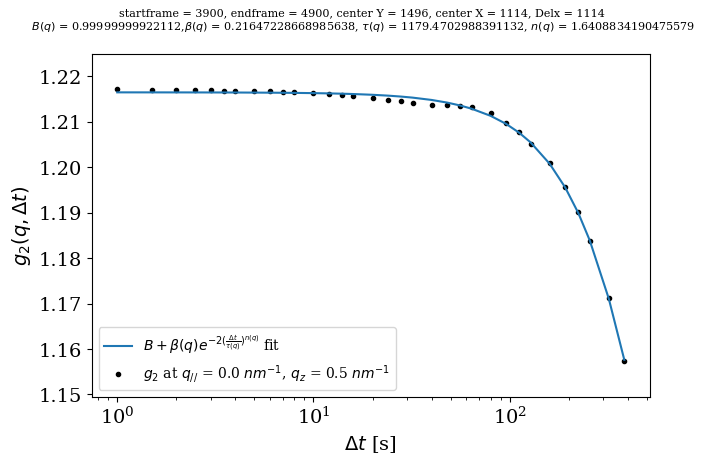

2.416982042291624e-07 1.0


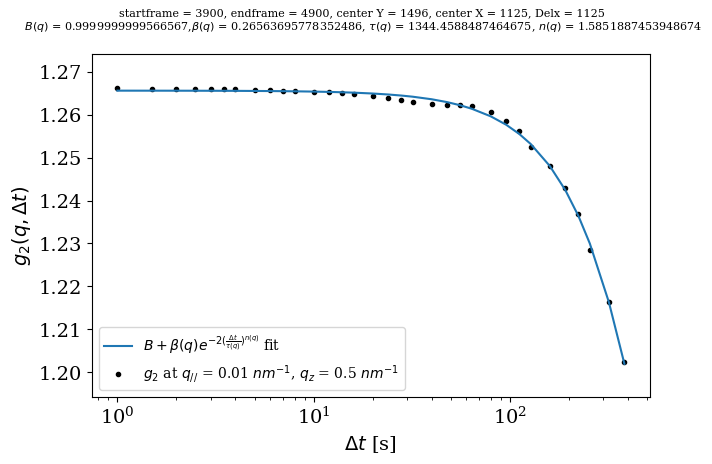

3.597580855715111e-07 1.0


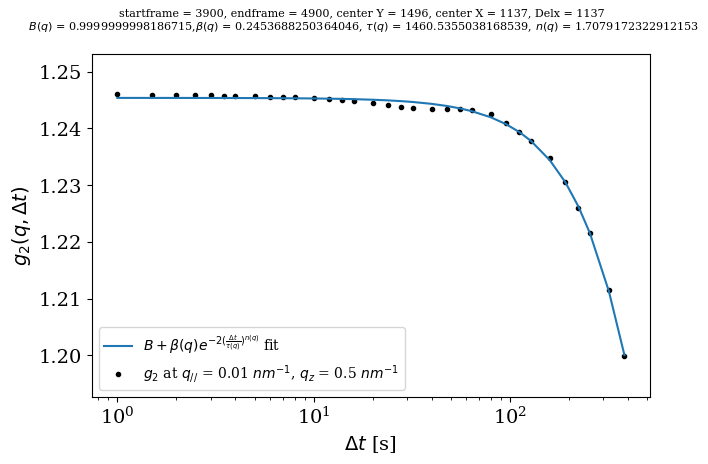

2.1340613828909708e-07 1.0


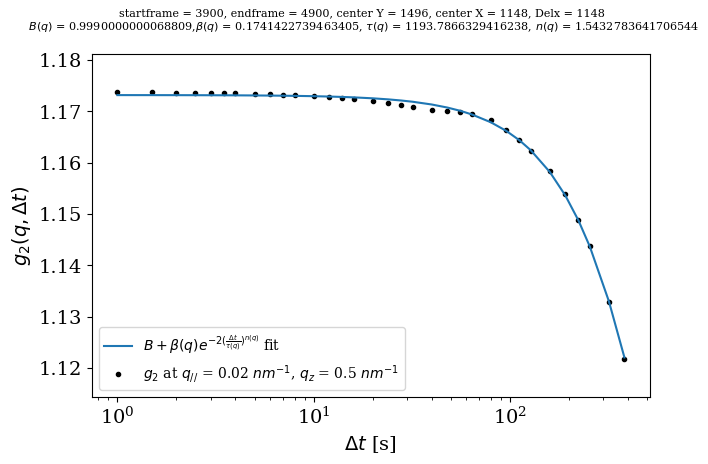

2.017911915029041e-07 1.0


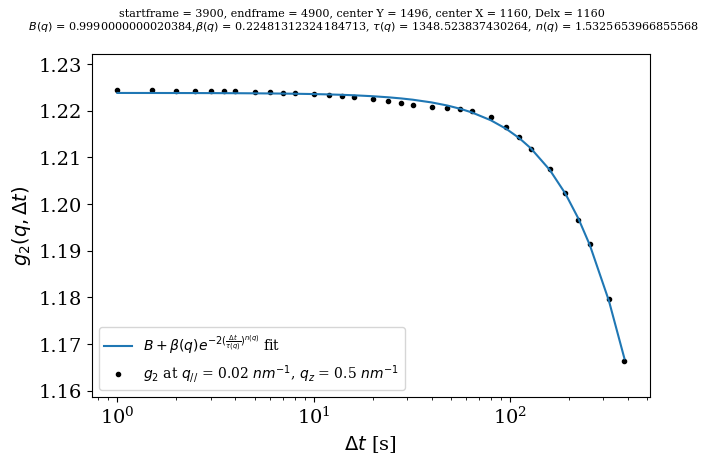

2.3473054837398438e-07 1.0


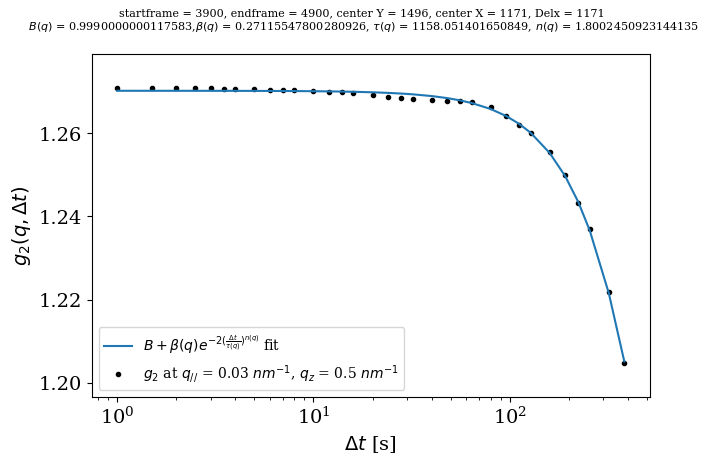

2.4679443907764154e-07 1.0


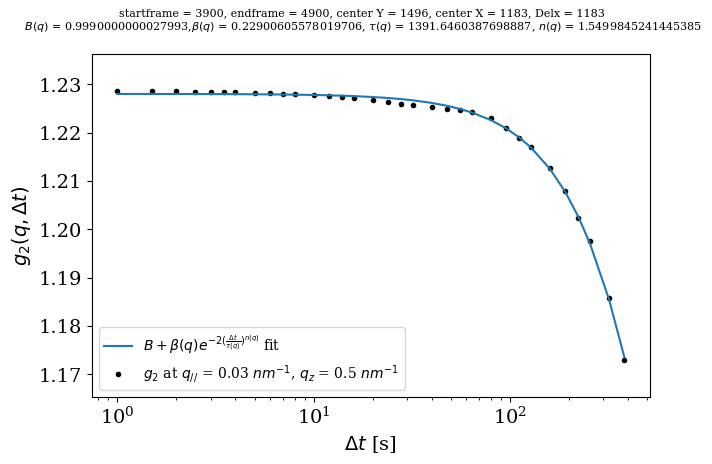

2.1517336946792848e-07 1.0


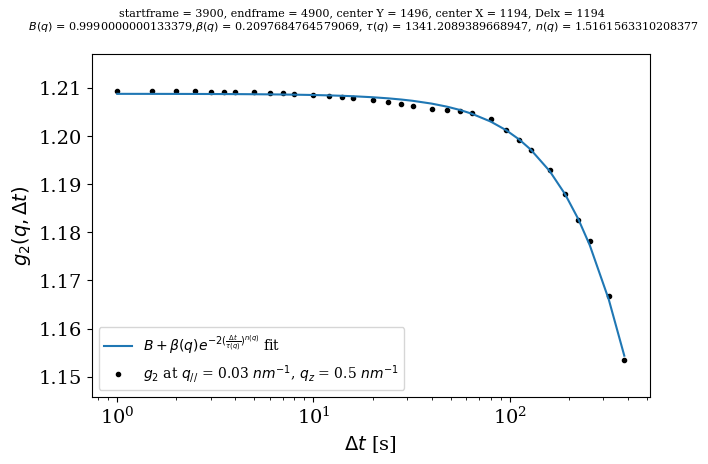

2.737670746888679e-07 1.0


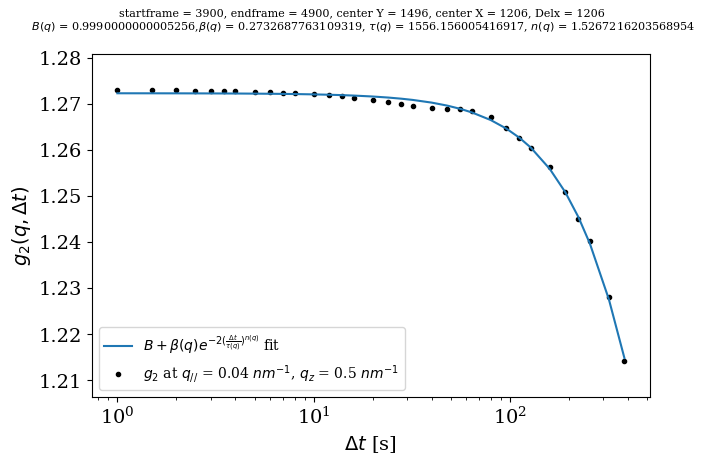

2.9856350213368927e-07 1.0


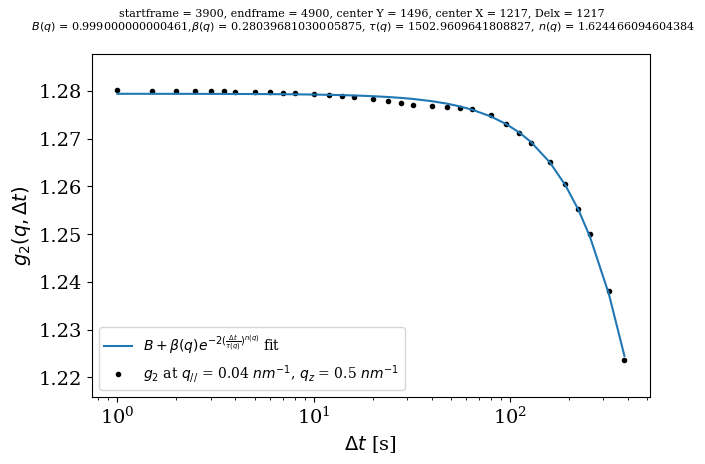

2.8405679011037974e-07 1.0


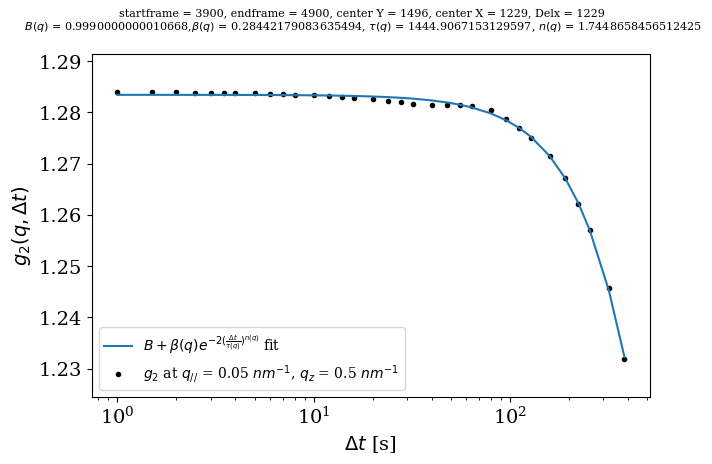

1.7603480264872697e-07 1.0


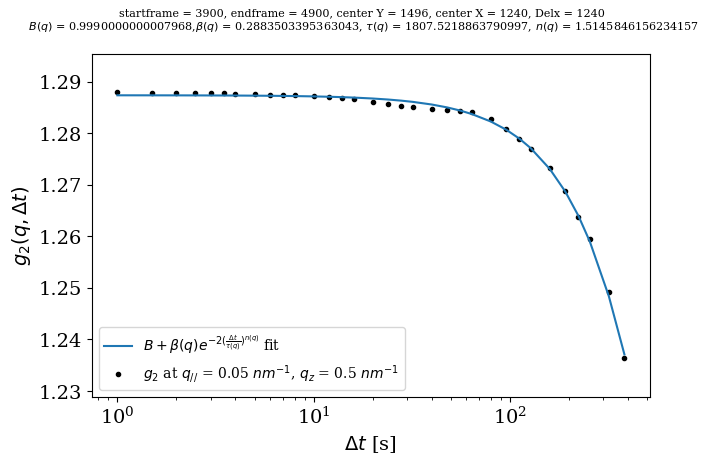

2.2009079947535113e-07 1.0


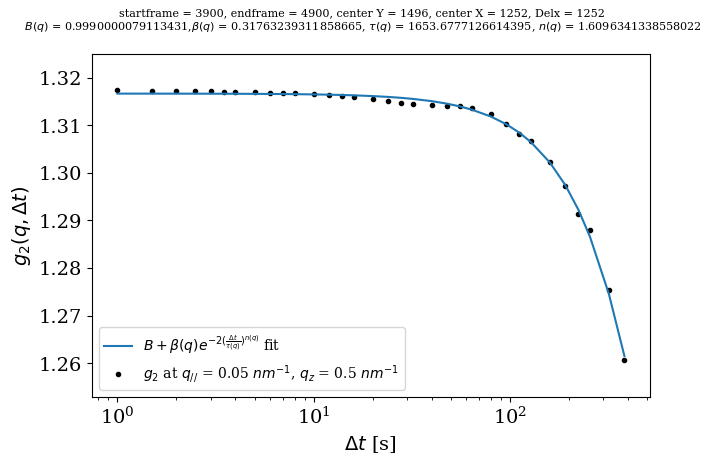

3.0894584926479907e-07 1.0


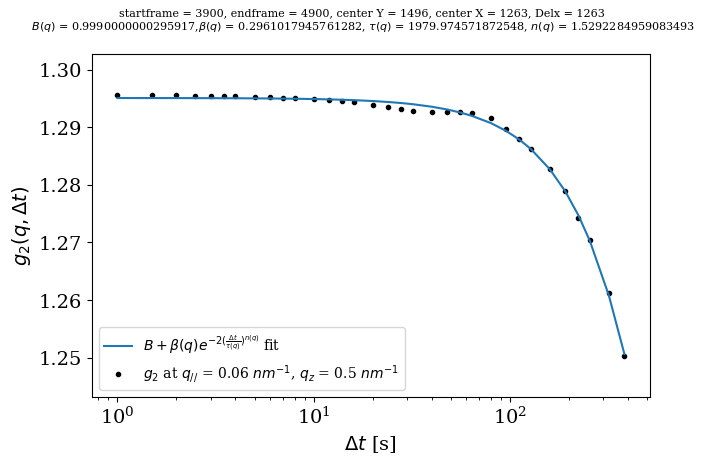

2.1315633046112946e-07 1.0


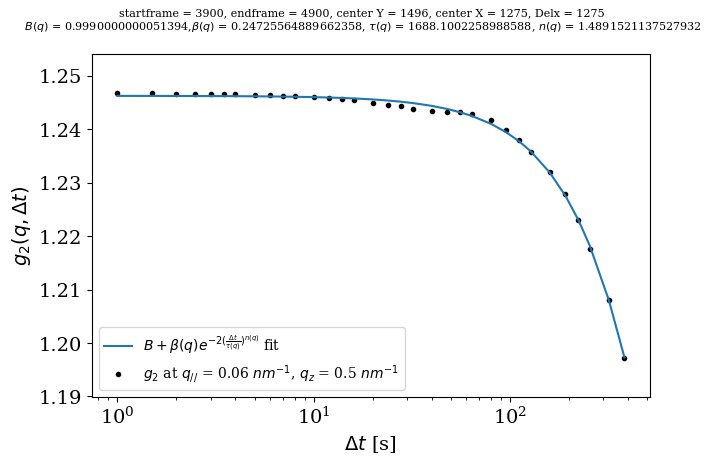

2.0154846652761536e-07 1.0


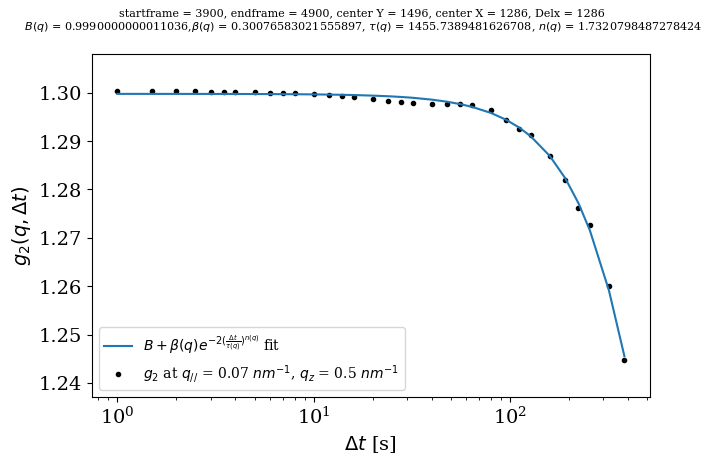

3.0486304977339554e-07 1.0


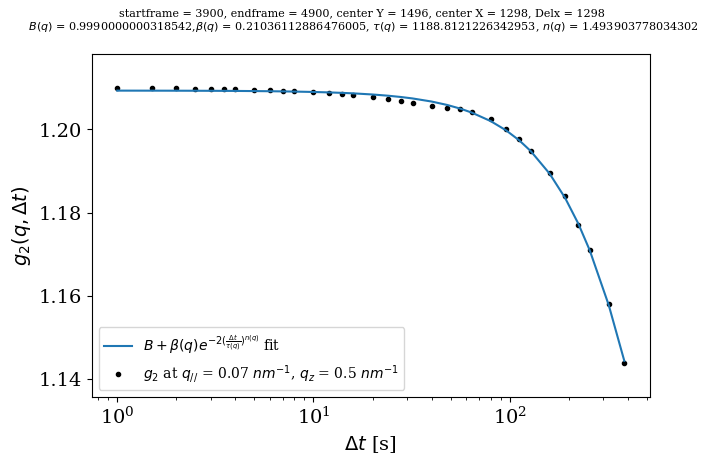

2.514773848107458e-07 1.0


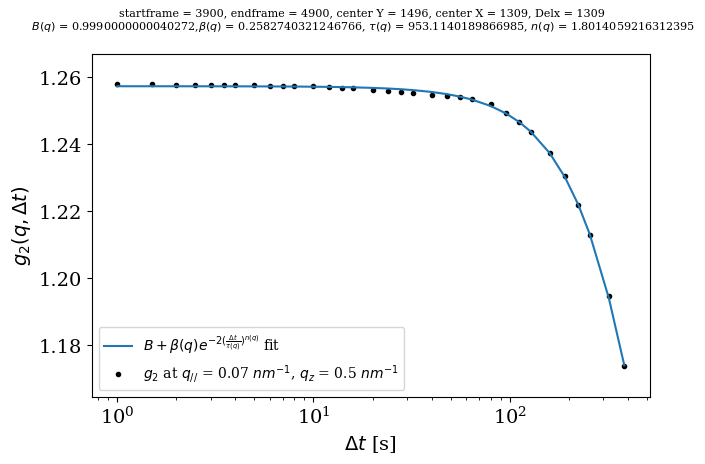

1.828287106098125e-07 1.0


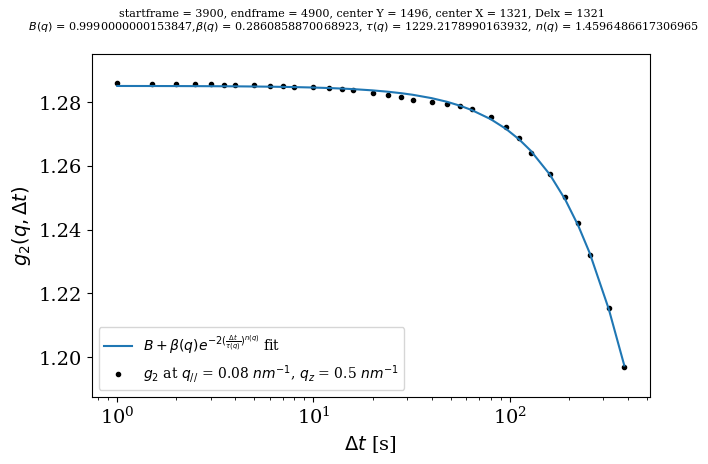

4.0168635520219926e-07 1.0


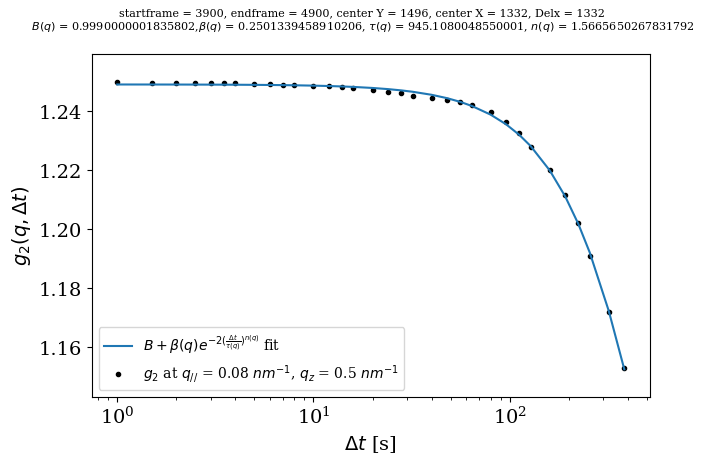

3.613565536556581e-07 1.0


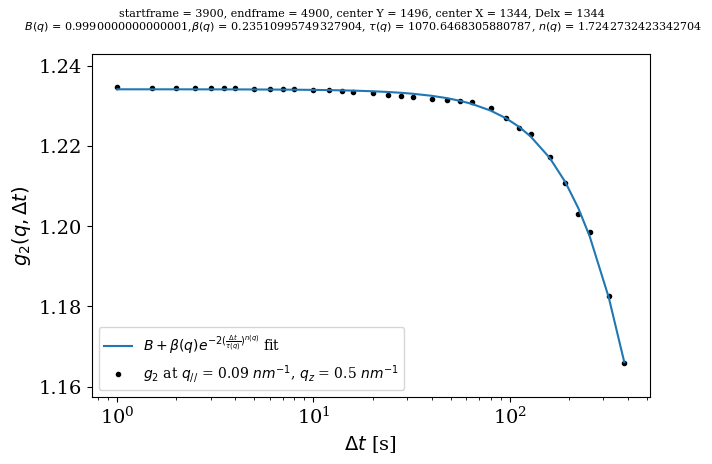

2.3814792951428294e-07 1.0


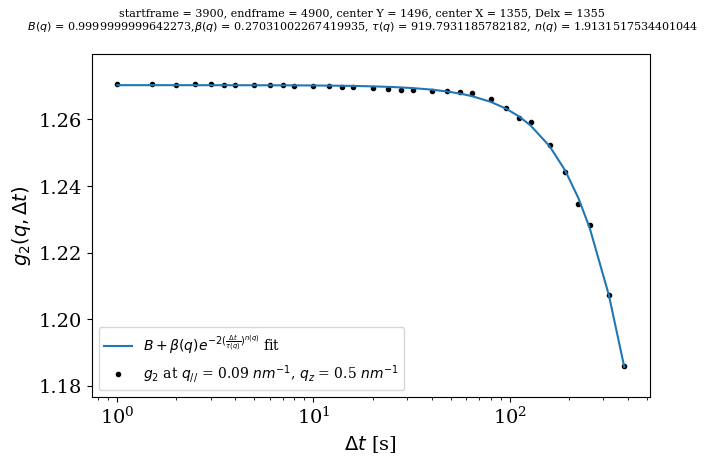

2.842575062994412e-07 1.0


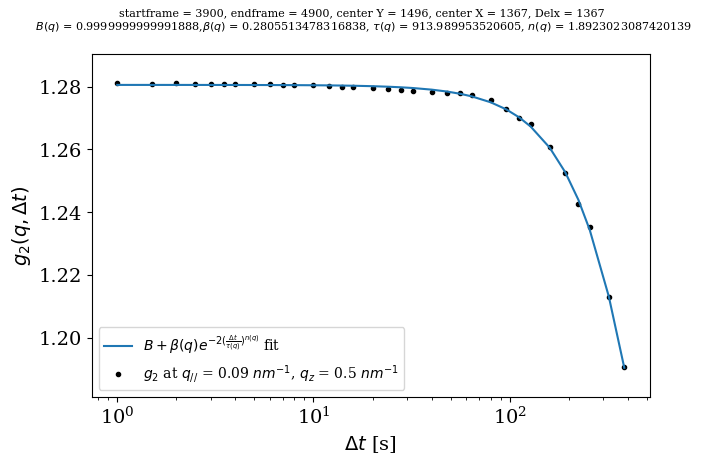

2.352463758895473e-07 1.0


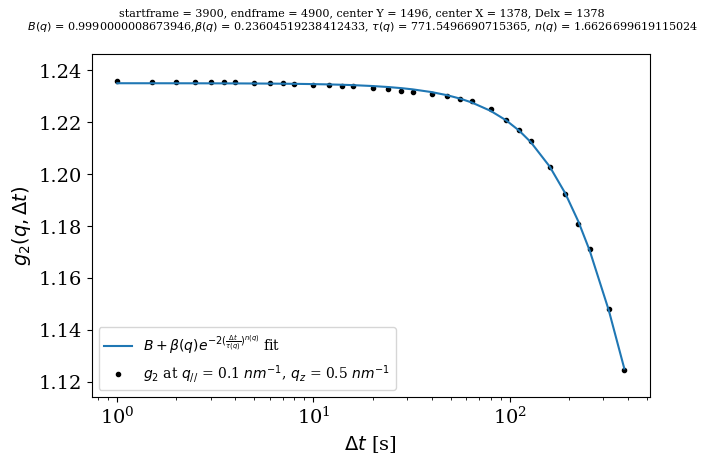

2.937420091454617e-07 1.0


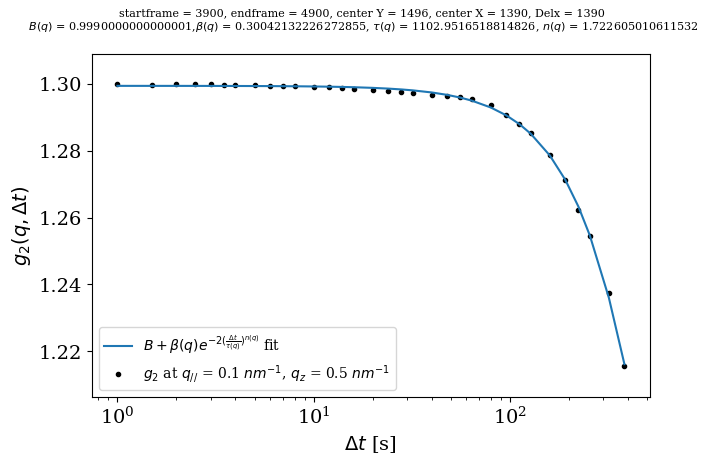

2.2253252145830577e-07 1.0


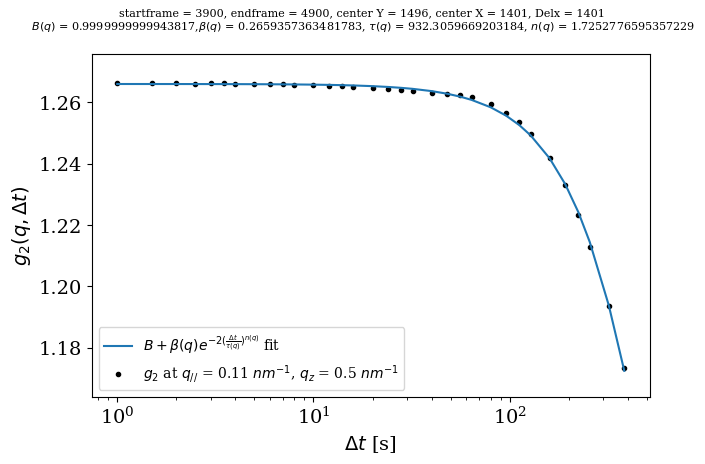

3.3951364483489193e-07 1.0


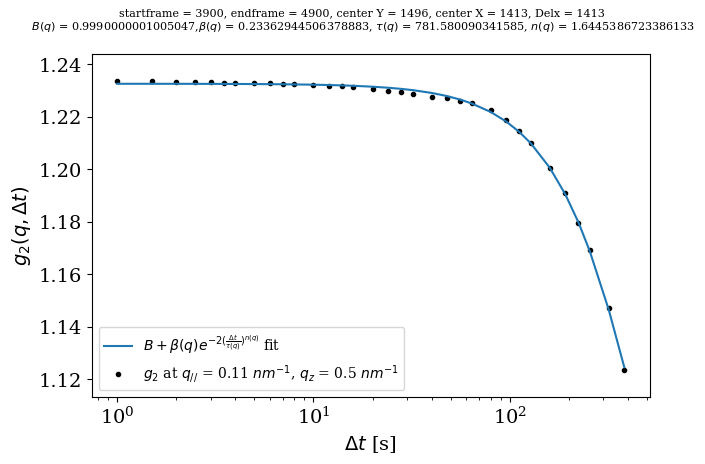

4.627813892860335e-07 1.0


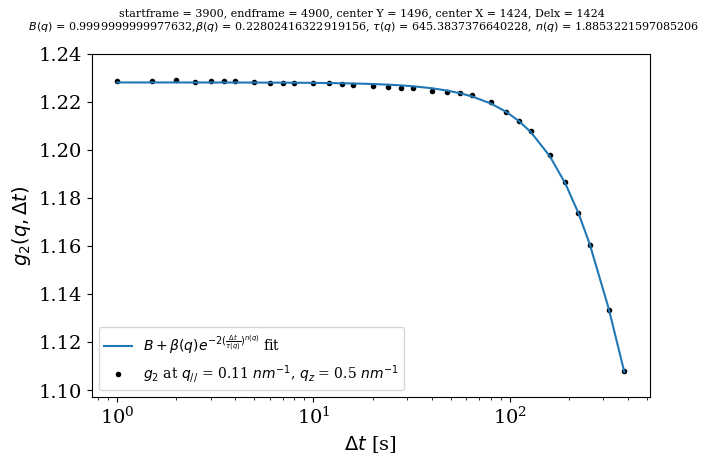

3.1492396595706443e-07 1.0


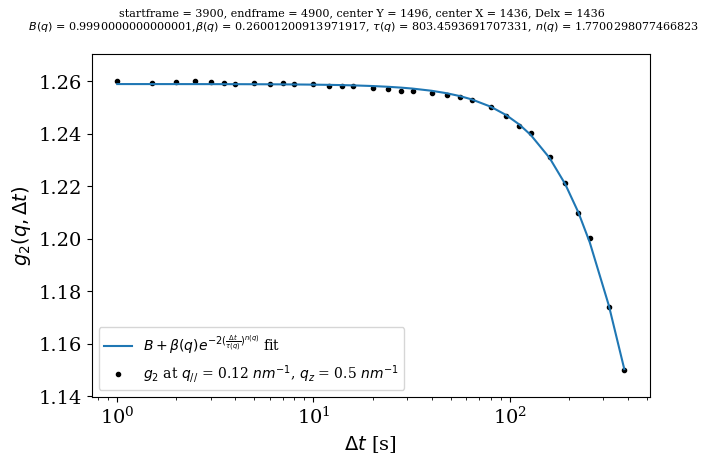

4.0406497708225525e-07 1.0


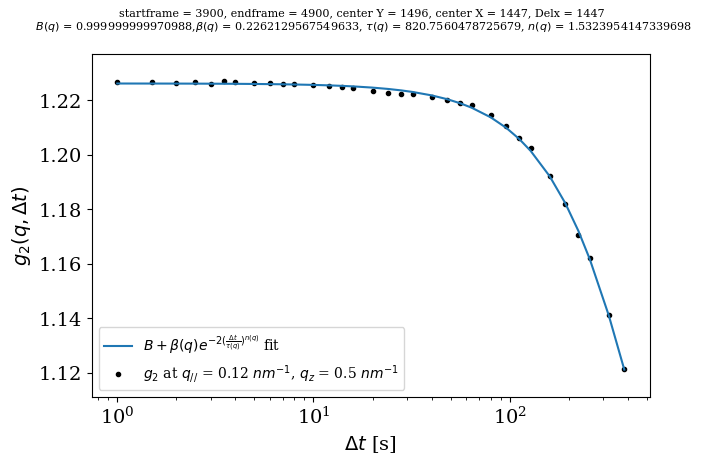

4.661410532754985e-07 1.0


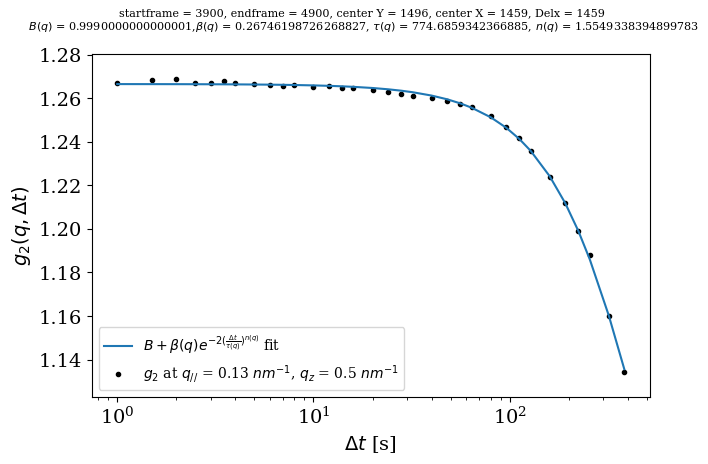

8.279516424121135e-07 1.0


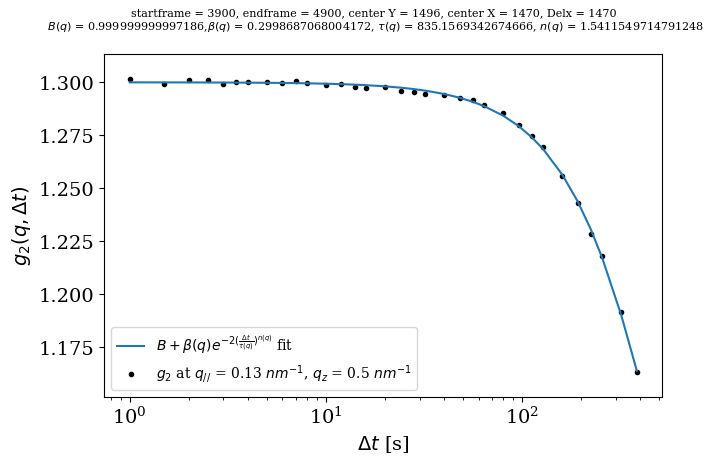

7.594700554333369e-07 1.0


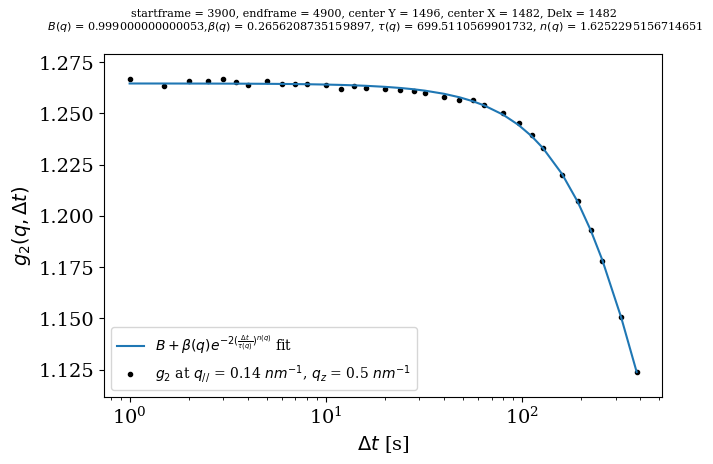

9.558723237694474e-07 1.0


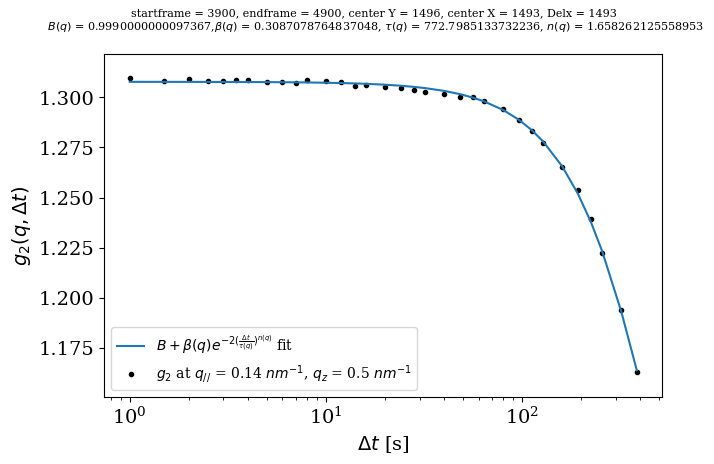

8.848105130000047e-07 1.0


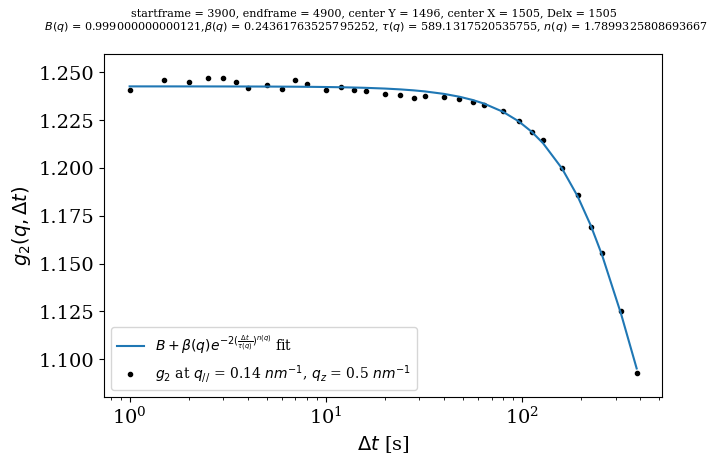

4.0724742215633285e-06 1.0


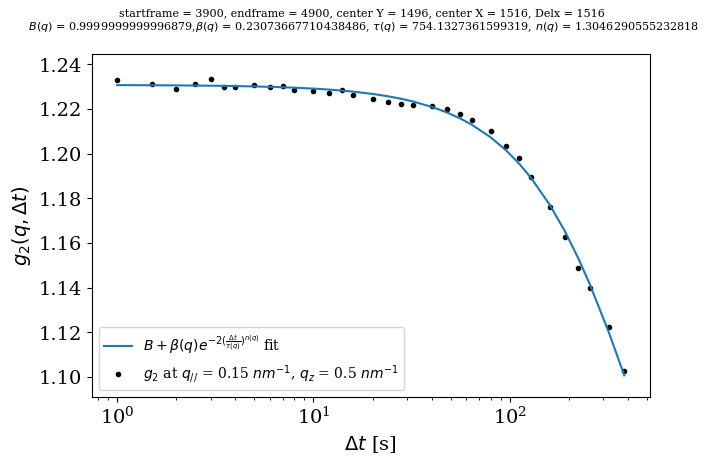

3.174964839707362e-06 1.0


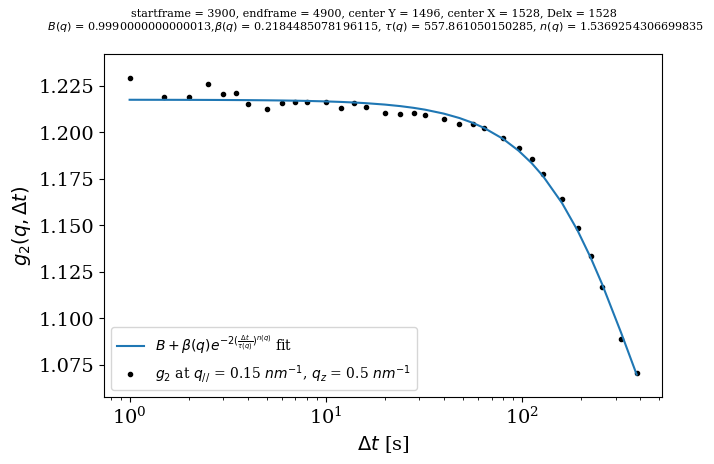

1.1322643488440895e-05 1.0


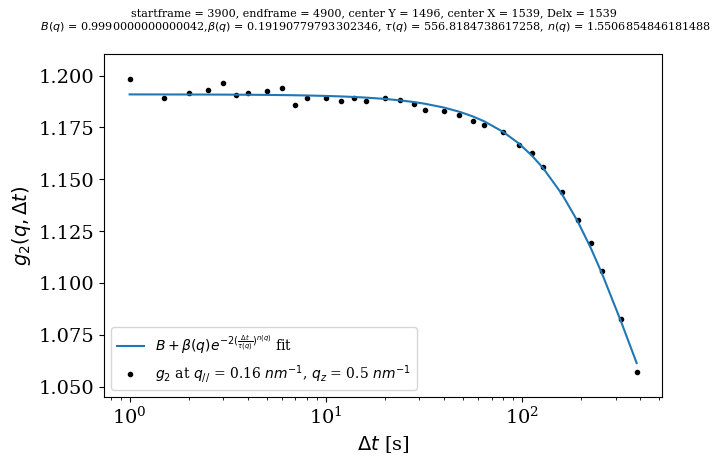

5.845707507223249e-06 1.0


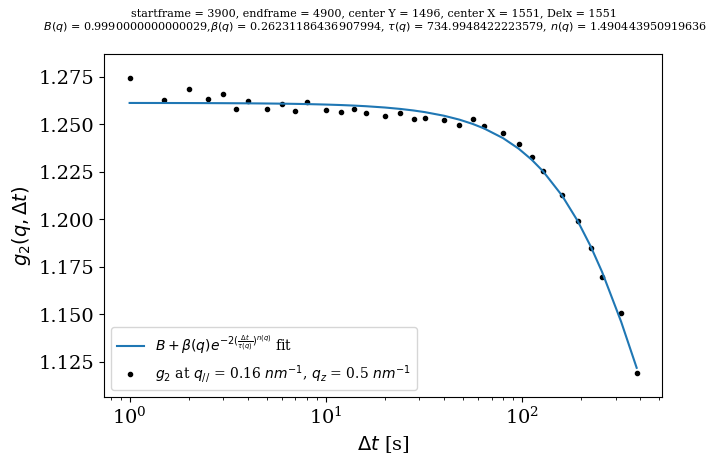

1.2782078770560345e-05 1.0


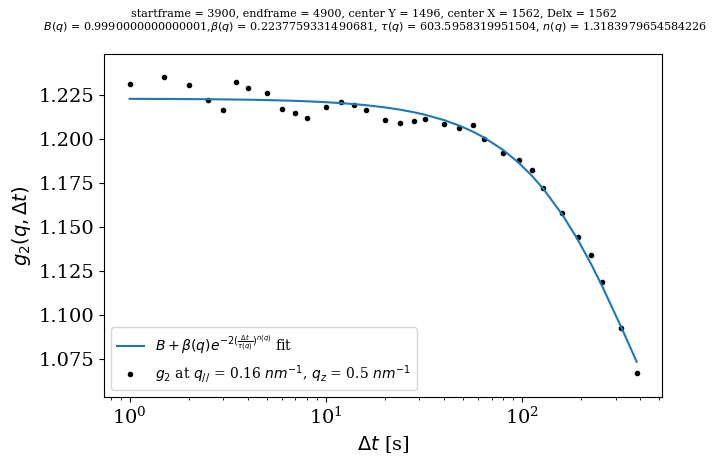

2.5738642521519327e-05 1.0


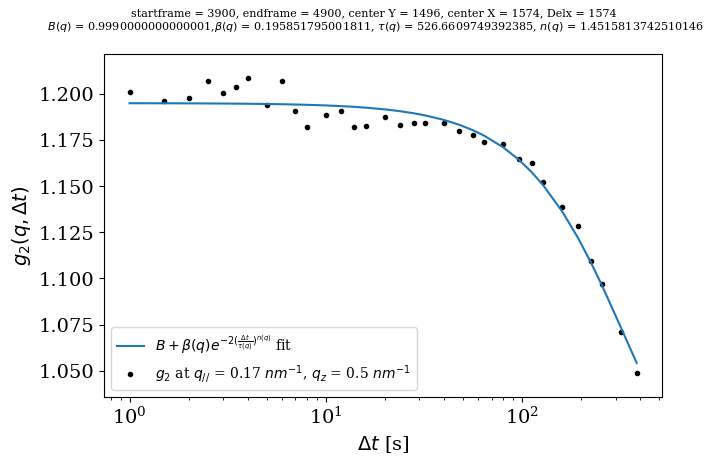

3.8254532434753205e-05 1.0


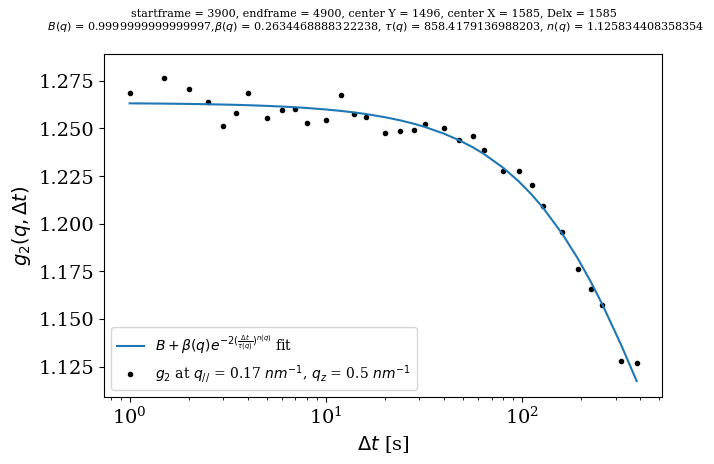

3.065135381223164e-05 1.0


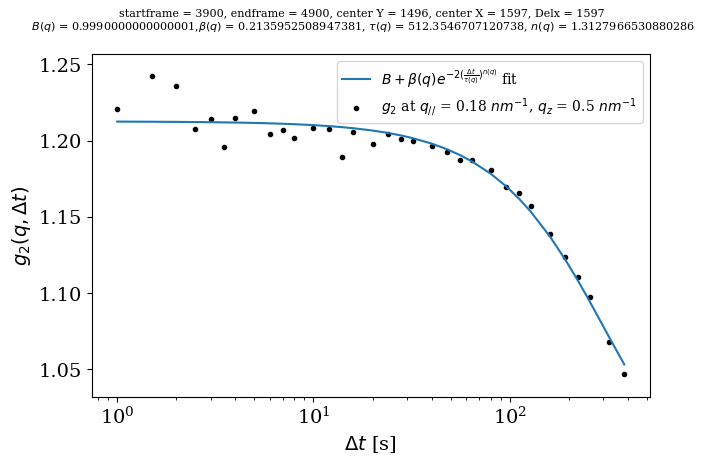

7.490102777716824e-05 1.0


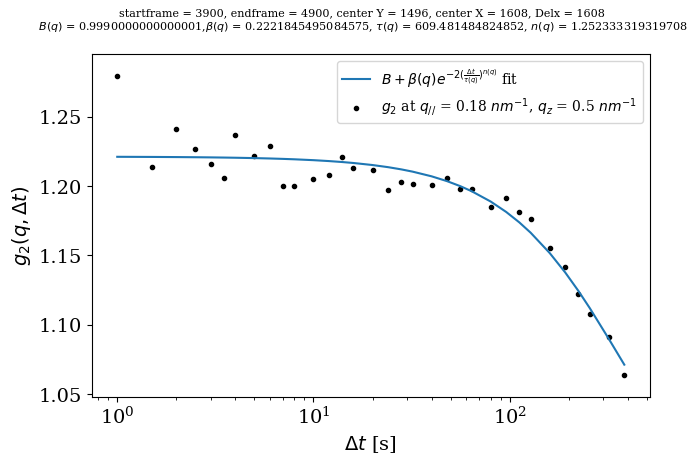

0.00018230293044123612 1.0


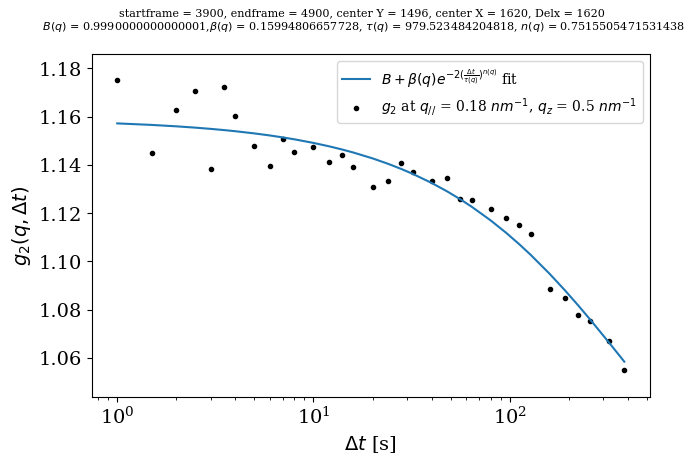

6.541221571174403e-05 1.0


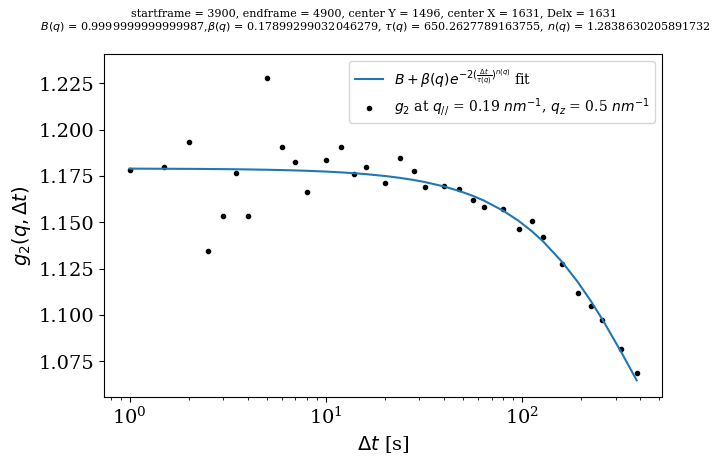

0.0001983438095409344 1.0


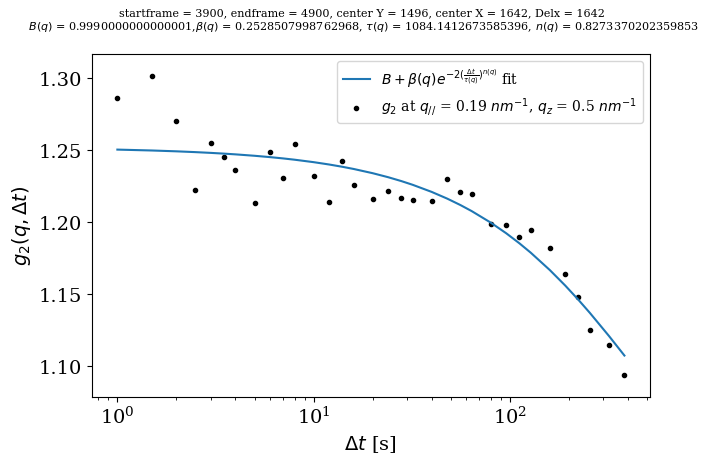

0.0002706221056130372 1.0


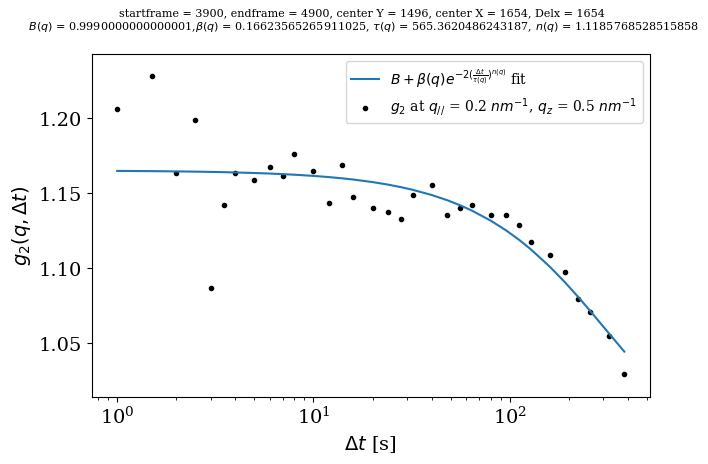

0.00047773943683528634 1.0


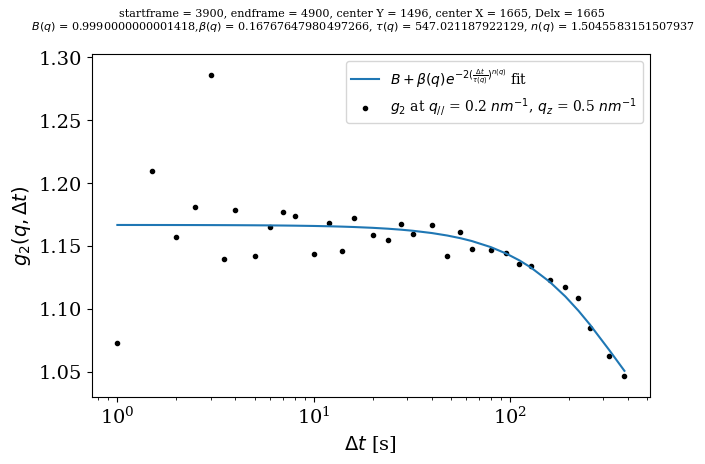

0.000839607699318055 1.0


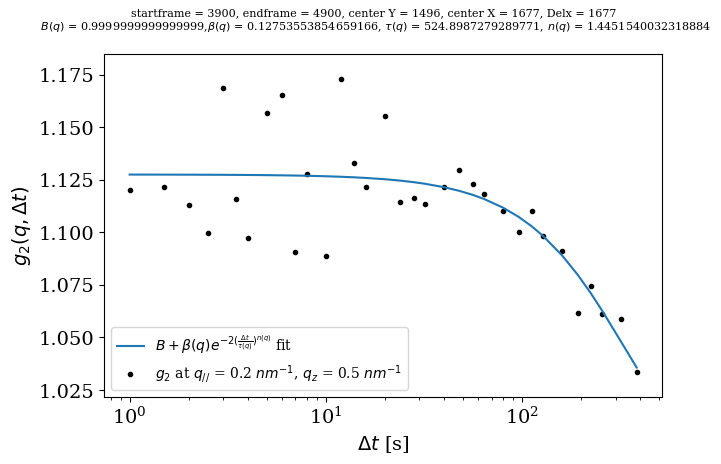

0.00039807468635180964 1.0


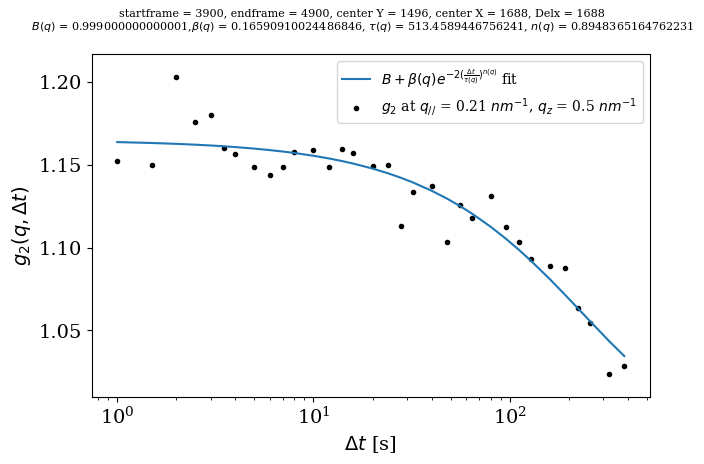

0.00017839264731932058 1.0


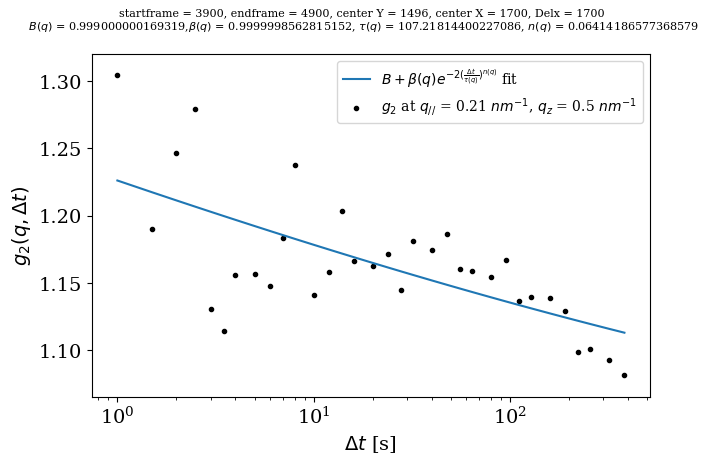

0.001252161789988823 1.0


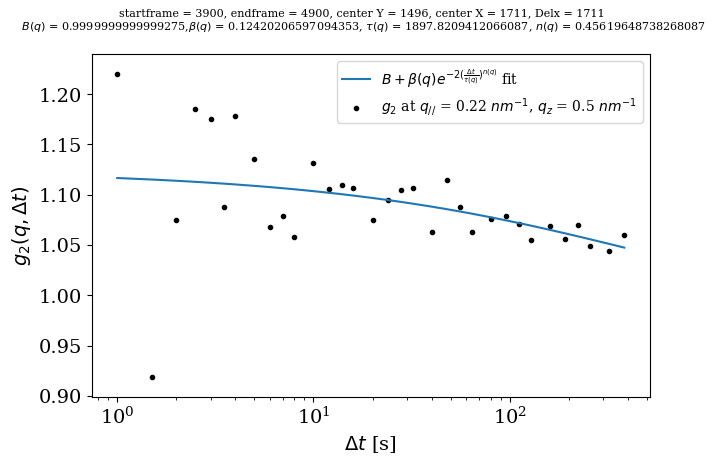

0.0023115101336774998 1.0


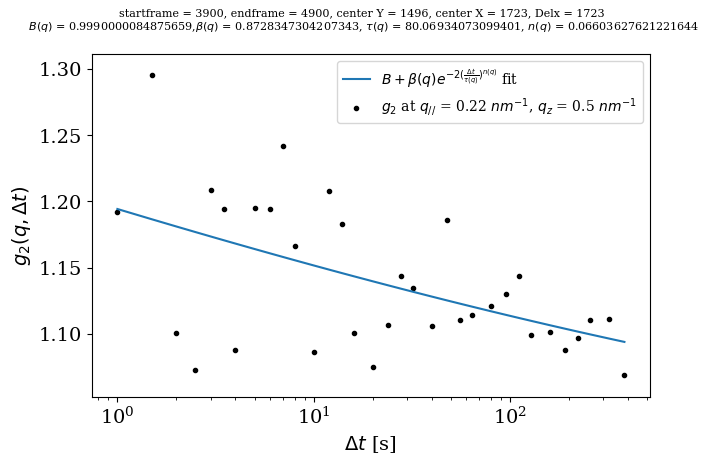

0.0020711679091573363 1.0


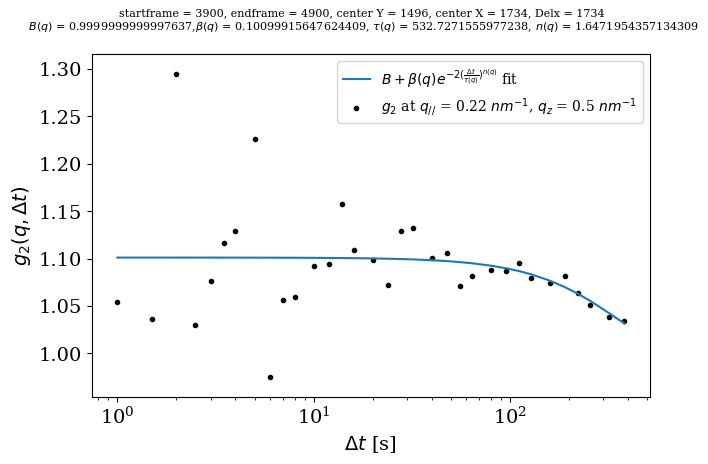

0.0029158169325783296 1.0


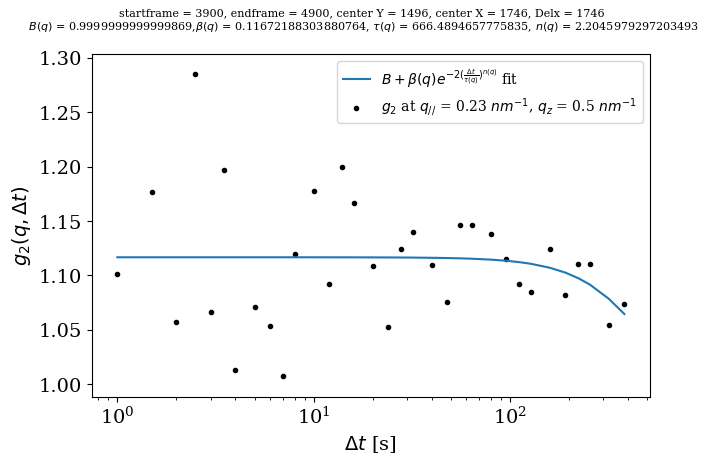

0.0030732750823275847 1.0


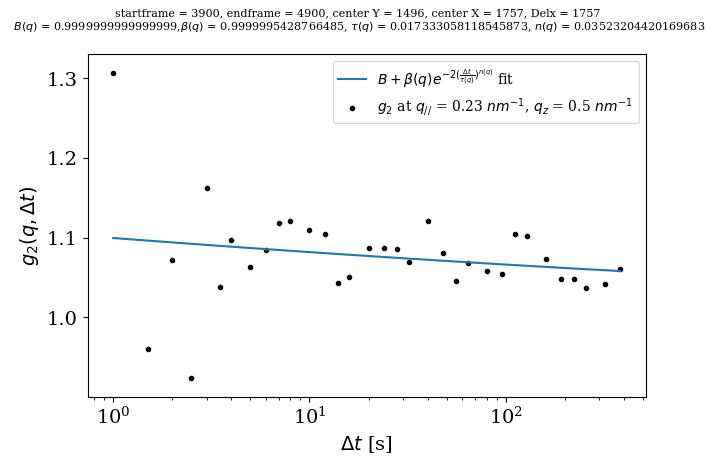

0.003526427806709872 1.0


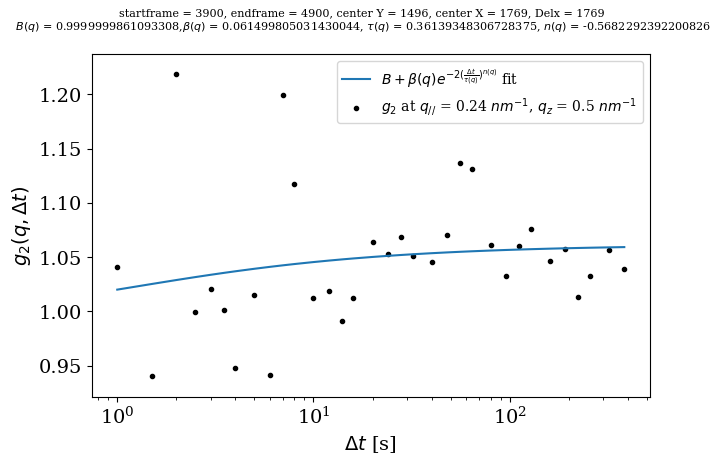

0.003930328893209229 1.0


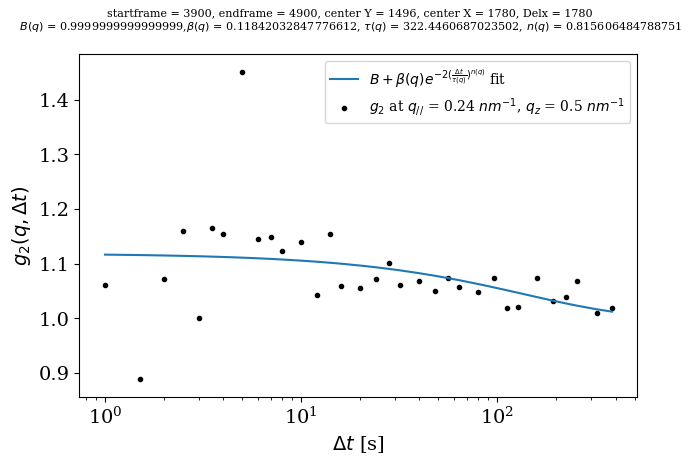

0.006643679260455986 1.0


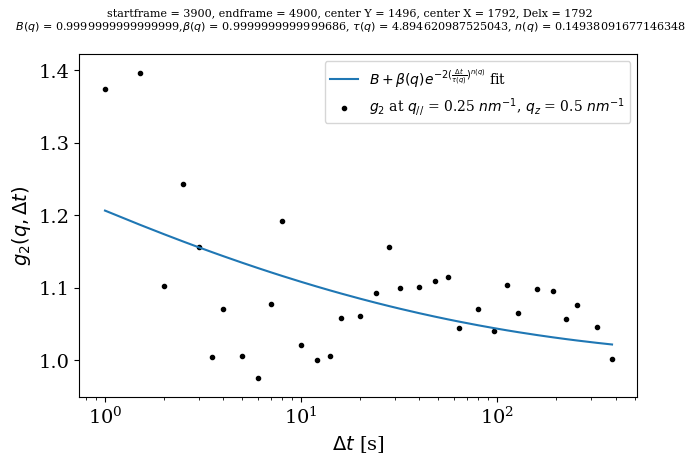

0.0065747511514584345 1.0


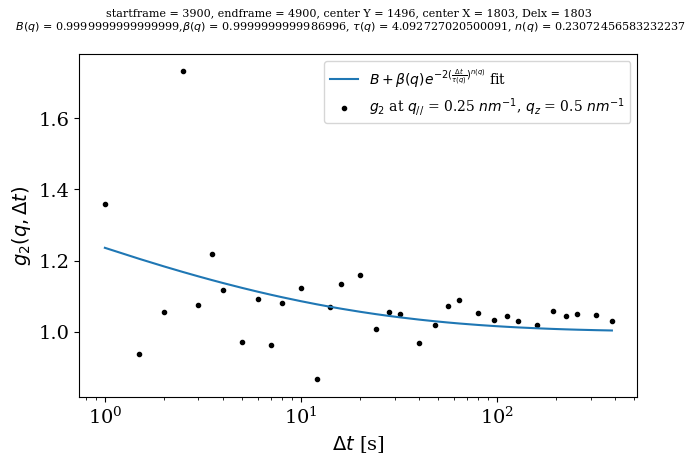

0.016867869387899425 1.0


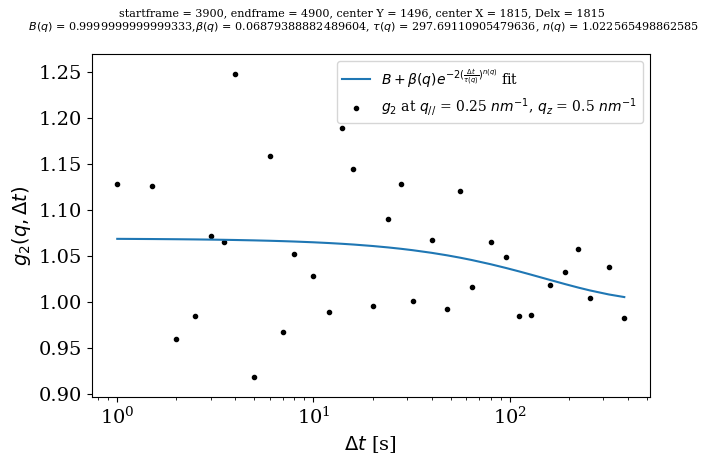

0.00518470206156134 1.0


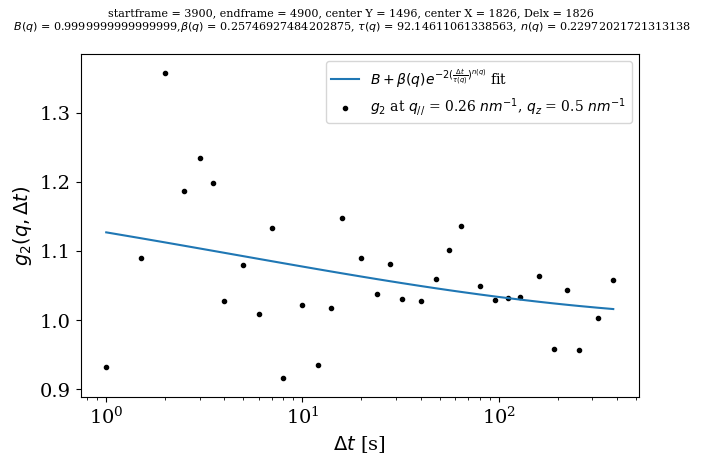

0.007333002210534917 1.0


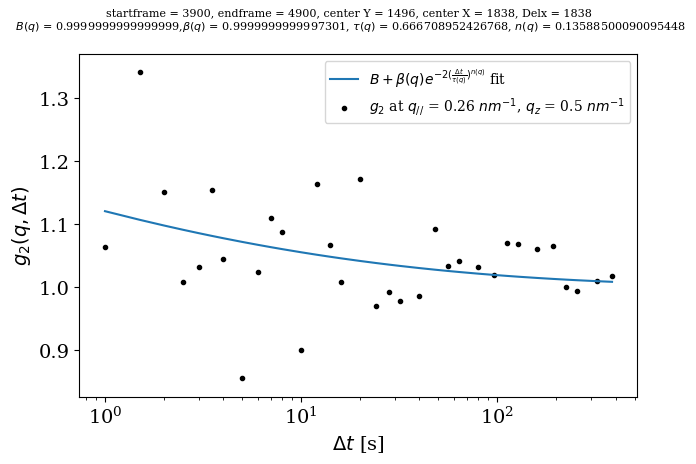

0.0067844501513734225 1.0


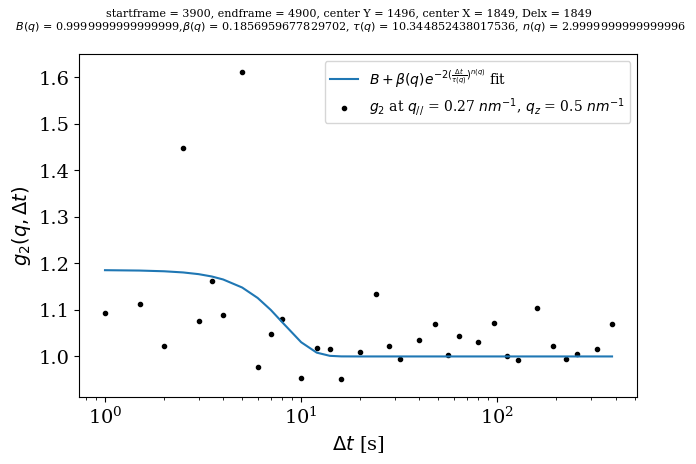

0.012939210870663425 1.0


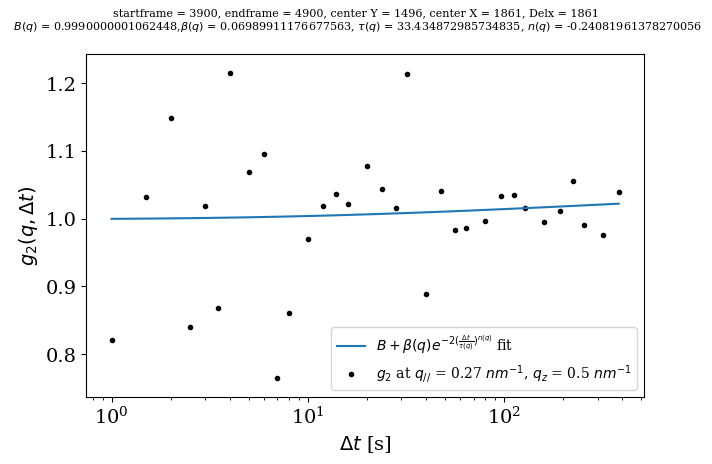

0.010612182088827478 1.0


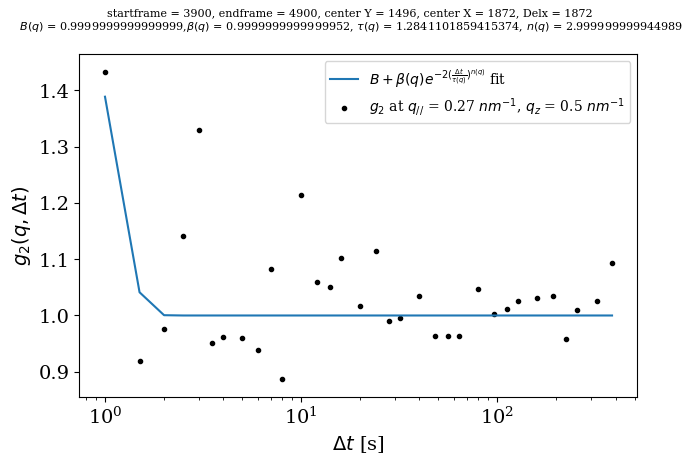

0.009348999887692963 1.0


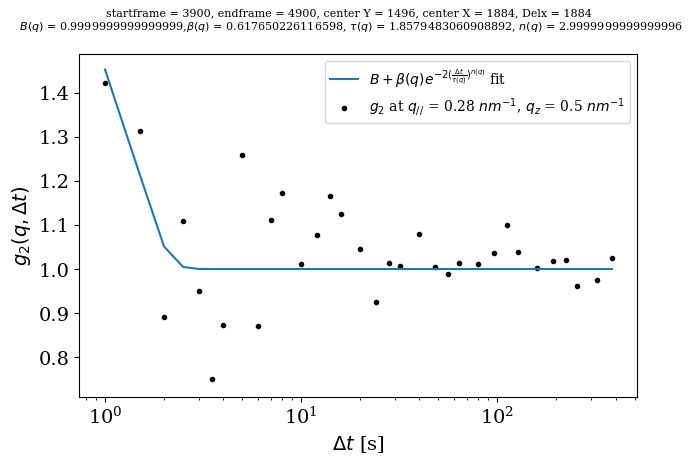

0.011344413859410204 1.0


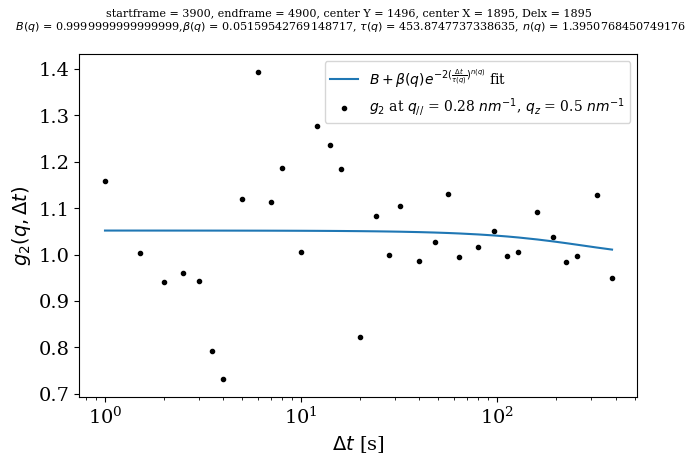

0.018496078468110383 1.0


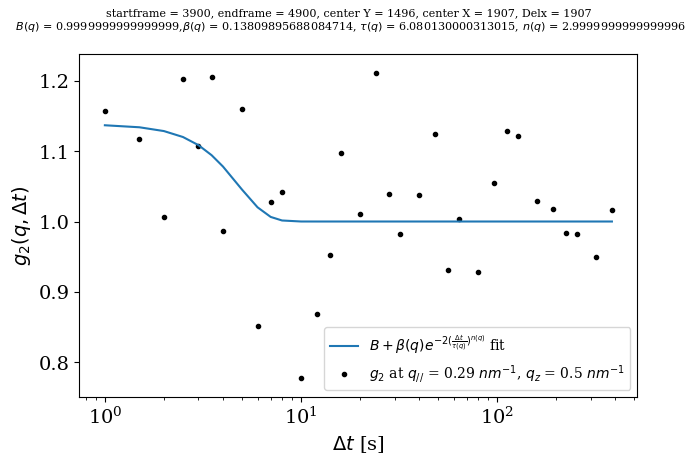

0.009407668667485694 1.0


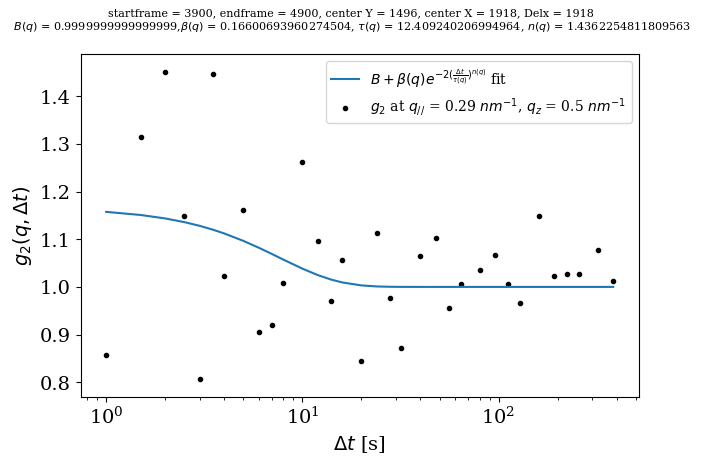

0.020687882958920052 1.0


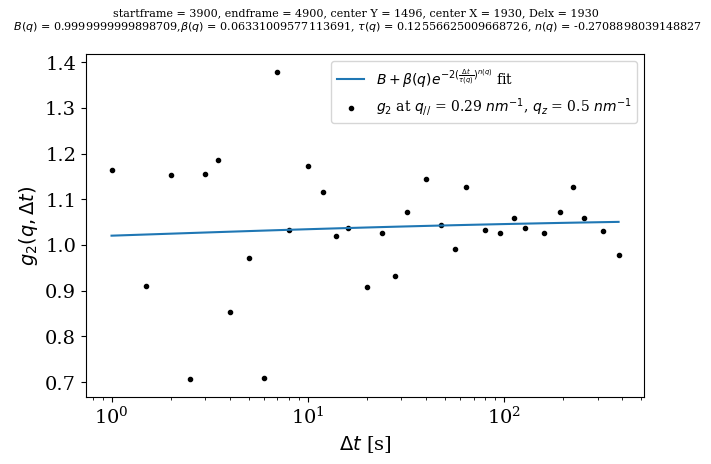

0.018116441270193438 1.0


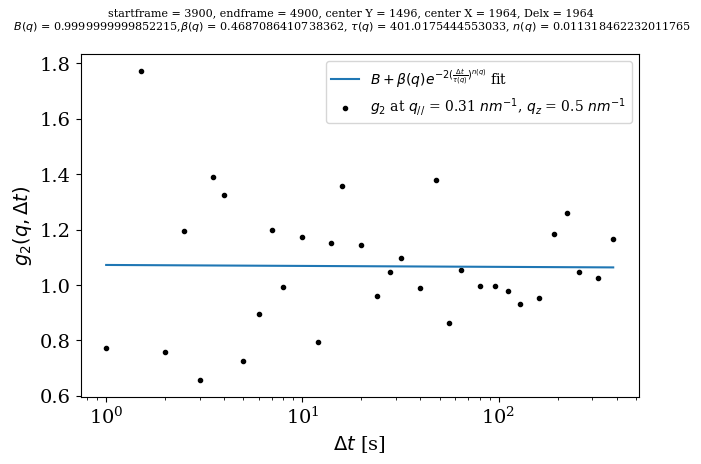

0.05351309003183302 0.9999999999999996


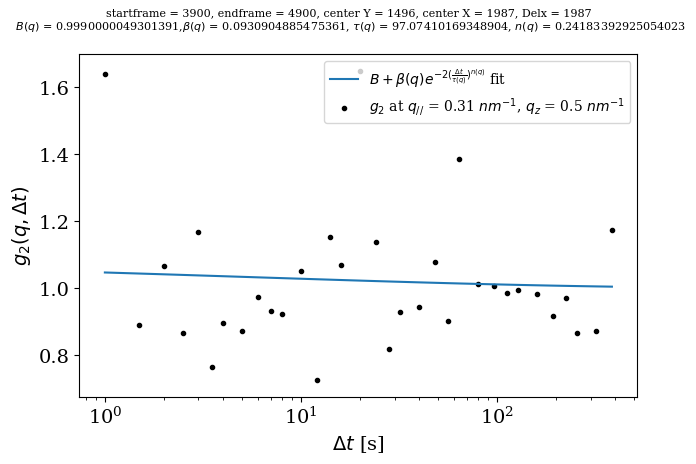

0.045718159869697066 1.0


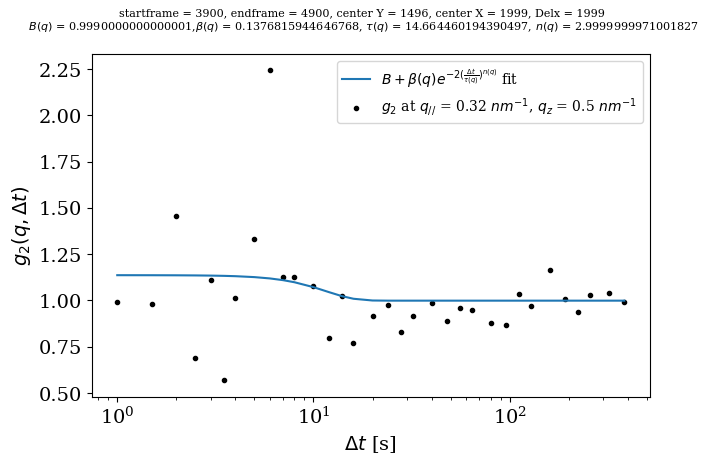

0.0693336005697089 0.9999999999999798


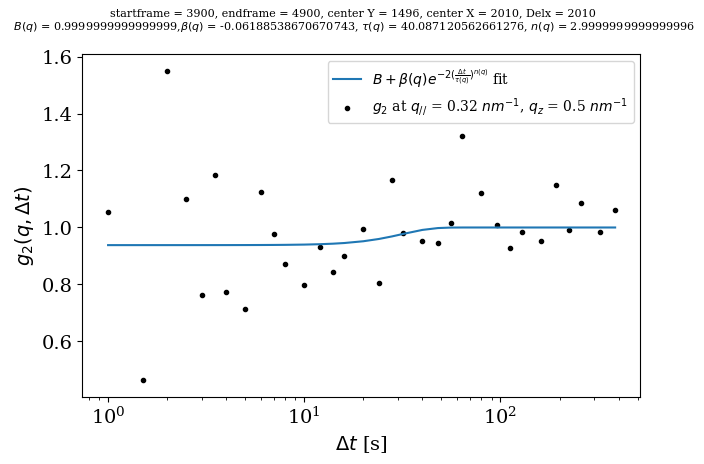

0.04033389314319031 1.0


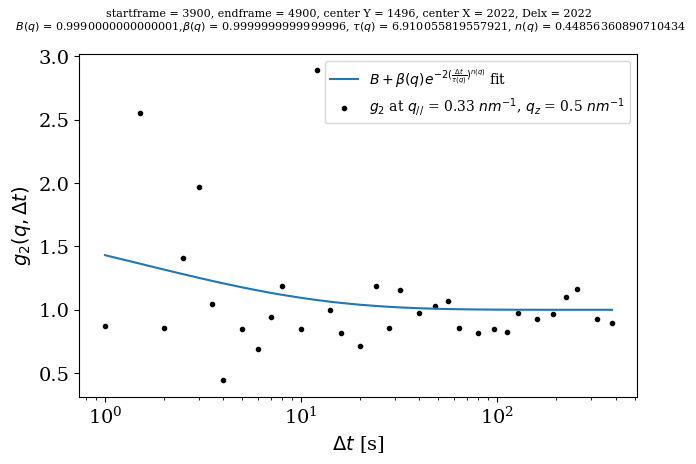

0.21329677486794665 0.9999998146876614


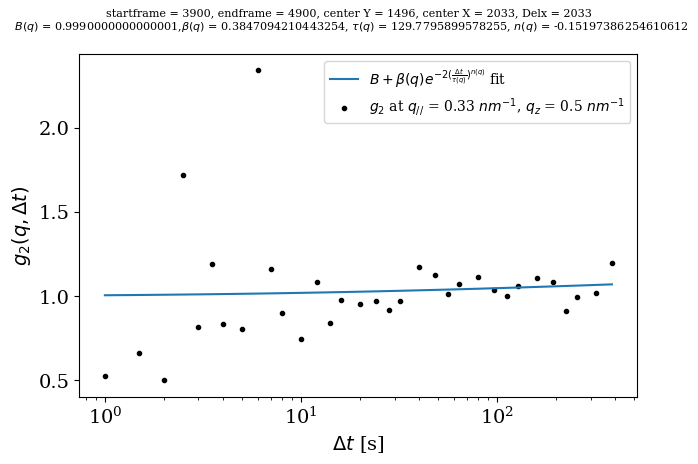

0.11153405427002577 0.9999999999770606


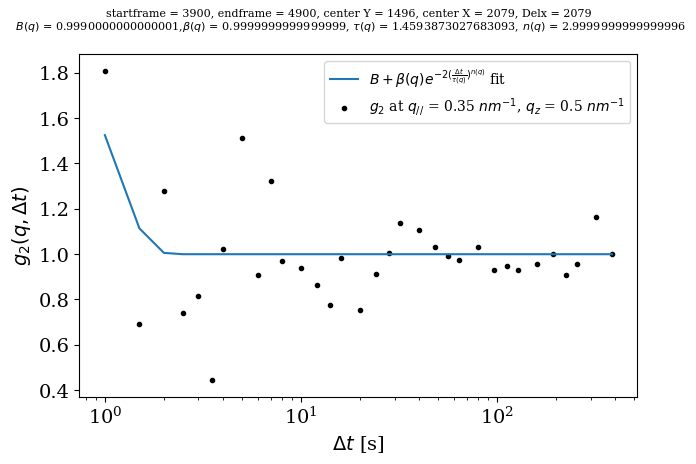

0.04473958138816681 1.0


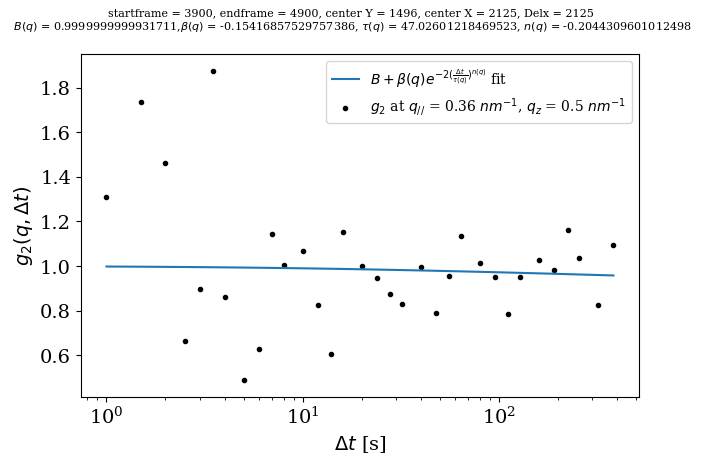

0.09057343362715124 0.9999999999989094



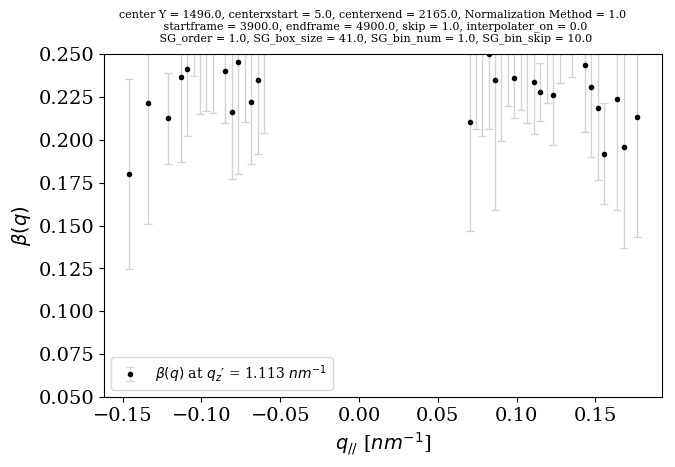

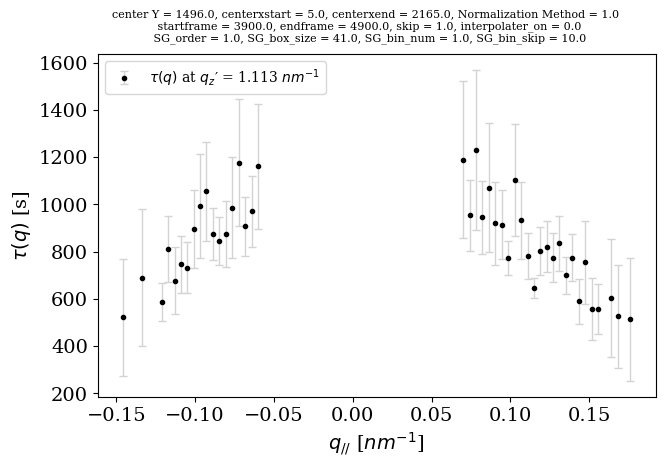

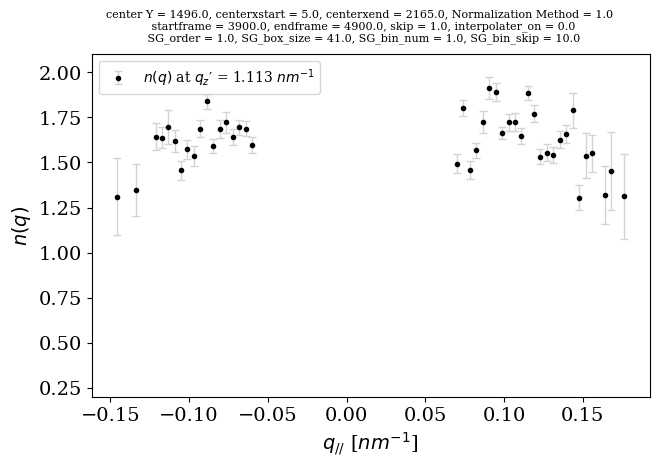

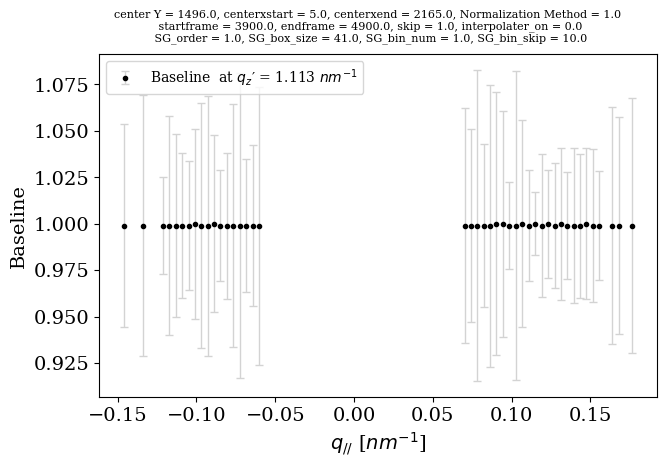

In [122]:
%run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/autocor.py'
%run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/partitions.py'
%run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py'
exponents = read_and_get_exponents_along_q_parallel_Mark(startY=1450,endY=1550,delY=91,startX=0,endX=2160,delX=11,startframe=3900,endframe=4900,Xlogscale = False, Xlog_num = 100, p0=[0.15,50,1.2,1.0],normalize = 1, bin_num = 1,  bin_skip = 10,nobuf=8,nolev=8,skip=1, interpolater_on = False, SG_order = 1, SG_box_size = 41)
plot_exponents(exponents)

<Figure size 720x445 with 0 Axes>

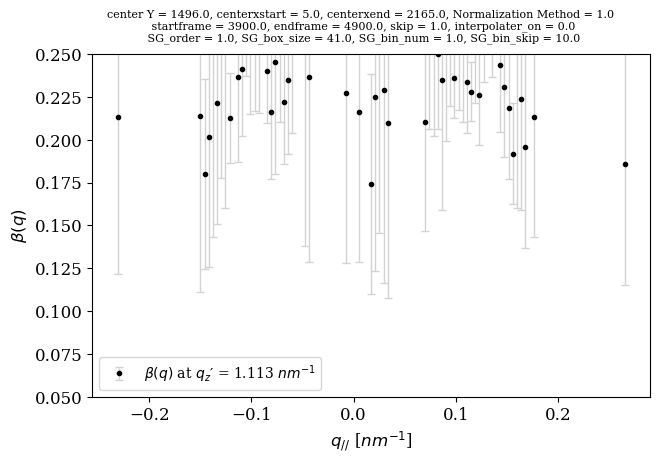

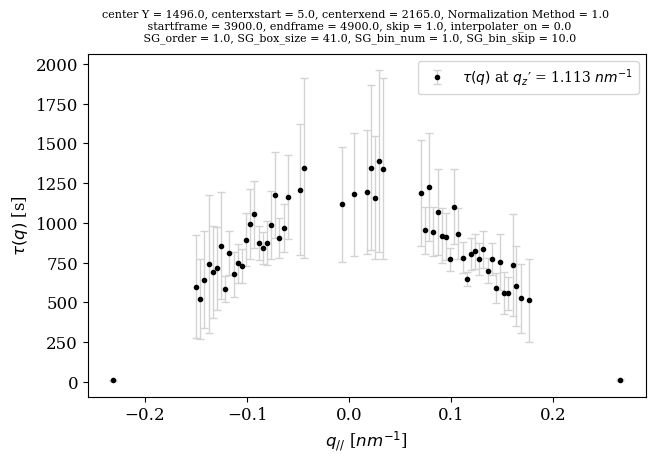

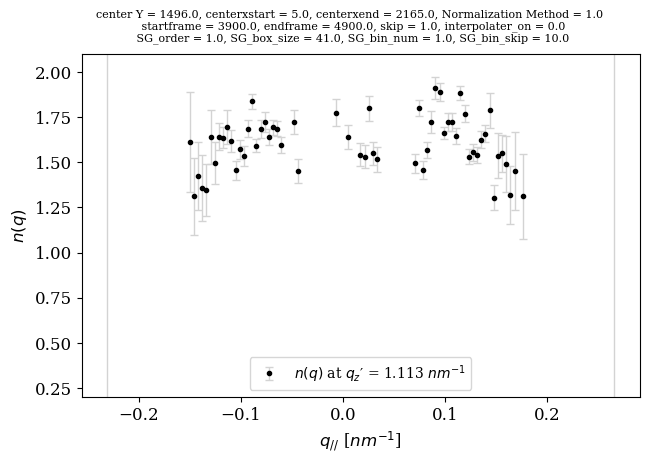

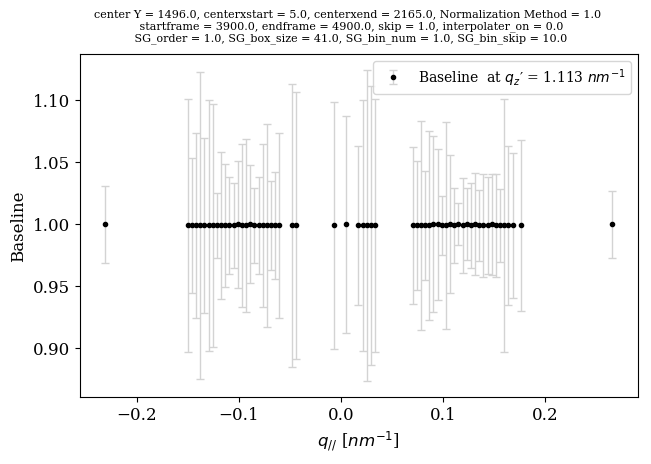

In [125]:
%run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/autocor.py'
%run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/partitions.py'
%run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py'
plot_exponents(exponents)

<Figure size 720x445 with 0 Axes>

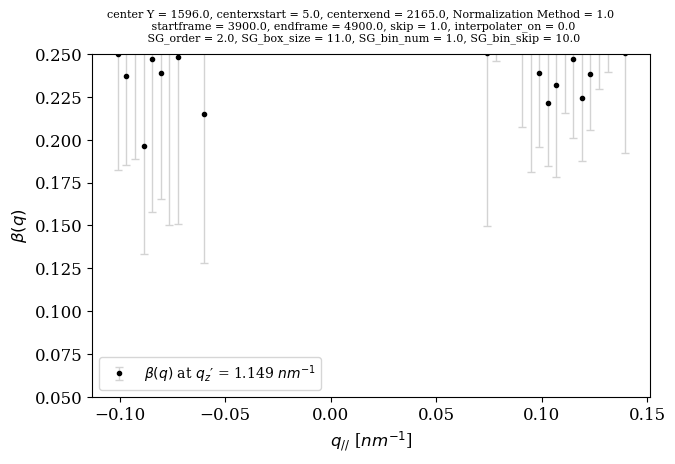

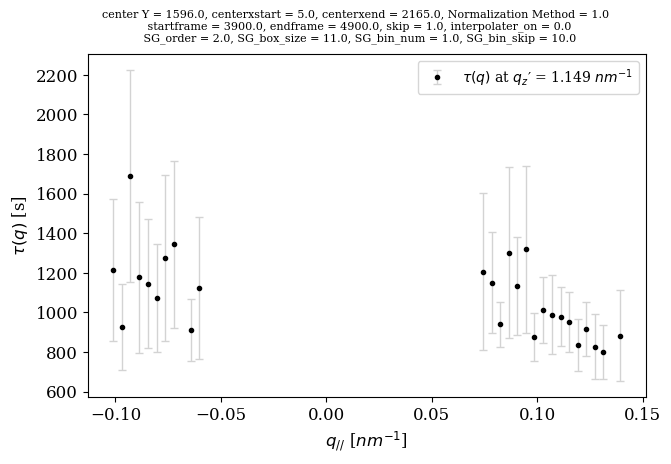

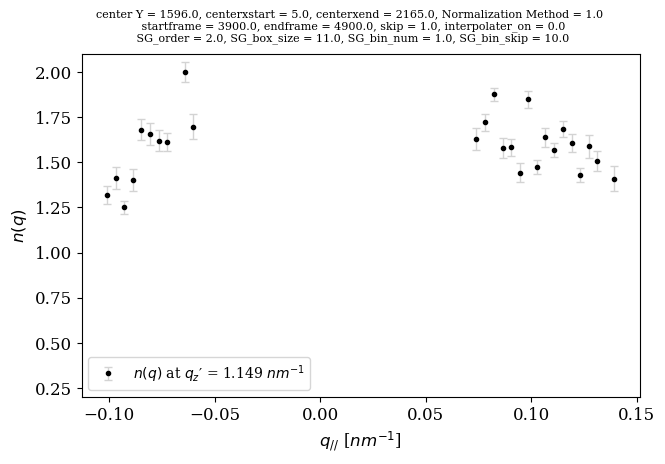

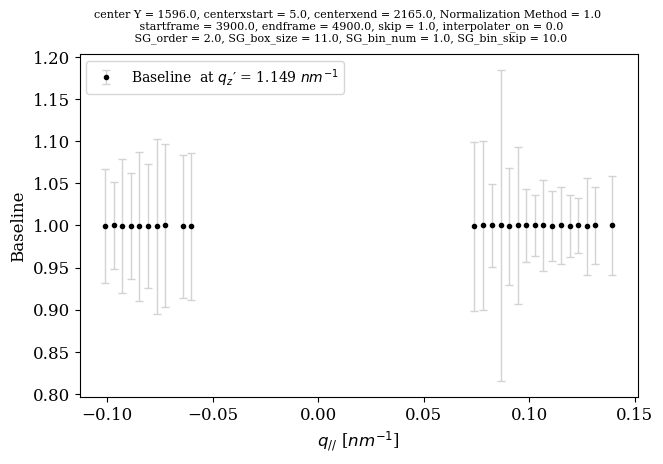

In [131]:
%run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py'
exponents = read_and_get_exponents_along_q_parallel_Mark(startY=1550,endY=1650,delY=91,startX=0,endX=2160,delX=11,startframe=3900,endframe=4900,Xlogscale = False, Xlog_num = 100, p0=[0.15,50,1.2,1.0],normalize = 1, bin_num = 1,  bin_skip = 10,nobuf=8,nolev=8,skip=1, interpolater_on = False, SG_order = 2, SG_box_size = 11)
plot_exponents(exponents)

# Normal TTCF

 81%|████████  | 1712/2121 [00:01<00:00, 1706.62it/s]


100%|██████████| 26/26 [00:38<00:00,  1.50s/it]1it/s]


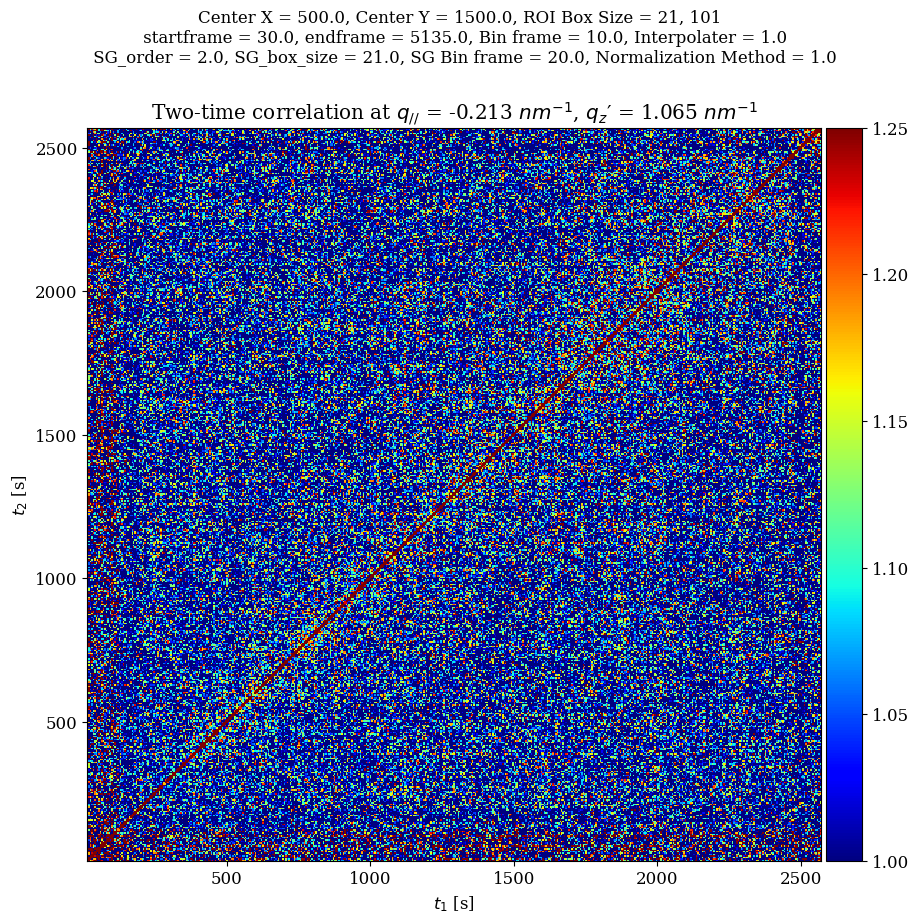

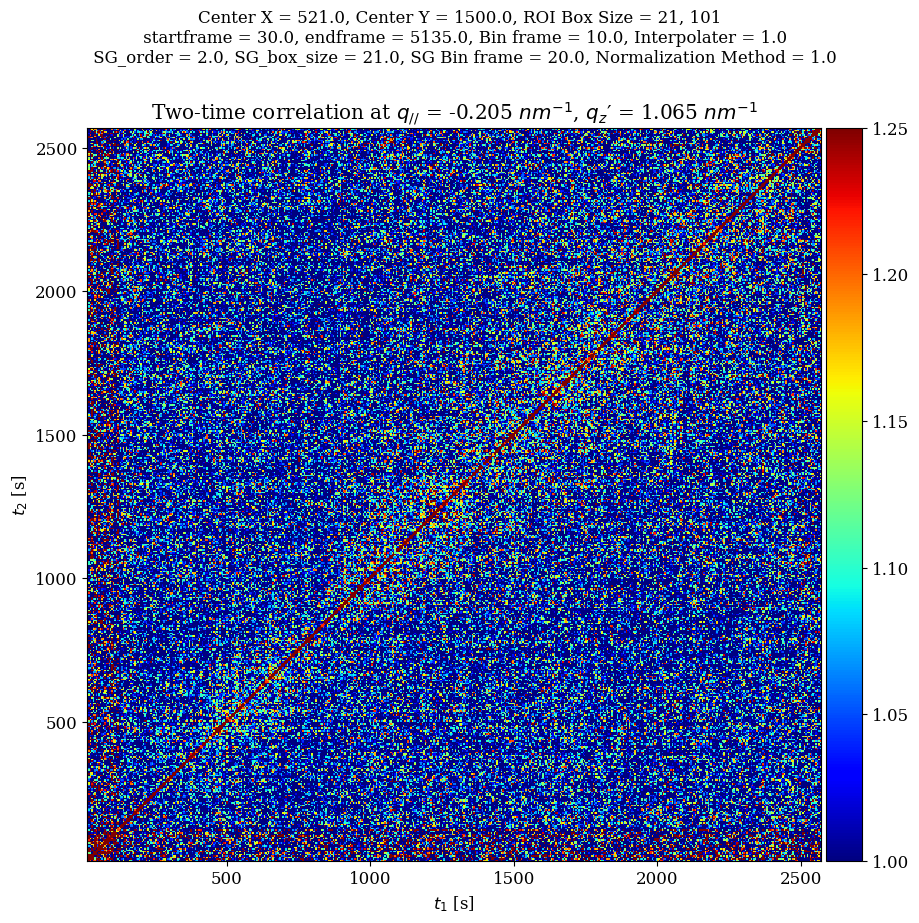

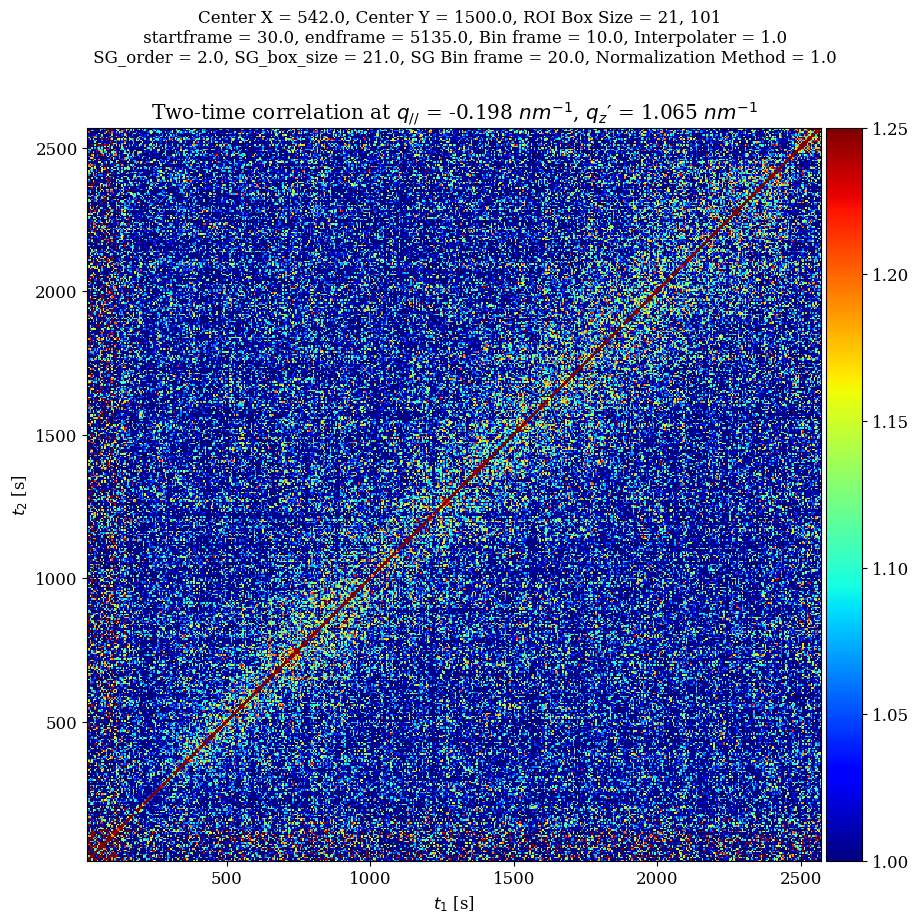

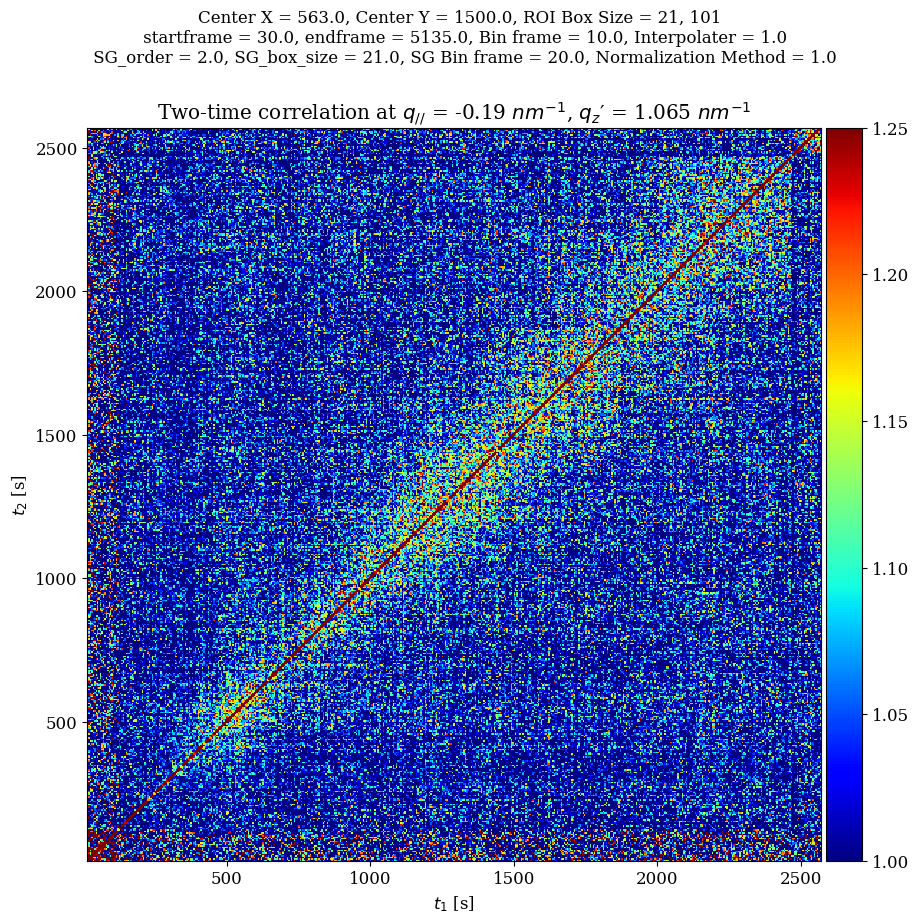

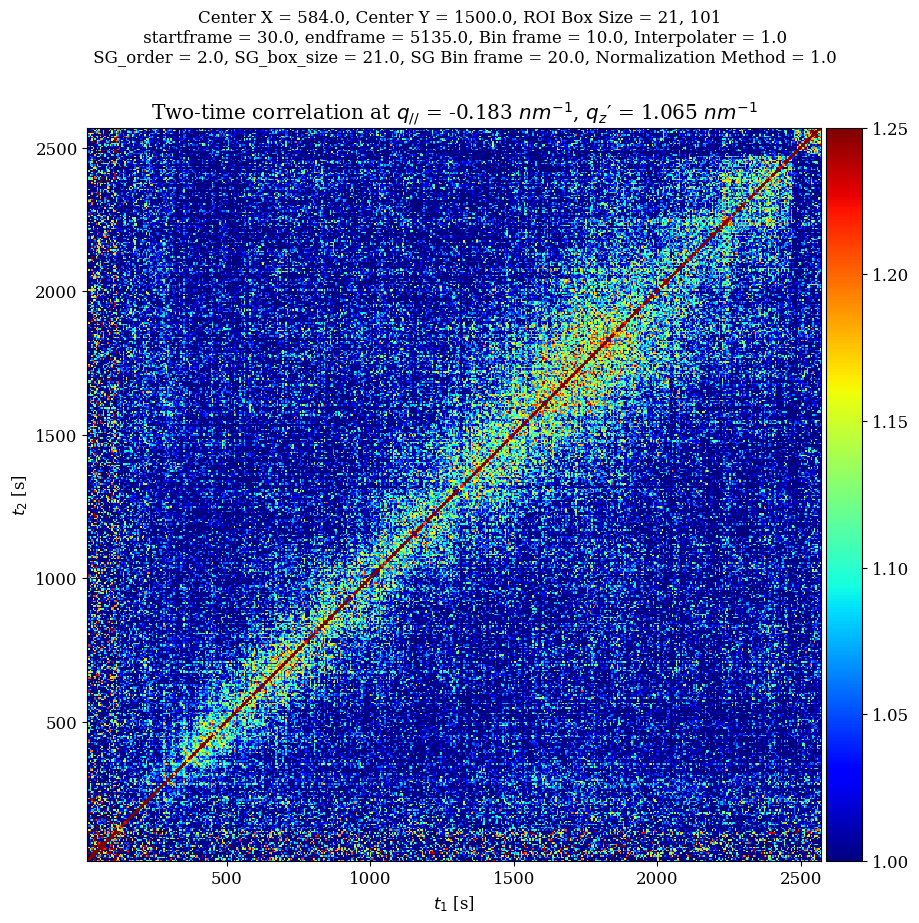

...

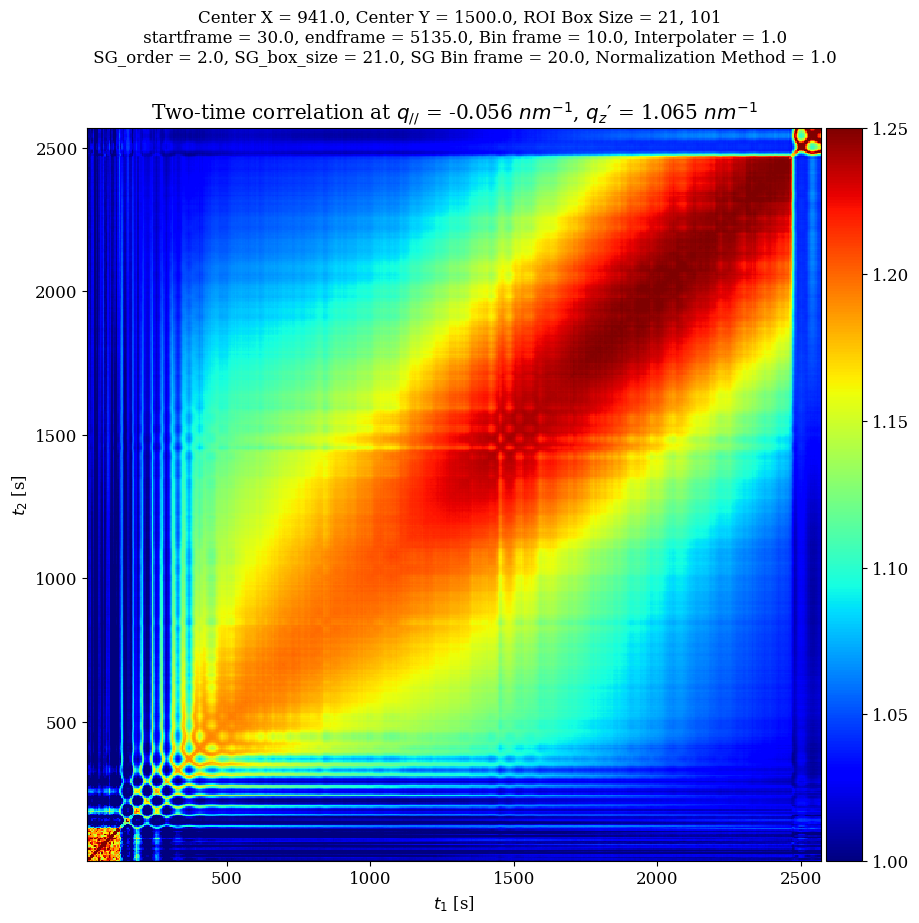

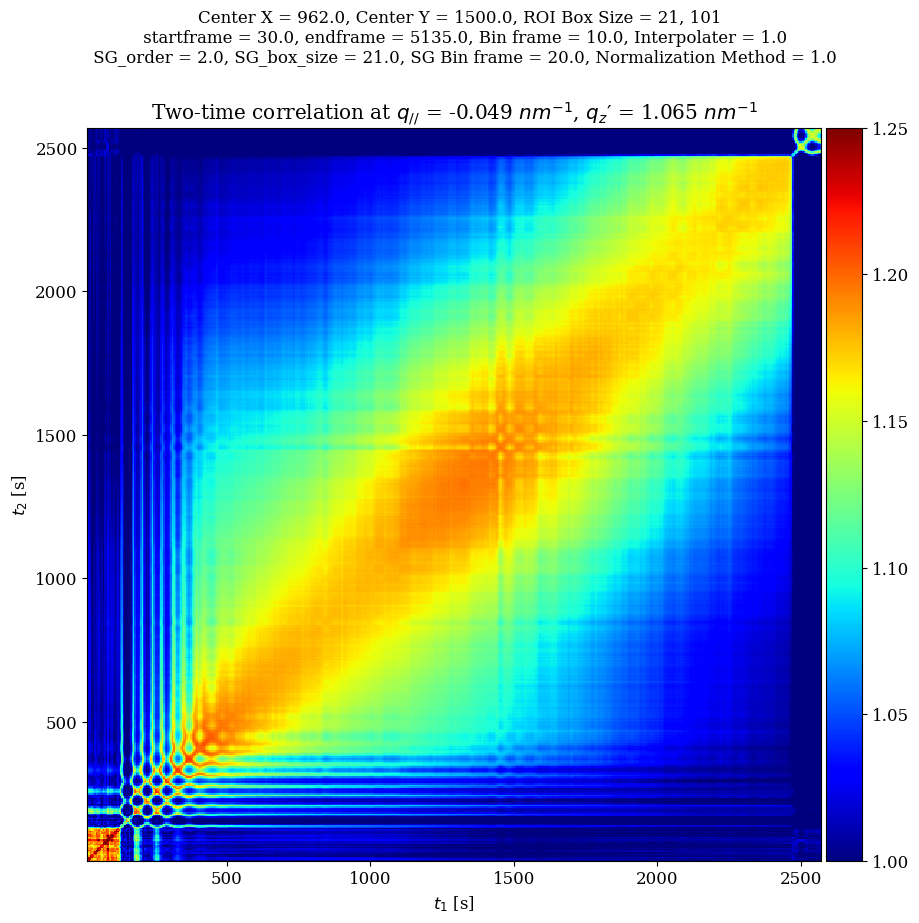

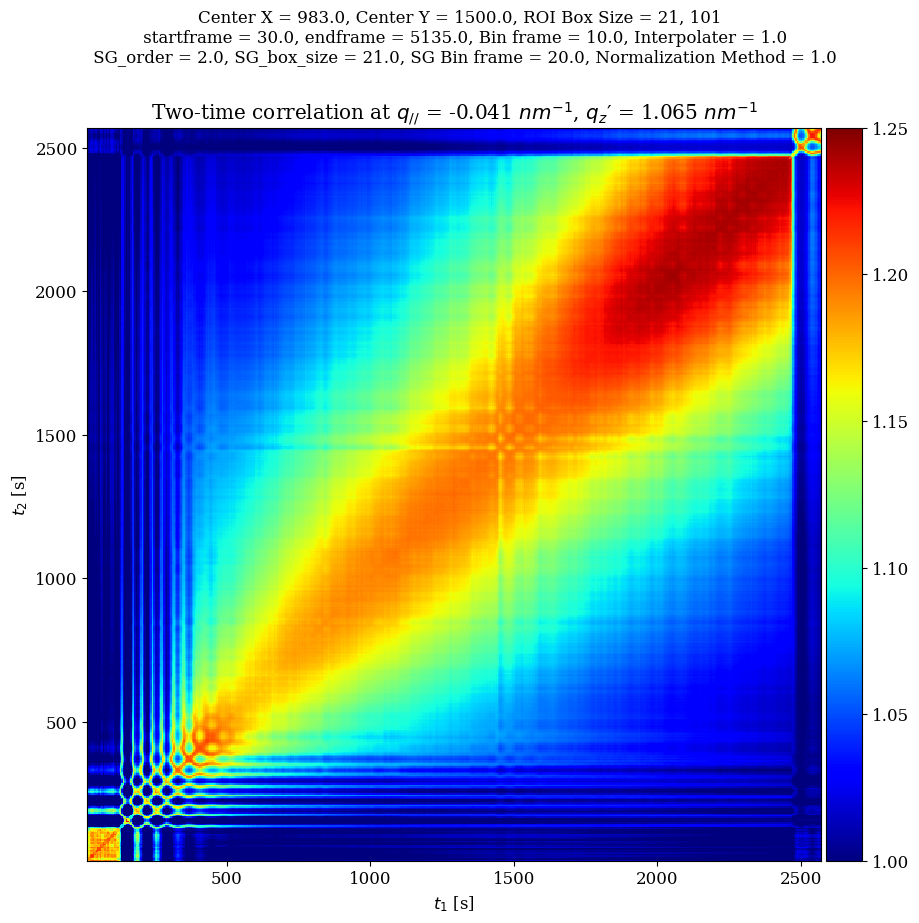

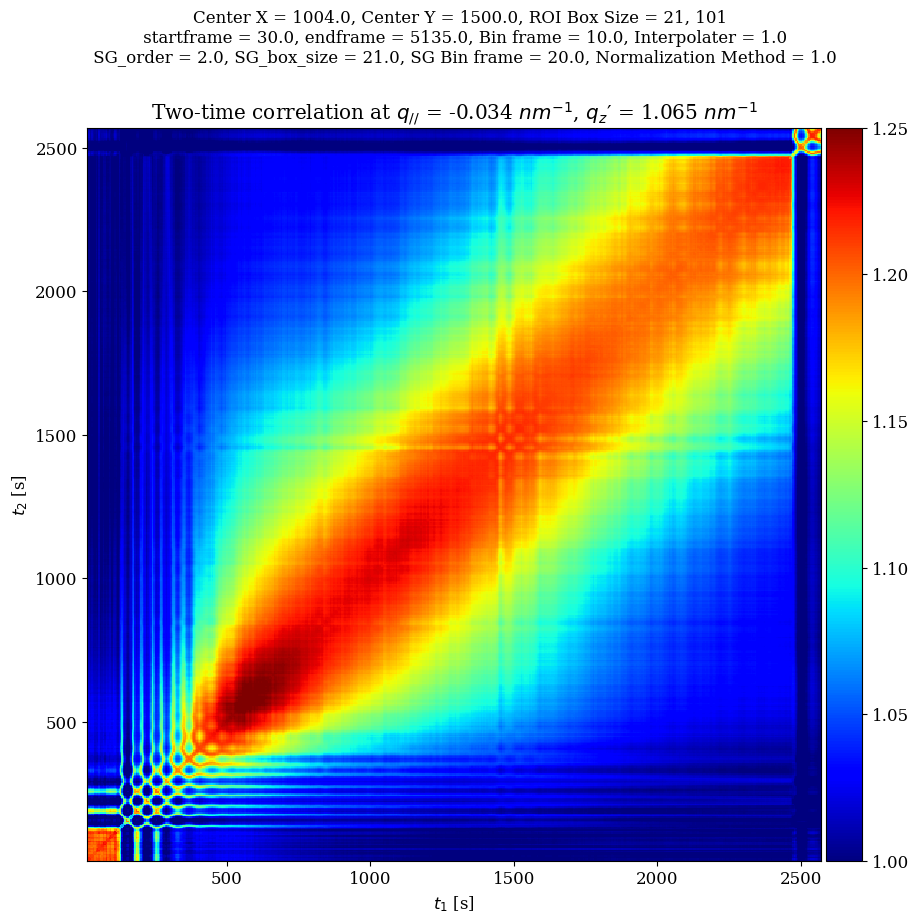

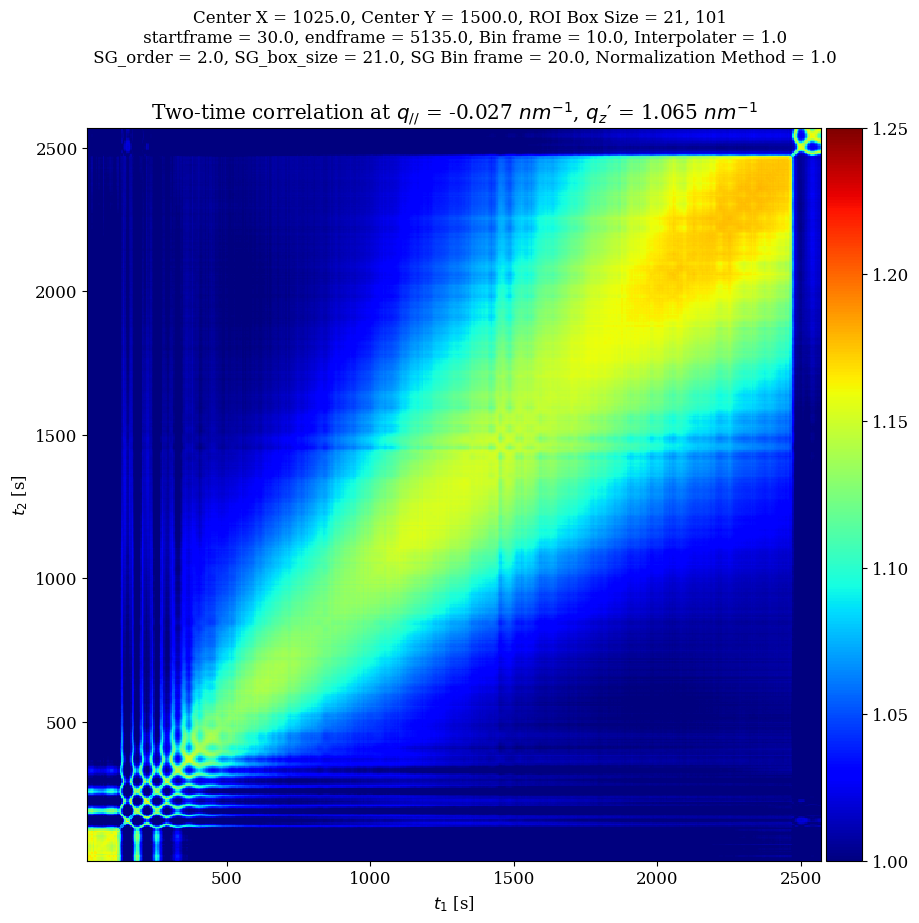

In [74]:
%run -i '/home/pmyint/analysis/2019_1/pmyint/ResPipelines/Dynamic_analysis_CHX.py'
from tqdm import tqdm
# CenterXs,Inor_all,TTCF2, TTCFs = None, None, None, None
# del CenterXs,Inor_all,TTCF2, TTCFs 

CenterXs,Inor_all, contrasts, Windows = collect_normalize(startframe = 30 ,endframe = 5135 , centerx_start = 500, centerx_end = 1040, centery = 1500,peak_in_X = 800, boxsize = (21,101), bin_frame = 10, normalize = 1, SG_window = 21, SG_order = 2,  SG_bin_frame = 20, interpolate = 1)
TTCF2, TTCFs = TTCF(CenterXs,Inor_all)
for i in range(len(TTCFs)):
    plotTTCF(TTCFs[i], color_min = 1 , color_max = 1.25, save = 0)

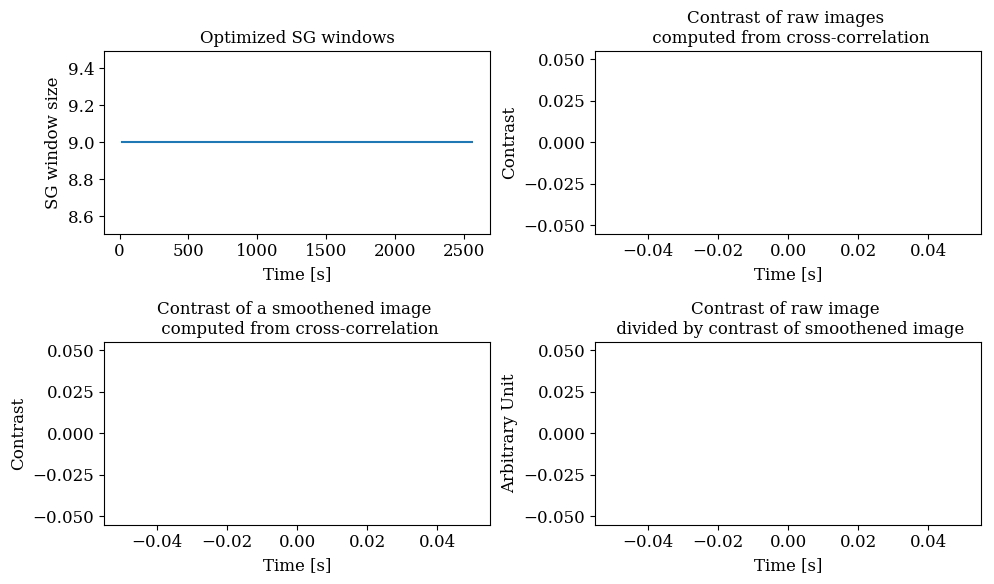

In [77]:
plot_contrasts_SG_windows(Windows, contrasts, starttime = 30,endtime = 5135, binframe= 10)